In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import os
os.chdir('/content/drive/My Drive/Partisan-Responses-master')

In [1]:
import pandas as pd
import numpy as np
import spacy
import nltk
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
import re
from tqdm import tqdm
import time

import matplotlib.pyplot as plt
%matplotlib inline

In [22]:
df_merged = pd.concat([final_df, final_df.shift(-1).add_prefix('next_')], axis=1)
df_merged.head()

,speakerid,speech_id,lastname,firstname,chamber,state,gender,party,district,nonvoting,...,next_speech_id,next_lastname,next_firstname,next_chamber,next_state,next_gender,next_party,next_district,next_nonvoting,next_speech
0,109112991,1090000002,FRIST,WILLIAM,S,TN,M,R,NaN,voting,...,1.090000e+09,PRYOR,MARK,S,AR,M,D,NaN,voting,former Senator Hawkins and former Senator Broc...
1,109117451,1090000007,PRYOR,MARK,S,AR,M,D,NaN,voting,...,1.090000e+09,SARBANES,PAUL,S,MD,M,D,NaN,voting,Mr. STEVENS. former Senator Murkowski. and Ms....
2,109113281,1090000010,SARBANES,PAUL,S,MD,M,D,NaN,voting,...,1.090000e+09,CLINTON,HILLARY,S,NY,F,D,NaN,voting,respectively. advanced to the desk of the Vice...
3,109114651,1090000013,CLINTON,HILLARY,S,NY,F,D,NaN,voting,...,1.090000e+09,FRIST,WILLIAM,S,TN,M,R,NaN,voting,Mr. President. I suggest the absence of a quorum.
4,109112991,1090000020,FRIST,WILLIAM,S,TN,M,R,NaN,voting,...,1.090000e+09,FRIST,WILLIAM,S,TN,M,R,NaN,voting,Mr. President. let me welcome everyone here an...


In [23]:
speeches_with_questions = df_merged.loc[df_merged['speech'].str.contains('\?')]
speeches_with_questions[['speech', 'next_speech']].head(15)

,speech,next_speech
5,Mr. President. let me welcome everyone here an...,Mr. President. I appreciate very much the rema...
6,Mr. President. I appreciate very much the rema...,I send a resolution to the desk and ask for it...
25,Mr. President. the day after the tsunami. I ha...,Mr. President. the tidal waves. tsunamis. that...
31,Mr. President it is with sadness that I rise t...,Mr. President. I ask unanimous consent that th...
36,Mr. President. I would like to take a few minu...,Mr. President. before he leaves the Chamber. I...
38,I am very pleased I have had a chance over the...,Mr. President. I ask unanimous consent that I ...
41,Mr. President. as I said on the Senate floor o...,Despite this evidence. alarmism is live and we...
42,Despite this evidence. alarmism is live and we...,Mr. President. I suggest the absence of a quorum.
45,Mr. President. the worlds thoughts and prayers...,Mr. President. I rise to express my sympathy o...
49,Mr. President. as we begin a new year and a ne...,Mr. President. in todays Federal Register. the...


In [24]:
ps = PorterStemmer()

##### Get questions that contain at least one phrase from the set of topic words

In [10]:
no = 0
topic_words = hb.topic_phrase
for i in range(len(speeches_with_questions)):
    # change comma for both question speech and answer speech
    question = change_comma(speeches_with_questions.iloc[i].speech)
    answer = change_comma(speeches_with_questions.iloc[i].next_speech)
    # tokenize question speech
    quest_sents = nltk.sent_tokenize(question)
    # select question sentences from speech
    questions = [q for q in quest_sents if q.find("?")+1]
    for q in questions:
        words = word_tokenize(q)
        words = [ps.stem(w.lower()) for w in words]
        stemmed_q = ' '.join(words)
        if any(phrase in stemmed_q for phrase in topic_words):
            print("Question: ", q)
            print("Answer: ", answer)
            print()
            no += 1

Question:  If the House Democrats feel a tax increase is necessary, then why wouldnt they allow for a full and open debate?
Answer:  Mr. Speaker, I reserve my time.

Question:  FL, so they can prepare a celebration 6 years from now to recognize their 450th birthday, I hardly see, in the midst of the economic times we face, how that can be a priority for the Nation as a whole, I know it is a priority from a parochial standpoint, but is it in the best interest of the Nation?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Are you acting as a statesman or are you acting as somebody who wants to get reelected?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Therefore, when the Mortgage Bankers Association claims with no evidence whatsoever that my bill would raise mortgage interest rates, we should all ask them this: Why would mortgage bankers charge future borrowers hi

Question:  What is in this bill that doesnt make sense just from a commonsense standpoint, maybe something we should do at the right time?
Answer:  I ask unanimous consent that the order for the quorum call be rescinded.

Question:  But the question is, in todays economic climate, is that something we should be doing?
Answer:  I ask unanimous consent that the order for the quorum call be rescinded.

Question:  What would a quarter of a million dollars do for somebody who is unemployed right now?
Answer:  I ask unanimous consent that the order for the quorum call be rescinded.

Question:  And, if it is, how are we going to cross them with utility lines, power transmission lines, natural gas lines, coal slurry lines, bridges, roads?
Answer:  I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Amendment 3 to strike the Wyoming Range leasing withdrawal provisionif we can extract natural gas and oil and do it in a totally clean, environmentally friendly way 

Question:  How does that set with eliminating wasteful spending?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  But the fact is, it is a clue to the American public that we dont get it, that in this time of significant economic downturn, in this time of significant debt laying on to the next generations, we continue to want to do things the average person of common sense would say: How can that be a priority?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  No, 1, I would ask the question again: Why isnt that a State responsibility instead of a Federal responsibility?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Small business owners: Where is my bailout?
Answer:  I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Mr. Speaker, would do the following: We basically are sa

Question:  Why would you enhance botanical gardens now when we are going to run a $1.8 trillion deficit this year?
Answer:  Mr. President, how much time remains on both sides?

Question:  The concerns are most appropriate: How do we get a fair deal for the American taxpayer?
Answer:  Let me clear up the data on the Wyoming Range. It is said there is only 1.5 trillion cubic feet, according to the U.S. Geologic Survey. But you have not read the complete report. The letter is new. The data used by them is older than the data used by the Bureau of Land Management. It wasnt based on the latest topographic and geological studies. That is the first problem. The second thing they say in their report is they lacked an official map. So it is their best guess, not based on science, not based on known data. Finally, they only approximated for the following reasons: They only had a general outline of the area and they assumed a homogenous distribution of oil and gas resources across the entire area

Question:  If we are going to continue putting capital into financial institutions, shouldnt we at least order the SEC to stop destroying capital through outdated real estate accounting?
Answer:  Mr. Speaker, I yield myself such time as I may consume to simply congratulate my friend from Ohio for her very thoughtful remarks and to associate myself with the remarks that she offered. With that. Mr. Speaker, I reserve the balance of my time.

Question:  Shouldnt we allow the President a bit of time to see if the Feds very aggressive monetary policy activities, coupled with enormous deficit spending weve already done, are having any effect?
Answer:  Mr. Speaker, I yield myself such time as I may consume to simply congratulate my friend from Ohio for her very thoughtful remarks and to associate myself with the remarks that she offered. With that. Mr. Speaker, I reserve the balance of my time.

Question:  Mr. Chairman, thats a major problem: those who cant get credit arent getting it?
Answer

Question:  Does anybody really think that that $1.3 billion would be spent anywhere near as efficiently as if you had just gone and cut tax rates in areas where its stifling growth and where its keeping people from making good decisions so that their families can have basic education that they might want or so that their families might be able to get better health care or so that their families might be able to make better decisions in buying a car to help the auto companies rather than bailing out the auto companies for failed decisions?
Answer:  The little trouble with what youre saying is that it requires people to be responsible, doesnt it?

Question:  "How is this economic situation affecting you, personally?"
Answer:  Well, I appreciate your joining us, and I also appreciate the gentleman from Iowa, I think weve just got about a minute or so left, I think the thing that we have to walk away with is that the cost of going from a recession to a depression could be severe. In the da

Question:  I mean, what specific policies have they been given to undertake by this United States Congress?
Answer:  Mr. Chairman, I rise to claim the time in opposition. The Acting CHAIR. The gentleman from Massachusetts is recognized for-

Question:  Since we have express language in here dealing with the auto industry, I hope the chairman will answer the question, does this mean that the Secretary of the Treasury can place an observer in every UAW union hall across the Nation if they receive monies under TARP?
Answer:  Mr. Chairman, I rise to claim the time in opposition. The Acting CHAIR. The gentleman from Massachusetts is recognized for-

Question:  Now how in the world does this make sense for American taxpayers?
Answer:  Thank you. Mr. Chair, I will just finish this sentence. At the very least shouldnt we wait to see how the current $300 billion, yes, billion, should be spent. If this is near the end of my time. Mr. Chair, I would submit my remarks for the RECORD. Its as if the

Question:  We are going to trample on property rights as we havent in decades, both directly and indirectly, I asked myself: Why are we doing It?
Answer:  Madam President, I suggest the absence of a quorum.

Question:  Madam President, can we amend the request to allow both sides to have an equal amount of added time?
Answer:  Reserving the right to object, what will happen to floor time thereafter? Where many of us have time to talk about TARP later on, will we still have that time set aside prior to the TARP vote at 4:30?

Question:  The question before us today is: Are we going to give another $350 billionnot through an oversight process, through an appropriating processare we going to write a blank check to the Treasury Department to accomplish again what we are assured by the transition team and the incoming administration is for very specific things?
Answer:  I thank the Chair, I suggest the absence of a quorum.

Question:  Is this on credit card bailouts, on student loans, on an

Question:  If one of our major institutions devoted to training educational professionals remains in tatters how can we accommodate the faculty, staff and future quality teachers for our State and Nation?
Answer:  Madam Speaker, I rise in strong support of H. Res, 58, commending the University of Florida Gators for winning the Bowl Championship Series National Championship Game. As a loyal Gator fan since I was a child, I can remember sitting at the kitchen table and talking about how wonderful it would be for the Gators to just win a Southeast Conference title. We accomplished that feat. Then, in 1996, our football team won their first national championship. The momentum hasnt stopped since we won it again in 2006 and 2008. The University of Florida was founded in 1853. Fiftythree years later, their football program was born. Since the teams inception, they have played in 34 bowl games, won eight Southeast Conference titles, and produced three Heisman Trophy winners. Floridas most rec

Question:  How can the Equal Employment Opportunity Commission investigate a claim of discrimination and find the truth, if the discriminating supervisor has retired, moved away or, perhaps, even died?
Answer:  Mr. President, I thank the Senator from Alaska for her support of my amendment, I wish to lay out my amendment one more time, and then the longsuffering and everpatient Senator from Maryland will have the chance to rebut. She has been so wonderful about making sure everyone got a chance to speak and knowing we would still be here to debate this amendment, and then setting a time agreement for the vote tomorrow, when the leaders have made that decision. This is such an important issue. As the Senator from Alaska has said, and really everyone has said, we all want to make sure we give every opportunity to a person who has faced discrimination in the workplace to be able to have a redress of that discrimination. The law, as it is today, gives 6 months for a person to be able to go 

Question:  So I would like to ask the gentleman from Maryland, the majority leader, will Democrats allow amendments to be considered for a vote on the floor that increase the tax relief in this bill, as President Obama has requested?
Answer:  I thank the gentleman for yielding. Im not sure that President Obama has requested specifically what you suggest he requested. He did say that he wanted a very significant portion of this bill to be tax cuts for working Americans. He promised that in his campaign. He promised that he was going to give 95 percent of taxpayers in America a tax cut. This bill will do that. And Im not sure of the exact percentage, but I think probably between 30 and 40 percent. Youre correct in that approximate range, I think, as I have said before and maybe being redundant, as you know, and youre a member of the Ways and Means Committee, we appropriators sometimes felt constrained by this rule that your committee had, but, nevertheless, your committee has generally f

Question:  Does the DeMint amendment amend the Ledbetter bill or the National Labor Relations Act and the Railroad Act?
Answer:  Right.

Question:  But the consequences arearent you amending the National Labor Relations Act?
Answer:  It is a discrimination and fairness bill, and my bill would change the National Labor Relations Act to remove a mandate on States.

Question:  You just have to ask the question: How can our government be so insensitivetaking money, taking retirement benefits out of the pockets of our elders, of our seniors, at a time of the year when they are absolutely the most vulnerable?
Answer:  Mr. President, after listening to the Senator from Alaska, I certainly would love to have her advocating on my behalf, and I know you two will make a great team in advocating on behalf of the people in Alaska, certainly seeing that they have been sent an injustice, I thank you for the opportunity to listen to that. Again, it is great to be here with the two Senators from Alaska

Question:  But, in the meantime, just keeping it very, very simple, why not allow someone who purchases their own health insurance, why not allow that to be deductible from their income tax?
Answer:  I might say the real Dr. PHIL, as a matter of fact, I am certainly pleased tonight to join my colleague, my colleague that I have just joined on the Energy and Commerce Committee in this 111th Congress, and I am proud to have the opportunity to do that, to really have a seat at the table of one of the two main committees of the House that deal with health care, deal with all of Medicare and Medicaid and SCHIP, many of the things that the gentleman from Texas.

Question:  Do we really need the government to write the code for medical information technology?
Answer:  I might say the real Dr. PHIL, as a matter of fact, I am certainly pleased tonight to join my colleague, my colleague that I have just joined on the Energy and Commerce Committee in this 111th Congress, and I am proud to have th

Question:  Would we do the right thing In the long term for these kids that we say we care about their health care?
Answer:  Mr. President, I thank my colleague for his comments. There is an easy way to solve this, it is called auto enrollment. You just write a bill. Anybody in any region under 200 percent who has a claim of deduction for children is automatically enrolled in SCHIP or Medicaid. It is not hard. We do not want to do that. Why are we not doing that? Because we do not want to help all of these 5.4 million children. We do not want to do that. We have all of these incentives that have not worked in the past. We have done all of these things. All you have to do is auto enrollment. We can write a law. We can pass it. We can say: The IRS can look at every family who has children under 200 percent who files a tax return or files for the earned income tax credit, and their children are automatically enrolled. They automatically get a notice that says: Here is your insurance. Here

Question:  When you do research, when you do student special education, how does that quickly kickstart the economy?
Answer:  Mr. Chairman, I would like to yield 1 minute to my friend from New Jersey .

Question:  When he talks about provisions that make economic sense, could he explain how $50 million to the National Endowment for the Arts makes economic sense for his congressional district?
Answer:  I would be happy to respond to that if the gentleman wants to yield to me.

Question:  Mr. Chairman, when did we decide that more Federal spending in itself is economic stimulus?
Answer:  Mr. Chairman, I ask that the balance of our time be managed by the gentleman from New Jersey . The Acting CHAIR . Without objection, the gentleman from New Jersey will control the time.

Question:  Will we continue to rely on foreign nations, such as China, already bankrolling our spending babits?
Answer:  Mr. Chairman, I ask that the balance of our time be managed by the gentleman from New Jersey . The 

Question:  But further, wouldnt my friend agree that family planning is the common ground between those of us who support a womans right to choose and those who oppose it?
Answer:  I would say, through the Chair, that I am not one who celebrates the incidence of abortion in this country or anywhere, I wish to see far fewer abortions. But lets be honest. How do you reach that goal? You reach that goal by educating women and giving them opportunities to avoid unintended pregnancies, I think that is why this amendment is inconsistent with the sponsors goal. If you want fewer abortions, give women an option, let them control their bodies and their lives, and let them make family decisions that are right for them, instead of being at the mercy of a situation they cannot control.

Question:  Do we still have medical insurance?
Answer:  Mr. President, I have listened to the debate on the amendment offered by Senator MARTINEZ to reverse President Obamas decision to overturn the Mexico City pol

Question:  What happened to creating jobs with purpose?
Answer:  Mr. Chair, the American Recovery and Reinvestment Act of 2009 includes a total of $4.9 billion to address critical facility maintenance and repair issues within the Department of Defense, invests in energy efficiency at DoD facilities, and provides much needed research into alternative energy sources for the Department. FACILmES The bill includes $4.5 billion to make major repairs and upgrades at Defense Department facilities, which affects both the quality of life for service personnel and their effectiveness in performing their missions. Over the past two years, the Defense Subcommittee has found numerous base facilities to be inadequate and/or in dire need of maintenance and repair. These conditions are clearly illustrated by the problems weve seen at Walter Reed Army Medical Center and the barracks at Ft. Bragg. The Defense Departments annual budget requests have failed to address these issues, and the latest estimate

Question:  How compassionate is it, bow compassionate is it really to be making loans to some family that cant afford their mortgage payments?
Answer:  Of course, in the Great Depression, you took a recession and turned it into a Great Depression and it just kept going and going and going. Because what they are doing is they are vacuum cleaning all of the money out of the economy for Federal jobs programs, supposedly creating jobs and starving the very productive sector of the economy that could be solving the problem.

Question:  Why arent you using it to get the financial service markets up and going?
Answer:  Of course, in the Great Depression, you took a recession and turned it into a Great Depression and it just kept going and going and going. Because what they are doing is they are vacuum cleaning all of the money out of the economy for Federal jobs programs, supposedly creating jobs and starving the very productive sector of the economy that could be solving the problem.

Questi

Question:  You might ask, who are the 750.000 people the Grassley amendment would deny participation In the Childrens Health Insurance Program?
Answer:  Mr. President, I will take a minute to salute the leadership of the Senator from Montana on the Finance Committee. He has done a masterful job trying to keep things together as we get ourselves back to a more stable economy, I congratulate him for the work done and ask him to continue to exert the effort and leadership he has thus far. Mr. President, I come to the floor to protect the wellbeing of more than 3.000 children in New Jersey.

Question:  What could we buy for $2.160 for every kid at 300 percent of the poverty level or less who is not on the program?
Answer:  Madam President, we are at a point where the rubber meets the road. We are challenged daily in this institution and across the country by the American people to find solutions to real problems. In 1997, we found a problem. It was called uninsured children. In the House E

Question:  Business Week, in its January 28 issue, asks "how much does boosting government spending or cutting taxes help the private sector?
Answer:  Moreover, we must calibrate even more carefully the imperative for speed against the ironclad necessity of getting this legislation rightgiven this bill in its current form would add nearly $900 billion to our national debtand that is before any interest paymentson top of the $10.6 trillion debt that exists. And that means, we cannot open the door to permanent spending that exceeds the life and purpose of what is before us today. In fact. Alice Rivlin, former Director of the Office of Management and Budget in the Clinton administration, offered the following fiscal realitycheck in her testimony before the House Budget Committee last week. "because were doing this outside the budget process, it means no one has to talk about what the longterm effects of any of this might be." Well, let us talk about the long term effects here and now. As 

Question:  Is it going to do the things we need to do to make a difference in our economic situation in the world today?
Answer:  Mr. President, I suggest the absence of a quorum.

Question:  Does anybody think we ought to just ship money out the door and not ask for some sort of reporting requirement about how many jobs we created?
Answer:  Mr. President, will the Senator yield for a question?

Question:  If we are trying to create jobs, why should we have provisions in our Tax Code that move jobs elsewhere?
Answer:  Mr. President, will the Senator yield for a question?

Question:  So the Senator means to say if a steelmaker moves production overseas at a very minimal rate, and then ships steel back, they are going to have a lower tax rate than the steel company that struggled, downsized, rightsized to try to stay in this country and manufacture steel?
Answer:  That is exactly the case. Most people would not even believe that to be the case. They would say: How on Earth would someone 

Question:  Now, who is that American taxpayer?
Answer:  Mr. President, this week, the Senate is considering critical legislation to renew our economy and to renew Americas promise of prosperity and security for all of its citizens, I have long held the view that American innovation can and should play a vital role in revitalizing our economy and in improving our Nations health care system, I commend the lead sponsors of this legislation for making sure that the economic recovery package includes an investment in health information technology that also takes meaningful steps to protect the privacy of American consumers. The privacy protections for electronic health records in the economic recovery package are essential to a successful national health IT system. February 3, 2009 CONGRE and these safeguards should not be weakened. In America today, if you have a health record, you have a health privacy problem. The explosion of electronic health records, digital databases, and the Interne

Question:  Id like to ask the gentleman, what opportunities will Republicans be given next week or anytime in the future, but especially next week, to increase tax relief in the bill and out wasteful spending before the stimulus is voted on again?
Answer:  I reclaim my time, and Id just like to say to the gentleman, I know that there was over 200 amendments offered.

Question:  And (2) Will it create jobs?
Answer:  Mr. Speaker, pursuant to House Rule XI(2)(a)(2) I hereby submit to the House the Rules of the Committee on Science and Technology for the 111th Congress as adopted by the Committee on January 28, 2009:

Question:  By Congress taking taxpayer money and giving it to certain entities, does it stimulate the economy or is it just more pork?
Answer:  Mr. Speaker, thank you very much. Mr. Speaker, last month I introduced H.R, 24, legislation to redesignate the Department of the Navy to be the Department of Navy and Marine Corps. For the past 7 years, the language of this bill has b

Question:  Would this prime the pump and get our economy moving again?
Answer:  Madam President, I rise in opposition to the FeingoldMcCain amendment. Yesterday, I received a message from the Obama administration that concludes that the economy faces its most serious crisis since the Great Depression, and I think that is something to which we all agree. It goes further and says the economic recovery package now being considered by this body is an essential step in putting the economy back on the path of growth. Our President. President Obama, has asked the Congress to send a bill to him before the February recess, and I believe we have that responsibility to act quickly and responsibly. Therefore, I believe now is not the time to debate controversial legislation that is not relevant to economic recovery. There are no earmarks contained in the American Recovery and Reinvestment Act that we are now considering before the Senate, I maintain that now is not the time to debate Senate floor 

Question:  Is this a question of getting all of this spending we wanted for the last 8 years and we are going to spend out the majority of that spending after the year 2011 or is this truly a stimulus bill that is targeted at getting the economy moving again, and once that happens, then the spending for the future under this legislation ceases?
Answer:  Mr. President, later today I will be offering an amendment with Senator GRASSLEY, which I think is an extremely important amendment, which, in fact, deals very fundamentally with the unemployment and job crisis facing this country. There is no debate the American people are furious at what happened on Wall Street, where a small number of executives have acted in an incredibly greedy manner, with extreme recklessness, and perhaps illegal behavior, in plunging our country into a major and very deep recession.

Question:  Is the Senator aware of my strong support for the compensation that our great Filipino allies in World War II rendered 

Question:  The American people ask one simple question: When is all of this spending going to stop?
Answer:  Madam President, I yield to the Senator from Michigan.

Question:  What are we going to do next week when the Treasury Secretarys proposal comes down on TARP III and on housing which the Senator from New York mentioned?
Answer:  Madam President, I yield to the Senator from Michigan.

Question:  Will we have to raise the debt ceiling once again?
Answer:  Madam President, I yield to the Senator from Michigan.

Question:  I go back to the question I asked at the start, which I hear time and time again from people in Georgia: Senator, when is the spending going to stop and there be some focus on trying to make sure we grow jobs as well as fix the housing Issue?
Answer:  Madam President, I yield to the Senator from Michigan.

Question:  And how many jobs do you believe were created with the money?
Answer:  Mr. President, the Senator is correct. We accept this amendment.

Question:  W

Question:  What about States taking people off Medicaid, called FMAP?
Answer:  Mr. President, I ask the manager, do we have a time agreement on this amendment?

Question:  Next question: how efficiently are those dollars spent?
Answer:  Mr. President, I ask the manager, do we have a time agreement on this amendment?

Question:  To what degree will those dollars create jobs?
Answer:  Mr. President, I ask the manager, do we have a time agreement on this amendment?

Question:  What did they find the maximum result of deficitfinanced Government spending was?
Answer:  Mr. President, I yield 5 minutes to the Senator from Rhode Island.

Question:  Well, once again, everybody is in favor of special education, but how does special education-$6 billionstimulate the economy?
Answer:  Mr. President, my colleagues have described it well, but we all should remember what this is. This is still an $827 billion debt we are handing off to future generations. This is the largest intergenerational transfe

Answer:  I ask unanimous consent that the time be extended until 3:30, but it already has been. By what mechanism, I know not, but it doesnt make any difference. That is why the Senator from Iowa was able to continue. Since it is now 7 of and Senator NELSON and I both wish to speak, I ask unanimous consent that the time for debate be extended until 3:30, with the time equally divided between the leaders or their designees under the same provisions of the previous order.

Question:  Has anyone gone through the long list of proposed appropriations and asked how many jobs each would create per dollar of increased national debt?
Answer:  Madam President, it is worth repeating until it is understood: According to CBO and the Joint Committee on Taxation, 99 percent of all the Finance Committee bill is spent in the first 2 years. If we add the whole bill together, the Finance Committee portion and the Appropriations Committee portion, 79 percent Is spent in the first 2 years. This is an appro

Question:  Why would you want to take the money and pay debt service, interest, if you will, rather than put it in the programs that are important to people and help people?
Answer:  I thank the gentleman for yielding. But much more than that, I thank him for the work he does as our chairman of the Budget Committee and for the work he has done over the years as ranking member, the minority member of the Budget Committee, for being consistent and, in my opinion, accurate in his observations as to what we would reap from the fiscal policies we have sowed over the last 8 years. We are here today, in my opinion, to be honest with the American people. They need to know that this economic crisis will not end overnight, I think the chairman has made that pretty clear. And they need to know the reasons for the deep, deep, deep fiscal hole we have inherited after 8 years of fiscal recklessness. In fact, the projected deficit for fiscal year 2009 is $1.2 trillion. That is a figure difficult to c

Question:  Remember the Government shutdown in late 1995?
Answer:  Is it possible to get 3 more minutes?

Question:  Ever wonder why there is waste in the Defense Department?
Answer:  I wrote this letter to Mr. Lynn and asked him two questions: Who at Daytonthat means the financial center at Daytonhad knowledge of the Castle Air Force Base report on Miller? Who in the finance center management was responsible for totally ignoring this very dangerous red warning flag? I ended my letter to Mr. Lynn this way: Bill, the responsible person or persons in your organization need to be held accountable for ignoring obvious and repeated warning signals about SSGT Millers trustworthiness and giving him unrestricted access to your departments money vault, I asked for answers to these two questions by September 23, 1998. That would have been 5 days after I wrote the letter. None ever arrived, as far as I know. When I did not get a prompt response to my January 19 letter to Mr. Lynn on straight pay,

Question:  Twelve percent jobless rate, rate of inflation at 14, and what was the interest rate?
Answer:  Well. Mr. Volcker, who is now back with this administration, he came in and started ratcheting up the interest rates to slow down the rate of inflation. Interest 55. Pt, 3 February 11, 2009 went up to 21.5 percent. And I had a business then. And we had to close our doors, because we couldnt sell real estate because nobody could afford to buy it at 21.5 percent interest. And so what happened was he ratcheted up the interest rate to slow down the rate of inflation. And he killed the economy. He absolutely killed it. And that is when Ronald Reagan was elected in 1980, and he came in with tax cuts which stimulated economic growth. And we had one of the longest periods of economic recovery in history.

Question:  When is the last time you ever saw a Federal program die?
Answer:  They never die. They continue to grow. If the gentleman will yield back.

Question:  And yet you look at what

Question:  How can there be tax relief to those who do not pay taxes?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Tax relief from what?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Now, why are we in this economic crisis we are in today?
Answer:  Mr. President, I understand we are in morning business for up to 10 minutes.

Question:  Why do we need to have the government spending money in this economy?
Answer:  Mr. President, I ask unanimous consent for an additional 5 minutes.

Question:  So it logically followed that if these families are too "rich" to receive a tax benefit in the form of lower taxes, are these people not too "rich" to receive a taxpayerfunded subsidy for health insurance?
Answer:  Mr. President, the conference report for H.R, 1, the American Recovery and Reinvestment Act of 2009, includes provisions that would modernize and expand the trad

Question:  How do I keep my health insurance for my families?
Answer:  mentioned, which is also in the plan, which is an investment, really an infrastructure investment, in health IT. About $19 billion Is included in the plan. And JASON mentioned earlier that the VA and the military health care system is actually kind of ahead of the curve in terms of the civilIan sector, I had a chance actually to personally see that in December when I was over In Iraq and Afghanistan, I was at Walter Reed Hospital in December, visiting a young soldier from East Lyme. Connecticut, who was shot by a sniper in mid November. He was being treated at Walter Reed. Talked about the great care that he received at Landstuhl Hospital in Germany. And on our way back from Iraq and Afghanistan, we stopped at Landstuhl Hospital and I was up talking to the nurses on the ward and the doctor who actually performed surgery on him, I mentioned his name. This was about 6 weeks after the fact. They all knew him right away

Question:  Big government or small business?
Answer:  Mr. Speaker, I yield 1 minute to the distinguished majority leader. Mr. HOYER.

Question:  What on earth is wrong with trying to save money in the health care system and at the same time making it more efficient by transferring our medical records to computerized records to reduce errors, and to save money at the same time?
Answer:  Would the gentleman yield?

Question:  Or are you suggesting that somehow if you work in that field, it isnt real when you lose your job, it isnt real when you lose your mortgage, it isnt real when you lose your health insurance?
Answer:  Would the gentleman yield?

Question:  How does billions of dollars for ACORN help a small business owner keep people employed?
Answer:  Mr. Speaker, I rise today to offer my thoughts about H.R, 1, the American Recovery and Reinvestment Act. While the final recovery bill is not perfect, nor does it address all my concerns, I strongly believe that we must take quick acti

Question:  When will we begin making hard choices between what will truly work to stimulate this economy and what we wish to have but which will not work to get the job done?
Answer:  Mr. President. President John F. Kennedy said: There are risks and costs to a program of action. But they are far less than the longrange risks and costs of comfortable inaction. President Kennedys observation applied well to the economic policies of the late 1920s and 1930s. When we look back at the late 1920s and early 1930s, we wonder what our leaders must have been thinking. With the benefit of hindsight, we see that they should have acted more forcefully. We see they should have used the tools of government to increase the demand for goods and services in the economy. By failing to act to spur demand, our leaders prolonged the Great Depression. By seeking to balance the budget in the face of economic decline, our leaders only worsened that decline. President Kennedys adage about action applies as wel

Question:  How much longer are we going to have to wait for the people of Guam to get proper compensation for this tremendous wrong that was committed against them by Japanese military forces?
Answer:  Yes, I do. Guam is strategically located in the Pacific. And at this particular time, we are looking at a large military buildup in Guam.

Question:  Anderson Air Force Base, the naval bases, all of the military presence that we have in Guam?
Answer:  Its priceless.

Question:  I thank the gentleman for yielding me this time, I want to take this moment just to read a passage here: "Why is the United States Government, not the Government of Japan, paying for these war claims?
Answer:  Mr. Speaker, I rise today to support legislation that has been introduced by my colleague. Congresswoman BORDALLO. H.R, 44, the Guam World War 11 Loyalty Recognition Act, would honor the residents of Guam for their loyalty and compensate them for the atrocities they suffered during the long and violent Japan

Question:  If the Framers of the 23rd amendment or the authors of the DC voting rights amendment believed they could have achieved their ends by mere legislation alone without submitting themselves to the admittedly difficult process of constitutional amendment, dont you think they would have done so?
Answer:  Madam President, I ask unanimous consent the order for the quorum call be rescinded.

Question:  Well, let me ask this question: Do you want to explain to your constituents that your State must lose a seat after the census so the District of Columbia can gain a seat by this legislation?
Answer:  Madam President, I ask unanimous consent the order for the quorum call be rescinded.

Question:  Why is it that Congress would totally abdicate its responsibility in considering legislation to determine whether it is constitutional or not and to kick that responsibility over to the Federal courts?
Answer:  Madam President, I ask unanimous consent the order for the quorum call be rescinded

Question:  That would probably be the first step of a supply side solution to get the economy going, wouldnt it, if wed just simply freeze discretionary spending?
Answer:  Well, I thank the gentleman for yielding. Again, I would just make the point that the President is a fantastic speaker, and he absolutely can talk the talk as good as anybody, certainly as any President whom I can remember going way back to JFK. Yet he has not had the opportunity to prove that he can walk the walk, I hope he can, I dont have any reason to think that he cant, but be does have an opportunitydoesnt he, my colleagues?-with this omnibus bill that was passed on the floor of this House today. President Obama has an opportunity to show that he can walk the walk. Now, if hes not willing to veto this, what possibly could be his excuse? Would he say. "Well, you know, this was something that happened in 2008" or "this was a fiscal year 2009 budget, and it really is leftover business, and its not my problem. Its 

Question:  Who knew that the Deficit Reduction Act could be so romantic?
Answer:  Mr. President, I wish to echo the remarks of my good friend from Arizona. Senator KYL, about our friend Manny Rossman, who has never worked directly for me, but I say to the Senator from Arizona, he has -such a great sense of teamwork that even though Manny was working first for Senator Lott and then for Senator KYL, you had the feeling that the two offices were sort of a seamless web. The credit for that, in addition to the principal, I think goes to Manny, who had a great sense of the importance of cooperating, working together, making the leaders office and the whips office really one. His personality, his brilliance, his ability to interact with people is really unsurpassed. So I join my friend from Arizona and congratulate Manny for his great service to America in the Senate, I know he will have a hugely successful postSenate career. We are going to miss him, but we wish him well.

Question:  If stem

Question:  So what do we do in response to that, as every American family is having to tighten their belts, sitting around the kitchen table figuring out how they are either going to keep a job or get health insurance, keep their families together and stay in their homes?
Answer:  Mr. President, I suggest the absence of a quorum.

Question:  How could we allow these provisions to move forward while their principal sponsor is under Federal investigation?
Answer:  Mr. President, I suggest the absence of a quorum.

Question:  When are we going to grasp the seriousness of the economic situation confronting us?
Answer:  Madam President, I thank the distinguished chairman of the committee for the chance to speak at this time, I am going to talk a bit about the cause of health care reform, and I know the chairman has been a leader in this area lo these many years. For some time, the planets have started to align for the cause of health reform, and today the President put in place some stars i

Question:  In closing, I ask my colleagues and fellow Americans this question: Are we prepared to do what is necessary to save our financial system and our economy?
Answer:  Mr. President, I send an amendment to the desk and ask for its immediate consideration.

Question:  Does our Government have any wasteful spending in it?
Answer:  I ask unanimous consent to address the Senate as in morning business.

Question:  If you say there obviously is wasteful spending, when was the last time we cut anything?
Answer:  I ask unanimous consent to address the Senate as in morning business.

Question:  When was the last time we cut any wasteful spending?
Answer:  I ask unanimous consent to address the Senate as in morning business.

Question:  We just passed a nearly $1 trillion spending bill called the stimulus bill, and now we are going to increase this by 8 percent?
Answer:  I ask unanimous consent to address the Senate as in morning business.

Question:  Needless to say, the accusation and th

Question:  Madam President, I thank my colleague from Hawaii, with whom I have had the great pleasure of serving in this body, for withholding that request, I come to the Senate floor today to address the Omnibus appropriations bill, as well as to address one of the major needs of a major industry in our State, I would ask my colleagues to think about this for a second: If there was a business in the United States they knew about that contributed annually around $150 billion to the U.S, economy, employed 1.2 million people, mostly in the manufacturing sector of the economy, is a major export driver with 40 percent of their production40 percent of this $150 billion going to overseas sales, contributing to the economy, contributing as a multiplier, and a significant multiplierto the economy, I think most people would say: What is the business and how do we support it?
Answer:  Madam President, may I associate myself with the comments of the chair of the Commerce. State. Justice Subcommit

Question:  By what justification should not just Lipitor but other medicines be priced in a manner that says to the American consumer: You pay much more than we are asking others around the world to pay for the identical prescription drug?
Answer:  Mr. President, I take the floor in defense of one of our most successful environmental statutes. Since its nearly unanimous passage in 1973, the Endangered Species Act has protected nearly 2.000 species from extinction. That success has contributed significantly to the economic benefit of this Nation. According to a study by the Fish and Wildlife Service, wildliferelated recreationmeaning hunting and fishing and wildlife watchinggenerated more than $122 billion in revenue in 2006. So this statute has protected wildlife diversity and has protected our economy. In my home State of Maryland, wildlife watching generated over $1 billion in revenue and sustained over 10.000 jobs. In December of 2008, the Bush administration finalized two rules tha

Question:  Are either the borrower or the lender going to stay at that table when they think, oh, no, heres an alternative: we go to bankruptcy court, we write down the amount of that principal?
Answer:  Mr. Speaker, I am very pleased to yield 5 minutes to the ranking member of the Judiciary Committee. Mr. SMITH from Texas.

Question:  So I would ask the gentleman, as far as the overall sense of the budget that he will bring to the floor, are we really going to deliver on this tax relief?
Answer:  I thank the gentleman for his question. Let me first observe that, quite obviously, we are going to provide for tax relief, as the President said in his campaign, as hes reiterated in his speech to the joint session, tax relief for 95 percent of taxpayers. We have every intention of pursuing that. We also have every intention of having a fiscally responsible budget. We also, as the President also indicated in his speech to the joint session, will pursue vigorously energy independence and the 

Question:  Now what do we see with health care?
Answer:  And the gentleman knows that if you look at the living laboratory of history and economics of the last 100 years, you can see example after example of the Progressive Caucus, where their ideas have been implemented, and you can see the ramifications and the results of those ideas. Theyve resulted in millions of peoples deaths by government and untold misery for generations. Where Russia was, for instance, trying to come out of its Soviet and its socialist domination to now, what the gentleman had just stated is a reverting right back to it. Tyranny, in human history, is the norm. Freedom is the exception. Thats the oasis of America, the beauty of America, that throughout time, when tyranny has reigned supreme, the United States came out of the mist like a gem, like a midnight sun that came out of the darkness, and it has shone as a beautiful symbol of freedom for 230 years. And thats the question. Here we are now, 2009, will we c

Question:  If a Government program manager has an additional and unneeded $200.000 but which can only be used for that one purpose, what incentive does he or she have to make certain all the funds that are approved for spending are really necessary?
Answer:  Mr. President, I have come to the floor today to discuss my pending amendment which would prohibit funds to be spent on thousands of earmarks that are listed in the statement of managers but are not included in the bill text. Most Americans would say: Why dont you have what you want to spend in the bill itself? So far, obviously, the answer has been that this has just grown and grown over the years, as earmarks have grown over the years. And let me just also point out, there is an attempt to say: Look, we have always done this. This has always been the case. So we are just doing what we have always done. You know, the fact is. Mr. President, we havent always done this. The fact is this porkbarrel and earmark spending has grown and 

Question:  He said this was their choice, and it was a personal family decision, I respect Senator DuaBINs choice to send his own children to private schools, but why should the choice to send children to private schools be the right of only a privileged Senators family or those who make a lot of money?
Answer:  Madam President, I am glad I am here to speak in reference to the Ensign amendment. Senator ENSIGN mentioned my name several times during the course of that debate, which he is entitled to do on the floor of the Senate, I would like to respond. Five years ago, we started a program in the District of Columbia. It was never tried before by the Federal Government. Here is the program. We said we would give to the parents of up to 2.000 students Federal money to pay for the tuition costs of sending their kids to private schools. It was called the DC Voucher Program. At the timeit was proposed 5 years agoit was proposed as a pilot program. It basically said we are going to do this o

Question:  If I could begin by just asking him one question: How would you characterize this budget proposed by the President as compared with others, in terms of the taxes and the spending and the debt created?
Answer:  It has the largest increase in taxes, the largest increase in spending, and the largest increase in debt in the history of our country.

Question:  If I could ask a question of my colleague from Tennessee, since as former Secretary of Education he knows something about how to make sure our kids have the best opportunities for education in this country, why, with the District of Columbia costing about $15.000 a year to educate children and not doing a very good job of it according to all of the test scores, and thousands of parents wishing their kids had an alternative choice, somewhere else to gowhen we create a program that provides a few of them, less than 2.000 a year, I believe, with a voucher that returns only half of that much money to the private school7.500, so

Question:  How does the destruction of human life help our economy recover, how does that create jobs?
Answer:  Madam President, following leader remarks, the Senate will proceed to a period of morning business until 12 oclock noon, with Senators allowed to speak for up to 10 minutes each during that period of time. Following morning business, the Senate will proceed to executive session to debate the nomination of David Ogden to be Deputy Attorney General. There will be 2 hours for debate equally divided and controlled between the two leaders or their designees. At 2 p.m., the Senate will vote on the confirmation of Mr. Ogden. Following the vote, the Senate will consider the nomination of Thomas Perrelli to be Associate Attorney General. Under an agreement that was reached yesterday, the debate will be limited to 90 minutes, with the time equally divided and controlled. Upon the use or yielding back of time, the Senate will vote on confirmation of the Perrelli nomination. We will cont

Question:  If we have $100 in the money supply and the Federal Reserve puts another $100 into the money supply, what does that do to the $100 we have now?
Answer:  Thank you, and great points all, I was enjoying the points you were making. But what came back to mind was the story about Davy Crockett in the House of Representatives. Some people dont know he was a representative, and yet there is a great story, a true story about him going back home to Tennessee and somebody, one gentleman just lowered the boom on him and was really fussing at him because Congress had decided to give money to help some business that had burned. The gentleman was telling Davy Crockett, if you want to help somebody or some business because it is a noble cause, give them your money, dont give them my money. And Crockett came back here and told about the incident as part of the CONGRESSIONAL RECORD, telling his colleagues: How about for once we dont just force the taxpayers to give up their money and give it

Question:  Why should they get the golden parachutes when their company and our financial system have been crashing to the ground?
Answer:  Mr. President, I rise to join some of my colleagues to express our deep frustration with the financial institutions that have made the very poor decision of handing out multimillion dollar bonuses at taxpayers expenseAIG being the latest 155. Pt, 6 March 17, 2009 in the line of continuing irresponsible behavior coming from Wall Street, I have hardworking familiesand there are hardworking families all across this great Nationwho are saying: Enough is enough. This is not the kind of behavior Americans should be accepting at this time. It is completely irresponsible. Times are tough and people are sacrificing. People all across this country are sacrificing. Many employees in my State are seeing their hours cut or they are finding themselves out of work altogether. How are they caring for their families? They are working hard to look for that next job 

Question:  Now if you look at some of the occupations listed by some of those who were giving $100.000 over just a couple of years--school teacher, police sergeant, homemakerdoes that not raise somebodys antenna that something might be amiss here?
Answer:  I thank the Speaker. Madam Speaker, I rise today to talk a little bit about the budget issues that are before us and about how we are spending too much, were borrowing too much and were taxing too much. Recently one of my constituents came up and she had a child In her arms. It was her 6monthold grandchild. She looked at me and she said. Marsha, you know, it makes me really angry when you all spend money that I havent made, but when Congress is spending money that this grandbaby has not made, it just absolutely infuriates me. It makes me want to come to Washington and knock on the doors of the Members of Congress and say. What are you doing to this childs future? Madam Speaker, that is what our constituents are saying when they look 

Question:  Why does the United States Government deserve to put the fourth generation of that family out of the ranching business so they can tax a guy that has already paid his taxes?
Answer:  Mr. Speaker, I came to the floor this evening to talk about a topic thats very much on the minds of my constituents and many Americans, and thats health care reform, I think that many of us know that President Obama has paid a lot of attention to this. It was a major focus during the campaign. And since hes become President, hes already addressed health care reform in some significant ways, both in the SCHIP, or Childrens Health Care expansion legislation, that was passed in the House and the Senate and signed by the President about a month ago, as well as in the economic recovery package, which has several initiatives related to health care reform, I would like to talk a little bit about those tonight, but Id also like to talk about where we go from here. The President had a health care summit 

Question:  If we also agree that small business is the key to creating new jobs, why does the Democratic leadership and the Presidents budget propose a new tax increase directed at these small businesses of America that are most likely to create new jobs?
Answer:  Madam President, I ask unanimous consent to speak as in morning business.

Question:  If we do not change any law and do not do anything in Congress and do not put any more increased spending Into place, what would our deficits look like?
Answer:  Madam President, I have been listening to Senator CRAPOs remarks, and I think he has made some excellent points. The Senator is pointing out the longterm consequences of this incredible spending proposal that has been put before us on top of two incredible spending proposals that we have passed in the last month in this Congress. So I do hope the people of America start looking at the longterm effects of this spending increase at a time when our economy is seriously in jeopardy, I h

Question:  What is happening in this country is, we are going to not only have problems in this county trying to pay this back, but we also have a problem in this country, we have a situation where we are trying to say, in our foreign policy, who is going to start dictating it, us or our debt holders?
Answer:  Reclaiming my time, when you start talking about debt, the public understands one thing, you have a bunch of executives who have run a company into the ground, and then theyre picking up $165 million in bonuses for doing it, and out of the pockets of the U.S, taxpayer. The one thing is if you think people are mad now, if $165 million bothers them, when they start looking at the billions and trillions that are being wasted with no transparency at all, they are really going to be getting mad. We are also joined, I see, by my friend. Congressman SCALISE from Louisiana, I will yield to the gentleman.

Question:  We should still continue the debate on, first, whether or not global war

Question:  How many families do you know right now who can handle an additional $3.000 a year?
Answer:  I ask unanimous consent for 3 more minutes.

Question:  Americans taken hostage by Saddam Hussein, and the verdict of $10 millionwhy not have a judicial determination in a matter of this sort?
Answer:  Mr. President, I begin by thanking the Senator from Alabama for his courtesy, I appreciate him allowing me to go before him to speak, I rise today in support of the nomination of Elena Kagan to be Solicitor General of the United States. As we saw from her confirmation hearing in the Judiciary Committee more than a month ago. Elena Kagan has the piercing intellect, superb judgment, and wealth of experience necessary to be an outstanding Solicitor General. Dean Kagans academic credentials could not be any more impressive. After graduating summa cum laude and Phi Beta Kappa from Princeton University, she attended the Harvard Law School, served as supervising editor of the Harvard Law Revi

Question:  Is it not true that somewhere in between there, approximately on November 10, there was a restructuring that was done from the $85 billion initially, and the gentleman is correct when you said it initially came from the Fed, but restructuring was done perhaps at the request because of the credit ratings and what have you, and they needed to change the terms, and that the funds then came in part from TARP, is that correct?
Answer:  Yes, I will reclaim my time to say that the gentleman has just reaffirmed what I said, I said it was the during the Bush administration, I just reclaimed my time. Do Members not understand the rules on the other side? I yielded twice, I reclaimed my time. Mr. Speaker.

Question:  Instead, what he wanted to do was to drive home my point and say it wasnt just the Federal Reserve, it was the Department of Treasury in November 2008. Who was running the Department of Treasury?
Answer:  I appreciate the gentleman yielding. The point that I was about to m

Question:  Iraqi civilians forced from their homes and the number of about 4.7 million, how does that strike you when you consider Iraqi boys and girls who used to live one place but now cant because of this military conflict?
Answer:  As you know. Mr. ELLISON, close to a million of them have been forced from their country and reside in Jordan, reside in Syria, reside in Lebanon in everything ranging from refugee camps to shortterm rental housing. It has been an issue in the greater Amman area, do we let them in the school with our Jordanian kids? Theyre out of school for a while. Sometimes theyre in, sometimes theyre out. Its spotty. Many of them might never be able to go back. The areas they lived in might be controlled by competing tribes, their houses taken over, forced away at gunpoint. This dislocation is historical in scope. We are talking about a sizable amount of people within Iraq who have been displaced, some to other countries, some to other parts of Iraq.

Question:  Now, 

Question:  Can the United States maintain this level of debt and still be a productive country, still be able to be prosperous?
Answer:  Mr. President, I rise, today to state a principle that is known well by those of us who have served in the private sector, and that principle is simply this: What gets measured gets done. This week, as my colleague from New Hampshire has already stated, we begin work on the Federal budget even as we are implementing the American Reinvestment and Recovery Act. Both of these actions can either confirm the claims of critics, the skeptics who always say that Washington simply is not capable of managing the taxpayers money responsibly or it could present us with a tailormade opportunity to demonstrate that we can combine bold action with innovation and transparency as we work to get our economy and our country back on the right track. In the near term, the targeted investments included in the Recovery Act are designed to create millions of new jobs. The Pr

Question:  I think not, I ask, what does an increase in capital gains taxes while cutting the tax deduction for the interest paid on mortgages do to stimulate our economy?
Answer:  I thank the Speaker very much for that, and wish to say that I recently entered into the CONGRESSIONAL RECORD an account of some of the key legislative history and executive actions that have led our Nation into our current economic crisis, a meltdown of peoples accumulated savings, a loss of value in their homes and pensions, a 26year high in unemployment, and major damage to our financial institutions and their ability to lend. One of the individuals I talked about was the woman who headed the Commodity Futures Trading Commission back in 1998, in the late 1990s, and her name was Brooksley Born. She was an esteemed attorney, and she knew the field of regulation well. She said we had to regulate derivatives and, if we didnt, we would get in trouble. She was prescient and she was right. Three of the men that 

Question:  Madam Speaker, is will the American taxpayer be made whole 100 percent?
Answer:  If there is one final thing I can add to the gentlemans remarks. It was amazing this afternoon. President Obama had made a statement when he was with the prime minister of Australia. And he was asking Congress to give more power to the Treasury Secretary. As if they dont have enough already, he wants more power to the Treasury Secretary, which means more power for himself, because the Treasury Secretary represents the President. He wants more power for what? So that if a private corporation becomes in troublewe are not talking about a bank now. We are talking about a private corporation that becomes in trouble, he wants the Treasury Secretary to have unilateral authority, on his own decision, to walk into a private business and essentially nationalize it, take it over and reorganize. Ill tell you what. If investors are worried now about the Federal Government coming in, opening up private compen

Question:  So is the government going to turn their back and say, oops, all of this is stuff is just going to go away?
Answer:  Well, I want to first thank my friend from Missouri for yielding and for hosting this hour to talk about the real dangers of this road that were going down. This is a budget proposal, this budget that were talking about, especially these record levels of spending, but they are all proposals right now that have been filed by President Obama. Some of these are bills that have not even gone through committee yet but that are going to be going through committee, I think what is happening and what we are seeing around the country is that the American public, during these tough economic times, is dealing with their problems. Families are cutting back right now. We are seeing that all across the country. People are saving money. They are paying down debt because they know that we are in tough times. We all hope that we get out of these tough times soon, but I think w

Question:  Make no mistake about it, I am not married to the drug testing, though I will tell my colleague this: I think a lot of Americans listening to this would probably say: Why not?
Answer:  I appreciate that, as we have engaged with each other on so many other occasions. Therefore, I think that is an excellent way to proceed, I have only two concerns. One is already in the bill, and the other could be onerous costs to very small agencies, I think we can deal with it and approach it the way we always haverationally, civilly, and with a commitment to get the job done.

Question:  What about repealing the socalled death tax?
Answer:  Madam President, I ask unanimous consent that all pending amendments be temporarily laid aside so that I may call up amendment No, 721.

Question:  Should we not scale back the estate tax anyway?
Answer:  Madam President, I ask unanimous consent that all pending amendments be temporarily laid aside so that I may call up amendment No, 721.

Question:  Wh

Question:  Not to belabor the point, but if they are so devoid of gimmicks, why did they waive their own paygo rule in the health care reserve fund?
Answer:  Madam President, again, there are not gimmicks here. There are requirements to pay for things, I know that seems like a gimmick to some because they are not used to paying for anything in this town. But that is what this budget says ought to be the operative principle: You start paying for things. If you want to have the doc fix, and I do, you pay for it. That is what we have been doing in the Finance Committee. We have been paying for it. The President sent a budget that says you dont have to. But then we lost $2.3 trillion. So we are back to saying: Yes, you have to pay for it. The alternative minimum tax for 3 years, when the economy is down, we say: No, do not raise revenues some other place to offset that because that would not make good economic sense at a time of weakness. But when the economy recovers, offset the costs. Th

Question:  So you know, when you say that you inherited, well, what party was it that refused to pass nine spending bills in the Fiscal Year 2009?
Answer:  Thank you so much. Mr. GINGREY. We have several other things to talk about that occurred today, one of which was talked about, I think, in almost every paper across the United States, as well as every media outlet. On the Wall Street Journal today the headline today was "Government Forces Out Wagoner at GM." This really Is unprecedented. And Mr. Speaker, I just need to read the first opening paragraph. It says. "The Obama administration used the threat of withholding more bailout money to force out General Motors Corporation chief executives, which marked one of the most dramatic government interventions in private industry since the economic crisis began last year." Now, this Is in the United States. We have the presidency, under some authority, pushing out a CEO, the head of the largest car manufacturer In the United States. This 

Question:  With this knowledge, can we be serious that we would abandon the security of Guantanamo Bay for an alternative of foreign transfers that could pose harm to ourselves and our allies, and especially to our young men and women serving right now in the military in the Middle East?
Answer:  Madam President, I appreciate what the Senator from Texas has been saying. This issue of what to do with the Guantanamo Bay detainees is a central issue for the Nation and the overall war on terror, because the President is looking for partners. He keeps saying that, I stand ready to be a partner. The bestrun jail in the world where they are now is Guantanamo Bay, I have been there many times. The men and women who are working in that prison are doing an outstanding job. They follow the rules. It is a model military prison. It is tough duty. What they go through every day you probably dont realize, and we cant tell you at all, but it is tough duty. Anyone serving down there is doing the countr

Question:  Is that the amount of power and authority we want to give to the Federal Government over private institutions in the private sector?
Answer:  Madam President, reserving the right to object, let me say I am going to have to object at some point because we have too long a stack here. This is not aimed at my colleague from Louisiana, but I want to be careful and check with leadership as to how many amendments we can lay aside in terms of what their plans are for this evening and for tomorrow, I wont object to this particular one, but I want to use a moment here to express to my colleague that at some point we will have to put some limitation on this so we can start to grapple with the amendments before us, I thank the Senator.

Question:  The crowd that rode this economy, a healthy economy that was growing jobs, into the economic ditchhave you no shame?
Answer:  Mr. Speaker, I rise to honor the life of Lucille Dotson Francois, I rise in honor of this incredible lady because, al

Question:  How large was the Irish debt and deficit that led to this credit rating--credit downgrade?
Answer:  Mr. President, I thank the distinguished ranking member for his use of my previous quotes, I am delighted to see my name up there on those wonderful charts.

Question:  How high is our deficit going to be?
Answer:  Mr. President, I thank the distinguished ranking member for his use of my previous quotes, I am delighted to see my name up there on those wonderful charts.

Question:  I ask my colleagues, does it make any sense at all to be saying we are going to make it harder to write a budget resolution that provides the disciplines to hold down spending, that provides all those supermajority points of order against additional spending?
Answer:  And we are at just after 11 oclock. What is the order that was entered last night?

Question:  Mr. President, I would ask to have an update on how much time remains on the budget resolution and what is the time between the sides?
Answer

Question:  Why did we wind up in this devastating economic downturn?
Answer:  No, I think not. They are counting the official 2 hours. That is not the agreement we are operating under. Maybe we should clarify. If we are at 60 minutes equally divided, including the time already used, would there be any time remaining on this amendment?

Question:  What is that going to do in these very fragile economic times?
Answer:  Madam President, I would like to correct a statement of the Senator from Texas. She said the only change we made to reduce deficits from what the President has proposed was, we went from a 10year budget to a 5year budget. That is not the case. We did go from a 10year to a 5year budget, because in the 34 times Congress has done a budget, 30 of those 34 times it has been a 5year budget. The reason for that change is the second 5 years of forecasts are notoriously unreliablenotoriously unreliable. The reason we have substantial savings from the Presidents budget over the 5 ye

Question:  We all know what this means, I would ask to make a further parliamentary inquiry: Does it make a difference whether I offer the point of order against the Ensign amendment to the risk of the budget resolution, even if it does not come back in conference?
Answer:  Well, I wish to say this to Senator ENSIGN straight from the shoulder, I intend to support the amendment, I ask other colleagues to support the amendment because it is clear to me it will not be fatal to the privileged status of the budget resolution if it does not come back from conference committee. But let me say this to the Senator very clearly: There is no way it is coming back from conference committee, I am not going to put the entire budget resolution at risk for that.

Question:  At some point, there is the theoretical possibility, as the Chair has said, that you might even bring the budget resolutions privilege into issue on the floor, I guess my question is: Why, if this is just one element of that wall, 

Question:  Why then does the Presidents budget envision borrowing trillions of dollars for new initiatives without spending discipline or offsets?
Answer:  We, as the loyal opposition, are required to offer an alternative to the Presidents budget and that passed by the Senate Budget Committee on a partyline vote. These are tough decisions that have to be made. We must continue to fund defense and take care of our veterans. But we are also going to have to reform entitlement programs, and we all know that. There is no expert or ordinary citizen in America who doesnt agree that we have to reform Medicare. Social Security, and other mandatory spending programs which are consuming a larger part of our budget. We need a bipartisan commission that has the BRAC imperatives, that they meet and we come up with a solution to the burgeoning fiscal problems posed by entitlement programs and other mandatory spending programs, I was in the other body in 1983, when Ronald Reagan and Tip ONeill sat do

Question:  Would our forefathers have ever considered giving the government a say on how much a private citizen earned, the socalled sayonpay?
Answer:  How much time remains on each side?

Question:  But do we want the Federal Government making such farranging decisions on hiring and firing and setting salaries and job descriptions for everyone from the manager to the receptionist?
Answer:  How much time remains on each side?

Question:  Does anyone really believe that a government that is about to add $10 trillion to our debt, to our children and our grandchildren, has any expertise at all in telling the private sector how to turn a profit?
Answer:  How much time remains on each side?

Question:  Will the government tell drug companies, who market similar products, we think theres too much competition, maybe you should combine products or merge to make prices cheaper?
Answer:  How much time remains on each side?

Question:  Theres no question that we need more performancebased pay dec

Question:  I come from the middle class, I was a military spouse, and my husband is now a veteran, my children and my husband all have a chronic disease, asthma, my mother is elderly, and, I pay college tuition for kids, I looked at this budget from this prism: Does it help the middle class, the military and military families and vets, and those families with medical problems, the elderly, and families with kids in school?
Answer:  Ihave one other speaker in addition possibly to myself. How much time is left?

Question:  If it is not the government who will pump money into our economy, provide tax cuts to our families and make health care and education more affordable, then who will?
Answer:  Madam Chair, I rise today in support of the budget resolution. Like the President, I came to Washington this year at a time when we are both inheriting record budget deficits, and battling the worst economic crisis since the Great Depression, I am a strong believer in fiscal discipline, and I unde

Question:  Does he show savings in Medicaid and the health care accounts?
Answer:  I yield myself a couple of minutes. First, the fundamental difference between the proposal before us and my proposal is that the budget as proposed has a growth in 2010 for nondefense spending of 8 percent, with about 1 percent growth in each of the following years from 2011 to 2014. That is an old gimmick. The budget proposal before us caps discretionary funding in 2010, which frontloads all the higher costs in the first year. Without caps in the outyears, we will find ourselves right back here next year listening to why the administration cant possibly live with an increase in 2011 of less than 1 percent as recommended in the budget. Mandatory spending is more than Social Security and Medicare. It is general sciences, space, energy, natural resources. Every estimate we have is that we could cut 10 percent immediately in unnecessary and wasteful spending and fraud across the board, including Medicare, i

Question:  And what did I have in mind for a human rights track?
Answer:  Senator LUGAR asked him about this. He said specifically that, yes, he would have been willing to have the additional participation of the human rights appointee at the talks, but that referred to the talks when they moved beyond the nuclear component. The fact is that he said to Senator LUGAR in committee that they never got to that phase, I will quote him: We were not able to get beyond phase two because although the North Koreans did issue a nuclear declaration, we did not get adequate verification measures to verify the entire declaration. We got some verification measures. Then he goes on about that. He says: But what we were seeking was a fuller international standard verification, and we were not able to complete phase two. Therefore, we never got on to having the bilateral talks. They never got to the period where he would have been perfectly happy, as he always was, to deal with the human rights issues. 

Question:  Is that what we want in the United States, create green jobs only to see a dramatic reduction in American jobs?
Answer:  I thank the gentlelady. And before she departs the floorreclaiming my timeI would call the attention. Mr. Speaker, to you and anyone who might be looking in, to a map that reflects recent research done by the highly respected Heritage Foundation. They call this the manufacturing vulnerability index, which really calculates what the gentlelady said about her home State of Minnesota, my home State of Indiana, represent those kind of heartland States that will be undeniably most impacted by a capandtax system, I would yield to the gentlelady for a quick response. Were struggling in Indiana. Our economy. Mr. Speaker, has a 10 percent unemployment rate. The idea of Congress actually making a priority todayin the name of climate changeto pass legislation without numbers in it. Again, I want to emphasize we dont have numbers in this bill, but the estimates are ba

Question:  Somebody said to me, well, it is the Federal Government that is spending more than it has, I said: Oh, really, have you taken a look at credit card debt and household debt?
Answer:  Let me withhold my request.

Question:  Why, when opportunities to address this problem arose, did Congress not do the right thing and prioritize the funding authorized by S, 386?
Answer:  I ask unanimous consent that the pending amendment be set aside and amendment No, 982 be called up.

Question:  If we are going to appropriate a half billion dollars in increased funding to go after the fraud and money laundering associated with this financial situation that the Congress created and incentivized individuals, should we take it from the American taxpayers or should we take it out of money that we have already allocated?
Answer:  Mr. President, let me begin by complimenting the authors of the bill before the Senate today. The Fraud Enforcement and Recovery Act, or FERA, provides important tools to

Question:  So they are going to wake up in the morning and they are going to get delivered to their house this months electricity bill, and, holy cow, where did all this come from?
Answer:  Reclaiming my time, there are kind of two scenarios, arent there? Lets say you have a small business that is making a product in this country. They are paying an increased cost of electricity, so they have to raise the price of their product. One of two things happens: Either the American consumer buys the higher cost product or they buy a foreign competitors product that the foreign competitor didnt have to pay that tax on, so they can sell it cheaper. So then what happens is a foreign job replaces an American job and the jobs disappear in this country. Either scenario is not good policy for our country, I yield to the gentleman from Colorado.

Question:  And this cost that we have added to the manufacturers or to the retailers, these small business owners, they are going to put that on the price o

Question:  To what extent were those purchases induced by the Department of Housing and Urban Development affordable housing regulations issued in 1995?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Bush 1, or Clinton, I am talking about several of them where you wouldnt even have a casein other words, saying to the prosecutor and the Justice Department: Do you realize you would not even have had a case without this patriotic whistleblower coming forward?
Answer:  Mr. President, I understand the senior Senator from New York has an amendment. While the senior Senator from Iowa is on the floor, I ask unanimous consent that it be in order for the Senator from New York to bring up his amendmentthat the pending amendment be set aside for 5 minutesspeak on it, and if there are no objections to it, it then be accepted, and we go back to the Kyl amendment so as not to interfere with the unanimous consent agreement to have a vote 

Question:  The airborne laserwhere is the chart on the missile defense?
Answer:  Mr. President, I think the other speakers are here. Later on, I will talk about the assets we have, and that we have to keep Guantanamo BayGitmo, as it is referred to. It has performed well for us since 1903, I cannot think of one statement, other than political statements, as to why we have to get rid of that great asset. With that, I thank the Chair for his tolerance and I yield the floor. ExHIBIT 1 To: OSIS J. Board of Trustees. Advisers, and Friends From: John J. Hamre Date: April 13, 2009 (Number 298. Two pages) Re: Cancelling weapons systems I was out of the country last week when Secretary of Defense Gates announced his recommendation for wholesale termination of a large number of weapon systems. This was such a big deal that he skipped the 60th anniversary celebrations of the founding of NATO in order to prepare for the announcement. Secretary Gates epitomizes what Americans want in public servicef

Question:  Will they receive or be eligible to receive taxpayer funding?
Answer:  Mr. President, the Senate confirmed the first member of President Obamas Cabinet more than 3 months ago. Today, we are here to finish the job. It has taken some time to get here. But now we have a great nominee to be Secretary of Health and Human Services. Today, we will vote to confirm the nomination of Governor Kathleen Sebelius to be Secretary of HHS. She is the right person for the job. Governor Sebelius comes to us with a long list of qualifications. She is a true public servant. For more than 6 years, she has served as Governor of Kansas. For 8 years, she served as the Kansas Insurance Commissioner. And for 8 years before that, she served in the Kansas State Legislature. Governor Sebelius has devoted a career to serving the public. She understands the legislative process. She understands the administrative process. And she has experience working with the private sector, too. Governor Sebelius has ea

Question:  Can we make health care more accessible and affordable without compromising quality and personal choice?
Answer:  Madam Speaker, I yield myself such time as I may consume, I just want to point out. Madam Speaker, that, notwithstanding the constant attacks on President Obama that have come from the other side of the aisle on this floor since he was elected, since he was sworn in as President of the United States, notwithstanding the constant attacks by the patron saint of the Republican Party. Rush Limbaugh, and notwithstanding the attacks by former Speaker Gingrich on every TV show that will allow him on, a poll done by CBS recently showed that, by a 5632 percent margin, the American people believe that President Obamas budget sets the right priorities, I believe in the American people, I believe in their instincts, I think they know what they want better than my friends on the other side of the aisle. .I will also point outand my friend admitted to this because, when it com

Question:  When that clashed and came into contact with the hate crimes portion of the law internationally, which provision prevailed?
Answer:  Thank you to the gentleman from Iowa, I appreciate your hosting this hour tonight for us to discuss a very important issue to our Nation and a very important issue to this Congress and this body. And I appreciate the words that have been spoken so eloquently by my colleagues here tonight. Mr. Speaker, I want to address a couple of things in this piece of legislation that should give us pause as we look at the intent of this legislation, this bill. First of all, it would federalize a number of crimes that have traditionally been left to the States. Assault is a local crime. So is homicide. But under this bill, the Department of Justice would be allowed and encouraged to jump into these cases when they met certain criteria as a hate crime. The Federal Government does not have unlimited resources or even manpower, so do we really want the prosecut

Question:  When you start looking at doubling of the public debt in a 5year timeframe, tripling in 10 years, when at the end of the 10 years we have $7 trillion in debt or 82 percent of our gross domestic product that is composed of publicly held debt, we have not seen that kind of number since the end of World War II, since 1948, I would daresay, with all due respect to my colleague from North Dakota who made the point that these are all problems that were passed on by the previous administration, that it was not the Bush administration that put on the table and passed a trilliondollar stimulus bill, I think it is fair to ask the question, is this trillion dollars in stimulus spending going to be carried on and extended and considered part of the baseline so it will create obligations and liabilities for our Government in the future?
Answer:  Thank you. Madam President. Let me start by commending Chairman CONRAD for his leadership of our Budget Committee and especially for the hundred

Question:  I agree, I would just ask the gentlelady if she has read section 3 that indicates the State would ask for the assistance, and then page 12 of the bill that indicates, it is part (d), I dont want to go back to the section, but page 12, line 9, indicates that no voice where someone is speaking or making expression will be in evidence to prove that that person is engaged in a hate crime, I would ask the gentlelady if she looked at that thoroughly?
Answer:  I have read the bill and read it carefully, and I have great problems with the bill. Mr. Speaker, I reserve the balance of my time.

Question:  Why would pregnant women who suffer all kinds of violent crimes against them not be deserving of that same kind of protection?
Answer:  I rise in strong support of H.R, 1913, I am new here, but I am not new to this issue. And I am extraordinarily aware that in our country hatred has an extraordinary tenacity, a tenacity which we must be on arm against, especially when that hatred take

Question:  Do you want them to create jobs, or do you want to suck all the money away from them like some sort of leech until they are so dry and withered up they cant hire anybody anymore?
Answer:  I thank again my friend from Missouri. You know, there are very critical areas of our economic problems that we have proposed alternative solutions to, three in particular I think that are critical to what is happening today that we presented to President Obama. Unfortunately, he hasnt taken them in the first 100 days. Hopefully he will take them in the next 100 days. But if we talk about the overall economy, number one, the banking system, which is still holding back our economy, number two, energy policies, where we still dont have a comprehensive national energy policy, number three ...

Question:  Now, if you were responsible for deregulating the markets and if you were responsible for unleashing the wildest impulses in human naturegreed among themand if you presided over a catastrophic

Question:  And without any oversight commission to investigate and prevent the issues of taxpayer dollars by the Pentagon or some unscrupulous government contractors, how can we be sure that the $82 billion check we are cutting today on behalf of the American taxpayers will actually reach its destination or be used to protect our troops in the line of fire?
Answer:  Mr. Speaker, I yield myself such time as I may consume. For the purpose of clarification, I want to quickly address the matter involving the supplemental report on H.R, 748, the Child Interstate Abortion Notification Act. The purpose of this supplemental report is to change the description of certain amendments considered during the committee markup and process. It is my understanding that the chairman of the Committee on the Judiciary has already prepared the supplemental report and shared its contents with the committees ranking minority member, I further understand that the chairman of the Committee on the Judiciary is p

Question:  How can companies get away with doubling or tripling the interest rates on people who have always paid their bills on time?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  What kind of healthcare system is it that causes even those with coverage to avoid care?
Answer:  Mr. President, I ask unanimous consent that the text of the bill be printed in the RECORD.

Question:  Why is proper congressional oversight, which American people expect of their elected representatives, now being thwarted?
Answer:  Mr. Speaker, I appreciate the gentlemans support for the naming of this Post Office Building on behalf of Geraldine Ferraro. At this point, I would like to yield 5 minutes to the gentlewoman from New York who is also in her own right a champion of womens rights. So it is appropriate that she speak on this bill as well.

Question:  Sometimes people ask me, what is a charter school?
Answer:  Mr. Speaker, I yield myself suc

Question:  Are we doing the right thing?"
Answer:  Madam Speaker, may we inquire of the time?

Question:  When you start talking about multiple health problems, are you speaking of metastatic cancer, as an example?
Answer:  I appreciate the gentlemans bringing that up. Youre exactly right. Any death is tragic and we in medicine try to prevent all deaths. When I graduated from the medical college in Georgia just like you did, I think you were a year ahead of me there in Augusta or maybe two, but I took the Hippocratic oath. They dont do that in medical school because the Hippocratic oath says. "I shall do no harm." and it says "I shall not perform an abortion." and Roe v. Wade has changed that, so medical schools are not taking the Hippocratic oath anymore because there are doctors that are doing harm. Theyre killing babies through abortion, I am very prolife, and I know that life begins at fertilization, and I want to protect all life. And its tragic whenever a life is taken, whether i

Question:  Instead of putting the people responsible in the cell block in Lower Manhattan, where Bernie now resides, why did we give them huge sums of our hardearned tax dollars to bail them out of their selfinflicted troubles?
Answer:  Mr. Speaker, I rise today in support of the National Day of Prayer, which will be observed tomorrow, which has been celebrated every year in this country since 1952. On this day, we give thanks and prayer to the blessings that God has bestowed on America. We take comfort in knowing that throughout American history, our Creator has not been neutral in our struggles. For centuries, since Americas earliest settlement, prayer and a vigorous faith have marked our national journey. Our Founding Fathers sought His guidance during the early days of our young Republic. Other than Scripture, perhaps the greatest words ever written are from our Declaration of Independence: "We hold these truths to be selfevident, that all men are created equal, that they are endow

Question:  Jack said his first thought upon learning that an African American had won the Presidency was: "Is this a great country or not?"
Answer:  Madam Speaker, I have the high honor today of introducing the gentleman that just spoke as our guest chaplain, the Reverend Dr. Michael Cummings of Pembroke. North Carolina. And what an honor it is to have him open Congress on this National Day of Prayer. Born and reared in rural Robeson County, which is also my home county. Dr. Cummings has spent a lifetime sharing the positive and powerful word of God with many. And through his ministry. Mike Cummings has made a difference in changing hearts and building a better community. He is a graduate of Campbell University. Southeastern Theological Seminary, and a recipient of an Honorary Doctor of Divinity degree from Campbell. He has served multiple churches in southeastern North Carolina and is an instructor also at the Southern Baptist Seminary Extension Program, and now is director of mission

Question:  So why do these people that are not eligible for anything else, and they make at least $50.000 a year, why do they choose not to have health insurance?
Answer:  Reclaiming my time, and if the gentleman from Utah can stay with us and engage me in a colloquy as we continue the time talking about these issues, I really appreciate Representative BIsHOPs expertise on energy and our second opinion, the Republican alternative, a second opinion. Forgive me, my colleagues, if I utilize medical terminology, but it seems to work for me. And as we developed a caucus on our side of the aisle, as our health care provider membership growsI think we have 11 medical doctors now on the Republican side and I think there are four or five on the Democratic side. We have psychologists, we have dentists, we have nurses. We have some medical expertise. Mr. Speaker, in this Chamber, and we want to utilize it. But this GOP Doctors Caucus is working very hard to develop a second opinion on health care

Question:  Why send more of our jobs away from our communities that need them most, particularly when you are staring in the face of reality, which is $1.3 trillion of trade deficit since NAFTAs inception, both with Mexico and with Canada, and not a single year in the black?
Answer:  Madam Speaker, almost 2 million American servicemembers have served our Nation in Afghanistan and Iraq. Unfortunately, many are returning home with symptoms of posttraumatic -stressdisorder and trau-, matic brain injuries. An April .2008 study by the RAND Corporation found that nearly 20 percent of Iraq and Afghanistan veterans had symptoms of PTSD or, major depression. The study also found that many servicemembers do not seek treatment for psychological illnesses because they fear it will harm their careers. Of those who do seek help for PTSD or major depression, only about half receive treatment that researchers consider minimally adequate for their illness. If our government and the military fail to add

Question:  Are you telling me these big companies cannot?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  What language requires an applicant to physically show up before a bank or a credit card issuer?
Answer:  It is not the length of the amendment. Sometimes one or two words can have huge implications. We asked Treasury how they would interpret this, and they claim this would require the physical presence of an applicant. That is one of their concerns. As long as that is a concern and it raises that possibility, adopting this, which could result in that, it seems to me would be an irresponsible action for this body to take.

Question:  But can we afford to add another education program thats going to be underfunded?
Answer:  who is the original sponsor of this legislation.

Question:  Recreational structures and physical education facilities are worthy tools that can promote good health among our children, but are they wort

Question:  This is the first credit card reform legislation in how many years?
Answer:  Mr. President, I have in my hand a memo by Obama administration attorneysa compilation of attorneysfrom a number of different Federal agencies. It is marked "Deliberative" and "Attorney Client Privilege." This memo is well thought out. It is scientific as well as a legal critique of the decision by this administration to use the Clean Air Act to regulate climate change. The memo confirms the fears of every small business owner, every farmer, every school and hospital administrator, in both large and small communities, that the Obama administration knows that using the Clean Air Act to regulate climate change is bad for America. They know it, but for political reasons they have ignored the science. The consequences to our economy have also been ignored, as well as the impact on the American people, I am going to be clear. To me, this memo is a smoking gun. This memo makes clear statements about the d

Question:  Is It the al Qaeda?
Answer:  Madam Speaker, I rise today to discuss H.R, 1924, the Tribal Law and Order Act of 2009, I was proud to reintroduce this legislation designed to address the serious deficiencies and systemic flaws within the Federal agencies charged with providing law enforcement and justice programs in Indian country. As the atlarge Member of Congress for South Dakota, I am proud to represent nine sovereign Native nations. The Federal Government has a unique relationship with the 562 federally recognized tribes. This governmenttogovernment relationship is established in the U.S. Constitution, recognized through hundreds of treaties, and reaffirmed through executive orders, judicial decisions and congressional action. Law enforcement is one of the Federal Governments responsibilities to federally recognized tribes. Yet on many counts, we are failing to meet that obligation. In April. Oglala Sioux Tribe president. Theresa Two Bulls, testified at the House Appropria

Question:  How about we send these criminal aliens to the Federal facility in Gitmo?
Answer:  Mr. Speaker, who thrust Chrysler into bankruptcy? A few Wall Street investors who wanted more return on their investment as opposed to taking the governments deal. Who cant get loans to pay their employees or retool their businesses in this new economy? Heartland industrialists. Throughout our country, and especially in regions where manufacturing built the middle class, the credit crisis has subjugated production to Wall Street financiers. The warning signs were present when the Big Three automakers were changed from production companies to cash cows and transformed into financing companies back in the 1990s. In Toledo. Ohio, automobile production started 100 years ago when John North Willys bought the Pope Motor Company factory and started turning out automobiles in our region. When General George Marshall ordered production of a roughandready vehicle for American troops to win World War II.

Question:  Why would we throw away a $200 million, stateoftheart facility just to meet an artificial deadline in 2010 that I think really originated from an uninformed campaign promise?
Answer:  Mr. President, I wish to say a few words about an amendment I am about to offer that relates to the Presidents Executive order o January 22 on the disposition of detainees at Guantanamo. As part of that Executive order, a socalled detainee task force was created for the purpose of reviewing the records of detainees to determine whether they should be released. It is my view that any information obtained by this task force should be made readily available to the appropriate chairman and ranking members of the committees of jurisdiction. So the amendment I am about to send to the desk establishes a reporting requirement that would require the administration to provide a threat assessment of every detainee held at Guantanamo. This threat assessment, which could be shared with CongTess in a classif

Question:  What does that mean for those of us that maybe havent been paying an annual fee on our credit card?
Answer:  Mr. Speaker, in spite of all the debate this morning on the TARP, on Secretary Geithner, on guns in the national parks, I just want to remind my colleagues that were here today to talk about the rule on H.R, 627, the Credit Cardholders Bill of Rights. Mr. Speaker, this is an opportunity for us to prove to nearly 175 million Americans with credit cards that we understand their frustration and we recognize that they are the target of unfair, unreasonable, and deceptive practices. Late fees, overthelimit fees, arbitrary increases in interest rates, the credit card companies have gotten away with far too much for far too long. Its time we level the playing field now for small businesses. Ior families and for individuals across this country, I urge a "yes" vote on the previous question and on the rule.

Question:  Those of us that maybe have reward credit cards where were 

Question:  So how can we justify making our constituents and airline consumers pay more money to fly and visit their relatives?
Answer:  Will the gentleman yi el d?

Question:  Do you want to get us started a little bit as tonight we talk about health care?
Answer:  Let me first of all thank the distinguished gentleman. Congressman ELLISON, for his leadership and to applaud the effort of, if you will, recording, reporting, enforcing, and educating individuals on the importance of a holistic approach to health care reform. Certainly, I want to congratulate the Progressive Caucus, of which Im a member and my distinguished colleague is, because we have been spending time. Madam Speaker, on working on these issues, constantly seeking to find common ground around a very important issue, and that is, of course, the public option. Some of us are concerned and interested in single payer, and in our meetings that we have had, which is a number of legislative initiatives, one happens to be H.R, 

Question:  We have already given the Treasury Department a lot of credit to the general fund for $700 billionwhich the Secretary has basically said is going to continueand now we are going to give another line of credit to an international group in case there is a crisis around the world when we are facing crises here at home?
Answer:  Will the Senator further yield? I appreciate it.

Question:  The issue is, how can we try to avoid an international meltdown, countries failing and bringing down other countries with them, and how can we benefit ourselves by maintaining stable economies around the world?
Answer:  So, from my opinion, this is an amendment which is not constructive either for our economy or for the international situation, I would hope it would be defeated.

Question:  That is like cutting off your nose to spite your face because lets face it, if an East European economy goes down and it takes with it two or three other East European countries, and that leads to even some 

Question:  Why would we risk the fact that we might change this gold standard?
Answer:  Mr. President, I ask unanimous consent to speak as in morning business.

Question:  Until they can prove that they understand the responsibility of the FDA, which is to protect the public health by assuring the safety and efficacy and security of human and veterinary drugs, biological products, medical devices, our Nations food supply, cosmetics, and products that emit radiation, until they do that, why would we even consider giving them any more?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  If we are, one, asking the FDA to set standards in the interest of public health and, two, we are giving them the authority to require the removal of harmful components from tobacco productsincluding components that are native to the tobacco leaf itselfand, three, if we are allowing them to move forward with these regulations even if the technology 

Question:  Well, just to extend that a little further, where are these jobs going?
Answer:  If I could just interrupt and go over to my good friend from Pennsylvania, to Congressman THOMPSON, lets flesh out this idea. If you do this solution that the Democrats are proposing, which is a capandtax or a capandtrade or whatever you want to call it, how does that end up with our losing jobs? Lets go through that very specifically so that people can understand it, because thats what were talking about. Thats what happened In Spain. Lets go through that model and identify where those jobs went. The brag that the Democrats were saying an hour ago was that theyre going to create jobs and that everything is going to be better. Yet the very thing theyre proposing in Spain has gotten them to 17.5 percent unemployment. Lets go through how that happens. Can you please help us with that. Congressman THOMPSON?

Question:  If you do this solution that the Democrats are proposing, which is a capandtax o

Question:  Why on Earth, at a time when this Congress ought to be coming together with bipartisan solutions to bring relief to small business owners, to American manufacturing, a time when we see the government reaching deeper and deeper into our financial sector, offering one bailout after another to one business after another, why on Earth would we heap more weight on the backs of Americans and on the back of this American economy in the form of a national energy tax?
Answer:  I appreciate your yielding, I dont think theres anybody who brings more clarity to the issues of energy than my friend from Utah.

Question:  As Mr. COURTNEY has brought out so elegantly about the VA system, I would ask this question not only to him but to everybody in the country: Is there any reason why a soldier served only for himself or herself to get that benefit at the VA at the pharmacy?
Answer:  I just want to mention a couple of answers, I was also going to say it prevents people sometimes from leavin

Question:  A case In point: Nuclear energy was conspicuously missing from the $787 billion stimulus package, while approximately $40 billion in various tax credits went to energy efficiency, renewables, and transmission, I am not opposed to that, but why did they ignore nuclear?
Answer:  Mr. President, I suggest the absence of a quorum.

Question:  How can you call this a public health bill?
Answer:  I thank the Presiding Officer. Mr. President, you see the chart behind me. The Lancet supports the goal of harm reduction, I will be honest with you, I do not know what the Lancet is. But I have been told it is a very reputable health publication. But let me quote it: we believe the absence of effective harm reduction strategies for smokers is perverse, unjust, and acts against the rights and best interests of smokers and the public health. A reputable health publication that basically says: The absence of effective harm reduction strategies acts against the rights of smokers and public he

Question:  Was it during a school year?
Answer:  I would yield an additional 1 minute to the gentleman.

Question:  Lastly, is this the time, while millions of people are laid off, where others dont know how theyre even going to pay their house payments, how theyre going to pay their health care, to say, but we in the Federal Government are going to be generous with our employees and give them paid parental leave and family medical leave with their tax money?
Answer:  Madam Chairman, I yield 2 minutes to one of our newest but most energetic and dynamic members of the subcommittee from the 11th District of Virginia.

Question:  The Federal Employees Paid Parental ference report next week, I would ask Leave Act of 2009, the gentleman: Does he expect the very controversial Senatepassed provision providing for the IMF money to be inRECOGNIZING TOYS FOR TOTS cluded in the conference report?
Answer:  I yield to the gen- The G20 agreed that they would tleman from Maryland, the majority come u

Question:  Why do we need another bailout for the auto industry?
Answer:  So in what the American people believed was a time of change, the American people now should know that it is business as usual. A combination of lobbyists, industry campaign contributions, unnecessary spending continues completely out of control. This was a piece of legislation that was supposed to fund the wars in Iraq and Afghanistan. So now we add billions of dollars for things such as cash for clunkers, unneeded and unnecessary and unwanted military equipment that is made in the home States of certain powerful Members of Congress. It is not good. Sooner or later, the American people will demand that it comes to an end, I yield the floor.

Question:  Hasnt Congress done enough for the auto industry?
Answer:  So in what the American people believed was a time of change, the American people now should know that it is business as usual. A combination of lobbyists, industry campaign contributions, unnecessary spen

Question:  Didnt the President campaign on transparency?
Answer:  Madam Speaker, the State of Texas lost a warrior this month in the Forward Operating Base Gardez in Afghanistan, a remote and desolate place in the middle of the badlands In this war zone. Army Specialist Jarrett Griemel died on Wednesday. June 9, 2009, from injuries he suffered in Afghanistan. He was just 20 years of age. This is a photograph right here. Madam Speaker, of Specialist Griemel. Specialist Griemel is the 28th warrior to have died in Iraq or Afghanistan with connections to my Second Congressional District in Texas. Jarrett was a young man who personified the best qualities of the young people in America today. Born in San Angelo. Texas, and raised in La Porte. Texas. Jarrett was living the life he had always made plans to live, that being a life filled with the achievement and adventure that he desired. Jarrett was a patriot. He joined the Army his junior year in high school, and he had already completed bas

Question:  At a time when we are in a deep recession, do we want to create jobs?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Is there any wonder they have lost, during the last two election cycles, by election, 15 Republican Senators?
Answer:  Madam President, if the Senator will yield for a question.

Question:  Republicans and Democrats, dealing with promotion of tourism and creating jobs and promoting this countrys economic interests by asking international tourists to come to this country, you are welcome to come and see America and understand what America is aboutif we cannot agree on that, how on Earth will we agree to get amendments on energy, health care, climate change, and so on?
Answer:  Madam President, if I could respond to my friend, we had, this year, 11 Republican sponsors of this bill. Nine of them voted against cloture, nine of the eleven. That, to me, is hard to calculate as being within the realm of 

Question:  Do we really want the government to control our health care?
Answer:  Madam Speaker, the first goal of our banking system, as opposed to a securities system, should be to create a safe and sound credit system, one that promotes responsible savings and lending practices. In this system, the availability of credit is crucial, and thats whats missing today across our country. Earlier today. Vice President JoE BIDEN held a town hall meeting in the Toledo. Ohio, area. He heard from Governor Ted Strickland and others that one of the biggest economic challenges facing Ohio remains an inability of businesses to obtain the credit they need. The reason Is because our banking system suffered a heart attack last year and still hasnt fully recovered. Safe and sound credit and prudent financial behavior by individuals and institutions should be our Nations financial systems primary purpose. The administrations priorities tell me it plans a much larger role for higherrisk securities in wha

Question:  Who has not seen the pictures of the poor polar bear on the ice flow, obviously a victim of Manmade Global Warming?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  For example, if Manmade C02 causes warming, why, as C02 levels were rising dramatically in the 1940s, fifties, sixties and seventies why, if the C02 was rising in those decades, why was there actually a cooling of our climate in those decades?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  So, lets review the scientific challenges to the Manmade Global Warming theory, I have issued challenges to any of my colleagues to debate the science of this issue, not one of those who now seem willing to vote for draconian legislation to implement the recommendations of the Global Warming alarmists have ever stepped forward.. What is it they dont want to confront?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  All of this leads me to ask this simple que

Question:  I will yield to the gentleman only if he will answer the question yes or no: Does Mother Nature target districts represented by appropriators?
Answer:  Mother Nature targets all districts equally. Mr. FLAKE. But when it comes to floods and hurricanes, they target the gulf coast. When it comes to floods from the big rivers, they target the Mississippi River Valley.

Question:  Now, why should Federal funds be earmarked for a private organization that seems to duplicate an effort already undertaken by the agency for which we are appropriating now?
Answer:  I yield to the ranking member.

Question:  Mr. Speaker, the question before us is very simple: How do we reconcile gutting missile defense when it will defend against what our own President rightfully calls a "grave threat"?
Answer:  I yield 3 minutes to the Chair of the Committee on Financial Services, the gentleman from Massachusetts .

Question:  Whenever she brings someone in, she knows the first question asked will be: 

Question:  Do Americans want to rid ourselves of the scourge of addiction to Saudi oil for a postage stamp a day?
Answer:  Mr. Speaker, as we continue to learn more about the singlepayer, government takeover of the health care system proposed by my colleagues on the other side of the aisle, I would like to point out why this isnt a good idea. First, we cant afford it. Cost estimates are now up to $3.5 trillion of money we dont have. Medicare, even with heavy subsidies from private insurance, is on the course of bankruptcy. How will we afford a Medicareforall program? Let me be clear, the government cannot be both competitor and make up the rules of the game. It would be like Microsoft being put in control of the Internet. How would other companies compete with Microsoft? A singlepayer system option will erode the private insurance market that is propping up the public health plan we have today. It is becoming very clear that the public option group has the ultimate goal of destroying c

Question:  How many companies are going to be spending 17 percent more on their marketing budget on payroll, on anything else?
Answer:  Will the gentleman yield?

Question:  Pt, 12 16499 elected representatives to examine whats in this bill?
Answer:  Madam Speaker, I yield Y2 minutes to the gentleman from Vermont, a member of the Committee on Energy and Commerce. Mr. WELCH.

Question:  LI 1015 How can we not give them the ability to say that their citizens and, their businesses simply cannot afford this Pelosi global warming tax?
Answer:  Madam Speaker, I yield 2 minutes to a member of the Committee on Natural Resources, the gentleman from New Mexico .

Question:  And what about the billions of dollars annually that farmers are supposed to garner selling offset credits?
Answer:  Madam Speaker, at this time I am delighted to yield to the gentleman from Massachusetts , the chairman of the Subcommittee on Energy and the Environment as well as the Select Committee on Global Warming. He has

Question:  Are we basically going to basically have service jobs and then hightech jobs?
Answer:  And perhaps. Mr. SOUDER, thats why, on this map we have here, the dark red is high vulnerability under capandtax to losses of jobs. Thats why Indiana is in this area up here where apparently its in the high vulnerability for high losses of jobs. Texas, where I am from, its In the medium vulnerability, but I already know, I have seen the loss of jobs we have. And actually, we have some of the same industries. We have a Nucor, but we have Tyler Pipe. Lufkin Industries involved in steel, but there is going to be a lot of loss of jobs.

Question:  Well, thats what one of the companies in my district is looking at, can we get satellites up in the air to track the climate change?
Answer:  I appreciate my friends point, and that is a good point, I think if most of the people in this House had read this bill and been given a chance to read the additional third that was added at 3 a.m, or so this m

Question:  If private citizens are required to reimburse other private citizens for harm they caused, why should the government be able to drastically injure people and have no responsibility to restore those individuals positions or pay restitution to them?
Answer:  Robert McNamara once said. "You can correct a wrong only if you understand how it occurred and you take steps to make sure it wont happen again." Today, as we mark the passing of the late Secretary, I think its time to apply the lessons he learned in Vietnam to our own times. He said. "We are not omniscient. If we cannot persuade other nations with similar interests and similar values of the merits of the proposed use of that power, we should not proceed unilaterally." We had to learn that lesson again in Iraq. He also said. "Our judgments of friend and foe, alike, reflected our profound ignorance of the history, culture, and politics of the people in the area, and the personalities and habits of their leaders." Thats anot

Question:  How do you create an incentive in our system for the right outcomeshealthy people with quality care available to themand reduce the overall cost?
Answer:  Mr. President, I have sought recognition to discuss, first of all, the pending nomination of Judge Sonia Sotomayor for the Supreme Court of the United States. Judge Sotomayor comes to this nomination with impeccable credentials: summa cum laude at Princeton. Yale Law School, was on the Yale Law Journal, had a distinguished career in private practice, an assistant district attorney with DA Morgenthau in Manhattan, service on a U.S. District court, a trial court, and now serves on the Court of Appeals for the Second Circuit. The conventional wisdom is that Judge Sotomayor will be confirmed. But notwithstanding the conventional wisdom, under the Constitution it is the responsibility of the Senate, on its advice and consent function, to question the nominee to determine how she would approach important issues. It also presents

Question:  Now for these increases, what will we get for the taxpayer dollar?
Answer:  I yield 1 minute to the gentleman from California .

Question:  So can any of us say that spending 125 percent more than we did on these programs last year in this economic climate is responsible?
Answer:  Mr. Chairman, I rise to claim the time in opposition to the amendment.

Question:  How about the priority of the American taxpayer?
Answer:  How much time is available?

Question:  And one of the things the gentleman mentioned was that were helping farmers in Afghanistan farm and should we do this or do that?
Answer:  How much time do I have?

Question:  But that is why the money went to the University of Georgia, and the Tifton campus is where they do much of their agricultural research, I would invite the gentleman to come down and visit sometime and let me explain why the good people of Arizona should fund something like that in the State of Georgia, because often it is, well, why should everybo

Question:  Democrat, and Independenthave taken the opportunity to check the facts that I have presented, and they have found I am right, they have found a study did exist in Sweden, I didnt make it up, they have found that CDC did do a studyif we did nothing we would reduce smoking more than if we pass this bill, they have found that in Sweden, people did become healthier because of the decision to use smokeless products, I thought this was all it took for the American people to understand it, that you cant take an agency of the Federal Government that is "responsible for protecting the public health by assuring the safety, efficacy and security of human and veterinary drugs, biologic products, medical devices, our Nations food supply, cosmetics and products that emit radiation"-it is impossible to take an agency where that is their core mission and give them a product where you ask them to ignore the gold standard on everything else they regulate, I think the American people would say

Question:  Pt, 11 14355 what is the best way to restructure this flawed system, and how are the taxpayers going to get their money back from these bailouts?
Answer:  It is good our administration is reaching out to the Muslim world. It is bad to spend another $100 billion to keep wars going which will kill innocent Muslims in Iraq. Afghanistan, and Pakistan. It is good we try to create an incentive for people to buy efficient cars. It is bad that vouchers will not be expressly for the purpose of purchase of cars made in America. It is even worse that we tie such an incentive to a warfunding bill: cash for clunkers and bunkers in the same bill, cash for more war in Iraq. Afghanistan, and Pakistan, cash to help China sell its cars to Americans. Meanwhile, back in the U.S, of A., factories and auto dealers are closing. People are losing their businesses, their jobs, their homes, their health care, their investments, their retirement security. Who are these people who keep coming up with t

Question:  But because of these preexisting conditions, once COBRA runs out, how are they going to get health insurance?
Answer:  I appreciate your yielding, I just wanted to take a moment to follow up on what you said and

Question:  How are they going to affordstruggling maybe to find a new job, but how are they going to be able to go out with no tax deductibilityand purchase a health insurance plan that is three and four times the amount of a standard plan for everybody else?
Answer:  I appreciate your yielding, I just wanted to take a moment to follow up on what you said and

Question:  Madam Speaker, to the Association of Health Insurance Plans, why dont you grant those individuals credible coverage, just like we did in Medicare part D, the prescription drug benefit?
Answer:  I appreciate your yielding, I just wanted to take a moment to follow up on what you said and

Question:  And I think the discussion, as I recalland Dr. FLEMING is absolutely right, there are not that many dis

Question:  What kind of message does it send when we increase overall spending levels in this bill by a third and yet cut funding to a critical ally and democratic partner in the Middle East?
Answer:  I yield back the balance of my time.

Question:  Why did you put, every time the amendment that you always offer to say no foreign assistance unlessunlessthe President has a waiver?
Answer:  Actually, thats not true.

Question:  If we wont cut spending for multilateral assistance to foreign aid, which all of our constituents get, if we wont cut at the edges in money that we dont need to spend at this level for foreign assistance, where will we cut?
Answer:  I claim the time in opposition to the gentlemans amendment.

Question:  In spite of hundreds of political prisoners languishing in jail, having committed no crime but speaking on behalf of freedom, in spite of there being no elections, in spite of there being only one political party allowed to operate in Cuba, the Communist Party, in 

Question:  So $1.4 million a day just to lobby against health care reform?
Answer:  I thank my friend from Iowa, and I appreciate the chance to participate here. The prior Republican hour, we discussed health care and this socialized medicine that is coming and supposedly is going to be jammed down Americas throat next week, at least as far as the House is concerned. And then I got back to my office and listened to my friend from across the aisle talk about his socializedwell, he called it progressive, but you look at the history of the progressive movement. It is a nationalization of things, it is a socialization of things. That is where it is all headed, I was intrigued as I listened to my friend from Iowa talk about these horror stories from Canada and we keep hearing horror stories from England and other places that have socialized medicine, and I was struck by our friend on the other side of the aisle saying this isnt Canada, this isnt England, this is America, we are going to do 

Question:  Do you know how difficult it was to convict an Islamic fundamentalist religious leader?
Answer:  I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Did you know we are in the midst of the worse economic crisis since the Great Depression?
Answer:  Let me briefly quote from the letter. He says: As you know, the Commodity Exchange Act provides the CFTC with broad emergency authority to take action, in Its discretion, in order to maintain or restore orderly trading. In your proposed legislation, you have identified critically important areas of concern--excessive speculation in energy commodities, classification of bank holding companies and limits on their energy trading, hedge fund registration, classification and trading limits, conflicts of interest by entities that both trade and advise in the energy arena, and foreign market access, I wholeheartedly agree with you that the time to act on these issues is now, and the CFTC should aggressivel

Question:  If the gentleman will yield, what you are talking about sounds great, the great spirit of American innovation, jobs being created, improving our security, I mean, do you think that if we fail to enact this policy, that will be a blow to a lot of this activity, economic activity, security activity, everything you are talking about?
Answer:  Absolutely. And, you know, we will have to pay some other nation for their ideas. When we spoke the other day with the SEEC Caucus, of which both of you made mention, with the Sustainable Energy and Environment Coalition, the Green Dogs, sotospeak, in the 111th Congress, we heard from the most recent energy minister, past energy minister, that a lot of American knowhow and patents were being utilized in Denmark. Well, if we are coming up with this intellectual capacity and this brain power, what a shame if we dont invest it for our own benefit. So the time is now to move. The time is long past that we have a comprehensive energy plan for t

Question:  What will happen to Walter in 2010 if we dont pass comprehensive immigration reform?
Answer:  Mr. Speaker, the people of this country many times get so frustrated because they think that we here in Congress dont hear them, we dont listen to them, I have a couple of letters here I would like to read into the RECORDat least part of themso that my colleagues in the House can get some flavor for what the people in midAmerica are thinking right now. This letter is from a lady named Emmaline P. Henn in Huntington. Indiana. And she says: "Dear Congressman Burton, it was great to hear you and speak with you at Huntingtons Lincoln Day Dinner, but we want to stress the things we said then. We do have confidence in you"-which I really appreciate. She says: "We are appalled by what is happening in Washington. Now in our 80s, we have seen many administrations, none has been as frightening as this one. In less than 6 months. President Obama and his team have drawn the U.S. Government deep

Question:  Mr. Speaker, what antiSemitic hatred and rage could mean on the international stage, I say with a heavy heart today, with the deepest respect for the families affected by yesterdays tragic events, we would do well, as a Nation, to reflect, if one man can walk in the Holocaust museum with a rifle, motivated by antiSemitic rage and bring about violence and death, what could a nation, armed with the same antiSemitic rage, do with a nuclear weapon?
Answer:  Mr. Speaker, I yield 1 minute to the gentlelady from the District of Columbia, in whose district this terrible attack occurred. ELEANOR

Question:  There was a question asked at Progressivecongress.org, and 4.887 people asked this question: Why is EPA oversight of the coal industry being gutted?
Answer:  Thank you. Congressman KIRK, for your leadership on health care. As you know, we have been working diligently to come up with some alternative ideas. And the chart that you have just identified in terms of cancer survivabilit

Question:  So I would ask the gentleman, could he confirm, number one, that $108 billionscored at $5 billion by the Congressional Budget Officewhether that money for the IMF will be included in the troop funding bill?
Answer:  I thank the gentleman for yielding. As the gentleman recalls, we had a relatively robust discussion about this last week. Let me, first of all, say that the principle purpose of this bill was, is, and will be on Tuesday the funding of our troops in the field, providing them with the resources necessary to complete successfully or pursue successfully the task that weve given them and to provide for their safety and wellbeing to the possible extent we can. So that was the intent, it is the intent, and will remain the intent. Now, let me make a suggestion that providing for some of the poorest nations in the world to be more successful economically will not only be beneficial to our country and to the international economy generally, but also to the safety of our tr

Question:  Mr. President, I come to the floor today to voice my support for the LevinMcCain amendment to strike $1.75 billion added to the bill that is on the Senate floor to purchase additional F22 aircraft that have not been requested by the Pentagon, I believe this amendment presents us with an important choice of what our national security priorities will be going forward: Will we continue to pour billions and billions of dollars into weapon systems despite the fact they are not requested and despite cost overruns and program delays, or will we make the hard choices necessary to ensure that our troops in the field have what they need to fight present and future conflicts?
Answer:  Mr. President, first, I thank the Senator from Minnesota for yielding me this time and, second, I wish to talk today about waste. We are all concerned about waste, I have an amendment which I understand I cannot call up because the parliamentary situation is such that the floor leaders did not wish to hav

Question:  Now, having a singlepayer system like Canada or England, is that necessarily bad?
Answer:  Let me just, I told Congressman SHADEGG from Arizona Im going to get him in. He had a couple of points, and were going to jump over to you. Doctor. Well get right over to you, I yield to the gentleman from Arizona.

Question:  What is it, 20 percent of all of American business?
Answer:  If the gentleman would yield for just a moment.

Question:  And were going to have this commissioner, were going to take another 20 percent the governments going to run?
Answer:  If the gentleman would yield for just a moment.

Question:  And what do you do when you get a government that cant afford to pay for the health care?
Answer:  Im listening to your description of the bureaucracy in the U.K, and those kinds of things, I have just been paging through this bill, I think we all knowI think it was last weekthat the majority leader said something like. "If we had to depend on the people who read the b

Question:  Doesnt this legislation, the hate crimes bill, deserve the amending and debate process that legislation is supposed to go throughcommittees and then on the floor of the Senate, open to amendments?
Answer:  Mr. President, yesterday Senator BROWN and I introduced bipartisan and commonsense legislation as both an amendment to the National Defense Authorization Act and as a standalone bill. This is not the first time we have worked together on legislation, I would like to recognize and thank the junior Senator from Ohio for the bipartisan manner that both he and his staff have worked on this particular issue. In particular, I would also like to thank the Nevada Office of Veterans Services and the National Association for State Veterans Homes for bringing this matter to our attention. As stated, our legislation is both bipartisan and common sense. Currently, an individual is allowed into a State veterans home if the individual is. No, 1, an eligible veteran as defined by the U.S.

Question:  So where is this million dollars going to go and what is it going to go for?
Answer:  I continue to reserve, I think I have the right to close, do I not? The Acting CHAIR. The gentleman is correct.

Question:  And so, should the taxpayers from California and Texas and Louisiana and every place else put their tax money towards subsidizing a privately funded museum in Massachusetts no matter how admirable the message that that museum may be?
Answer:  I continue to reserve, I think I have the right to close, do I not? The Acting CHAIR. The gentleman is correct.

Question:  When we are already spending $28 billion annually, does it make sense to throw in another $500.000 to Arkansas State University?
Answer:  I continue to be opposed to this amendment. Im very proud of the work that has been done at the Arkansas Biosciences Institute, I think It is the kind of investment that this government needs to make in research and development to make sure that we continue to be the leader

Question:  Now, when I tell you that in 1994 only 4 percent of the health care premium went for profits and overhead, youve got to scratch your head and ask, how did we go from 4 percent in 1994 in overhead and profits to 20 percent in 2009?
Answer:  I thank the gentleman for yielding, I just want to echo your comments because youre right on target. Clearly, in the United States, we have a health care system that is broken. Were in crisis and its unsustainable. It is clear, when you look at statistics from around the world, that we have the highest costs and yet the worst outcomes when it comes to health care. Thats because, when you look at the number of uninsured and when you aggregate it, well over 47 million Americans are without health insurance. That is the reason we are on a path that we cannot sustain, and its not serving anyone in terms of delivering good health care and good quality when we have a system that has so many who are uninsured and when were spending our dollars so

Question:  How do we support the troops by keeping them in another war which keeps expanding and theyre getting shot at from all sides?
Answer:  Mr. Speaker, I yield myself 30 seconds to respond to my friend from Utica who made it very clear that he believes that troop funding is their priority, but yet this measure reduces by $4.7 billion the level of troop funding that we had in the bipartisan bill passed just last month and transfers it to the IMF. So, in fact, this measure does cut troop funding. With that. Mr. Speaker. Im happy to yield 3 minutes to the new ranking member of the Committee on Armed Services, the very distinguished gentleman from Santa Clarita. California

Question:  If we are going to add this additional burden onto the American taxpayer, which is going to work counter to the troops who are out there, who are putting their lives at risk, why not just bring them home and not pay our enemies all that extra money and just call it a wash?
Answer:  Mr. Speaker, I contin

Question:  It will have reduced hospital costs, better quality of air, better health What else is a downside of doing this correctly?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  While the government is picking winners and losers, I have to ask my colleagues: Do we truly believe that the domestic auto industry is more worth saving than a critical portion of Americas aerospace industry?
Answer:  Madam President, I rise In strong support of the Smith amendment on hate crimes. This amendment mirrors the Local Law Enforcement Enhancement Act, which I have been proud to cosponsor. This amendment puts Americas values of equality and freedom into action. Hate crimes are one of the most shocking types of violence against individuals. They are motivated by hatred and bigotry. But hate crimes target more than just one personthey are crimes against a community because of who they arebecause of their race, gender, sexual orientation

Question:  Mr. Speaker, how many Americans are at home right now who are checking over their bills, who are perhaps anxiety ridden or maybe even in tears because they have just been dropped or denied coverage because of a preexisting condition?
Answer:  Will the gentlelady yield to a question, perhaps? Congresswoman EDWARDS, weve been hearing a lot of rhetoric about this health care plan. This health care plan, which I agree with you, we need to be excited about it because this is a great and propitious moment in America. But weve been hearing detractors. Weve been hearing this governmentrun health care, all this kind of stuff. Have you heard this kind of rhetoric before? And should anyone listen to it? I yield to the gentlelady.

Question:  Who is eligible for the health care insurance exchange?
Answer:  Will the gentlelady yield to a question, perhaps? Congresswoman EDWARDS, weve been hearing a lot of rhetoric about this health care plan. This health care plan, which I agree with you

Question:  How do we make America less dependent on foreign oil and things over which we have no control or very little control?
Answer:  I thank the Chair. (The remarks of Mr. BRowNBACK pertaining to the introduction of S, 1282 are located in todays RECORD under "Statements on Introduced Bills and Joint Resolutions.")

Question:  Why should our children and our grandchildren have to pay the bill for us paying $3.500 to somebody to buy their car today?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Students across the State answered the question: Why is Abraham Lincoln still important today?
Answer:  Mr. President, I ask my colleagues to join me in honoring the memory of Luke Cole, a leading environmental attorney and founder and executive director of the Center on Race. Poverty and the Environment. Mr. Cole passed away on June 6th as the result of a car accident in Uganda. He was 46 years old. Luke Cole was born in North Ad

Question:  We have saddled our children and grandchildren with a level of debt never before seen in our Nations history since World War H. And for what end?
Answer:  said, that never before have so few spent so much in so little time. We in the minority, the fiscal conservatives in the minority today, have laid out tonight. Mr. Chairman, a number of thoughtful alternatives. My friend Mr. CAMPBELL, I would like to yield my remaining time to him so he can talk about some of the ideas he laid out and some other members of the Republican Study Committee.

Question:  "Yes, it is time to wean this program off of Federal dollars"?
Answer:  I yield the gentleman from South Carolina 15 seconds.

Question:  Why do the Federal taxpayers have to provide funding as well?
Answer:  Mr. Chairman, I rise to claim time in opposition to the amendment.

Question:  If we cant say that we are not going to give a million dollar grant to a private university that just received .a million dollar grant, or clos

Question:  Why is it that given what we have gone through the financial services community can boldly and barefacedly come before us and talk about why a consumer financial protection agency is a bad idea?
Answer:  Madam Speaker, governmentrun health care leads to doctor shortages, rationing of services and long waiting lines. The United 55. Pt, 13 18347 States Government has been trying to run health care for the American Indians for over 200 years. And it is a miserable failure. It has resulted in medical malpractice against Native American Indians. Over the last two centuries. Members of Congress have spoken out about the way Indians are treated by the Federal Government. Among those outspoken critics include David Crockett and Sam Houston. The prime example of mistreatment today is the governmentrun health care for Native Americans. In 1787, the Federal Government agreed to provide for the health, safety and wellbeing of Indian tribes on reservations in exchange for over 450 millio

Question:  Interestingly, last night in one of our committees marking up that case, that question was posed: Could we say in the plan that there would not be the intervention of a government bureaucrat to dictate to your doctor as to what your health care should be?
Answer:  Mr. Speaker, ladies and gentlemen of the House, this week the House will debate legislation and give the principle of payasyougo, or PAYGO, the force of law. Quite simply, supporting PAYGO means that we agree to pay for what we buy, and it can be one of the most important actions we take for fiscal discipline in this Congress. PAYGO is essential because America faces unprecedented debt and a fiscal year 2009 deficit of $1.7 trillion. A New York Times analysis found that 90 percent of that deficit is attributable to the economic downturn. Bush administration policies, and the extension of those policies. However we got into this hole, its imperative that we find a way out of it. PAYGO is not a cureall, not a solutio

Question:  How in the world am I going to get health care coverage for me and for my family if I have to go through all of that?
Answer:  Mr. Speaker, if were all real quiet and if we turn down the rhetoric and if we listen very attentively, I think we can hear the voices of our constituents back homethe people who pay the taxes of this country. What are they saying? What question are they asking? Where are the jobs? Where are the jobs. Mr. President? Well, were not hearing them, are we? Theyve seen the $800 billion stimulus package that was passed through this House, that was rammed down our throats and that had no effect. In fact, weve gone the other direction. Instead of increasing employment, weve gone the other way. Were now at 9.5 percent, headed towards double digits. What is the solution? A second stimulus is being talked about. Is that really what we need to do? In this last stimulus, there was a little bitty piece for small businesses. Theyre the ones that generate the jobs. 

Question:  And I want American health consumers like Randall and Beth Wehrman to be able to look at that policy and see it written in language that is specifically intended to be understood by them so they have a deep appreciation for what they have, and they also have the ability to go into that National Health Insurance Exchange and compare it to other policies that provide the same basic types of coverage and say, is this policy a better policy for me than the one next to it?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  And will it guarantee me the access to health care that my family needs?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  During very difficult and challenging economic times, why is Congress spending trillions on bailouts and proposing new taxes that will burden our families even more?
Answer:  Mr. Speaker, I yield 3 minutes to the gentleman from Massachusetts, a member of the Rules Committee .

Question:  Do you thi

Question:  Youre saying there is some high level government bureaucrat and they call him a "czar" or a "commissioner?"
Answer:  They call him a "commissioner."

Question:  So if youre prolife, or lets say youre proabortion, but you think its unfair to make people who have deep religious convictions that think that killing the unborn is a wrong thing to do, are you going to make them pay taxes to fund something that you think is fundamentally wrong?
Answer:  The American people need to understand that, that this plan, though it is silent on abortions, amendments to the plan have been presented to make sure that the plan does not make taxpayers pay for abortions.

Question:  Party line vote, the Democrats are saying they dont want that amendment that says you cant get a free abortion?
Answer:  Thats exactly right.

Question:  If you were a senior citizen in America, what do you think about the government running health care?
Answer:  If the gentleman would yield.

Question:  Now, isnt Am

Question:  Does my friend want to bring down that government health care system?
Answer:  Will the Senator yield for a question?

Question:  Do they represent the forces of the status quo that are going to scare people or do they represent the forces of changepositive change?
Answer:  Will the Senator yield for a question?

Question:  The person from the insurance company said: Is it not true that you had a prescription in your name filled that day 8 years ago?
Answer:  Mr. President, it is my, understanding we may move ahead shortly with debate and vote on an amendment by Senator BROWNBACK and a sidebyside vote on the same subject with Senator KERRY, I believe Senator KERRYs amendment would be first. Hopefully, we can agree with that soon.

Question:  More Federal mandates that are unfunded?
Answer:  Mr. President, in addition to Senator LUGAR and Senator LEVIN, I believe Senator WEBB is also an original cosponsor of this amendment, I believe this amendment is a responsible alternativ

Question:  How much time is left that private capital and in a smart way now?
Answer:  I yield 1Y/2 minutes to mainder of the time, the gentlewoman from Florida (Ms, I will have to say Im a little bit conCORRINE BROWN), fused. First theyre saying that this is

Question:  How bad does it have to get before we can do something that every single family has had to do at some point in their lives and that every single small business owner has had to do at some point?
Answer:  There is no direction in the amendment, itself. It merely says cut the total expenditure by $20 billion, which is onesixth of the sum total of the legislation. All I can do Is say, if one were to do that by onesixth of the appropriation for affordable housing, for our tenant- and projectbased systems, we would be putting out 400.000 families. Yes, its bad, but its those lowincome families who are probably in the worst shape and in the most needy shape of all. Im not sure that we want to do that, I certainly dont want t

Question:  And why would you rush the largest transformation in modern American society, this health care scheme, through before your political clout evaporates?
Answer:  Well, I want to thank my colleague from Tennessee , whose loss to this House is going to be immeasurable. His contribution here in the House of Representatives representing his district in Tennessee has been outstanding. Not only has he done a fantastic job as a legislator, but his leadership in our weekly prayer breakfast has been exemplary, I should think of some better adjectives to say, but exemplary will have to do. He is really a tremendous role model for all of us in his attendance, in his caring for others, and he Is going to be very much missed in the House when he leaves here. He didnt pay me to say that. He didnt know I was going to say that, but it needs to be said. Fortunately, we have him for the next 17 months still in the Congress, and Im very, very grateful to him. He has set the stage very well on th

Question:  We just had a hearing on a Supreme Court nominee and one of the questions she was asked by a lot of us was: Are you going to uphold the Constitution?
Answer:  I will yield for a question.

Question:  Do you have $13.000 for us to continue the excess of uncontrolled spending in Washington, the excess of failing to do our job to eliminate waste and fraud and duplication?
Answer:  I will yield for a question.

Question:  Isnt it funny, in 41/2 months that report gets ignored and we put a $2 billion earmark in to build a coal plant that we dont have the technology for?
Answer:  Mr. President, I thank my friend Senator COBURN for allowing me to speak at this time, I have been working with him in our Committee on Homeland Security. We have taken up these amendments in committee, I think I am correct when I say that Senator COBURN at the time did support these amendments.

Question:  But when we have a $11.4 trillion debt, we are going to run a $2 trillion deficit this year, when e

Question:  Why will this legislation cost jobs?
Answer:  Mr. President, I rise today to discuss an amendment I submitted with 12 cosponsors that the Senate adopted yesterday by voice vote. My amendment. No, 1760, as modified by a seconddegree amendment I offered. No, 1807, sets some important benchmarks for the President to meet as his administration negotiates and prepares for Senate ratification of a followon to the 1991 START agreement, which expires this December 5. As my colleagues know, the Constitution entrusts the Senate with the responsibility of advice and consent on treaties. It is entirely within the Senates prerogativein fact, it is the Senates responsibilityto consult with the administration at the beginning of a treaty negotiation, during the process, and at the end, I have said before. If the administration wants to have the Senate on board at the end of the treaty processat ratificationit must listen to Senators throughout that negotiation. That is why the National Sec

Question:  So whys the Federal Government saying that with charter schools, that is now the way its going to be nationally, and were going to take your money to incent you to do things that the Federal Government wants to you do?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  Who now has control of your local schools?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  Parental rights?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  What are we doing with parental rights?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  What if the expense they choose to sacrifice is health care itself?
Answer:  Mr. President, I suggest the absence of a quorum.

Question:  Do we need to have a governmentrun business in every business in America in order to keep the privately run businesses honest?
Answer:  Five minutes. Thank you very much. The American people are becoming concerned about this as well. T

Question:  Those who are fortunate enough to have health care now and who hear us debate how to make it better might wonder: What are you talking about?
Answer:  Mr. President, let me just add to what I said to open the Senate. Senator DORGAN is an experienced legislator. He Is working with one of our outstanding Republican legislators. Senator BENNETT of Utah. They are here and will be, in an hour, ready to start accepting amendments, if there are any, I had one of my Democratic colleagues say: I have a problem with that bill, I said: Get your amendment there today because if you wait until tomorrow, you may not get a chance to offer it. We need to move forward. These are appropriations bills, and if Democrats and Republicans have not agreed on much here, there has been an absolute commitment to get our appropriations bills done. We are behind schedule even now. We do not want another big omnibus bill. We want to do these appropriations bills, get them done. And we are going to be abl

Question:  Williams, has an unemployment rate of 11.6 percent, I was up there this past weekend and the people were all asking me the same question: Where are the jobs?
Answer:  Mr. Speaker, we Democrats have been explaining the health care bill, but our colleagues on the other side of the aisle seem not to have heard. The truth about our bill is that it does not create a governmentrun health care system. Instead, there is one public plan. Individuals and families can keep the plan they have, or they are free to choosefree to choosethe public plan or one of the private plans in the exchange. As a doctor, I support the bill, and I want it passed out of Energy and Commerce this week because it gives family doctors like me the support we need to spend time listening to our patients and managing their care. It actually removes the barriers between doctors and their patients. For those in this country who have never had full access to quality and comprehensive care, we welcome the bill, eve

Question:  Who are the mothers and fathers and children we are willing to invest our tax dollars, our energy and our ideas for to build healthier families and communities in far away places?
Answer:  I yield back the balance of my time.

Question:  Why dont we rescind some of these programs in the highway bill, and we wont have to take so much money from the general fund?
Answer:  I thank the gentleman. Mr. Speaker, I understand the desire of an individual or individuals to be professional scolds on any and every issue that comes to this floor. But the obligation that we have today is far greater than the examples that he cited. To argue that we ought to hold up a Federal highway bill that benefits this entire Nation because of a handful of initiatives he doesnt like, the truth is he wont vote for the final bill anyway, and time and again we have rejected the proposals that he has come forward with, largely because there was a process and procedure for vetting these differences. And wh

Question:  We write checks to insurance companies every month or see premiums deducted from our paycheck and what do we expect in return?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  It all collapsed In a sea of greed with unbelievable risk, and it brought down with it some of Americas largest financial institutions, I describe all of that gambling and all of that risk because something else happened last year that has the American people concerned and worriedand they should be wondering: What was the cause of it?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  They make an estimate: What is the price of oil going to be?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  My point is, this agency, along with the Commodity Futures Trading Commission, would come to our committee at a hearing, and I woul

Question:  And will you, as other Members have, commit that you have not received and will not accept campaign contributions from company executives, employees, shareholders or lobbyists on this entity?
Answer:  Mr. Chairman, I oppose the amendment. The Acting CHAIR. The gentleman from New York is recognized for 5 minutes.

Question:  If, in fact, these shelters are necessaryand Im not going to dispute that point with the gentleman, they may in fact bethen why do we not have a designation that the Defense Department shall procure 9.000, 90.000, whatever it is, items of shelter, and they should procure them from a U.S.based source, and they should do it under competitive bidding and get at least three bids and pick that which is deemed to be the highest quality and the lowest cost?
Answer:  Would the gentleman yield?

Question:  Mr. Chairman, again I would askand I dont think I see the author of the earmarkbut let me ask someone over there, whoever is going to deal with this, why, again

Question:  Dr. FLEMING, in your business--because youre not only a physician, a congressman, husband, and a father, but youre also a small business mancould you relate your experience with health savings accounts?
Answer:  Absolutely, I will tell you, approximately 5 years ago, and this is when health savings accounts really-

Question:  $4.200, that you put in there to help pay that high deductible?
Answer:  But now its coming out of their pocket if they buy the ex5. Pt, 15 20227 pensive medicine as opposed to the insurance company.

Question:  John, if I can ask you, those patients we talked about earlier, and maybe they havent had the same educational opportunity, the same economic opportunity, but nonetheless, if gas were cheaper 3 cents a gallon on the other side of the interstate, do you think they would go over four lanes to get it?
Answer:  Very much so, I was looking on the chart, and its not up there. But other things, the associated health plans, where if youre a florist, a 

Question:  What about other companies where perhaps there have been legal settlements that have created problems that have been fatal or resulted in companies going bankrupt?
Answer:  Mr. Speaker, I yield 3 minutes to the gentleman from Delaware .

Question:  Are we going to have shareholders vote on pay, on mergers, on acquisitions, on union contracts, on retirement pay, on legal settlements, on fees to attorneys?
Answer:  Mr. Speaker, I yield 3 minutes to the gentleman from Delaware .

Question:  Because this authority is granted to appropriate Federal regulators, can we assume that entities not regulated by a Federal financial regulator are not intended to be "covered financial institutions"?
Answer:  Yes. As to section 4, if they are public companies, they are covered by sayonpay. And there may be companies not now federally regulated that may become so by decision. But as of now, if theyre not federally regulated, theyre not covered. Of course AIG was federally regulated by the OT

Question:  He said: To get the economy back on track, will President Obama have to break his pledge not to raise taxes on 95 percent of Americans?
Answer:  Mr. President, I would just ask my colleague also if he is aware that there are some other proposals in these various Democratic bills. One is that all individuals would be required to buy medical insurance. There would be a penalty if they refused to do so that would go directly to their income tax, I believe the latest proposal I saw was 2.5 percent of your income tax. There would be a penalty imposed if you didnt buy insurance. Now, what happens to, lets say a young man or woman who has just graduated from college, who are no longer on their parents insurance policy and they are now going to be required to go into a risk pool along with everybody else? Or lets say they have been paying a modest amount for their insurance through their college, perhaps. What is likely to happen when they are thrown into the pool of other Americans

Question:  What are we looking for in a Supreme Court Justice?
Answer:  Mr. President, I thank the Senator from New York for her fine remarks. As she was talking, I was realizing she is a pioneer of sorts, being the first woman Senator from New York who took over as Senator having two very small children, I have seen them and they are smallbabiesand she has been able to manage and do a fine job in her role of Senator while being a pioneer as a mother at the same time in the State of New York. With that, it is a good segue to introduce my colleague from the State of Washington. PATTY MURRAY, one of the first women to serve in the Senate, I love her story because when Patty started running for office she was working on some school issues and she went to the legislature. One of the elected legislators actually said to her: How do you think you are ever going to get this done? You are nothing but a mom in tennis shoes. She went on to wear those tennis shoes and wear them right to the floor

Question:  Should we expect her to rule differently when the Supreme Court takes up the Maloney case or the Ninth or Seventh Circuit cases that deal with the question of whether the Second Amendment applies to the States?
Answer:  Mr. President, a decision as to whether to confirm a Presidents nominee to the Supreme Court is one of the most significant decisions any of us will make during our Senate careers. The precedents that are established by the U.S. Supreme Court do not merely affect the litigants but the entire fabric of American society, often for centuries. Justices of the Supreme Court enjoy life tenure. They are not accountable to the President who appointed them or to the Senators who voted to confirm them. They are not directly accountable to the American people. Yet it is undeniable today, as it has been since the founding of our Republic, that the Supreme Court is relied upon as the last line of defense against the loss of our liberties. It is critical that the American 

Question:  How about insurance industry profits?
Answer:  Mr. President, I thank our colleague from Rhode Island. He has been very eloquent in talking about the historical framework of this debate, going back, even predating the 1950s, when we determined the need for a national health plan in this Nation, not only to deliver health care to people but also to deal with the economic problems associated with health care costs, I thought it might be worthwhile to invite my colleague to share some additional thoughts on this view. Today, as I am told, we are spending about 17 percent of the gross domestic product on health care costs, I am told, by those who are economists looking at this, that if we dont alter anything but merely sort of stumble along, that percentage of our gross domestic product will jump from 17 percent to 34 percent of the gross domestic product, which is a staggering amount when we consider how expensive that would be and the result, in practical terms, to the very pr

Question:  United Kingdom: "Americamore hassle than its worth?
Answer:  Mr. President, I wish to make a couple other points before the vote. Some folks have questioned why we need the Travel Promotion Act. They say that tourism will take care of itself and that this is not a role for the Federal Government. One of the reasons I remember for years why I wanted to go to Australia was because they advertised in the United States. The advertisements talked about the various places, whether it was the Great Barrier Reef, some of the sites of Sydney. Australia, or the gorgeous beaches they have. The United States and our resources here are so vast for people to come and see, I think to not tell folks of the world what we have here or to remind them of what we have is a disservice to our country. If we remind them, whether by brochures, internet advertising, television advertising, or whatever the advertising media we choose, we will attract people here. There is no question that a lot of fol

Question:  Why not let Americans purchase health insurance the way Members of Congress can across State lines?
Answer:  Mr. Speaker, ever since President Truman proposed a system to keep Americans from going bankrupt due to medical bills, the forprofit insurance industry has painted any effort at reform as unAmerican, I want to talk today about health and wealth. Unlike then, there is now broad consensus that our system is unsustainable. Premiums are rising at three times the rate of inflation, 4.000 Americans are losing their coverage every day, and more and more are unable to get insurance simply because they have preexisting conditions. Still, those who profit most by the status quo, the forprofit insurers, continue to lie to the American people while they take home between $70.000 a day and $300.000 a day. Let me be clear: no one in Congress is trying to nationalize medical care. On the contrary, providing Americans a basic lowcost public option simply expands access so that consum

Question:  This is a woman with a Ph.D. Can you imagine somebody who is just learning English, who hasnt graduated high school, dealing with the complexity and barrage of forms that I dare most Members of Congress to be able to understand and comprehend?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  What If his mother didnt have a high school education or was just learning English?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  So when someone says: What did Ted Kennedy do to help women?
Answer:  Mr. President, I ask unanimous consent the period of morning business be extended to 2:30 p.m., with Senators permitted to speak therein for up to 10 minutes each.

Question:  He sat next to me, a new Member of the Senate, and he said: Ben, can you tell me what you think we should be doing in health care?
Answer:  Mr. President, I rise today to pay tribute to my friend from Massachusetts. Senator Edward Moore Kennedy, who improved the lives of

Question:  Will we move forward with a stronger, more creative, more prudent, more sound communityoriented financial system again?
Answer:  Mr. Speaker, last week we commemorated a sad anniversary of the September 11th attacks on our Nation. On that fateful day 8 years ago, we realized that protecting our homeland and defeating our enemies would require innovative approaches and an unconventional view of the threats that we face. However, when looking at the Iranian nuclear threat, it would appear that some have forgotten the lessons of 9/11. Many believe that because Iran has not yet mastered all of the elements needed for an operational nuclear weapon, we have the luxury of time. Mr. Speaker, that is not so. Iran has already produced 1.400 kilograms of lowenriched uranium, which can easily be used for a "dirty nuke." As former President Clinton noted in the year 2005, if you have basically a cookies worth of fissile material and you put it into a traditional bomb, you can amplify the

Question:  Does he think that little of the history of the country that he wants to take an ax to this, scenic or historic highway programs, including the provision of tourist and welcome center facilities?
Answer:  Mr. President, in response to the Senator from California, the Senator from Oklahoma has offered a number of amendments. We are hoping to debate them this afternoon and vote on them tomorrow morning.

Question:  And I never will forgetI looked at them, I was blown away by the vision, I said to former Governor Peterson: Who is going to make all of this happen?
Answer:  Mr. President, I commend my colleague and good friend from Delaware for his compassionate interest, not only in what sounds like a very worthy project in Delaware, but his constant commitment to making sure we are always looking over that next horizon, whether it is in education or energy issues he has been involved with as a Member of Congress and as a 55. Pt, 16 21583 Governor, and now as the senior Senator 

Question:  And your employer pays part as well?
Answer:  Its important to reemphasize the point that Mr. PERLMUTTER just made was that this is an incredibly complicated endeavor. And thats one of the problems we have in terms of a communications effort, that there are so many things that need to be explained. And as I have described it before, this is the biggest Rubiks Cube that anyone has ever tried to solve because there are so many moving parts. And one of the things that I have heard from a number of people in my district is they say, well, why dont you do it piece by piece? Why dont you do it incrementally? And the answer is, of course, that because of the system we have in this country, you cant really approach this problem piecemeal, because you could say, for instance, we are going to address the problems in Medicare. You could do that, or you could say we are going to address the private insurance system. The problem is that they use the same provider networks. The same docto

Question:  Need a Student Loan?
Answer:  Madam Speaker, I yield 3 minutes to my colleague on the Committee on Education and Labor, the gentleman from New Jersey .

Question:  Do you think that there definitely needs to be something written into the amendment saying that a qualified plugin electric vehicle manufacturer is considered an automotive manufacturer?
Answer:  I will yield to Mr. KENNEDY.

Question:  If a government program is so great, why is it that the colleges and universities around the country70 to 80 percent of themare going with the Federal Family Education Loan Program?
Answer:  I yield the gentleman an additional 30 seconds.

Question:  And you know what I hear all the time from my State legislators, from my former colleagues in the State legislature?
Answer:  RODGERS. Mr. Chair, it is really about fiscal responsibility. And instead of starting a new program with the limited dollars that we have, lets direct those dollars to our community colleges, but lets direct it 

Question:  Lets see, how did this economy get in a mess?
Answer:  Gentleman, you just jumped out of the realm of free enterprise, didnt you? You jumped into the realm of government planning.

Question:  They have already heard about ACORN and the dozens of violations of this organization that were paying for with tax dollars, I mean, what in the world is going on?
Answer:  I didnt hear that word somehow or other.

Question:  Are we going to have people equal before the law, or is the government going to be the big sugar daddy thats supposed to take care of everybody and that will reward people for behaviors which will destroy their lives?
Answer:  If the gentleman would yield, my memory may be a little weak on this, but we were involved about a year ago with this big Wall Street bailout. My understanding was, of part of that Wall Street bailout money, there was some sort of a tax that was going to be placed on some of those companies that was going to go directly to fund ACORN. Do you 

Question:  What will be done besides military action, such as nation building and stabilizing and developing Afghanistan, so that they will be prepared to handle their own problems so we can withdraw?
Answer:  Madam President, could I inquire as to the regular order?

Question:  How does the illegal drug trafficking and alleged involvement of highranking officials in the Karzai government in such drug trafficking impact on our efforts in Afghanistan?
Answer:  Madam President, could I inquire as to the regular order?

Question:  What does U.S, intelligence show as to whether Pakistan could reasonably devote additional military force to assist us in the fight against the Taliban?
Answer:  Madam President, could I inquire as to the regular order?

Question:  What does U.S, intelligence show as to whether the Government of Pakistan or Influential officials in the Pakistani Government would consider negotiating with India for reducing nuclear weapons or other confidencebuilding measures to 

Question:  Some say we are moving too quickly, that we need to wait, I ask, wait for what, for more people to get sick and die because they dont have access to health care?
Answer:  Mr. President, I thank the Senator from Illinois, I also thank my distinguished colleague from Tennessee for granting our group 4 additional minutes.

Question:  DC going to mean people in this country have less control when it comes to their own health care?
Answer:  Mr. President, I wish to start out this morning by complimenting the distinguished Senator from Tennessee and the Senator from South Dakota. They have raised some excellent points. As I have listened to them, I have to tell you, I think they have offered a lot to move the debate forward, I rise today to shine the light on what I consider budgetary gimmicks and omissions in the Finance Committee health care proposal. Both Republicans and Democrats should be able to agree that one of the things we need to do in accomplishing true health care ref

Question:  Is this proposal of the President something that really is not a big deal financially, or is this something that could become extremely expensive to the Federal deficit?
Answer:  Well, I thank the gentleman. Mr. AKIN, for the question. Of course, I, among all of our Republican colleagues and our Democrat colleagues, was here to hear the President make these statements, and its very interesting when he said not one dime would be spent, and yet I dont know of anyone in America who agrees with that. Even the CBO, who is led by someone who was actually appointed by him, says that even with all of the razzle dazzle and the sleight of hand and pulling rabbits out of the hat, still theres $256 billion thats not covered, and thats after the $500 billion thats being gutted from Medicare, as you adroitly pointed out. [] 1945

Question:  And he is calling that, what his statement was: Most of the plan would be paid for by finding savings within the existing health care system, a system

Question:  People say, well, what if the States dont pick up the difference?
Answer:  Mr. Speaker, I yield 1 minute to the distinguished gentleman from Oregon .

Question:  Where are we on health care reform?
Answer:  Mr. Speaker, across this country there are many people today who are worried, and theyre concerned and are even fearful about a number of things, but two of those things consistently work their way to the top. The first one is the enormous amount of debt that this country is incurring and this administration is imposing upon our children and our grandchildren and, secondly, the lack of transparency of where our dollars are going. If you look at the millions of dollars that have gone to ACORN, no one in this administration can tell you where they went and account for them. We have got millions of dollars going to banks that no one can account for, billions of dollars in the stimulus package that no one can account for, billions of dollars in welfare benefits that no one ca

Question:  Do you know what happens with health insurance companies?
Answer:  Mr. President, I am not so sure, given what is happening in the country these days, it would be very easy to enact the Medicare Program, had we not done so previously. The Medicare Program was enacted at a time when onehalf of the senior citizens in this country had no health carenone. That is not surprising because the fact is, insurance companies do not go running after elderly people to say: Can we provide health insurance coverage to you? We know you are in your seventies or eighties, and we know you are probably going to need coverage for various things in the years ahead. We would like to provide that coverage. In the mid1960s, this country and the Congress said: People in their elderly years should not have to lay their head on their pillow at night and wonder whether tomorrow might be the day when they become ill, have a disease, have an accident, and go to a hospital with no health insurance to cover

Question:  How is it that we have an agency of government telling a private corporation they are not free to express their opinions or views on anything the Congress does?
Answer:  I ask unanimous consent that the order for the quorum call be rescinded.

Question:  And why else would the administration order an investigation into a private company for telling its clients the truth about what this legislation would mean for them?
Answer:  I suggest the absence of a quorum.

Question:  By the way, the President, in response to George Stephanopolos, said there was no tax engaged here, I wonder how many Americans are aware of that and how many Americans have had the opportunity to know exactly not only what the costs to the Federal Government and the respective States are, but the costs to the individuals who are struggling to make it in America at a time of almost unprecedented unemployment?
Answer:  Yes, I ran a small real estate company for 22 years. We triedmyself and other distinguish

Question:  Medicare and health insurance companies?
Answer:  Mr. President, I rise to support the Legislative Branch conference report, which includes a continuing resolution allowing the government to maintain normal operations until October 31, 2009, I thank Chairman NELSON and Ranking Member MURKOWSKI for their hard work on this bill, I believe the final product before us is fiscally responsible legislation that meets the essential needs of both the House and Senate, I applaud their efforts to urge its adoption by the Senate. With regard to the continuing resolution, I note that today is September 30, the last day of the fiscal year. With our men and women in uniform fighting on two fronts, and with our economy at a critical stage in its recovery from the worst recession we have faced in several generations, it is inconceivable that we would allow for any disruption of the essential services provided by the Federal Government. We simply must pass this bill today and send It to the P

Question:  How many Americans are aware of the role that ACORN and one of their lawyers and close allies by the name of Barack Obama played in creating the housing and financial crisis?
Answer:  Mr. Speaker, well. Washington. D.C., is focused on a lot of things these days. The debate over health care continues outside of committee hearings, and we hear news reports that health care reform is being rewritten in the back hallways of this building somewhere. We also heard today that leading Members of the Senate on the Democratic Party introduced a national energy tax, the socalled capandtrade legislation, that will raise the cost of utilities on working families and small businesses across this country by dramatic amounts. And of course, the President is making plans to travel to Copenhagen later this week on an economic development mission for the city of Chicago. But Ive got to tell you, as a constituent of mine from Alexandria. Indiana, thats with us today. Mr. Speaker, might well att

Question:  Is that the full extent of Republican health care reform?
Answer:  fornia. Mr. Speaker, the laws of the United States should stand for all. No one is above the law, whether it is the criminal laws or the extradition laws. Thats why I ponder why some of the elites in Hollywood are now telling us that Roman Polanski should not be subject to the laws of the United States, the State of California or the international law that recognizes extradition. What is it that suggests that fame excuses criminal conduct? What is it that allows some people in our society to say that a rape is not really a rape, or to suggest that because someone is a great film director that therefore they ought not to be brought to the bar of justice? Thirty some years ago in the State of California, a crime was committed. Thirty years ago, someone admitted to that crime, and 30 some years ago, that person did not show up when his sentence was to be given to him. And now it is time for the laws of the State

Question:  Misconception about reducing benefits?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  How will a State Medicaid agency know if the person is truly eligible for the program, if the person is a U.S, citizen or is even the person he or she purports to be?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Iraq, and Iran, which analysts are going to be pulled from their current responsibilities to analyze the implications of climate change?
Answer:  Mr. President, I rise in opposition to the Barrasso amendment. The mission of the CIAs Center for Climate Change and National Security is fully consistent with that of the intelligence community. Creating this center does not require any additional CIA resources. It rearranges ongoing programs within the CIA so that existing funding can be more prudently spent. The work of this center will not divert resources from 

Question:  You know, what company, and I come from the business sector, could do this kind of thing?
Answer:  Mr. Speaker, I rise this evening to express my support for repealing the United States militarys "Dont Ask. Dont Tell" policy, I want to thank my colleague. Congressman PATRICK MURPHY for organizing this Special Order Hour on the importance and urgent need for repealing "Dont Ask. Dont Tell." I have long been a friend and an ally of the lesbian, gay, bisexual and transgender (LGBT) community and I am committed to the cause of equality, I understand first hand discrimination based on racial prejudice, war hysteria, and a failure of political leadership. President Franklin Delano Roosevelt signed Executive Order 9066 on February 19th, 1942 which forced 120.000 Japanese Americans into internment camps during World War II. Many of these families, including mine, lost their property and possessions during the several years they were jailed behind barbed wire. Once again we find ours

Question:  Mr. President, I ask unanimous consent that the Committee on the Judiciary be authorized to meet during the session of the Senate, on October 7, 2009, at 10 a.m, in room SD226 of the Dirksen Senate Office Building, to conduct a hearing entitled "Workplace Fairness: Has the Supreme Court Been Misinterpreting Laws Designed to Protect American Workers From Discrimination?"
Answer:  Mr. President, I ask unanimous consent that the Committee on the Judiciary be authorized to meet during the session of the Senate, on October 7, 2009, at 4 p.m, in room SD226 of the Dirksen Senate Office Building, to conduct a hearing entitled "Nominations."

Question:  Lets close the dairy industry down, because, you know what?
Answer:  I yield the gentlelady an additional 2 minutes.

Question:  How could the U.S, help to open the door to the Cuban tyranny to rejoin the Organization of American States but yet push for Honduras expulsion because the Honduran people defended their constitution and the

Question:  Basically people are wondering, well, why is this health care thing stalled?
Answer:  And if I may, the taxes and fees that are added on top of medical devices and insurance policies in order to pay for these programs are going to drift down to the middle class. There is no way to avoid taxing the middle class or putting a fee schedule on the middle class with the structure that has been proposed by the Senate Finance Committee. With the gentlemans indulgence, I would just make a point that if people are interested in this debate, healthcaucus.org has documented the debate that has gone on since January and February of this year, I would just further like to point out, we do hear the complaint that Republicans have not been involved or engaged in this process, I met with the transition team in November and offered my assistance, I was never called back, I met with the chairman of my Committee on Energy and Commerce in January and never received a call back, I submitted 50 am

Question:  Could we have friendly CEOs of health insurance companies join us at that hearing?
Answer:  I think that that would be most advantageous because then we could hear from individuals who feel and know by their work and their research and their companies research that their house will not collapse if we open up insurance so that all Americans have access to insurance and that we have 100 percent coverage. What I am shocked about, something as vital as health insurance and as close to saving your life as health insurance, people are willing to say its okay if 47 million Americans are uninsured. They seem to believe that that is a statistical number that we can bear, I want these individuals who have suffered unfortunately and tragically from our failed health care systemnot in terms of quality, not in terms of commitment, not in terms of good hospitals, but in terms of covering all Americans and lowering the costs. Democrats are standing here advocating for lowering the costs. A

Question:  Because the objective then was: How do you get Medicare Advantage to offer this plan in rural America?
Answer:  said, four States are sort of split out of it, and they say: Well, we are not going to charge you because you are in tough economic times. Well. North Carolina is at 10.8 percent. Why arent we included? Our cost, when the Federal Government makes North Carolina ante up, is going to be south of $1 billion a year for a State that had a $4 billion shortfall. Where is my Governor in her outrage at the proposal to expand Medicaid to 133 percent of poverty? The tough thing is, this plan has been sold that it is not going to cost anybody anything, and the truth is it is going to cost seniors, it is going to cost taxpayers, it is going to cost the unemployed but, more importantly, it is going to cost people who have health care insurance today. People who have the money to purchase theirs and people whose employer offers them health care, their cost is going to go up becau

Question:  Or how about another study: Why people are for or against military conflicts?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Now, the people who are interested In that are politicians because "how do we use YouTube to get reelected?"
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Should we be paying for that with your tax dollars?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  You know what is being harmed is her generation, as we foolishly spend dollar after dollar on things that are not a priorityhundreds of millions of dollars on program after program after program that 90 percent of Americans could say: That might be fine if we were in a cashrich position, but at a time when the Federal Government is about to double every 4 years and the debt is about to double every 5 years, wouldnt it b

Question:  What would the health care proposals before Congress do for people like Lindas friend?
Answer:  I thank the gentleman for yielding and I appreciate that compliment. It is kind of exciting to know that more and more people here in America are discussing the idea of selling or making available insurance across State lines, because that would be competition, real competition, and would drive down the cost of health insurance for all Americans. Indeed, we have a study that shows that literally millions of additional Americans could afford health insurance without the expenditure of a dime of public money if you allowed policies to be sold across State lines. Unfortunately, the current Congress doesnt seem to be interested in that idea, and we were not able to get it through when the Republicans were in power. But maybe that ideas time is coming, I do note that the White House and the President have both talked about the lack of competition in the individual market. Indeed, in th

Question:  We have a very good health care system, but can it take this kind of a hit?
Answer:  The chancellor of one of my universities, yesterday, when I was at Turnstone, this fellow that works with kids who have physical disabilities and gets them recreational activities, he said. My dad is a veteran and my mom is now in the hospital, and we tried to check with the Federal Government to get the eligibility benefits. We kept getting taped messages saying the person is there on Thursdays for 2 hours. Thats what youll get with government health care.

Question:  Do you know that upwards of 77 percent of Americans want real health care reform?
Answer:  Thats absolutely right. Will the gentleman yield?

Question:  What about the United States Congress?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  A little bit of controversy then last week as the Senate was working through its product, will those things that the American Hospital Association offered, are those 

Question:  And, because of that, did you know all of those noncitizens are factored into determining how many House seats each State gets so that States with very large noncitizen populations, including large numbers of illegal aliens, are rewarded for that, they get more clout and say and vote in the House of Representatives, and other States, particularly the nine States I mentioned, are penalized because of that?
Answer:  Mr. President, my understanding is that we are now in what is called a 30hour postoloture period. We had a cloture vote this morning on the energy and water conference report, I chair the committee that brought that to the floor, the subcommittee on appropriations which funds the water projects, the energy projects, the nuclear weapons, among other things. It is a very important piece of legislation. We could not just bring it to the floor from conference. We actually had to file cloture, wait for the cloture petition to ripen2 daysthen we have a vote, I think we h

Question:  Because of the way the bill has so many holes and no real legislative language, and the way it has been rushed through, there has simply not been time, evidently, for CBO to look at this and to know for certain what some of the impact will be, I have to ask, would Americans buy a health care plan without knowing how much it costs?
Answer:  Madam President, I congratulate the Senator from South Dakota on a very important statement, I see the Senator from New Hampshire and others on the floor waiting to speak on this issue, I will be brief. As the majority leader begins discussions behind closed doors to create the Senate bill that he is going to bring to the floor, I think it is important for the American people to understand the impact these policies will have on the cost of health insurance premiums, tax rates, and our economy for generations to come, I think we should understand the smoke and mirrors used to make the Democrat proposal appear to improve the budget over the 

Question:  Doesnt government already administer Medicare?
Answer:  I thank the gentlelady for yielding, but the gentlelady should know that when youre hot, weve got to give you the ball, and you were. So thank you. Just a few points, I would like to point out that people have contacted us in the Progressive Caucus and different Members individually and let their views be known about how people feel. And I just want to point out that historicallyand I think that there was a perception that the Progressive Caucus may have stood up for good values, may have fought the good fight, may have talked about inclusion of everybody, a society based on generosity, the beloved community, middle class prosperity, all of the good things, but when it came down to really sticking to the guns and saying. You know what? Were going to stand up for what we believe in, there was some doubt that that was the case. And I just want to say that the Progressive Caucus has dug in for the American people, I am pro

Question:  Does anybody believe the Democrats are going to come out with anything that is meaningful on medical malpractice reform?
Answer:  Madam President, I ask unanimous consent the order for the quorum call be rescinded.

Question:  How many patients are subjected to unneeded and unwarranted tests and proceduressome of which are certainly not painlessbecause the doctor has to perform defensive medicine?
Answer:  Madam President, I ask unanimous consent the order for the quorum call be rescinded.

Question:  What kind of incentive is that for people to engage in the medical profession?
Answer:  Madam President, I ask unanimous consent the order for the quorum call be rescinded.

Question:  Is there anyone who denies that medical malpractice reform would not reduce health care costs in America?
Answer:  Madam President, I ask unanimous consent the order for the quorum call be rescinded.

Question:  Madam President, do you know how long I have at this moment to speak to health care?


Question:  So, are we going to put our weight with the folks who have been giving us $4 a gasoline and those big energy industries that have been making a lot of money over the status quo years, or are we going to stand with our intelligence experts and suggest that this is real?
Answer:  I have learned a lot from the hardworking folks in my district, particularly in southern Virginia, where we have been seeing job losses and negative economic growth for years. While the country has been facing this for the past year In particular, we have seen it for a decadeandahalf while jobs have gone overseas. One of the things that folks say to me over and over again is, stop offering us quick fixes. We know they are not true. Stop focusing your politics on who to blame for the problem instead of how to fix it. That is what I hear from the hardworking folks of my district. It is time to stop the politics of blame and the politics of lollipops falling from the sky and everybody will be happy on a 

Question:  The health care costs are going to go up?
Answer:  You know, in one sense, in one sense it is almost humorous, and in another sense, it is almost tragic. Because what we have been saying all along is that under these proposals, costs actually go up, and we know in our practice when that cost goes up, inevitably there is some sort of squeezedown on peoples access to high quality care. By this, which is an independent government economist, this is the Medicare Office of the Actuary, it says that the report found that health care would account for 21.3 percent of the U.S, economy in 2019 under these reforms, slightly more than an estimated share of 20.8 percent of the economy if no bill passes. Additionally, it says that with the exception of the proposed reductions in Medicare, the legislation would not have a significant impact upon future health care gross costs. It adds, it is doubtful that the proposed Medicare cuts will stay in. What we are seeing is that when the Preside

Question:  What is to stop us from following the lead of the European countries and American college campuses where certain speech is criminalized?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  However, I believe is unconscionable that this bill has been taken hostage by the far Left to advance its hate crimes agenda, I cannot provide my vote for a bill that uses our military in this way if we permit it this time, where will it end?
Answer:  Madam President, today I will cast my vote against the fiscal year 2010 Defense authorization bill. It is a step I take with some reluctance, as there are programs of merit authorized in this conference report, I take this position because the majority has seen fit to attach unrelated hate crimes legislation. This controversial social policy has nothing to do with defense policy or our global war on terror. Instead, the majority has chosen to evade open committee hearings and debate o

Question:  Why wouldnt the under65 group be delighted with the ability to have the same kind of insurance coverage?
Answer:  I thank the gentleman for yielding. Madam Speaker, a couple of weeks ago I was out with a group of Members in Congress and my BlackBerry went off. And I read my BlackBerry, and there it was: it was a message, and it said that Senator DEMINT was going to be going to Honduras and the Senator from South Carolina was making that journey available to other Members of Congress who had a desire to go. And I made the decision, I said. Hey, I want to go down to see whats going on there, to see with my own eyes whats happening in Honduras, I was joined by the gentleman from Illinois. Representative SCHOCK, the gentleman from Colorado. Representative LAMBORN. And the four of us went down on whats called a congressional delegation. In we flew. It was a 1day trip, a short trip. In we flew, and we landed in Honduras. And what a great privilege to meet with those people. Let me

Question:  Is the alternative to ignore any health care for poor people?
Answer:  Mr. President, it has been 18 days since the Senate Democrats tried to pass a strong unemployment insurance extension only to see the bill blocked by the other side of the aisle. Since that time, over 125.000 Americans trying to find work have lost their unemployment benefits, 125.000 families across America now have the hardest possible question to answer: How are we going to keep food on the table? How are we going to keep a roof over the heads of myself and my family? Unfortunately, we have been unable to move an extension of unemployment benefits on the floor of the Senate. This is unusual because in times gone by, this was never even controversial. Extending unemployment benefits was expected. If the economy was in recession and jobs were lost, we stepped up, both parties, and said: We can debate a lot of things, but lets understand there are a lot of Americans in very difficult circumstances who nee

Question:  What about the job creators in our country?
Answer:  Thank you. Madam Speaker, I do appreciate this time, and I do appreciate the comments from my friend Mr. KING from Iowa, and I do want to follow up on that subject, a little different approach from a little different angle, because I think it is important that we talk about truth, honesty, and integrity. It is inappropriate on the House floor to accuse anybody else of lying who is a Member of Congress or the President. We are not going to do that tonight. But we are going to talk about what the truth really is, and people can compare the truth to things that have been said both here in the House and around this country by our leaders and let them figure out for themselves what is truth. In fairness to the President, we heard him say repeatedly. "You have heard their lies. Where is their solution? Well, they dont have one." Well, actually we have many, and we tried to get his attention, I know he said if we have proposals, 

Question:  How many filed for bankruptcy as a result of health care costs?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  What about future indicted war criminals?
Answer:  Mr. President, I suggest the absence of a quorum.

Question:  AARP, get a free pass in the ongoing health care reform debate?
Answer:  I thank the Speaker, I rise today to support the economic engine of Americaour small businesses. Small businesses represent more than 99 percent of all businesses in this country and employ more than 50 percent of the private sector, nonfarm workforce. In fact, 25 percent of the total job growth from 1992 to 2005 came from those small businesses with fewer than 20 employees. For all businesses, large and small, the employment growth rate during that period was 19 percent, demonstrating that small businesses led the way to economic growth. Simply put, the health of Americas small businesses is the health of the American eco

Question:  When will this government listen to the voice of wisdom, shouting for us to address the causes of a bad economy and not just the symptoms?
Answer:  Mr. Speaker, I am here representing the families in my congressional district that need health care reform to happen now. In my district, almost half of my constituents go without insurance. They face some of the most expensive costs and are afflicted with high rates of chronic diseases, such as diabetes and heart disease. Congress has neglected these problems for far too long. Those that are suffering the most and need the most care do not have access to the affordable coverage they need. Whats in it for you? Stability, security and quality. Let me summarize our Democratic plan like this: No discrimination for preexisting conditions like diabetes, heart conditions or cancer. No drop in your coverage because you become sick. No refusal to renew your coverage if youve paid in full and become ill. No more job or life decisions made

Question:  Well, why isnt this coy- sive medi n the dol- ered under your health insurance?
Answer:  Dr. GINGREY of Georgia. MARSHA BLACKBURN of Tennessee, and KENNY MARCHANT of Texas. It goes on and on, the mountain of legislation that has been introduced by Republicans. Its quite interesting that another gentleman from Georgia this morning.

Question:  the fundi ical prob- Your folks have health insurance, dont of the tri our senior they?
Answer:  Dr. GINGREY of Georgia. MARSHA BLACKBURN of Tennessee, and KENNY MARCHANT of Texas. It goes on and on, the mountain of legislation that has been introduced by Republicans. Its quite interesting that another gentleman from Georgia this morning.

Question:  Do you have health insurance?
Answer:  I appreciate the gentlemans yielding. And I note interesting headlines in the news this evening. For example, one article says, the headline. "Reid Targets Government Takeover of Health Insurance." Another says. "Snowe." talking. Im sure, about Senator

Question:  How good a job have we done as a government In making projections as to the cost of health care?
Answer:  Madam President, I ask unanimous consent to speak as in morning business.

Question:  But why would a plan tied to Medicare control health spending, when Medicare hasnt?
Answer:  Madam President, I ask unanimous consent to speak as in morning business.

Question:  Would strict regulation of doctors, hospitals and patients under a singlepayer system provide control?
Answer:  Madam President, I ask unanimous consent to speak as in morning business.

Question:  Or would genuine competition among health plans over price and quality work better?
Answer:  Madam President, I ask unanimous consent to speak as in morning business.

Question:  Can you please tell me if the Senate will be voting on the extension [of unemployment benefits] sometime soon?
Answer:  Mr. President, first let me thank my colleague and friend from Illinois for, as usual, his articulate, rightonthemoney an

Question:  If people cannot trust their elections, why should they trust their elected officials?
Answer:  (for herself and Mr. CORNYN) submitted the following resolution, which was considered and agreed to:

Question:  How can we allow more than 7 million Americans over 50many who have worked their entire lifeto go without health insurance?
Answer:  Mr. Speaker, I rise to commend our former colleague and current Secretary of the Army. John McHugh. He rightly stated last weekend that the United States Armythe proudest and most professional fighting force on Earthis fully capable of accepting openly gay and lesbian Americans into service and ending the unworkable and unconscionable policy of "dont ask, dont tell." We have all heard the tired arguments of why all Americans who choose to serve should not be allowed to serve, but those arguments belong to an intolerant past. The men and women who make up todays Armed Forces are modern, highly informed Americans who have grown up in an era 

Question:  Why should a candidate be judged on the quality of a television advertisement over the quality of their ideas to fix our Nations economy or improve the flow of traffic through local town squares?
Answer:  Madam Speaker, it seems that the Obama administration has set its sights on yet another target of political dissension: the U.S. Chamber of Commerce. The Chamber represents roughly 3 million businesses with more than 96 percent of its membership being comprised of small businesses of 100 employees or fewer, the very backbone of our economy. The Chamber has expressed concern regarding various proposals, such as the regulation of greenhouse gases and a governmentrun health care plan, policies that. If enacted, would ultimately devastate small businesses across this country. It appears that the Obama administration is actively circumventing the masses of members within the Chamber to try to craft side deals with a few individuals in an effort to persuade defections. It seems t

Question:  Remember the discussion I started with about the fact that the American people wanted to see the cost curve on health care bend down?
Answer:  Mr. President. .I understand I am allowed 10 minutes of this morning business period, is that correct?

Question:  What about medical liability reform?
Answer:  I yield the floor.

Question:  How can I be spending about $40.000 a year [on health care] with no end in sight?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Despite all of this pain we are going to see on our truckers, on our family farmers, and on every business, what good will it do?
Answer:  Mr. President, I ask unanimous consent to speak in morning business for 15 minutes.

Question:  Since we are dealing with health care reform that addresses onesixth of the American economy, does the Senator from Tennessee believe there should be a maximum number of pages the bill would entail?
Answer:  Will the Senator yie

Question:  When has government ever lowered the cost of anything?
Answer:  The damage caused by distorting housing prices cannot be denied. Economics Professor Edward Glaeser of Harvard wrote: Subsidized lending has encouraged millions of markets to leverage themselves wildly to bet on the housing market. Betting taxpayer funds is a bad bet. Why are we continuing these debtfueled policies? Why do we keep using taxpayer dollars to distort and manipulate the market? What is our exit strategy from a massive Federal Government takeover of housing? Josh Rosner, a managing director of Graham Fisher, said: Weve created a society where we love the term home ownership, yet we cant allow people to understand that they are being taken advantage of, I ask unanimous consent to have the Washington Post editorial of September 19 and articles by Professor Glaeser printed in the RECORD.

Question:  Are we going down the same road with the home buyer tax credit?
Answer:  The damage caused by distorting 

Question:  Jared Bernstein, was asked recently on "The Early Show" on CBS by Harry Smith: When does this country start to create jobs on its own?
Answer:  I ask unanimous consent to speak as in morning business.

Question:  So who is going to pay for the cost of extending the unemployment benefits?
Answer:  I ask unanimous consent to speak as in morning business.

Question:  This bill could have been completed 2 weeks ago, I have heard some of my colleagues from the other side come down and say: Why are Republicans holding up the extension of unemployment benefits?
Answer:  I ask unanimous consent to speak as in morning business.

Question:  Are we going to cut off all their government contracts?
Answer:  Mr. President, I am very pleased to be able to speak this afternoon about the health care bill that we all in this country are concerned is coming through Congress at a very rapid pace, I heard the distinguished Senator from Illinois saying the Republican complaint is how long the bil

Question:  Werent we told that there wouldnt be even one dimenot one dimeof a tax increase for those earning less than $250.000 a year?
Answer:  Mr. Speaker, I rise today to oppose Speaker PELosIs government takeover of health care. This bill, which weighs in at nearly 2.000 pages and at more than 20 pounds, will raise taxes on individuals and small businesses, cut health care for seniors, raise health care premiums, ration care, and give Federal bureaucrats more power over decisions that should be made by our constituents and by their doctors. The bill raises taxes by $730 billion, and it costs nearly $1.3 trillion. We literally cannot afford this government takeover of health care. There is a better way. We should, instead, be lowering health care costs by enacting medical liability reform, strengthening association health plans, allowing the purchase of health insurance across State lines, and eliminating waste, fraud, and abuse in Federal health care programs. Mr. Speaker, I urge m

Question:  Are we going to fix the economic situation we find ourselves in?
Answer:  You know, theres a point that cant get lost here, and Im conscious, as were having this discussion, that were all fathers. You know, there is blame everywhere to be had for where we are today, and we, day to day, are focused on what we can do better as a governmentto better regulate, to better create opportunity, to make these products more understandable to people so that they can make good decisionsbut it does at some level come down to good decisions, and we shouldnt let that point, particularly as fathers, go away, I reflect, as we sort of not just take up financial regulatory reform but as we talk about energy policy and as we talk about health care, if we as families had the same kind of values that our grandparents hadsaving and shying away from debt. Of course, we can help on this stuff, right? Weve made it awfully easy in this country for people to get into debt without ever knowing about it. 

Answer:  Mr. President, that will be, I suppose, about 12 minutes each side, is that correct?

Question:  What would the cost be of providing a $5.000 downpayment tax credit, a permanent one, to firsttime home buyers?
Answer:  Mr. President, that will be, I suppose, about 12 minutes each side, is that correct?

Question:  How can a country as strong and vibrant as the United States continue to run up all this debt and continue to be successful?
Answer:  Madam President, I agree with my colleague from New Hampshire. We have too many people who are struggling right now in this recession. We have too many people who are unemployed, who need help until they can get back on their feet, find a new job, until the economy starts creating jobs again. That is why I am having so much trouble understanding why it has taken this body so long4 weeks nowto extend unemployment benefits for those people who are losing their benefits before the end of this year, almost 2 million Americans, and we have b

Question:  If our constituents are going to be looking at having to pay for a trilliondollar government takeover of health care legislation, is any particular amendment going to make our constituents have a greater ability or a lesser ability to pay for that?
Answer:  Mr. Chairman, I have an amendment at the desk made in order under the rule.

Question:  Pt, 20 November 4, 2009 Now, if so, on the health care benefits theyre receiving under their Medicare Advantage plan that my colleagues on the other side of the aisle will cut $150 billion from Medicare Advantage, will the seniors in the Fifth Congressional District, will they still have access to credit cards, for example, that help them fill the gap to, number one, help pay for the trilliondollar health care bill and, on the other hand, as $150 billion is taken away from those who receive Medicare Advantage, particularly those in rural areas?
Answer:  Mr. Chairman, I have an amendment at the desk made in order under the rule.

Questi

Question:  Now, what would a 5.4percent tax do to their bottom line, to their employees, to any potential of hiring in the future, to the communities they support?
Answer:  Mr. President, how much time is remaining on both sides for morning business?

Question:  Is this Communist China?
Answer:  Mr. President, very shortly, we will vote on cloture on the CJS bill. As the chairperson of the committee, I wish to say that we want to finish this today so we can move forward with the blessing and the business of fundingMr. President, I have to yield the floor a moment, I suggest the absence of a quorum.

Question:  Should we be able to make public investments that lead to private sector jobs?
Answer:  I ask unanimous consent that the Senator from Louisiana be recognized for 3 minutes and then I follow with the 30 minutes I had allotted.

Question:  Do you know, since JOE BIDEN created that program, over 1 million people have called on the hotline, that we have protected over 1 million women

Question:  Does it rein in health care costs?
Answer:  fornia, I thank the gentleman very much, I must add, though, I was a very, very young man when I first came here, I appreciate that. First of all, I rise in opposition to this rule, I will talk about the underlying bill and the rule as it applies there, but we should also recognize this rule goes beyond the underlying bill and establishes what has been affectionately referred to as martial law, which means that the majority, basically without notice, can bring up at any time through Saturday. November 7, under suspension of the rules any measure. Any measure. Theres no limit on what measure it might be. And for Members who may have forgotten what that means, a suspension of the rule means we suspend all rules and can consider virtually anything we want here, and a bill can be brought up from a committee and the entire text of the bill as passed out of the committee can be removed and we can have a different bill here on the floor. 

Question:  In the richest country on Earth, why should anyone go hungry or go without health care?
Answer:  If the gentlelady will yield, is it not the case today that some Insurance company bureaucrat can get between a patient and her doctor?

Question:  If the gentlelady will yield, is it not the case today that some Insurance company bureaucrat can get between a patient and her doctor?
Answer:  I chaired the Health and Human Services Committee in the California State Senate in Sacramento. California, for 17 years, and we put in place a program. We were always coming up against HMOs, health maintenance organizations. If a doctor prescribed a particular drug for his patient, they would have to call in to some other office, maybe it is the secretary or whatever, and say. Can the doctor prescribe this medicine for the patient? If it wasnt on the formulary, it wont happen. So I know the experiences because being there 17 years and having people come and testify in front of us because an 

Question:  Chair, if any State, local, or tribal government can supersede it?
Answer:  Thank you. The section which Mr. BARTON is referring to is on page 42 of the bill and extends over to page 43. Mr. Chair, I rise strongly against Ranking Member BARTONS amendment to the Chemical Facility AntiTerrorism Act of 2009. It would strip State preemption language out of this bill. Simply put, thats what it would do. As a member of the Homeland Security Committee, I worked hard to secure language in this bill that protects the rights of States to mandate higher chemical security standards than the Federal Government. It is bizarre that you want to take that right away from the States. It is bizarre. Most of the time, you are always fighting that we ignore States rights. Here is a perfect example. In fact, it is very clear in the Constitution of the United States of America, article VI, paragraph 2: "This Constitution, and the Laws of the United States which shall be made in Pursuance thereof, 

Question:  People who have taken our national debt and will double that amount in 5 years and will triple that amount in 10 years?
Answer:  If the gentleman will yield, I think we also put this in the context of already whats happened in this year. Very early on this year, we spent $800 billion to stimulate the economy. It hasnt worked. Today we saw the numbers. They came out, 10.2 percent unemployment. If you include those who have stopped looking for work or those who are maybe working parttime because they cant find a fulltime job, that goes up to 17.5 percent. So 17.5 percent of the American people are either unemployed, stopped looking for work or underemployed. You know, thats the effect of our stimulus bill that was passed, I dont think any of us voted for it. Then we put on top of that the capandtrade vote that my colleague was talking about, which is going to just hammer manufacturing and put a huge tax on every American again and every business out of this new carbon tax. The

Question:  Guess who contributes to political campaigns?
Answer:  Mr. Speaker, it is my pleasure to yield 12 minutes to the gentleman from Michigan . If there is a moral issue, I would like to be on his side.

Question:  Is that why they are left out of the health care reform bill?
Answer:  Mr. Speaker, it is my pleasure to yield 12 minutes to the gentleman from Michigan . If there is a moral issue, I would like to be on his side.

Question:  Mr. RANGEL, and when this bill comes back from committee and if the House does, in fact, pass the Stupak language of outlawing taxpayer funding for abortion, will you guarantee me, when it comes back, it will be in the bill?
Answer:  Mr. Leader, youve been here long enough to truly understand how this system works. As soon as we pass this bill, then we would expect the Democraticcontrolled Senate to pass their bill. Then we will go into conference, and we will work the will of the majority in the House. We had no idea that you would expect that a 

Question:  How are we making health care more affordable if we are driving the American people into bankruptcy by taking historic steps toward a federal takeover of the entire health care system?
Answer:  Mr. Speaker, I have criticized many of the provisions of this bill and rightfully so. However, I do believe.the sections relating to the creation of a market for biosimilar products is one area of the bill that strikes the appropriate balance in providing lower cost options to consumers without destroying a healthy and functioning industry in this country. These provisions were one of the few areas in the bill adopted on an overwhelming bipartisan vote for the EshooInsleeBarton (EIB) amendment in the Energy and Commerce Committee. Creating a pathway for new products that doesnt destroy the ability or the incentives for innovator companies to develop breakthrough technologies and at the same time providing a safe and effective way to bring competition to benefit patients is a laudable 

Question:  What do we give them for health care?
Answer:  I suggest to the distinguished Senator from Ohio, who has come to this floor so often to share the stories of Ohioans in our health care system, which are heartbreaking, which are tragic, which involve people being thrown completely out of the program when they have the temerity to get sick, which involve families going broke who had insurance, when they find out the insurance policy had holes in it that they have fallen through, when they find out when they become sick they not only have as their adversary the illness they are fighting but also the insurance company they have to fight on the other sideover and over again you have come here with those stories. If Senator BROWNs experience is anything like mine in Rhode Island, I dont get those letters about the VA system, I dont get those letters about TRICARE. Sure, there are glitches now and then, any big system has its problems. But the massive cascade of human tragedy the Se

Question:  But the fact is you bring them on American soil, give them all rights under the Constitution, as my good friend from Arizona stated, why does Khalid Shiekh Mohammed get constitutional rights?
Answer:  Reclaiming my time, that is a very Important point. Why does he get American citizens rights? He has not been to America. He masterminded this. He was captured overseas in a foreign country. Hes in Guantanamo right now, and the Constitution gives us in Congress the right to set up a military tribunal commission system, which we did. But I want to come back and Im going to keep injecting quotes from Khalid Shiekh Mohammeds own pleading himself. This is the guy who our President and Eric Holder, the Attorney General, want to bring to the most densely populated area in America. On page 4 he said. "In Gods book he ordered us to fight you everywhere we find you, even if you were inside the holiest of all holy cities, the Mosque in Mecca and the holy city of Mecca even during sacred 

Question:  Mr. Speaker, do you know what the military officially calls terrorists?
Answer:  Mr. Speaker, last week on Veterans Day the American people paid tribute to the heroic men and women who have and are serving in our military. Fortunately, most veterans return home safe and sound. They devote themselves to their families. They become leaders in their communities, I know many veterans in my district. They are among the most respected and beloved neighbors. But too many veterans. Mr. Speaker, never get the chance to resume their lives. They die in battle or they return home with terrible wounds that will never heal. Their loving families feel scars of war, tooespecially the children. Today. American soldiers continue to face danger in Afghanistan and in Iraq. Nearly 5.300 have already died in those two conflicts. About 35.000 have been wounded. And when the wounded return home, they often face many challenges. According to a study by the Harvard Medical School, over 130.000 vetera

Question:  The Daily Mail, another major publication in Great Britain, had a headline: "Whatever happened to global warming?
Answer:  Mr. President, I do disagree with my friend from Oklahoma very much, but that disagreement will have to wait for another day because today I want to deal with another crisis, and that is the situation regarding health care, I come to the floor to urge my fellow Senators to go forward in passing the strongest possible piece of health care reform legislationlegislation which is comprehensive, covering all basic health care needs, legislation that is universal, covering every man, woman, and child in our country, and legislation, importantly, that is cost effective both for individuals and for our Nation, I think all of us understand the United States today is In the midst of a major health care crisis. Mr. President, 46 million Americans have no health insurance and, importantly, even more are underinsured with large copayments and deductibles. We have hea

Question:  What is our unemployment right now?
Answer:  Last time I checked it was 10.2, and you know those were conservative numbers because it doesnt include somebody being unemployed more than a year. They take their name off the list. It doesnt mean they got the job.

Question:  What do you think that "qualified health care plan" means?
Answer:  There will be a number of our colleagues who may be watching, and other Americans who are hearing this discussion. Which would you prefer to have? The option that you are offering, which is what Utah is doingyour employer gives you some money, you can go out and use that money to buy something. You can buy one of, what was it, 66 different policies, and try and find something that really fits the need of you and your family. That is one alternative. This is the old Henry Ford alternative: You can have any color car you want as long as it is black. This is the government plan: Employers must offer a qualified plan. Who says what qualified is

Question:  Pt, 21 28219 I would ask the distinguished chairman of the Health Subcommittee: Where is the fix?
Answer:  Mr. Speaker, I rise today as a medical practitioner, one of 13 on the Republican side, in strong opposition to H.R, 3961. H.R, 3961 does not fix our physician reimbursement problem. It simply replaces one system of cuts with another. The bill, however, would add more than $200 billion to the Federal deficit at a time when our patients are struggling to find or keep the jobs they have today. Mr. Speaker, if the details of this bill are not bad enough, the political reality is even worse. The Senate tried a similar sham of a bill last month, and 13 Senate Democrats sided with every Republican to reject it, however. House Democrats dont seem to be listening. The time for empty promises has long since passed. We as a Nation can no longer afford to walk blindly down this path of fiscal irresponsibility. As mentioned, with $12 trillion in debt, I, for one, refuse to add anoth

Question:  Is the reason the other veterans, the Vietnam war veterans, the Korean war veterans were not Included is because we thought we couldnt afford it?
Answer:  Madam President, I yield 5 minutes to the Senator from Alaska. Mr. BEGICH.

Question:  Now we are talking about governmentrun health care?
Answer:  The State Department Bureau of Legislative Affairs opposes this amendment. It lists a number of programs as reasons to support the U.N, and oppose the Coburn amendment. Many of the programs and activities the State Department listed have experienced severe problems in execution or are taking credit for activities by national governments or private entitles. Lets take the recent elections in Afghanistan. The United Nations cannot account for tens of millions of dollars provided to the Afghan election commission, according to two U.N, auditsthese are confidential, they werent released, we just happened to be fortunate enough to have people who would give them to usand interviews 

Question:  How can you be for something that cuts Medicare to providers and seniors across this country, that raises taxes on small businesses, the economic engine that creates jobs in this country, raises taxes on middleincome Americans and which also, ironically, raises the cost of health care, increases the cost of health care?
Answer:  Mr. President, I yield the floor.

Question:  They will say, well, arent those government programs?
Answer:  Mr. President, I am glad to follow my colleague from Utah, I have great admiration and affection for him. He has done a lot of good, bipartisan legislation, I hope my colleagues will heed his word. He is good to his word, and he would be willing to do a bipartisan bill. On top of that, if the Democratic leadership would back up and do a bipartisan bill, the American people would cheer. They would think this was extraordinary, and we could get something substantive done and not this monster, I am ranking member of the Joint Economic Committee, 

Question:  What do they mean when they say we are going to have a $32 billion deficit reduction over 10 years?
Answer:  I dont think they are particularly confused, I think they smell a rat in this and they know if you are going to add this big of a program, somebody is going to tax me somewhere here. The interesting way this is actually scored in the bill is the government uses the old heavy hand of inflation. As we have heard, many economists have spoken in the past about how inflation is the most cruel tax of all, particularly for the people on a fixed income, because then the base dollars they have do not go as far as they used to. What is scored in this billand we have seen this time and time againis what you have as an inflation factor that is not indexed. It is not indexed, I wish to show these charts here to prove it. At the end of how this is scored, we will end up having people who have subsidized insurance when they start out, but that in the outyears in the scoring will be 

Question:  He talks about Nikki in the prologue where he poses it as a moral question: What we do about health care?
Answer:  Mr. President, I note that this has been a lengthy discussion already. My guess is that because this is merely a motion to proceed to a subject on the floor of the Senatemy guess is that were this motion to be approved, we will have weeks on the floor of the Senate talking specifically about amendments, about approaches that will strengthen and improve some portions of the legislation that will be before us. The subject is health care. Frankly, health care is personal to everybodyfrom senior citizens on Medicare to people who get their health care policy from their employment, to families who are struggling to pay for increasing costs of health care year after year. So the question before the Senate tomorrow evening is: Should we debate and vote on these matters? It is not should we approve a health care bill but should we proceed to the bill to have a discussio

Question:  Do we need to do something on health insurance reform?
Answer:  Madam President, I am glad to see my colleague and neighbor from New York in the chair, an extraordinarily hardworking Member of the Senate, I am not surprised, on a Saturday morning, that she is here. Before I begin, I wish to state my appreciation for the kind words from the majority leader for the Senator from Vermont. He and I have been friends for decades, I am glad to see the work he has done in bringing this bill to the floor, I intend to work closely with him. Decision time is near on health insurance reform, I will vote today to end the filibuster so the Senate can begin this important, historic debate to improve and reform our Nations health Insurance system. Lets not duck the debate. Let the debate begin. Lets not hide from votes. Lets have the courage to vote. Stand up and vote on the amendments. Let the American people know where we stand and not say: Well, it never came up because of the filibuster

Question:  Does this bill truly reform health care?
Answer:  In essence. Medicare will become more similar to Medicaid because of this bill. Less physicians will be covering Medicare recipients because this bill, instead of using the $464 billion to make sure physicians are paid, will leverage a new entitlement. So my assumption is, this program, unless something else happens, will become more similar to Medicaid. Medicare will become similar to Medicaid.

Question:  I assume that by the Reid plan taking $464 billion out of Medicare savings and not using that money to deal with this huge doc fix issuethe fact that physicians are going to have a 23percent cut in a year, they are not dealing with that, I know it costs about $247 billion to keep them whole, I assume that would keep many physicians, such as the Senators former colleagues fromit would cause them to drop Medicare recipients, is that correct?
Answer:  It will absolutely prevent new Medicare and Medicaid patients from getting 

Question:  What were their experiences with their health insurance and the companies that cover them now?
Answer:  Mr. President, for many months the voices of opposition to any health care reform have been loud and clear. They have been shouting at townhall meetings and heard in debates in this Chamber. All too often, we have heard shrill voices raised in anger from those who are either misinformed or who would choose the status quo that benefits insurers at the expense of families. For too long those voices have gone unanswered. The Patient Protection and Affordable Care Act we are about to consider is our answer. It is loud and it is clear. It is thoughtful and historic. Once again, like so many other pieces of landmark legislation in the last century, it is a product of this side of the aisle. Those who have chosen to block any attempt at health care reform this year are on the wrong side of history, just as those who came before them had one response to every landmark piece of leg

Question:  How much of a good choice are you going to make if you dont have to make a choice and you can keep on doing what you have been doing, whether it is the best choice for you, whether it is even what the doctor agrees with, and whether it is a whole lot more expensive for the government to keep Medicare going?
Answer:  Madam President, I am not in favor of doing nothing. The previous Democratic speaker. Senator CASEY, said if we do nothing, costs will go up, I think the fact is. If you look at CBOs analysis, it says costs will go up even more if this bill, this 2.074page bill, passes. So I want to spend some time because there has been some obfuscation on what this Congressional Budget Office letter to Senator BAYH means. This morning, the nonpartisan Congressional Budget Office sent a letter to Senator BAYH providing a very detailed analysis of what health insurance premiums will look like as a result of this 2.074page bill, I have the letter from the Congressional Budget Offi

Question:  You might ask why is the Medicare trust fund in a little bit of jeopardy?
Answer:  Mr. President, I want to talk about health care legislation. That is what we have been talking about now on the Senate floor for the last week, I expect we will be talking about it for quite a long time. We have just begun considering this bill, and the American people are growing in their opposition. According to a new Gallup Poll released yesterday. American independent voters now oppose this bill by an 18point margin: 53 percent against it, 37 percent for it. This Gallup Poll states: Despite the considerable efforts of Congress and the President to pass health insurance reform, the public remains reluctant to endorse that goal. But this poll is just confirming what we have really known for months, that is, the bill before usand the one that passed the House before thatis the wrong approach. We are not against reform of health care, we need reform of health care. People are concerned about t

Question:  Now, what does this legislation do to deal with spent nuclear fuel or the impending Class B and C waste disposal crisis?
Answer:  Mr. Speaker, I yield such time as he may consume to my friend from Utah , the coauthor of this bipartisan bill.

Question:  And for those of you who dont want to see any sort of expansion of the nuclear industry, then why in the world would you ever want to take nuclear waste from foreign countries?
Answer:  Mr. Speaker, I yield myself such time as I may consume, I noticed that the advocates for the opponent all have these people from Utah, I just wonder if that is a coincidence, I see the gentleman from Tennessee has no one except people from Utah. But I am going to reveal a secret to him that perhaps he didnt know and the people from Utah didnt know that fortunately on this side we had the clairvoyance to find out. In checking with the Utah facility, we found that they do, indeed, have the capacity to take this lowlevel waste, not just for anoth

Question:  Does the Senator agree this legislation will extend the solvency of the Medicare trust fund for 5 years, and failure to pass this would mean the solvency of the Medicare trust fund would not be extended for 5 years?
Answer:  Will the Senator yield?

Question:  Enron accounting when you have a proposal that, as soon as the bill becomes law, you begin to raise taxes and cut benefits, and then you wait 4 years before any of the benefits are then extended to the beneficiaries?
Answer:  Which colleague is the Senator asking that?

Question:  Could it be that the government that is setting the payment rates created a maldistribution in remuneration to primary care physicians, therefore, they choose to go where they can make 200 percent more over their lifetime by spending 1 additional year in residency rather than doing primary care?
Answer:  Will the Senator yield? Very briefly, the Senator from Montana talked about the support the bill gets. AARP makes more money from Medigap pl

Question:  Isnt it true that the MedPAC commission came to the conclusion that the Medicare Advantage plans are overpaid?
Answer:  Absolutely, I agree with the chairman.

Question:  DME, drug companies, hospitals, physicians, through accountable care organizations, through transparency for both quality and price?
Answer:  Mr. President, I rise today to share a few thoughts about our health care proposal and also to address the amendment of my good friend from Maryland. Senator MIKULSKI. We have heard the word "arrogant" echo in this Chamber. "The bill before us is arrogant." I come to it with a somewhat different perspective. For 10 years, as a representative of a working class neighborhood back in Oregon, as a State legislator, I have heard a lot of stories from Americas working familiesfrom the working families in my House district back home, a lot of stories regarding health care. There is a lot of concern that they cant afford health care. There is a lot of concern that their child

Question:  How are businesses going to compete with the rest of the world when every single year they are seeing huge increases in their health insurance premiums, and rather than investing in the business that they are supposed to be in, they are having to spend enormous sums of money as health care costs soar?
Answer:  It is. We are sent many books and some of them I have a chance to glance at. This is the recent one I received, entitled "Bend the Health Care Trend." They have here information which says: American health care spending reached $2.4 trillion in 2008 and will exceed $4 trillion by 2018. We expect a doubling of basic health insurance premiums in 8 to 10 years, and we know what you just described is reality. Even businesses owned by a couple, a husband and wife, are finding themselves not only unable to provide health insurance for their employees, because of its cost, they cant cover themselves, I had a friend of mine, one of my boyhood friends, I grew up with him and hi

Question:  Well, how is it if youre not certifying the accuracy, how is it, though, that somebody can show a district that doesnt exist on your Web site as creating jobs?
Answer:  And I will yield to my riend from Ohio, but before I do that, maybe this one didnt get past JOE. Maybe he approved it, I dont here. But it says here that the Sacramento Bee reported $25.000 of stimulus money, to provide five free concerts in the Sacramento area, I like concerts, I have gone to a concert, I have an iPhone. Ive got headphones, I have my iPhone here. It would be cheaper to lend my iPhone probably than the $25.000. But heres one of the programs. It is the kitchen review. Now, you gentlemen I know are students of philharmonic and its programming. The kitchen review where audiences can imagine. "the life of a pot, a lid, a broom, and a dishrag." Twentyfive thousand dollars so that you can imaginethis reminds me of the Johnny Carson skit, you know. Carnac, the Magnificent. What do a pot, a lid, a br

Question:  Do we really think the $500 billion they want to take out of Medicare to help pay for this will not be hashed over again and again?
Answer:  Mr. President, I would like to also make a statement related to the amendment that is being presented by the Senator from Colorado. Speaking for several Members on my sidehopefully, for all the Members on my sidewe are very concerned, as I think we have all made clear by now, that the Medicare savings in this bill are being used not for preserving Medicare but, instead, are being used to finance the creation of a new Federal entitlement program. My understanding of the purpose of the amendment of the Senator from Colorado is to indicate that Medicare savings will be used for extending the solvency of Medicare and the trust fund, reducing Medicare premiums and other cost sharing for beneficiaries, and to improve or expand Medicare benefits and access to providers. Nobody can argue with that purpose the Senator has expressed or his amendm

Question:  When you stop and think about it, why do we need 2.074 pages when 85 percent of persons basically like the health insurance they have?
Answer:  I yield the floor.

Question:  Are we going to get people to be more responsible for their own health care?
Answer:  I yield the floor.

Question:  You might like the Current Health and Human Services Secretary today, but what if a good conservative gets in that position?
Answer:  I yield the floor.

Question:  If thero are really 10 million seniors who have "Medicare Advantage.-" how can any of the members of Congress vote to eliminate it?
Answer:  I yield the floor.

Question:  How can anybody vote to do away with the Medicare Advantage Program?
Answer:  I yield the floor.

Question:  Who is going to make hundreds of millions of dollars more because they provide the Medigap policies people will be deprived of when we kill off Medicare Advantage?
Answer:  May I ask the Senator again, he described the benefits that are provided under

Question:  The bill in front of us, as I see itI ask the Senator from Wyomingis a bill that is going to cut $120 billion from Medicare Advantage, the program the people in our State like?
Answer:  The Senator from Wyoming is absolutely correct. We are getting a lot of calls and mail, letters about that. Another thing the President promised, of course, is that everybody would have catastrophic coverage. It fascinates me that the Wyoming people and the people across America have figured out that Medicare doesnt have catastrophic coverage. But Medicare Advantage provides catastrophic coverage as well as a number of other things that Medicare does not cover, I think they realize, too, that if Medicare Advantage goes away, yes, they can get Medigap but Medigap is more expensive. It is also interesting that the AARP sells Medigap.

Question:  But shouldnt we at least, have some part of this health care bill that provides that kind of voluntary program?
Answer:  Mr. President, I am going to p

Question:  Shouldnt Medicare funds benefit Medicare recipients, I would ask the Senator from Arizona or the Republican leader?
Answer:  One would think so. There are two doctors in the Senate, there are lots of lawyers, two doctors. Both of them have handson experience, I, dont know if Dr. BARRASSO has seen this mornings New York Times, another of my favorite sources of news information and opinion. On the front page this morning: "Home Care Patients Worry Over Possible Cuts." I understand the purpose of health care reform as proposed by the other side is to reduce health care costs. Is there a way to reduce health care costs better than treating people at home than instead of in a hospital? I am curious about the Senators experience.

Question:  If there are going to be reductions in Medicare, should it not go to make Medicare more solvent and not to create a new entitlement?
Answer:  One would think so. There are two doctors in the Senate, there are lots of lawyers, two doctors. Both

Question:  Have the Republicans produced a bill that adds health insurance protection for anyone in America?
Answer:  Madam President, I yield myself such time as I might consume on this side, I listened to the distinguished majority whip, I dont know how many times we on this side have to tell him that if they want to read Rtepublican bills here is an opportunity to come and read them. They do exist and they have existed for a long time, going back to some of their entries into the Senate in the spring. Another thing I heard was that Republicans have no ideas, taking on the insurance companies, I would refer him to the CoburnBurr bill that does away with the discrimination, that insurance companies cannot deny health insurance because of preexisting conditions, I heard him say we are newfound supporters of Medicare. Let me suggest to him that when we learned from the complaints of his party 4 years ago, when they were berating the fact, that we wanted to take $10 billion out of Medica

Question:  So what does an iPhone have to do with health care?
Answer:  Would the Senator yield for a question?

Question:  So we are going to have exactly the opposite effect because when you mandate coverage and you force people to buy it with a big government program, people are going to make an economic decisionand the first year of this is $250 is all you have to pay, and it goes up to $750they are going to say: Why would I do that?
Answer:  From the way the Senator has described it, the current bill that is being debated in the Senate really doesnt benefit anybody. Everybody loses.

Question:  Again, going back to incentive, carrots versus sticks, how is it that we have a shortage of primary care physicians in the country?
Answer:  Reimbursements.

Question:  If somebody didnt have Medicare Advantage as a choice, what insurance product would they have to go into the marketplace to buy?
Answer:  If they could afford itand that is where a large number of Medicare Advantage people w

Question:  Well, that is so when it, benefits everybody else, but what about a global economy that benefits the consumer when they want to access an FDAapproved drug when it is sold elsewhere for a half, quarter, or eighth of the price?
Answer:  Mr. President, I had a chance to hear the Senator from North Dakota, I am not rising to speak on that issue right now, but I support, him in that effort, I thank him for working with my staff over a period of years to develop a bill that does not violate any of our trade agreements. That is an important aspect of the work of the Senate Finance Committee on which I serve, I look forward to that debate coming up.

Question:  All of this begs the question then: At more than 2.000 pages, and about $2.5 trillion in spending when fully implemented, how can anyone say the pending bills do not represent a government takeover of health care?
Answer:  Mr. President, I rise in support of Senator JUDD GREGGS amendment, which would prevent the Medicare cuts

Question:  And what do you think the doctors in medical schools are doing?
Answer:  I thank the Presiding Officer for the accommodation of the time, and I yield the floor.

Question:  The first question is: How would you rate your overall experience with your health plan?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Other questions are: When you needed care right, away, how often did you get care ais soon as you thought you needed it?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  If the Republican Senators who oppose our bill accept the current system, what do they have to say about the affordability of health care premiums?
Answer:  Will my colleague yield?

Question:  And you thought: Uhoh, they are loaded with student debt, they are looking for a jot), and now they dont have health insurance, I cant tell you how many times I called my (laughter and said: Jen

Question:  How can you disagree with the provisions of section 1303(2)(A) of the bill which is pending which specifies that if a qualified health plan provides services for abortionthis is the essence of itif a qualified health plan provides coverage for services for abortion, the issuer of the plan should not use any amount of the Federal funds for abortion?
Answer:  Let me respond to the distinguished Senator, although I am not going to ask him a formal question. If that is true, then why have the Capps language in there? Why dont we just take the Hyde language, which is what we are trying to do. It isnt true. We know in this bill there will be subsidization to help people pay for health insurance. In fact, the subsidization can go to people up to $88.000 a year, and that could be indirectly used for abortion. It is a loophole that Hyde closes. If the distinguished Senator from Pennsylvania believes the Capps language does what Hyde meant to begin with and what it has been since 1977

Question:  Why do we have limits on the kind of care people get?
Answer:  Mr. President, let me begin by thanking Senator CASEY for his consistent efforts in fighting to make sure that every American has goodquality, costeffective health care. He has been a leader and I congratulate him. Mr. President, I wish to touch on some of the health care issues that are out there and tell you what I think is positive in the bill we are dealing with, in the Senate and tell you what I think is not so positive. To begin with, as Senator CASEY has aptly described, we have a system which, in many ways, is disintegrating. It is an international embarrassment that in the United States of America, we remain the only Nation in the industrialized world that does not guarantee health care to all its people as a right. The result of that is, some 46 million Americans today have no health insurance. Even more are underinsured, with large copayments and deductibles. We have some 60 million Americans today who

Question:  So science question challenge No, 1: Are manmade global warming advocates using an unrealistically and unreasonably cooler moment as the baseline for their analysis?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  Who hasnt seen pictures of sadlooking polar bears stranded there on an ice floe, obviously a victim of manmade global warming?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  So science challenge number 3, if manmade C02, which is a miniscule part of a miniscule element of the atmosphere, if that causes warming, then why is it that when mankind has been emitting more and more C02, like in the 1940s, the fifties and the sixties, and at a time, at that same time when C02 levels in general were rising, why was there an actual cooling going on in our climate?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  What are some of the longterm changes these steelyeyed fanatics behind capandtrade and 

Question:  The real challenge, the urgent question for us is: What are we doing to help pregnant women, especially in these particular categories?
Answer:  Madam President, over the weeks and months we have been here, we have talked a lot about the economy and the challenges we face in the economy. We have spent time trying to figure out the best approach when it comes to job creation. We went through a debate earlier this year regarding a stimulus package that, when you add on interest, was eye popping1 trillion. We were promised by the President that if you pass this gargantuan stimulus package, the unemployment rate wont go over 8 percent. Well, we stand here today with unemployment at 10 percent. We look at that and we recognize that the 10percent number doesnt tell the true story of the suffering that is going on out there. When you read much farther In the analysis, you begin to realize it is not 10 percent. When you add in those who have flat given up, those who are underemploye

Question:  Without this, we will pass health care reform, if, in fact, it passes and if someone says to you: What have you done to try to put the brakes on the fact that prescription drugs are increasing at 9 and 10 percent?
Answer:  Madam President, I yield the time remaining on our side to the Senator from Maryland. Might I ask, how much time is that?

Question:  The question is, does the pharmaceutical industry have a lot of clout?
Answer:  Madam President, I yield the time remaining on our side to the Senator from Maryland. Might I ask, how much time is that?

Question:  But do we need an insurance tax, an employer tax, a drug tax, a lab tax, a medical device tax, a failuretobuyinsurance tax, a cosmetic surgery tax, and an increased employee Medicare tax?
Answer:  Madam President. President Obama has repeatedly made two pledgees to the American peopleand we have heard it and heard it before, and we will probably hear it againabout health care reform. The first is, if you like the h

Question:  Could it be that not in our lifetime but in less than 18 months time the Federal Government will take over or control nearly 70 percent of the American economy?
Answer:  Madam Chair, I yield 2 minutes to the gentleman from Minnesota .

Question:  During these tough economic times with record unemployment, 10 percent unemployment, why do we make it more difficult for getting credit for small businesses and job creation?
Answer:  Madam Chair, I yield 3 minutes to the gentlewoman from California .

Question:  In a time when businesses cant access credit, why would we further stunt jobs and hurt economic growth?
Answer:  Madam Chair, I yield 3 minutes to the gentlewoman from California .

Question:  And you say, well, how can a consumer protection, how can a regulatory bill hurt small businesses, how can it cause job losses?
Answer:  I yield 4 minutes to the gentleman from Texas

Question:  And everybody thinks that that is going to free up credit for small businesses to create 

Question:  Does the tax relief provided to individuals earning less than $50.000 and families making less than $75.000 represent a tax cut?
Answer:  Madam President, we are on the floor today, as we have been for many days and weeks now, discussing health care. One thing I think is undeniably clear is that there is a basic divide in the Senate on health care. That is not news to most people. But I believe on this side of the aisle there is a great deal of consensus about what health care reform should be about. We have been trying throughout this debate to make it very clear that we are not only concerned about the tens of millions of Americans who do not have any insurance at allthat is obviously a focus of our work and focus of the debatebut we are also concerned at the same time, as we must be, with those who have insurancewith families with insurance, families who believe they have the security of insurance but, unfortunately, under our system many of them dont. Many families, in f

Question:  Why are we spending so much money there if we cannot find a way of expending for those things that Ive mentionedthe housing, the transportation, the health services, and education?
Answer:  Mr. Speaker, first of all, I want to thank the gentleman for recognizing the fact that we were fiscally responsible before and that to catch up in 2 years by spending 85 percent more, by increasing spending by 85 percent, is truly more than catching up, I would say, I yield 3 minutes to the distinguished gentlewoman from Missouri

Question:  My own daughter teaches in the D.C, public schools, so I know firsthand how these schools are failing the citys children, I ask how we can possibly limit educational opportunities for lowincome students when we know the public school system is underperforming?
Answer:  How much time remains on both sides?

Question:  The question that we have before us right now is do we want to create what many of us are concerned about, and that is unintended conseq

Question:  Seniors who may be working or not working, seniors who have people or other people in their families that are working, how does it help any senior or help anyone in this country if we are going to put more impediments and roadblocks in the way to this country growing again, to getting credit down again and getting unemployment back down from the 10 percent that we find ourselves in today?
Answer:  May I inquire how many minutes I have left? The Acting CHAIR. The gentlewoman from Illinois has 22 minutes remaining.

Question:  What do we have to show for the economic policies of this administration?
Answer:  Ms. LORETTIA T. SANCHEZ of California. Messrs. DICKS. KAGEN. NEAL of Massachusetts. Ms. RICHARDSON. Messrs. HINOJOSA. MEEKS of New York. BACA. INSLEE, and HONDA changed their vote from "aye" to "no." Messrs. KRATOVIL. RANGEL. LARSON of Connecticut, and BERMAN changed their vote from "no" to "aye." So the amendment was rejected. The result of the vote was announced as above

Question:  So it is a $12 trillion debt ceiling we are hitting right now, and we are talking about a $1.5 trillion deficit in the bill we are being asked to vote for, I ask the Senator from South Dakota, who is my cosponsor on this very important amendment, dont we owe the American people the transparency, as well as the policy, that we would eliminate the deficit and we would stop these disastrous taxes from taking effect, so maybe we would have a chance to change this product going forward in the next 4 years so the American people will not be saddled with these expenses, taxes, and mandates?
Answer:  We do want to get a votea vote on our amendment and on other amendments. Right now, that is being prevented or blocked. We havent had a vote since Tuesday. We have amendments that are ready to go. The other side said they are open to amendments and they want to get the bill moving forward, but we are being prevented from getting votes on amendments. In the meantime, this backroom deal t

Question:  Remember when he said it is going to drive down the cost of health care and drive down your health care premiums?
Answer:  The Senator from Tennessee is right, and he has put his finger on one of the key issues that is going on here in the Senate that sometimes isnt highlighted as closely as I think maybe it should be. That is, while we are talking about the need to make sure this bill does not raise taxes on the middle class, to make sure that the bill does not increase the cost of health insurance premiums, and to make sure that we maintain quality of health care and dont cut Medicaid and Medicare, the real battle here is an effort to create a legacy to essentially put the government in control of the health care economy. That is the debate. That is the legacy. That is the history that those who are pushing the bill are seeking to make, and they are seeking to make it at the expense of those on Medicare, of those of the taxpayers in America, and of the costs, the cost curv

Question:  It is, should the OPM, a government agency, be handed the key to the largest health insurance plan in the entire country?
Answer:  I yield the floor.

Question:  Does this really mean we should put him in charge of the national health insurance plan?
Answer:  I yield the floor.

Question:  Undermining the availability of disability benefits is bad enough, but do my colleagues want to also be responsible for setting up an unworkable system that leaves hundreds of thousands of Americans on the waiting list for their health care benefits?
Answer:  I yield the floor.

Question:  This leads me to ask the question: Why does this bill need another layer of bureaucracy to create a national plan run by a government agency?
Answer:  I yield the floor.

Question:  A good deal of discussion has been had as to these numbers, and the question that needs to be asked is: Why would the numbers from the CMS Actuary be any more significant than, say, what we have seen coming out of the Congres

Question:  Why would industries such as the hospital industry or the medical device industry or the pharmaceutical industry agree to pay more money to the government as part of this?
Answer:  Mr. President, I ask unanimous consent that the distinguished Senator from Iowa be recognized for 20 minutes, and that I be recognized at the conclusion of his remarks for up to 20 minutes.

Question:  Where is your comprehensive health care reform plan?
Answer:  Mr. President, I ask unanimous consent that the distinguished Senator from Iowa be recognized for 20 minutes, and that I be recognized at the conclusion of his remarks for up to 20 minutes.

Question:  Will States cut their Medicaid Programs to cut costs?
Answer:  In a minute and a half, I would simply bring to the attention of all of the Members of the Senate the fact that between now and December 30 of this year, besides working on this health care bill, we have these things that have to be done: The debt ceiling has to be increased. We

Question:  Is it going to come from the middle class whose incomes in many ways are shrinking, who have lost their jobs, are having very serious financial problems, or is it going to come in a more progressive way?
Answer:  Interesting that the Senator asks that. What this amendment does is it imposes a 5.4percent surtax on adjusted gross incomes above $2.4 million for individuals and $4.8 million for couples. What that means, I would tell the Senator from Ohio, is that this impacts the top two onehundredths of 1 percent, which means 99.98 percent of the American people would not pay one penny in additional taxes. It is the top two onehundredths of 1 percent, and I think that is in fact the proper thing to do.

Question:  So what this issue is about is do we sock it to the middle class again, with the heavy tax that over a period of years is going to impact more and more ordinary families, or do we say that at a time when we have the most unequal distribution of wealth and income, when

Question:  In that bill, there is a provision about promoting jobs in the health profession, scholarships for doctors and nurses and physicians assistants, I want to ask the question: How much longer do we have to wait for the distinguished Senator from Connecticut to block health care over and over again and block jobs?
Answer:  Let me just say that I just want to tell a story. You know, I was home this weekend, and I was walking along one of the trails that we have in Minneapolis. You know, weve got a lot of parks in Minneapolis. It was cold, and I wanted to get my legs stretched from working so hard last week, so I was walking a long one of our many trails. And I decided to sit down at a park bench, and it looked like a pretty oldlooking park bench. You could tell the rust was there. And when I sat down I noticed that it was sturdy. And we sat there talking to a few friends. But when I got up to leave, I noticed that there was a little plaque about the size of this phone, and it sai

Question:  What about the 11 million Americans, I believe it is, who have Medicare Advantage policies today who clearly are going to lose about half of that extra Medicare Advantage benefit under the Medicare cuts in the bill?
Answer:  Mr. President, I would like to reserve the remainder of my time, and I will hold that until later in the day.

Question:  Why would pharmaceutical companies raise costs by some 9 percent unless they were anticipating some kind of deal they went into?
Answer:  That is the case. The President was a cosponsor of this legislation when he served last year, I do want to say as well the American consumer gets to pay 10 times the cost for Nexium. Nexium is for acid reflux, probably a condition that will exist with some after this vote because my understanding is, after 7 days on the floor of the Senate, there is now an arrangement by which the pharmaceutical industry will probably have sufficient votes to beat us, once again, which means the American people lose

Question:  Will the American people support the administrations latest effort to regulate even more private companies out of business?
Answer:  Madam Speaker, I rise today to recognize the outstanding career of Jerry Hayes of Huntsville. Alabama. In the Tennessee Valley. Jerrys decades of responsible journalism have earned him the respect and trust of hundreds of thousands of people. His 30 years at WHNT News 19 in north Alabama have brought inspiration and guidance to an untold number of aspiring journalists looking to begin their careers. When he is not in the studio or at the scene of a story. Jerry is bettering the community around him. His work for Tennessee Valley children is near to my heart, and north Alabama parents owe him a debt of gratitude that is almost impossible to repay. Each year, the National Academy of Television Arts and Sciences recognizes individuals who have made a meaningful contribution to broadcasting by inducting them into the Silver Circle. Jerry epitomizes

Question:  You dont think we live in a global economy?
Answer:  Will the gentleman yield for a procedural motion?

Question:  You dont think we need to be on our best game and have the most efficient process available to create jobs and run a business?
Answer:  Will the gentleman yield for a procedural motion?

Question:  Is the government going to run all this?
Answer:  Let me thank the distinguished gentlelady from the great State of Wisconsin for her persistence in the work that I found her doing when I visited her district some several years ago. She has been persistent and consistent, and Im delighted to join her this evening, along with my friend and colleague from Virginia, I served with BOBBY SCOTT as the Chairman of the Subcommittee on Crime. But he has redefined that committee, and he realizes, with his experience on the Education and Labor Committee, that we are going down the wrong direction. And I combine the idea of steering people away from a life of crime or the mistake

Question:  Why is it that we need an entirely new approach for health care in this country?
Answer:  Mr. President, I take this opportunity to share with my colleagues a statement I have prepared regarding the health care reform debate in which the Senate is currently engaged. A majority of the Members of Congress share President Obamas humane goal that millions more Americans might enjoy health insurance coverage and that medical care to all Americans might be substantially improved. For the moment, however. President Obama and the Congress must recognize that the overwhelming demand of most Americans is that presidential and congressional leadership should focus each day on restoration of jobs, strengthening of housing opportunities, new growth in small business and large industries, and banks that are not only solvent but confident of normal lending. In essence, the task facing national leadership is truly monumental. A national and international recession has not ended and many eco

Question:  Why would you have to raise the debt limit ceiling if youre paying down the debt?
Answer:  Madam Speaker, I yield 2 minutes to the distinguished chairman of the Ways and Means Committee, the gentleman from New York .

Question:  But after this year, for you to criticize us about fiscal responsibility and to lecture us about fiscal responsibility after spending $1 trillion on a stimulus bill that was supposed to be about creating jobs, and what have we done?
Answer:  Madam Speaker, let me recognize for 1 minute the Majority Leader, the gentleman from Maryland , a voice for fiscal reason in this institution.

Question:  D.C. Before we go spending additional money, wouldnt it make sense to try to figure out what the logjam is?
Answer:  The capandtrade proposal is a scheme based on some phony numbers, not all of the numbers. Incidentally, I dont recommend Al Gores book to anybody, but if you have time for reading today, keep that one in mind. Its going to run jobs overseas. We n

Question:  Cant we learn from the great generation that fought World War H that we want to leave America a better place?
Answer:  Mr. Speaker, in some respects the policy regarding the wars in Iraq and Afghanistan comes down to the subject of leadership. And as I have said, leadership is sometimes simply a question of looking into the future, seeing whats inevitable, and doing what you need to do to make the future come faster, I think thats true in both the case of Iraq and the case of Afghanistan. In the case of the Israelites in Egypt. Moses did not say to the pharaoh. Would you please let my people go starting 2 or 3 years from now? Instead what he said is "Let my people go" now. We all know that sooner or later our troops will be withdrawn from Iraq. They will be withdrawn from Afghanistan. So the question is why not now? Now, if you ask that question to the other side, the people who want to perpetuate these wars, the answer is always the same in one form or another. That answer 

Question:  Why would we not want to use coal in the future?
Answer:  Mr. President, I come to the floor on behalf of over 10.000 constituents from my home State of Washington who have sent me letters and emails over the past 6 months to tell me their stories and their struggles with our health care system, I come to the floor on behalf of the thousands who do not have the time or who do not have the resources to write to me and ask for help but who are struggling as well, I come to the floor on behalf of small business owners, parents, senior citizens, and people with preexisting conditions, people with insurance whose premiums are skyrocketing, and people without insurance who spend their nights praying they do not have an accident or fall ill. These people are all worried about keeping their jobs or making a mortgage payment and for whom the cost of getting sick today or being dropped from their health care plan or opening their mail to see another premium increase is too much to bea

Question:  If you go to it and look at article I, section 8, you see the enumerated powers and you go look at the 10th amendment and ask: How in the world is the Federal Government involved in all these things?
Answer:  I ask unanimous consent for 30 seconds.

Question:  But I like him, I think he likes me a little bit some dayscome to the floor and say: Do you know what is wrong with this Department of Defense appropriations bill?
Answer:  In heart disease deaths in 1990, there was an 8percent difference between African Americans and White Americans. Today it is 24 percent. Female breast cancer deaths, there was a 20percent difference between African Americans and White Americans in 1990. Today there is a 99percent difference. Prenatal care during the first trimester, there was a 119percent difference in 1990. Today it is 199 percent, tuberculosis, 310 percent difference in 1990, 497 percent today. These gross health care disparities are the result of the lack of primary care in the n

Question:  Does it seem a little odd and coincidental to, the Senator from Tennessee that you would be debating the Defense appropriations bill right now when it could have been done weeks ago, if not months ago?
Answer:  I do think it is odd. As my colleague knows, I think the two of us--all three of us on the Senate floor on our side of the aisle signed a letter to the Appropriations Committee and to the leader of the Senate asking that these be taken up one at a time so we would be finished with this work by the time the fiscal year ended. So it is ironic. Let me tell you the purpose, in my opinion, I certainly do not know all the inner workings of what is happening on this floor in the Senate. But this is sort of a filibuster. In other words, there is a segment where we discuss this mustpass piece of legislation, where some things can be added in that have not been dealt with that are unrelatedunrelated to defense but also 1.720 earmarks, many of which are mighty suspect. But this 

Question:  Is that a role for the Federal Government rather than the State government?
Answer:  Before the Senator from Oklahoma leavesand I understand the staff needs to get out of here, and the weather is not cooperating in Washington todayI am interested in his discussion and the points he was making about the liabilities we continue to rack up and how that is going to impact future generations, I wonder if the Senator from Oklahoma might respond to a question with regard to the current debate. Because it strikes me, in light of all the spending and borrowing the country is doing, the concerns it is now creating about not only the economy in the near term but also the impact this could have on our countrys strength in the long term, the way some of our creditors, the people who actually buy our debt, are viewing the debate about health carein fact, when the President was in Asia recently, the discussion with the Chinese was more about, their interest was about what is going to happe

Question:  So when given the opportunity to vote and put an absolute prohibition on the rationing of health care, what did the chairman of the Finance Committee do?
Answer:  Will the Senator yield?

Question:  What if an insurance company came up with 20 percent greater efficiency in terms of outcomes and benefits?
Answer:  Will the Senator yield?

Question:  In the name of the free enterprise system we are going to kill free enterprise?
Answer:  Will the Senator yield?

Question:  Should that not be a part of health care reform?
Answer:  Will the Senator yield?

Question:  How about an amendment to reduce the waste, fraud, and abuse in Medicare and Medicaid Programs and protecting Medicare benefits?
Answer:  Will the Senator yield?

Question:  Before they pay the rest of their income taxes, before they pay payroll taxes, before they pay unemployment taxes, before they send their kids to school, before they buy health insurance, before they buy a home, before they buy transportation, t

Question:  Does It raise taxes $12 trillion as the previous measure did?
Answer:  Mr. President, it is an open letter to patients, and it is signed by some seven doctors who are in this cardiovascular clinic practice, I will read portions of it. It says: Drastic reduction in fees are going to serilously hamper our ability to continue to see you, our patients, as we do today. We feel the need to warn you that these reductions will translate into much longer waiting periods for you to schedule an appointment or a procedure with your doctor, longer telephone response times to you, and not having the convenience of inoffice Nuclear and Echo diagnostic testing available to you. The letter goes on to say: With these cuts we may not be able to provide some of the services that patients have come to depend on and in the long run, if the current policies are not changed, it may force us to close our doors. So these are doctors, real doctors, and this is a letter from their real patient saying: 

Question:  How can they structure a patients profile so the patient stays healthy, does not get sick so often?
Answer:  Mr. President, I would like to first thank the Senator from Iowa for his leadership over many years, especially on prevention and wellness, and to see so much of this bill devoted to that is a real testament to his efforts. So I thank the Senator for that. Mr. President, a number of years ago, I left a rewarding job in business because I had a chance to lend a hand to my community during a very difficult time in Denver. The economy was slow and the city was facing a record budget deficit. Our great mayor. John Hickenlooper, asked me to come be his chief of staff. It was not a glamorous job, but it was rewarding because we got results--not by seeking out what divided the people of Denver, who were going through a very rough time, but by reaching out time and time again to what the mayor called "our alignment of selfinterest." We fixed the citys budget, and then I had t

Question:  Not a single vote for tougher accountability policies, for health insurance companies that are Included in this legislation?
Answer:  Mr. President, after months of arduous work, the Senate will finally take the first significant step toward bringing needed reforms to health care in this Nation. Opponents of reform have wasted much of the publics time by provoking arguments over their distortions about what health reform means. Opponents have tried to demonize the plan, and have claimed it will never work. We have overcome weeks of delay tactics employed by the minorityinexplicably, the most recent delay due to a filibuster against a bill to provide funding for our troops. These are the tactics of obstruction, and further demonstrate Republicans efforts to maintain the status quo. Is this the exact bill that any one of us would have written? Probably not, I remain disappointed that the managers amendment before us today strips the bill of a public insurance option to compete

Question:  We start with a question: If a person is not receiving a subsidy for health insurance under the bill, then how can the person receive a tax cut?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  It is legitimate to ask, for these 93 percent of the people, what happened to their net tax cut?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Thirtyeight percent of the gross domestic product for health care?
Answer:  Mr. President, I very much thank my good friend from North Dakota for his generous statements. As he knows, this is all teamwork. We are all in this together, all Senators, especially on this side of the aisle, with the President, to get health care reform finally passed for all Americans. Teddy Roosevelt started this many years ago, and many Presidents since have been unable to get health care reform passed, I think finally this time we are goi

Question:  Is it the intent of the managers that this exemption apply to an individual who is a member of recognized religious sect described in Internal Revenue Code section 1402(g) regardless of employment status?
Answer:  Yes, the intent of the religious exemption is to focus on an individual who is a member of a religious sect described in 1402(g) and who is an adherent of the teachings of that sect notwithstanding his or her employment status.

Question:  So, for example, an Amish person working In a factory or store for a nonAmish employer and meeting the 1402(g) requirements would not be required to obtain insurance coverage against his or her religious convictions?
Answer:  The Senator is correct. The managers amendment creates a clear bright line exemption for individuals described in 1402(g). This religious conscience exemption applies whether one Is unemployed, a selfemployed Amish person, an Amish person working for an Amish employer, or an Amish person working for a nonAmi

Question:  Would the Parliamentarian have to question every Senator who requested a directed spending item, under oath, to ensure they did not condition their support on inclusion of the item?
Answer:  Mr. President, I would answer the questions of the Senator by suggesting that Senator DURBIN, who wrote the amendment, perhaps may wish to make a couple of comments about It because this is the mirror-

Question:  That is before you even get to the more important issue, which is what the CBO came out with today in response to a question by the Senator from Alabama asking: How can you count money that is going to come from these Medicare cuts, count that as revenue that will save and extend the life of Medicare, and still spend it for a new entitlement program on health care?
Answer:  Mr. President, when the recession hit last fall, many Americans had been living beyond their means and had to quickly scale back. Families all across America have been tightening their belts. They have been 

Question:  What is going on with the health care bill?
Answer:  I thank the gentleman from Tennessee, I thank the gentleman from Texas, I thank the gentleman from the great State of Georgia. Mr. Speaker, we thank all for the opportunity for the members of the GOP Doctors Caucus to spend some time tonight to explain to our colleagues on both sides of the aisle what our concerns are, I think we did it in a very fair way. We did it in a way that is not a personal attack on any Individual, any Member of this body, any member of the administration. We are just asking to give the American people a fair shake. Mr. Speaker, I yield back the balance of my time.

Question:  What will occur at the level of the Federal agency at the Department of Health and Human Services?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  And what in the world did Congress think it was doing with passing this type of energy tax when the country was faced with this severe a recession?
Answer: 

Question:  Mr. Speaker, what do you think that did to the cost of health care across this country?
Answer:  I thank the gentleman from Georgia for his passionate statements and litany of facts with regard to the unconstitutionality of this underlying bill. And within all that, there is the question of: What does that mean to me? The unconstitutionality. What it comes right down to is this: That the Founders were profound and wise in their thinking in establishing the Constitution, and to do so not for their generation but for posterity as well, so that our rights and our liberties would be protected. And I think that is the case you were making.

Question:  Could that have anything to do with tonights election results in Massachusetts?
Answer:  Will the gentleman yield on that point?

Question:  How do you justify favoring one group of Americans, that is, union members, for any reason other than you owe them political favors and they have political influence?
Answer:  Mr. President, th

Question:  When a patient comes to me, am I going to be able to provide better care for that patient?
Answer:  One other point. Doctor. You said youre just a country doctor from Tennessee. But if I remember right, there were two States that did the experiment of essentially governmentrun health care. One was the great State of Massachusetts, which has now become my fond friend.

Question:  What manufacturing job is going to be gone?
Answer:  If the gentleman would yield, let me give a practical example of what you are saying there. Lets say years ago if I were working in the emergency room and a patient came in with rightsided pain, I might be concerned about whether they had an appendicitis, I would get a blood count. It was at that time probably a $15. $20 test. It is probably a $50 test now. You do a physical examination, take their vital signs, their blood pressure, their pulse and temperature and do a physical exam, and you would say, I dont think there is a chance that you have a

Question:  Second, at what level of authority was this decision taken to treat him as a criminal defendant instead of an unlawful enemy combatant?
Answer:  Madam President, I had a good conversation with Senatorelect SCOTT BROWN yesterday. He is coming to Washington today, I look forward to visiting with him. We have a time set for him to come by my office. In my conversation with him, he seemed very pleasant and excited about coming to Washington, which I am sure he is. We talked about his daughter going to Syracuse and the fact that JOE BIDEN graduated from Syracuse, and he knew that, I look forward to our meeting with him.

Question:  Why dont we start on the path to fiscal responsibility by at least not showering those big financial institutions with more taxpayer dollars?
Answer:  Madam President, I have further correspondence which I wish to read into the RECORD with respect to my amendment which is pending, as well as with respect to statements by organizations that essentially 

Question:  Even if we accept that purposebuilt political advocacy corporations have a right to direct resources to influence elections, how do we apply this to larger corporations that exist to make a profit?
Answer:  Mr. President, I congratulate a hardworking Alaskan. Mr. Jim Blasingame, on his welldeserved retirement after many years of dedicated service to the Alaska Railroad Corporation. AKRR. Thirtyfive years ago. Mr. Blasingame commenced his employment with the AKRR. Since then, he has proven to be an exceptional member of the AKRR family. One of his greatest accomplishments was the pivotal role he performed in assisting with the transference of the AKRR from Federal to State ownership. This greatly assisted in the development of the AKRR into an awardwinning, worldclass. Stateowned corporation. His work has helped the AKRR safely operate and successfully contribute to the economic development of Alaska. During his time with the AKRR. Mr. Blasingame was a mentor to his fellow ra

Question:  What if the Republicans had their way on health care?
Answer:  Madam President, I yield the floor.

Question:  What would happen if China and other foreign nations decided they would no longer engage in financial relationships with the United States?
Answer:  Madam President, I thank the Senator from Alaska. Mr. BEGICH, for his strong statement, I also thank him for his attention to the deficit and debt. In meeting after meeting, the Senator from Alaska has been one of the leaders, along with Senator BENNET of Colorado and Senator UDALL of Colorado. Over and over, they have emphasized the need to our colleagues to face up to the debt threat, I very much appreciate their leadership.

Question:  How is it that so many of my Republican colleagues voted seven times to raise the debt limit when they were in the majority and voted at least that many times for policies and spending that were not paid for, but today they stand prepared to vote against America simply paying the bills

Question:  "Why cant those bankers make loans to my company?
Answer:  Thank you very much, I think it is important to remember we have got to rebuild jobs in this 56. Pt, 1 January 26, 2010 country that are between $6 an hour and six figures. There still has to be a middle class, a working class in this country. We have to respect those jobs, remember that we have lost jobs in construction, we have lost jobs in places where people want to go back to work. The jobs bill we passed here was a good start. We need to be bold in our willingness to both put people to work and recreate our competitive advantage. Even before the Great Recession, even before some of the horrible fiscal decisions of the last administration we had been getting outcompeted around the world. We have got to make the investments in our infrastructure, in our small- and mediumsized businesses, and education and workforce development so that we can outcompete any country. We are more innovative than any country on earth

Question:  If corporations can use their wealth to make independent expenditures for electioneering because they are now suddenly being given, by five people on the Supreme Court, constitutional rights in elections, what can prevent them from contributing to individual campaigns?
Answer:  I thank the Chair. (The remarks of Mr. LEAHY pertaining to the introduction of S, 2960 are located in todays RECORD under Statements on Introduced Bills and Joint Resolutions.")

Question:  But while Wall Street became converted into the largest gambling casino in the history of the world, where was Mr. Bernanke and the Fed, whose job it is to protect the safety and soundness of our financial institutions?
Answer:  Madam President, I ask unanimous consent to add the following cosponsors to my amendment No, 3309: Senators BARRASSO. CRAPO, and JOHANNS.

Question:  Why do you want to reappoint someone who not only failed at his job as Chairman of the Fed, in terms of protecting the safety and soundness o

Question:  His question was: Have you had any discussions relative to your being at the Department of Labor that would extend Wage Watch in any fashion on a Federal level?
Answer:  I yield the floor.

Question:  This was a written question to her: Were you personally aware of any instance when a labor organization participating in the Wage and Hour Watch program engaged in labor activities?
Answer:  Mr. President, in light of the 20 minutes that we just heard in defense, and he had spoken previously before I spoke, I ask unanimous consent for an additional 5 minutes to briefly comment.

Question:  Do we need someone like that at the Department of Homeland Security?
Answer:  Mr. President, when I leave the Chamber, I will be headed to the Senate Rules Committee on which I serve for a hearing to discuss the Supreme Court case that was decided a few days back that is going to make a dramatic difference in the way political campaigns are waged. For 100 years, since the days of Teddy Roosev

Question:  Another advance in Irans quest for nuclear weapons?
Answer:  Mr. Speaker. Secretary of State Hillary Clinton announced a new "Womens Action Plan" for Afghanistan last week, I want to praise Secretary Clinton for this critically important initiative because I believe that improving womens rights is one of the important keys to peace in Afghanistan and in many other parts of the world as well. The action plan includes the following initiatives: improved security for women in Afghanistan, provide girls and women with better education, expand womens access to judicial institutions, improve womens health care, expand economic development opportunities for women, and increase womens participation in the political process in every level of government. Mr. Speaker, there is a great need for those Initiatives because womens rights have been ignored or destroyed in Afghanistan for many years, especially under Taliban rule. In Afghanistan, the lives of girls and women are at risk every

Question:  How about we let the local superintendent of his school take a look at all 600something of these programs, take the money that he could get for all of them, and if he wants to, direct it all to one or two of his favorite programs that meet the needs of their individual schools instead of having the red tape of 600 different Federal programs?
Answer:  No. We dont trust them.

Question:  Dont we really trust the local officials?
Answer:  That paints a picture. Doesnt it?

Question:  Do you know the kids in the fifth grade at South Middle School or West Middle School?
Answer:  Of course, that whole discussion suggests the Founders were a little smarter than we gave them credit for. There is nothing in the Constitution that justifies the creation of a Federal Department of Education in the first place. It was, I think, more of a concession to the NEA teachers union. And I am not sure if they got a very good deal anyway.

Question:  Is that the kind of thing a State could really 

Question:  This is a global economy, but who decided, after spending a century lifting standards, requiring safe workplaces, better labor standards, better wages and benefits, that all that should be washed away because we cant compete with somebody who worked for 50 cents an hour, somebody who works in a factory where they live in cinder block, little rooms, with 12 in a room at night, and they work 7 days a week, 12 to 14 hours a daywho decided that ought to be the standard with which we have to compete?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Do we care about our economic securitythat we are hollowing out the manufacturing base of our country?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Are you trying to start a trade war?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  What is the sixth rea

Question:  But many economists are starting to ask a different question: Could it be that the stimulus itself is adding to job losses?
Answer:  Mr. Speaker. Ive had six town meetings in the last couple of weeks, and if I were talking to the President, I would like to tell him what those people have been saying. Number one, they dont want a governmentcontrolled health care plan. They just dont want it. And second, they want jobs. What we ought to be doing is cutting spending and doing what Ronald Reagan did, and that is cutting taxes across the board. People said that was the wrong thing to do then, but it created 20 years of prosperity because we knew that if people had more disposable income, they would spend it and it would create jobs and a sound economy. Instead, what have we got? Since the Democrats have taken control of Congress 3 years ago, weve got 7Y2 million jobs that have been lost. And since the President signed the stimulus billthe jobs billweve lost 3.3 million jobs. "It 

Question:  Given what is happening with this jobs bill, how can we in the minority have faith that we wont be excluded from debate on future legislation such as health care and energy legislation?
Answer:  Mr. President, I ask unanimous consent to engage in a colloquy with the Senator from Oklahoma for 2 minutes.

Question:  How can some Senators disregard the effectiveness of some of these tax extenders on job growth?
Answer:  Mr. President, I ask unanimous consent to engage in a colloquy with the Senator from Oklahoma for 2 minutes.

Question:  How many pieces of legislation come to the floor of the Senate that will both create jobs and reduce the budget deficit and also give us the opportunity to tell the rest of the world what a wonderful and great place this country is?
Answer:  Mr. President, I ask unanimous consent to speak for up to 10 minutes.

Question:  I have been pushing on deficit reduction, but what is the cost to the taxpayer?
Answer:  Mr. President, I mentioned that th

Question:  Now, do these drunk lab mice count as jobs saved or jobs created?
Answer:  Thank you. Mr. Speaker. What have we allowed ourselves to become? Are we no longer a Nation of laws? Have we become instead a Nation of men who make secret arrests? Are secret prisons now simply another tool of Federal Government law enforcement? Is secret rendition of individuals now permitted, out of misplaced fear? Have we decided that the writ of habeas corpus is not worth defending? Is torture now an acceptable tool for making us safe? Unfortunately, the single answer to all of these questions from the leaders of our country and to many of our citizens appears to be "yes". And now we are told that assassination of foreigners as well as American citizens is legitimate and necessary to provide security for our people. It is my firm opinion that nothing could be further from the truth. Secret arrests, secret renditions, torture, and assassinations are illegal under both domestic and international la

Question:  Why does this amendment define a criminal offense that only intelligence community personnel would be guilty of?
Answer:  Madam Chair, I now yield 2 minutes to the gentleman from Rhode Island, and a valued member of our committee. Mr. LANGEVIN.

Question:  Could you explain why this would be a criminal offense for a member of the intelligence community but not a criminal offense for a prosecutor who threatens a detainee with increased jail time if he does not cooperate?
Answer:  Madam Chair, I now yield 2 minutes to the gentleman from Rhode Island, and a valued member of our committee. Mr. LANGEVIN.

Question:  Mr. Chairman, do you agree with me and Chairman THOMPSON that the Homeland Security Committee should be briefed in a timely manner on national security matters that play a central role in homeland security?
Answer:  I believe that the Homeland Security Committees have an important role to play in congressional oversight of national security matters and that the commit

Question:  Can my friend from Illinois remind me as to how many Republicans voted against giving $1 trillion in tax breaks to the top threetenths of 1 percent that was not paid for?
Answer:  I would say to the Senator from Vermont, I do not recall, but I think he might recall. Does he?

Question:  Is it not true that more than just an annual budget surplus was left to the Republicans by the Democrats last time, but what was left to them also was a budget trajectory that would have made this Nation debt free during President Bushs term had he extended those Democratic policies?
Answer:  The Senator from Rhode Island is correct. The Senator from Kentucky has talked about the Nations deficit and debt, and he should realize that when President Clinton left office in January of 2001, the national budget was in better shape than it had been in a generation. In fiscal year 2000, the final year in which President Clinton had full responsibility for the national budget, our Nations budget surpl

Question:  And I would ask the gentleman does he expect this bill to be the Presidents bill or will there be actually a chance for the minority to participate in crafting a health care bill?
Answer:  I thank the gentleman for yielding. Well, the gentleman and I had the opportunity, a historic opportunity, I might say, to participate in an extraordinary event in the history, perhaps, of our country. Im not sure that I can cite another instance certainly in my career when a President has spent a whole day sitting with the legislative branch, the leadership both of the Republican and Democratic Parties in the Senate and the House and also of the committee Chairs, I think that was an unprecedented meeting, I thought it was an extraordinarily good meeting for the American public as I thought it was a good meeting for all of us who participated, I think what the public saw was each side thoughtfully and clearly, from an informed basis, expressing their view as to what was needed and how to g

Question:  What good would it be if we generate several million jobs, even 10 million jobs, when we manufacture things and then we dont have the railroads or have the highways and the water infrastructure to transmit our goods to the worlds marketplace?
Answer:  I appreciate those observations, I want to engage a couple of my colleagues in a conversation about behavior modification on Wall Street, I am going to start with my friend from Vermont, because he served on the Oversight and Government Reform Committee in the last Congress when we had the hearing with the CEOs of AIG, trying to explain why they stood by and watched as their London financial services division drove this economy off a cliff by engaging in excess and speculative trading in highrisk credit default swaps and complex derivatives. Now, one of the things we learned during that hearing from the economic experts who study those highrisk investments was that long before any of us came to Congress. Congress was confronted

Question:  Isnt the health care bill a policy change?
Answer:  It sounds like what youre saying is that you can chromeplate a pig, but its still a pig when youre done. Go ahead. Yes.

Question:  And when you take a look at the failings of Medicare and Medicaid in terms of the projected way that theyre going to take our country into bankruptcy, do you really want to expand all of health care into these categories?
Answer:  It sounds like what youre saying is that you can chromeplate a pig, but its still a pig when youre done. Go ahead. Yes.

Question:  By tax increasesright?-and with cuts to Medicare.
Answer:  It sounds like what youre saying is that you can chromeplate a pig, but its still a pig when youre done. Go ahead. Yes.

Question:  So the tax increases here are going to come from where?
Answer:  It sounds like what youre saying is that you can chromeplate a pig, but its still a pig when youre done. Go ahead. Yes.

Question:  "Hey, dont you want free health care?"
Answer:  You kn

Question:  Why would we support an amendment to cut funding from the act which is clearly helping to reduce devastating job losses?
Answer:  Mr. President, as we all know, yesterday the President issued a letter that said he was agreeing on "four policy priorities identified by Republican Members at the meeting" that we had. And he said. "I am exploring, I said throughout this process." I quote from the Presidents letter. "that Id continue to draw on the best ideas from both parties, and Im open to these proposals in that spirit." .56. Pt, 2 2423 So he mentioned several of them. In it, he talks about the four areas he would be considering: One by Senator COBURN, a proposal, another one that a number of people had discussed concerning demonstration projects through Health and Human Services for resolving medical malpractice disputes, one on Medicaid reimbursements, and then expanded health savings accounts. He said: "Thats why my proposal does not include the Medicare Advantage provisio

Question:  What are we going to do about these health insurance companies?
Answer:  Madam President, so often when Members come to the floor to offer simple amendments and describe their normal objectives, it sounds too good to be true. In my years in the Senate, I have found that when things are too good to be true, they usually are. The amendment from the Senator from Alabama seeks to constrain discretionary spending at levels agreed to in last years budget resolution. He says his intent is to cap spending for the next 4 years. We all understand that discretionary spending is likely to be frozen this year, as the President has proposed, but this proposal goes way beyond what the President of the United States recommended. The President has proposed a modified spending freeze which caps nonsecurityrelated spending. The President allows growth in Homeland Security, but this amendment does not assume growth. The President does not put a cap on emergency spending, but this amendment woul

Question:  Why are insurance companies raising rates by as much as 60 percent?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Why does it keep getting harder and harder to pay for health coverage when benefits are being slashed at the same time?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  What difference does it make if they lose their health insurance?
Answer:  I yield the floor.

Question:  Why dont we have exchanges just like that available for businesses and individuals to choose from, the best private health insurance plan that meets their pocketbook needs and their health needs?
Answer:  I yield the floor.

Question:  How much is this going to cost my average taxpaying families in my State of Oklahoma?
Answer:  Mr. President, I have sought recognition to submit a resolution reauthorizing the John Heinz Senate Fellowship Program. This Congressional fellows

Question:  Given this was a rule that was adopted with a very strong vote, a very strong bipartisan vote, and that it is now a rule of the Senate, what comment would the Senator have on that third tactic in terms of its merit and appropriateness, if we find it is being used at the end of the 6 days?
Answer:  It surely would, I am grateful to the Senator from Rhode Island for prosecuting the reform case, I have talked with Senator GRASSLEY about it, and with Senator MCCASKILL and the Senator, and I think this is the time. There are two points with respect to the secret hold: one as it relates to the institution and one as it relates to an individual Senator. With respect to the institution, in this example, the Senator has given us scores of these secret holds, I think this serves to undermine the credibility of the institution at a crucial time in American history. It is no secret Americans are divided on a host of issues. Well, if the Senate insists on doing so much important business

Question:  Will we have risen to the challenge of global pollution, leading by example, making real progress to a low carbon future while we revitalize American industry to compete for business at home and abroad?
Answer:  Mr. Speaker, I rise to ask the Securities and Exchange Commission to do their job. The letter Mr. DEFAzIo and I wrote to the SEC asks for nothing more and nothing less. The SEC has sued Goldman Sachs for potential fraud. Rather than jumping to the conclusion that there was no fraud or simply convicting Goldman Sachs in the court of public opinion.

Question:  Do we really want to ask any American to hand their total tax payment over to someone who made a YouTube video?
Answer:  Mr. Speaker, I rise today to honor the life of Ms. Orene Ellis Faresea singular woman of great accomplishment, style, and uncommon beauty. Her home was Ashland. Mississippi, where she was a true partner of her husband, famed attorney John B. Farese. They served together in the Mississippi legi

Question:  Could the Russian Government account for all the nuclear weapons the Soviets built during the Cold War?
Answer:  Madam President, I ask unanimous consent the order for the quorum call be rescinded.

Question:  How do we and the Russians and others begin to reduce the number of nuclear weapons, and, most important, how do we stop the spread of nuclear weapons?
Answer:  Madam President, I ask unanimous consent the order for the quorum call be rescinded.

Question:  Recent job loss?
Answer:  Mr. President, I rise today to speak about an issue that was the subject of a Foreign Relations Committee hearing today, of course, chaired by our chairman. JOHN KERRY, and the ranking member. Senator DICK LUGAR. Today in America and worldwide, every 5 seconds a child dies from starvation. Every 5 seconds across the world, every 5 seconds every day is the reality that stares us in the face. While the United States has historically played an important role in addressing hunger internationall

Question:  They are concerned because they have so many friends and relations who lost jobs and other friends and relations who have lost their houses and they say: What are you going to do about it?
Answer:  Mr. President, I am here tonight to join my colleagues because, like them, I am deeply disappointed that 41 Republican Senators tonight voted to stop us from even beginning to debate on legislation to rein in the reckless and risky Wall Street conduct that brought this economy to its knees. Rather than make the case out in the open on the floor of the Senate for the changes they want to the Wall Street reform bill, these 41 Senators who voted to block debate are, instead, saying they want changes worked out behind closed doors. They are actually saying they will prevent debate and hold this Wall Street reform bill hostage until they are accommodated behind closed doors. We heard Senator KAUFMAN say there are amendments he wants to the bill. There are amendments I wish to see in th

Question:  This product reflects a year and a half of effort to answer the question: What went wrong that caused our economy and our Nation to go through the worst economic crisis since the early part of the last century?
Answer:  I ask unanimous consent for 30 additional seconds.

Question:  What public benefit is served by trading box office futures?
Answer:  Madam President, I rise for a second to talk about the financial services bill, I do want to say something in advance of that, and I am sorry Chairman DODD is not on the floor. This Friday is the last day Americans can go under contract on the firsttime homebuyer tax credit and the moveup tax credit, I had the privilege of working with the banking chairman on that legislation in the fall of last yearand its extensionand I felt a sense of reward today when the announcement came out that for the first time in 36 months home values in the 20 test markets in the United States actually went up by sixtenths of 1 percent. That is not a

Question:  What about the issue of religious freedom?
Answer:  I yield the gentleman 15 additional seconds.

Question:  If we dont make the tough choices to rein in wasteful spending now, when will we make them?
Answer:  Mr. Chairman, I yield 30 seconds to the gentleman from Tndiana .

Question:  Which do you think is most likely to control costs and deliver the best engine to the American taxpayer?
Answer:  Mr. Chairman, I yield 30 seconds to the gentleman from New Jersey .

Question:  When it comes to protecting the fleet, the ability to fly, would you rather rely upon one company or two to keep the fleet flying?
Answer:  Mr. Chairman, I yield the balance of my time to the gentleman from North Carolina , a member of the committee.

Question:  Do we want to keep competition in the defense production base?
Answer:  Mr. Chair, as a member of the House Armed Services Committee and a strong supporter of the Joint Strike Fighter alternative engine program, I rise today in opposition to the

Question:  Are the people who are making these large loans, such as home loans, regulated?
Answer:  Mr. President, I rise today to speak on the financial regulatory reform, and particularly the effect of the Dodd proposal that came out of the Banking Committee on which I sit, that we have been voting on cloture on for this whole week, I heard Senators from the other side talk about delay, the Republicans are delaying this bill, I have heard them for the last week say it is because we are siding with Wall Street. Republicans are siding with Wall Street. That is odd to me because it is the Wall Street big banks that are for this bill. It is Citigroup, it is Goldman Sachs that are in support of this bill. They are publicly supporting the bill. It is the community banks that are flooding my office and the offices of my colleagues. It is the community banks that had nothing to do with the financial meltdown that are hugely concerned with this bill. That is the issue. The groups that are opp

Question:  Because if we allow, as a society, companies to get that big where they can threaten to bring down the entire economy and they dont produce any good for society at large, then why do we care if they can compete?
Answer:  Reclaiming my time, you mentioned that they paid a tax rate of less than 1 percent. The average American pays a tax rate of what?

Question:  Do you know how much their Federal tax rate was?
Answer:  Reclaiming my time, you mentioned that they paid a tax rate of less than 1 percent. The average American pays a tax rate of what?

Question:  So as we look through Goldmans business principles, and I think you have done an excellent job of pointing out some of the ironies, to use a gentle term, some of the ironies involved in those principles, we have to ask ourselves, what are Goldmans principles for being part of the American economy?
Answer:  Reclaiming my time, you mentioned that they paid a tax rate of less than 1 percent. The average American pays a tax ra

Question:  In the 21st century, shouldnt this Congress at least ask the people of Puerto Rico, the 4 million citizens living in Puerto Rico, whether they want to continue to be treated differently, different than their fellow citizens in the States?
Answer:  Mr. Speaker, I would like to thank my dear friend and colleague. Congressman LINCOLN DIAZBALART, for yielding me the time, I rise in strong support of the underlying legislation, the Puerto Rico Democracy Act, and I commend the bills authorwe just heard from himResident Commissioner PEDRO PIERLUISI, for his work in bringing this important legislation to the floor this morning. And I would be remiss if I did not also recognize the efforts of our former colleague Luis Fortuno, now the Governor of Puerto Rico, for his many years of leadership on this issue. This day has been long in the making. With a population of nearly 4 million people, the people of Puerto Rico deserve the opportunity to decide their fate. Puerto Rico has been und

Question:  If it were truly about selfdetermination, why are the other two parties in Puerto Rico opposed to the bill?
Answer:  Mr. Chairman, I rise in opposition to the amendment.

Question:  If there is such consensus, if the gentleman truly represents the will of the people of Puerto Rico, why are the other two parties opposed to the bill?
Answer:  Mr. Chairman, I rise in opposition to the amendment.

Question:  You know, if that were true, why would the Arizona Association of Chiefs of Police oppose a law for fiscal and public safety reasons, noting that the fear of government officials would diminish the publics willingness to cooperate with the police in criminal investigations, and it will negatively affect the ability of law enforcement agencies across the State to fulfill their many responsibilities in a timely manner?
Answer:  I appreciate Mr. ELLISON bringing up employer verification. One of the key components of the Senate outline requires biometric employment verification.

Question:  Why did the United States get in the business of stepping up and saying we are going to take taxpayer dollars to save private businesses?
Answer:  Mr. President, first, I thank our colleague from Illinois for his predictable eloquence. He is not a member of the Banking Committee, but I began to think he was listening to him talk. He has a wonderful awareness and knowledge of the legislation, and I appreciate that very much. It is a complicated area of law. The fact that he has spent as much time analyzing what is in the bill and the important work that has been done over the many months we have been involved in this debate is something I appreciate very much, I thank him, I know my friend from Kentucky is here as well, I will not take long, I say to Senator BUNNING, I am one who is supportive of the Boxer amendment. It is straightforward. The Senator from Illinois read the amendment. What I think is important is in the very first line it says. "At the end of title II, add th

Question:  Is Main Street a place where the banks are making loans?
Answer:  I hear from so many of my constituents, people in business, people who are developers, that the ability to obtain capital and then to expand their business, to hire more people, just isnt there. They are not being able to get the loans. It is really important to get that moving again so we can get our Main Street economy, our real economy, going again. Too much of the money is somewhere else in the pipeline. We need to get it out there to Main Street, I know several of us are working on a number of bills and issues to help expand Small Business Administration loans and others, but we need to get the banks in a position where they are doing the kind of lending that helps small business and mortgages that make sense, because there is the right kind of documentation, down payment, and other finances are in order.

Question:  This became important because, deep down inside, I dont think Members of the other body, 

Question:  Why did they lose their jobs, and why cant unemployment benefits at least be used in the interim to help people stay in their homes for the next year until we can try to get this economy to recover?
Answer:  Well, the big fix is available. The big fix is to reform Wall Street, to stop the kind of greed that has nearly destroyed this Nations economy and the world economy along with it. The bill that was passed by the House of Representatives in December is a good, strong bill. We beg our Republican colleagues over in the Senate to stand aside. If you dont want to work towards a decent reform, then get out of the way and let the Democratic Party put in place a strong reform that will bring Wall Street to its senses, that will once again make Wall Street a legitimate, honest, transparent place where the financial inner workings of this Nation can take place. Thats our plea, and we need to have it done, not next month. We need to have it done this week. Thank you so very much, I

Question:  As Americans read the news about this particular oil platform having had problems over several years, and how equipment meant to prevent an oil spill malfunctioned, they want to know where was the enforcement of safety regulations to prevent this disaster?
Answer:  Madam Speaker, every American was troubled to learn about the attempted terrorist bombing in Times Square last weekend, but we should all be heartened and we should all be proud of the swift action by law enforcement authorities to apprehend the suspect. By all accounts, the system worked seamlessly. New York City Police worked in tandem with the FBI. Customs and Border Patrol, the Department of Homeland Security, and other agencies, and the man was in custody by Monday. He was read his Miranda rights and continues to cooperate. And there is reason to believe he can provide valuable intelligence that will allow us to detain other terrorists. Everything by the books. No extralegal coercion. Rule of law and the Cons

Question:  What happened to those 8.5 million jobs?
Answer:  Madam President, I ask unanimous consent that the Senate proceed to executive session to consider Calendar No, 789, the nomination of Larry Robinson to be Assistant Secretary of Commerce for Oceans and Atmosphere, that the nomination be confirmed and the motion to reconsider be considered made and laid upon the table, that any statements be printed in the RECORD, the President be immediately notified of the Senates action, and the Senate resume legislative session.

Question:  How on Earth could anyone be against ending discrimination in lending?
Answer:  Madam President, I ask unanimous consent that the Senate proceed to executive session to consider Calendar No, 789, the nomination of Larry Robinson to be Assistant Secretary of Commerce for Oceans and Atmosphere, that the nomination be confirmed and the motion to reconsider be considered made and laid upon the table, that any statements be printed in the RECORD, the Preside

Question:  No, 2, does it grow the government and require increased spending?
Answer:  Mr. President, I have come to speak in support of the Sanders amendment, I am intrigued by my colleagues presentation, so I will respond to a bit of it. There are a couple of areas where we agree and some where I profoundly disagree, but let me start with the agreement. When my colleague says. If you are too big to fail, you are too big and you ought to get smaller, I fully agree with that, I have an amendment that says if you are too big to failjudged by the council in this bill that you are too big to fail, at that point you require the breaking up or the paring back of whatever is necessary of that institution to bring it below the level at which its failure would cause a moral jeopardy or an unacceptable risk to this countrys entire economy. If we end this process and too big to fail still existsthat is, we have companies that are, in fact, too big to failthen we will have failed, in my judgment.

Question:  How many times have you gone to the cash register and stood behind as somebody handed them a credit card or a debit card for a pack of chewing gum or something even smaller?
Answer:  Mr. President, I suggest the absence of a quorum.

Question:  After the person left, I said to the person at the cash register: What is the smallest amount anybody has ever put on a credit card here?
Answer:  Mr. President, I suggest the absence of a quorum.

Question:  My colleagues can decide, do they want to come down on the side of retail establishments and small business or on the side of the credit card companies?
Answer:  Mr. President, I suggest the absence of a quorum.

Question:  Some will say: Wait a minute, what about community banks, the small banks that issue credit cards too?
Answer:  Mr. President, I suggest the absence of a quorum.

Question:  Mr. President, as the debate over Wall Street enters a pivotal stage, we should ask ourselves, what is financial regulatory reform about?

Question:  What is happening with the timber industry?
Answer:  Mr. President, I call up the amendment Senator KLOBUCHAR and I have just been discussing, and the amendment, as modified, is at the desk. It is No, 3759, as modified.

Question:  What is happening with the medical device industry?
Answer:  Mr. President, I call up the amendment Senator KLOBUCHAR and I have just been discussing, and the amendment, as modified, is at the desk. It is No, 3759, as modified.

Question:  What is happening with the telecommunications industry in Denver?
Answer:  Mr. President, I call up the amendment Senator KLOBUCHAR and I have just been discussing, and the amendment, as modified, is at the desk. It is No, 3759, as modified.

Question:  Why are the American taxpayers still faced with the possibility of bailing out financial institutions deemed "too big to fail?"
Answer:  Mr. Speaker, once again the students of Mount Carmel School have won the honor to represent the Northern Mariana Islands in th

Question:  Shouldnt we provide to that individual the same kind of protection they would expect if they went to the local bank, the community bank to get a car loan or to the credit union to get a car loan?
Answer:  I announce that the Senator from West Virginia is necessarily absent.

Question:  Do I want somebody who favors the National Health Service of Britain, someone who says they have incredible respect for the way it works and thinks it is the right way to go?
Answer:  Yes. And I would say to my friends that Wyoming and Kansas and Kentucky have a lot of rural areas. One of the things that Dr. Berwick has made very clearand there was an article he wrote called "Buckling Down to Change." in which he says there ought to be a concentration of change, in which he says there ought to be a concentration of services in metropolitan areas. He says most metropolitan areas in the United States should reduce the number of centers engaged in cardiac surgery, highrisk obstetrics, and neonata

Question:  In the case of health care, for instance, did you do anything in health care?
Answer:  Controlling energy, controlling health care, controlling every financial transaction, its like three nets of oppression, isnt it?

Question:  Now, one of the things that has always surprised me from a policy point of viewaside from the fact that we cant seem to learn from the other countries that have gone bankrupt and the States in America that are going bankrupt because they are spending too much moneywhy is it that we have so much faith in big government?
Answer:  Controlling energy, controlling health care, controlling every financial transaction, its like three nets of oppression, isnt it?

Question:  So why do we have so much faith in big government when we have seen its tremendous failures?
Answer:  Controlling energy, controlling health care, controlling every financial transaction, its like three nets of oppression, isnt it?

Question:  Where is the Federal spending going?
Answer:

Question:  Isnt it important to understand the ramifications before we issue these regulations that could have adverse consequences for small businesses as they attempt to survive during these tenuous economic times?
Answer:  Madam President, I yield the floor and now also yield to the Senator from Arkansas.

Question:  One of my colleagues said: Even if the businesses save money and do not have to pay more to the credit card companies, what makes you think they are going to give the consumers a break with it?
Answer:  Madam President, I see one of my colleagues on the Senate floor, so I am going to yield. And I say to my colleagues, I am hoping this amendment comes up this afternoon, I will take less time to describe it then, but I wanted to use this time to put my full statement in the RECORD, I will just say to my colleagues that there wont be another amendment that we will consider this week or in the near future of such importance to small businesses across America. Lets stand up 

Question:  Why not preserve the right of an attorney general at the State level to protect those interests?
Answer:  Mr. President, I just wish to briefly add to the discussion and thank both the chairman and Senator CARPER and my good friend Senator CORKER as well. We are breaking new ground. We are creating a new national Consumer Financial Protection Bureau, I share, I think, actually the goals of both Senator CORKER and Senator CARPER that the bureau ought to have a chance to enforce its rules on an orderly national basis, I know my good friend. Senator CORKER, has a slightly different variation, but I think Senator CARPERS amendment has struck that right balance: ensuring there are opportunities for Federal preemption but, at the same time, recognizing that the balance of the attorneys general role ought to be to focus on the regulationsregulations that it will have had an appropriate period to have been commented on by industry, to have gone through an orderly process, rather tha

Question:  Does the gentleman recall how many of our friends on the other side of the aisle voted for the Recovery Act?
Answer:  Actually, I dont recall that exact number.

Question:  We are going to support that kind of tax relief?
Answer:  I am glad you asked, I believe it was approximately 93 percent of Republicans voted against that legislation.

Question:  Are you for putting our Nation on a path toward security, with lessening our dependence on foreign oil?
Answer:  Mr. BocciEPm is right on point, I believe that, to the messaging out there, there could be those critics that want to resort to phantom statistics. But when you look at what is happening out there, there is no denying that these bits of fact that we are sharing here this evening are all recorded, they are documented. And it is that sort of fact, not fiction, that will rule and guide the policies as we go forward. The fact that factory orders have increased by the largest amount in more than 9 years is encouraging news

Question:  Did you ever think wed see that in America, a $12 trillion national debt?
Answer:  Reclaiming my time. Mr. JORDAN, youre exactly right. And Id like for you to talk about the Republican balanced budget that we introduced last year and again youre working on it this year. But you brought up the Presidents budget. TODD AKIN, our colleague from Missouri, was very generous to loan me this chart. This is about the Presidents proposed budget that he gave us. We dont have a House budget. We may not get a Senate budget. This pie chart, I just want to pay attention to two figures. Total receipts proposed. $2.56 trillion. Total outlays. $3.834 trillion. Now. $1 trillion is a lot. People cant get their arms around or mind around whats $1 trillion. But if you subtract 2.5, in receipts, plus change from 3.8 plus change, you see we have a big budget deficit thats been proposed by this administration. This is actually unsustainable. Ive heard our colleagues on the other side talk over and o

Question:  sufficient to hire staff at compensation levels comparable to other businesses or to Federal regulatory agencies?
Answer:  Mr. President, I ask unanimous consent that the Senate proceed to a period for the transaction of morning business, with Senators permitted to speak therein for up to 10 minutes each.

Question:  Will some ratings agencies choose not to register with the board, to avoid board assessments, costs, regulatory burden or for other reasons, and would this affect the quality of ratings?
Answer:  Mr. President, I ask unanimous consent that the Senate proceed to a period for the transaction of morning business, with Senators permitted to speak therein for up to 10 minutes each.

Question:  If only two agencies have the capacity or experience to rate some complex types of securities, and an issuer wants two ratings, what will be the purpose of the SRO randomly choosing a rating agency?
Answer:  Mr. President, I ask unanimous consent that the Senate proceed to a pe

Question:  How can small businesses get the credit they need not only to keep the lights on but to grow and create jobs, to get the economy humming again?
Answer:  I object.

Question:  So I ask all of us in this Chamber, do we want to go home to our States and tell the folks on Main Street that, no, we did not think they deserved the loan guaranteesthat would not cost taxpayers a dollar but would create more than 40.000 new jobs?
Answer:  I object.

Question:  Is the American taxpayer to assume we will continue to fund the demands for more and more money every single time they ask?
Answer:  I ask to speak as in morning business.

Question:  Doesnt this strike my friend as something the Justice Department ought to look at, which several of us on the Environment Committee have asked for?
Answer:  Mr. President, I rise today to talk about why cloture should not be invoked on this socalled financial reform bill. The events that transpired in the fall of 2008 and into 2009 are times that n

Question:  Why does the Federal Government need information on "pertinent characteristics"-whatever that might meanof persons covered by the new consumer bureaucracy?
Answer:  Mr. President, I ask unanimous consent the order for the quorum call be rescinded.

Question:  Shouldnt we read this as an attempt to exert political pressure to forestall continued development and deployment of U.S, missile defenses?
Answer:  Mr. President, I ask unanimous consent to speak as in morning business for up to 10 minutes.

Question:  Ronald Reagan enunciated the vision of U.S, missile defense, which I believe is as true today as it was in 1983: What if free people could live secure in the knowledge that their security did not rest upon the threat of instant U.S, retaliation to deter a Soviet attack, that we could intercept and destroy strategic ballistic missiles before they reached our own soil or that of our allies?
Answer:  Mr. President, I ask unanimous consent to speak as in morning business for

Question:  If the $75 million in damages were dedicated only to those seafood industry workers in that one State, it would equate to roughly $3.500 per person, I would like to ask the Senator from New Jersey, can there be any justice in that outcome, that BP would be limited in the amount they would pay out, the $75 million, when we look at the fact that there are those in similar professions in Alabama, in Mississippi, in Florida, and other States who are not even included in this calculation, if such a small amount was all that was paid to those who have clearly been directly damaged by this spill?
Answer:  Well, the Senators question is well put. Justice could not be achieved under the present cap. As a matter of fact, as I said earlier, today the United States declared a fishing disaster in three Gulf States: Louisiana. Mississippi, and Alabama. Louisiana itself has a $2.4 billion seafood industry, and it supplies up to 40 percent of all of the U.S, seafood. Clearly, just that figu

Question:  So I am here to work for my children and their future, and we need to ask ourselves every time a spending bill comes forward, is this worth borrowing from our children and our grandchildrens future to spend this money?
Answer:  Madam Speaker, I ask unanimous consent that the gentleman from Hawaii, the Honorable CHARLES Djou, be permitted to take the oath of office today. His certificate of election has not arrived, but there is no contest and no question has been raised with regard to his election.

Question:  Once the cameras are packed away and the news crews leave for their next breaking story, what happens to the victims and the survivors of our natural disasters?
Answer:  Madam Speaker, as we approach the passage of the Jobs for America Bill in the next few days, we need to talk about a subject that is at the heart of the debate, hypocrisy. The definition of a hypocrite is someone who acts in contradiction to his stated belief. In other words, he says one thing and does

Question:  But what sense does it make to cut defense spending so we can increase funds to cover the cost of war?
Answer:  Madam President, would the chairman yield for a question?

Question:  Do we want to encourage our most skilled workers to leave Federal service because their pay, which already doesnt match the employment cost index when comparing similar jobs in the private sector, would be frozen?
Answer:  Madam President, would the chairman yield for a question?

Question:  Does the chairman realize that the 5percent reduction is in overheadnot direct labor, not actual employees, but the management costs to run the different agencies?
Answer:  We have looked into that, and I can assure my colleague that all the statements I have made have been verified. Further, it would eliminate childcare subsidies for 35.000 lowincome children and their working families who depend on subsidies in order to be able to work. It would eliminate over 40.000 Head Start slots that provide comprehens

Question:  Mr. Speaker, this week the House is going to consider another socalled jobs bill, but what is really in this bill?
Answer:  Mr. Speaker, on Monday. Memorial Day, folks across America will come together to pay tribute to our greatest heroesthose who fought and died to keep this Nation safe and free. We owe them and all of our men and women in uniform an eternal debt of gratitude. Sadly. Washington has not always done enough to pay their debt. Even now, many Native American veterans are struggling to keep a roof over their heads because of their service. They are being denied housing assistance because they are receiving benefits that they have earned with their sacrifices, I introduced the Indian Veterans Housing Opportunity Act to right this wrong. This commonsense bill makes sure that veterans disability and survivor benefits are not counted as income under a critical Native American Housing Act. This program will bring housing to our veterans who have already paid the pric

Question:  How do we properly honor those who gave their lives while in military service?
Answer:  Mr. President, as you are aware, on Memorial Day citizens across our great country pause to reflect on our fallen heroes. American hearts swell with pride as men and women everywhere stand just a little bit taller when hearing our National Anthem, and they feel a lump in their throat at the sound of a bugle playing taps. We stand proud and remember our Nations sons and daughters who no longer stand with us but whose names and memories remain forever preserved in our hearts. On Memorial Day, our Nation weighs and respects the price of our freedom. We can and we should learn from those Americans who went to war but never returned home. For them, service meant accepting the risk that they might not have a chance to enjoy the freedom their service protects. They selflessly chose to serve anyway. For the fallen, honor meant the privilege of wearing a U.S, military uniform and a chance to earn 

Question:  And do you really believe that youll bring about the return of the Mahdi to rule the world if you use nuclear weapons?
Answer:  Mr. Speaker, pursuant to House Concurrent Resolution 282, 111th Congress, I move that the House do now adjourn.

Question:  Why is securing the border being held hostage to comprehensive immigration reform?
Answer:  Mr. President, I rise to speak about an editorial in the Wall Street Journal, I ask unanimous consent that this June 4 editorial titled "Employers on Strike" be printed in the RECORD at the conclusion of my remarks.

Question:  So why does the President insist we are not going to secure the border until we have comprehensive immigration reform?
Answer:  Mr. President, I rise to speak about an editorial in the Wall Street Journal, I ask unanimous consent that this June 4 editorial titled "Employers on Strike" be printed in the RECORD at the conclusion of my remarks.

Question:  in which $1 in government spending was supposed to produce 1.

Question:  And if we fail to count it as an additional source of revenue being held by the Federal Government, is it not true that it would be subject to a budget point of order, which would then require 60 votes, and that would allow the oil companies to find 41 friends on the Senate floorand I think I know where they will start lookingto defeat this effort to create this tax?
Answer:  I might say that is my reading of the Budget Act, that is correct.

Question:  Could I also ask the chairman of the Finance Committee, in this situationwhere BP is clearly responsible for the mess in the Gulf of Mexico and has at least stated its responsibility, where we have a deeppocket defendant that declared $5.6 billion in profits the first quarter of this yearif the next spill or the next accident resulting in multibilliondollar damage to the Gulf of Mexico, or wherever, is caused by a company without deep pockets, is this fund the only place to turn to protect taxpayers?
Answer:  That is exactly 

Question:  Stop putting us into debtand for Gods sake, cant you at least spend time coming up with a budget?
Answer:  I want to thank my colleague from California for his comments. Madam Speaker, I guess the question I would have is: Is there anything in our rules that would prohibit the Clerk from just doing this without legislation, without a resolution? Has anybody just asked the Clerk to do this? Do you know?

Question:  We, on the other hand, in this YouCut proposal thats on the floor right now, would suggest that we can save the American taxpayers how much money?
Answer:  Madam Speaker, I would just remind the body that were here on the FHA bill, the reformation of FRA which my friends have applauded, and thats really what were here to talk about, a savings of $2.5 billion, more accountability from FRA, which has had to fill a vacuum in the housing market because of the loss of so many lenders who got so involved with subprime loans. So Id also say to my friend Mr. GARRETT. Madam

Question:  Who will stop bureaucracy and agencies that are not authorized by Congress to take on more and more regulatory responsibility that is not theirs, and that is going to cost jobs in our country?
Answer:  The growth of government is breathtaking in this country, I urge my colleagues to think about this and support the Murkowski resolution, I yield the floor.

Question:  Do you want to afford your children and your grandchildren the most protection they can have against foul air, against contamination, against pollution generally, or are you worried about the oil companies?
Answer:  Mr. President, anyone who has opened a newspaper or turned on a radio in West Virginia recently is aware of the ongoing discussion about the future of the coal and manufacturing industries. There is no doubt that the West Virginia coal industry and many West Virginia workers have been dealt a difficult hand over the past ten years, and are indeed facing some uncertainty about their futures. Such unce

Question:  Do we really want to risk the tourism industry, our environment, perhaps permanently, and the presence of the Navy in a State that has always been home to the United States Navy for 6 days worth of supply?
Answer:  I must say how much I appreciate the legislative approach that you bring to the job, I can see the experience and leadership that you demonstrated in years of actual handson dealing with the public in a very direct and personal way in local government with some spectacular successes across the river from our Nations Capitol, as evidenced in the simple, commonsense approach that you are taking here in terms of being practical, being direct, things that will make a difference, I really appreciate that spirit that you bring to the Capitol.

Question:  How will spending billions remedy their underlying budget problems?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Well, do some Members really believe these

Question:  Again, are we going to treat that as a real crisis and address the challenge that is there or are we going to use and abuse that crisis in Washington to advance preexisting agendas such as big government spending, additional deficit, trying to mask and hide those?
Answer:  Mr. President, I rise to tell a very important story. Some of my colleagues have heard me talk previously about a woman named Tecora, a homeowner from south Minneapolis who is at risk of losing her home. Back in 2005. Tecora was looking for a mortgage and said she asked her bank for a conventional mortgage with fixed payments. Presented with a series of options, she unsurprisingly chose the cheapest one. Yet the simple option got her an exotic mortgage called an option ARM or an adjustable rate mortgage. Now her monthly payments have doubled over time and Tecora now owes $317.000 on a $288.000 loan. During the housing bust and paying double what she was initially paying on her mortgage. Tecora started havi

Question:  These are the rules that came out on Monday, I mean, it is interesting to get rules on health care, and what are the first two lines?
Answer:  Mr. President, I am pleased to come to the floor today with a few of my women colleagues to discuss the Presidents nomination of Solicitor General Elena Kagan to be an Associate Justice of the Supreme Court, I am a member of the Judiciary Committee. We are looking forward to the hearings coming up in a few weeks. We hope the country is watching because this is a very important job and Ms. Kagan is a very impressive person. With that, I turn to the Senator from Michigan. Ms. STABENOW.

Question:  What about the ecological and environmental damage that has been caused as well?
Answer:  We have all talked about the prospects of debating energy legislation and want to do the right thing, I hope, as the President indicated last night, the right thing is to pass good, comprehensive energy legislation that will make us less dependant on fore

Question:  Why are there only 20 skimmers off of my home State when we have this huge mass of oil?
Answer:  Madam President, would my friend yield?

Question:  Are we refusing foreign country assistance or not?
Answer:  Madam President, would my friend yield?

Question:  We met for an hour, I asked about the skimmers and about the report from the State Department, and I asked: Did we decline foreign assistance?
Answer:  I dont know what is holding it up. The Jones Act is not a barrier. That can be waived. The Jones Act was waived, as I understand it, after Katrina. There is power under the U.S. CodeI believe it is 46 U.S. Code, section 500, but I will check thatthat gives the ability of agency heads of the Federal Government to waive the Jones Act. The President and Admiral Allen tell us there are ships that have come from foreign countries, I hope that is true, I assume it is if they told us that. Why is the State Department on the one hand reporting that they are declining offers of 

Question:  Do my friends on the Democratic side remember the government shutdown of late 1995?
Answer:  Mr. President, I ask unanimous consent that the Senate go into a period of morning business, with Senators allowed to speak therein for up to 10 minutes each.

Question:  Mr. President, I ask unanimous consent that the Committee on Indian Affairs be authorized to meet during the session of the Senate on June 17, 2010, at 2:15 p.m, in room 628 of the Dirksen Senate Office Building to conduct a hearing entitled "Indian Education: Did the No Child Left Behind Act Leave Indian Students Behind?"
Answer:  Mr. President, I ask unanimous consent that the Committee on the Judiciary be authorized to meet during the session of the Senate, on June 17, 2010, at 10 a.m., in SD226 of the Dirksen Senate Office Building, to conduct an executive business meeting.

Question:  What kind of a country would we be if we had stood silently while 50 million of our fellow men and women had no health insurance

Question:  They have pledged basically to dismantle the Medicare Advantage program?
Answer:  Cut the funding so people on Medicare Advantagewho like it, who like the preventive medicine activities of itare going to lose those opportunities. Just since 2003, the number of seniors on Medicare Advantage grew from a little over 4 million to 11 million. That is because the seniors talk to one another, and they know what the best deal is for them, for their money, and for their health. The seniors I know in Wyoming who signed up for this program said they want to make sure they have a number of these preventive services. Once they lose this, they are going to lose preventive services. They will have to pay 56. Pt, 8 June 22, 2010 more. The cost for people will go up, in spite of the promise made by the President that he was going to get down the cost of care. Experts who have looked at this said: No, I am sorry, it is not going to work that way.

Question:  If we are doing fine on border sec

Question:  Is that 40.000 jobs just in the oil industry alone?
Answer:  Just directly related to those rigs. Of course, youve got service industries, and youve got restaurants. Youve got all of the secondary spending that goes along that you cant even calculate because its so big. These are highpaying jobs. These are skilled jobs that will leave our country, and some of them are already starting to. Ultimately, if you go back, the President is trying to say this is a fight between safety and jobs. Unfortunately, he probablyor maybe he hasnt even read the recommendations of his own scientists who came up with a report. Right after the explosion on the rig, they asked to have a panel of scientific experts, who were assembled by the President and by the Secretary of the Interior, put together a report. They asked for a 30day report. Sure enough, this panel of scientists came back with a 30day report of specific recommendations to increase safety, to make sure you go and you inspect every 

Question:  We must also ask ourselves another question: Is the goal of our sanctions and those of our friends and allies to persuade Irans rulers to finally sit down and negotiate in good faith, to stop pursuing nuclear weapons, supporting terrorism, and abusing their own people?
Answer:  Mr. President, the Senate has now turned its attention to the conference report on the Comprehensive Iran Sanctions Accountability and Divestment Act of 2010. It is a very significant piece of legislation, an excellent conference report that holds some hope of being effective and as important as anything. It is totally bipartisan which, as we know, does not happen here every day. It speaks to the unity of Members of Congress and the American people on the threat represented by the nuclear weapons development program of Iran. More than a year ago. Senator JON KYL of Arizona. Senator EVAN BAYH, and I joined to introduce the Iran Refined Petroleum Sanctions Act. Over the course of last year, more than th

Question:  And we said, what about the fact where you have union bargaining agreements with government entities, wouldnt that be the same?
Answer:  Mr. Chairman, I yield myself the balance of my time. Members of the House, I have been on the Judiciary Committee longer than anyone in the House of Representatives. Save one other court decision, there has been no decision that they have ever rendered that I hava considered more abhorrent and more onerous than the results that will flow from this measure of the Citizens United decision, I say that because what we are doing is a matter of whether corporate control of the body politic now goes completely and totally without any halt or reservation whatsoever. So, please, support this measure.

Question:  Is there any other reason why, under this bill, small businesses will get muffled, but big businesses are going to be fine?
Answer:  fornia, I yield myself the balance of my time. Mr. Chairman, I have been privileged to serve in this House f

Question:  So this is one of the key questions Senators will be looking to answer as these hearings proceed: Is someone who has done the kind of political work Ms. Kagan has done in her career more or less likely to restrain her political views if she were confirmed to a lifetime position on the countrys highest Court?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Have they morphed from corporate tax pork?
Answer:  Madam President, I am pleased to rise today to speak about an important piece of legislation that I introduced last week with my friend Senator KLOBUCHAR. The SAFER AIR Act is going to bring our commercial air travel security checkpoints into the 21st century. Threats to our Nations air travelers have advanced and magnetometers are simply not enough in this post9/11 world. Our legislation would support and expand TSAs current efforts to adopt and deploy advanced technologies, like the advanced imaging technolog

Question:  Is this bill that is coming out of the Financial Services Committee, in granting all these powers across our financial system, going to do anything to help the American people who are being foreclosed in their homes?
Answer:  Thank you. Madam Speaker, I also would like to thank and congratulate the previous speaker for her outstanding summary of some of the issues that will be facing this House later this week. It is, as she said, a bill that will enhance big banking at the expense of small community banking. Her hard work on this issue is appreciated on both sides of the aisle. Thank you very much to the gentlelady for that excellent summary of the bill. There are so many issues about which, if we could work together on a bipartisan basis, I feel we could come up with better legislation. What I intend to talk about this evening is an area about which we have not had much bipartisan dialogue. That is, of course, over the budget, our debt and the deficit. It is official now. 

Question:  What about extending unemployment help for that person?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  The folks at the top of the economic ladder, I wonder, I just wonder what would happen with a bill to extend unemployment benefits if the only Americans who were unemployed were investment bankers?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  What kind of border security plan is that?
Answer:  Mr. Speaker, for as long as I have been in Congress, I have worked on being a proponent of "bike partisanship." something that everybody ought to be able to agree on. Thats why I have been appalled at the repeated attacks on cycling by the Republican leadership. The latest is for the second time. Republican Whip CANTOR has offered on the chopping block Safe Routes to School. You know, this is a program in 6800 schools across the country and has been requested b

Question:  The President said he does not want BP to nickel and dime the oil spill victims, why is it OK to nickel and dime victims of the SEC?
Answer:  Mr. Speaker, I stood before this body in 1999 and gave fullthroated opposition to the repeal of the GlassSteagall Act. My opposition had the merit of being correct a decade ago and, at the very least, prophetic today. Indeed. GrahamLeachBliley gave rise to the creation of financial juggernauts, whose underhanded actions, gone unregulated by design of that Act and subsequent deregulation, have driven this great country over an economic precipice of proportions not seen since the Great Depression, I will vote in favor of the conference report today because it is, at its core, a good bill. In so doing, however, I admonish legislators and regulators alike never again to permit another economic calamity for want of vigilance. While history judges us for what we do, it will also condemn us for what we do not.

Question:  "Im going to buy a p

Question:  What message does it say to our allies, some of whom may question it in their own governments, their resolution to stay the course?
Answer:  Mr. Speaker, I yield 3 minutes to the gentleman from North Carolina , a cosponsor of this amendment.

Question:  Was al Qaeda in Iraq?
Answer:  Mr. Speaker, the recent vote in the United Nations Security Council to impose a new round of tougher economic sanctions on Iran was a significant national security success for the United States, and part of President Obamas broader push to reduce the threat of nuclear terrorism or accidental nuclear exchange. For years there has been a broad consensus that a terrorist attack with a nuclear weapon is the gravest threat facing our country. During the 2004 Presidential debates, both Senator JOHN KERRY and President Bush pointed to such an attack as the ultimate nightmare scenario. Unfortunately, the prior administration failed to make nonproliferation a priority and blocked any progress at the 2005

Question:  Woodrow Wilson wrote: If the government is to tell big business men how to run their business, then dont you see that big business men have to get closer to the government even than they are now?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Mr. Speaker, when will this House leadership take action to get us out of this perpetual economic slump and provide the economic growth that we need to create the jobs that American families need?
Answer:  Mr. Speaker, the administration continues its assaultive crusade against the workers in the domestic deepwater drilling industry. Yesterday, it doubled down its relentless destruction of the gulf coast energy industry by issuing yet another illadvised moratorium on deepwater drilling. Never mind that two courts have said the first moratorium on drilling was "arbitrary, capricious and wrong." The Federal Government furnished no credible evidence or specifics that shutting do

Question:  And if we want to have a serious discussion about deficit reduction, which I think we should, this is where we begin?
Answer:  Madam Speaker, I just want to point out to my colleague from Massachusetts that the Republicans cant obstruct the Presidents effort because we are in the minority. And we dont have to obstruct him anyway because theyve all failed. Nothing has worked that the President and our friends across the aisle have tried, and so theyre going to fail of their own weight. Madam Speaker, I yield 2 minutes to my colleague from Pennsylvania

Question:  Do we try to work with this administration to get this economy back on a strong footing, or are we going to try to obstruct everything and root for failure?
Answer:  I yield back the balance of my time, and I move the previous question on the resolution.

Question:  Mr. Speaker, I just want to ask for a clarification, did the gentleman say that the Federal employees make an average of $60.000 more than their counterp

Question:  BP had had 800 safety violations to, in some cases, none for other oil companies in the same period, one for other oil companies in the same period, they had 800, so what did this administration do?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  Should we empower consumers to make informed choices for themselves and their own economic future when it comes to mortgages, credit cards, and student loans by forcing banks and credit card companies to offer clear terms in plain English or should we allow Wall Street and the predatory lenders to continue to skirt the law, knowing there is no cop on the beat to enforce it?
Answer:  Mr. President, I want to thank my friend and our majority whip. Senator DURBIN, for laying out, I think in very stark and honest and open terms, what we are facing in this country today, I wish to pick up on that and to carry it a little further in talking about the number of people who are unemployed, what is happening to peopl

Question:  As my three teenagers might say to me in like circumstances: Really, 2.5 to 3.6 million jobs?
Answer:  Mr. Speaker, I rise in support of todays flood insurance reform legislation, but also to express my deep frustration with FEMAs decision to increase flood insurance rates for many residents of Stockton. California. Prior to issuing new flood maps last year for central Stockton. FEMA encouraged residents to purchase flood insurance early so they could take advantage of the lowercost preferred rates. In May. FEMA decided to extend those preferred rates for 2 years, a welcome decision. But for reasons that remain difficult to understand. FEMA delayed the effective date of extension until January of 2011, effectively creating a donut hole in the availability of preferred rate coverage. As a result, residents who must renew their policies before the end of the year are suffering rates many times higher than what they expected, placing a serious burden on family budgets, I urge F

Question:  Is it the Senators understanding that manufacturers and companies that are using derivatives to hedge legitimate business risk and do not engage in speculative behavior will not be subjected to the capital or margin requirements in the bill?
Answer:  I thank the Senator for her efforts to protect manufacturers, I share the Senators concerns, which is why our language preserves the ability of manufacturers and businesses to use derivatives to hedge legitimate business risk. Working closely with the Senator, I believe the legislation reflects our intent by providing a clear and narrow enduser exemption from clearing and margin requirements for derivatives held by companies that are not major swap participants and do not engage in speculation but use these products solely as a riskmanagement tool to hedge or mitigate commercial risks.

Question:  Was it a good, well thought out, comprehensive plan to end the taxpayerbacked free ride of Fannie and Freddie and require them to ope

Question:  So is the Senator from Arizona saying someone who is getting $15.000 a yeara family of fourwould rather get that than find a job and make well over $22.000 a year, which would be the poverty line?
Answer:  Mr. President, I ask unanimous consent the order for the quorum call be rescinded.

Question:  Would the adoption of Medicare constitute socialized medicine in America?
Answer:  Good morning. Mr. Speaker. With the United States unemployment rate steadily hovering around 10 percent. Americans are continuing to ask. "Where are the jobs?" The response to this jobless crisis from congressional Democrats and the Obama administration seems to be focused on higher taxes, increased government spending, and more government mandates and regulation. All of this has led to great uncertainty in the business community, especially among small businesses which employ over half of all private sector employees. In a recently released letter, the U.S. Chamber of Commerce explains how the cur

Question:  Because of a proactive policy to invest in clean and renewable energy technology, in this case for the automobile industry, I think the question we have to ask is: Are we going to continue to manufacture here in America, or are we going to be buying everything from South Korea, from China, from Japan, from all of our global competitors?
Answer:  Thank you so much. And my colleague from Michigan. MARK SCHAUER, whos been holding down the fort here and who cares so passionately and so deeply about his district, about the people that he represents in Michigan, you have fought so hard to make sure that they have a voice because Americans are struggling, and you know that Americans are struggling. Youre in the midst of an economic crisis in Michigan, as we all have been coming out of, and youre absolutely right when you talk about the fact that we have a choice, I mean. Americans in November are going to have a choice. We can go back to the agenda of the Republicans, which now is 

Question:  So do we want to go down the direction of what these European countries are doing with the government taking everything over, all kinds of rules and regulations that hamstring the free enterprise system?
Answer:  Mr. Speaker, I ask unanimous consent that all Members be given 5 legislative days to enter their remarks into the RECORD on this topic of the gulf oil spill.

Question:  Do we not have some natural fear of excessive government?
Answer:  Mr. Speaker, I ask unanimous consent that all Members be given 5 legislative days to enter their remarks into the RECORD on this topic of the gulf oil spill.

Question:  Isnt it a good thing today in America we have an automobile manufacturing sector?
Answer:  Mr. President, today I rise to speak on the nomination of Solicitor General Elena Kagan to be a Justice on the United States Supreme Court. After much consideration, I cannot support this nomination, I have been following this progress very closely, I have been reading her memo

Question:  By the way, while we are on the floor, they say: Why cant we repeal the estate tax that will help the wealthiest Americans?
Answer:  I suggest of a quorum.

Question:  A second question has been: Well, is it possible that banks in this situation will make loans that they should not make?
Answer:  Mr. President, the chair of the Small Business Committee. Senator LANDRIEU, does such a fabulous job standing up for small business. She is making sure in this battle that someone is standing up for individual business owners all across America who have had a horrible time getting access to capital, I thank her for her leadership, for making sure the voice of Americans, who have been talking to their Senators for months and months and months about the problem with access to capital, are heard, I thank Senators MERKLEY and BOXER for originally sponsoring this legislation and this amendment to improve access to capital for small businesses. They both have been listening to their const

Question:  Again, if you are a defender of the insurance industry, if they are helping you with your campaigns, you sure as heck dont want to talk about that, do you?
Answer:  I yield the gentleman an additional 4 minutes.

Question:  And why not make sure the insurance commissioners have the authority to say to an insurance company, if you want to sell insurance in my State, then youre going to have to take a percentage of the flood or the windstorm exposure?
Answer:  I reserve the balance of my time until the gentleman from Texas closes.

Question:  Whered the jobs come from?
Answer:  thanks for joining us.

Question:  What are we going to do to create jobs in the private sector?
Answer:  thanks for joining us.

Question:  When are we going to get this economy back on course?
Answer:  thanks for joining us.

Question:  Whos going to have the hardest time paying their electric bill?
Answer:  I know that youve seen the disaster of the moratorium on the jobs in Louisiana, but it affects

Question:  of which Bobby Kennedy spoke, once again infuse Americas foreign policy?
Answer:  I thank my friend from Virginia, truly a conscience in this body, for those profound words of challenge, bringing us back to the roots from which this great Nation has grown. And I realize the time grows late, and it is the last hour that we will be in session this week. And if the gentleman would indulge me, I know that we have a President who has said were not a Christian Nation, and I will not debate that. But it is so critical to look at our roots. And so I would like to direct. Mr. Speaker, back to the words of Roger Williams when he said: "That forced worship stinks in Gods nostrils, that it denies Christ Jesus yet to come, that in these flames about religion, there is no other prudent. Christian way of preserving peace in the world, but by permission of different consciences." These are the words of our Founders that set this Nation in motion, that pointed us in the direction of religiou

Question:  And this troop over here wants to tell me that the amendment that Senator LEMIEUX and I are offering is a government program?
Answer:  Madam President, I wish to start simply by recognizing the tremendous work the chair of the Small Business Committee is doing in championing comionsense strategies to assist our small businesses in being the job factories that they can be if they have access to credit. That is where the genesis of this bill comes from. The question we have heard in each of our States is: How can I, as a small business, gain access to credit when the credit markets are frozen? We have done precious little to assist them. So often, we need to indulge in far less partisanship and a lot more problem solving. If one investigates what is going on in the credit markets for small business, one finds that the businesses have gone to their banks, and the banks have said, we are cutting your credit line in half or we are eliminating it. The small business said, well, we

Question:  Extending tax cuts for the wealthy at a time when we are at war and we say we would like to extend to them an $80.000ayear tax cut if they have a $1 million a year income?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be dispensed with.

Question:  Therefore, if we can get corporations to put more money into the election process, wont that be good for Republicans?
Answer:  Could the Chair let us know how much time is left on either side?

Question:  Imagine if BP could say: I dont like Senator MENENDEZ lifting that liability cap, I dont want to be liable for more than $75 million, even though I have created billions of dollars in costs, so let me fund candidates who agree that Senator MENENDEZs legislation to lift the liability caps on limited liability should be the ones to get elected, because they are going to take care of what?
Answer:  Mr. President, I yield 7 minutes to the Senator from Rhode Island. Senator REED, who is speaking as

Question:  How do we work with the private sector to create jobs?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  The estate tax?
Answer:  Reserving the right to objectand I will objectI would just say to my friend that this bill initially did enjoy bipartisan support. But where we stand today, the Democrats want to offer amendments about health care, about educational funding, about FMAP, and about Cobell funding, so we have both sides sort of piling on here, I guess I would say to my friend from Louisiana that this is a discussion worth continuing with her counterpart, the Senator from Maine, who is our leader on the Small Business Committee, because somewhere in all of this there is a bipartisan bill, if we can structure the right kind of process that eliminates the feelingbeyond feeling, the reality of the minority getting shut out. Therefore. Mr. President, I object.

Question:  Was this the right thing to do?
Answer:  T

Question:  Do they want to get to a small business bill or do they want to just continue to support big business, big corporations, and Wall Street?
Answer:  Madam President, would my colleague yield for a question?

Question:  I would like to ask the chair of the Small Business Committee, who has done such an outstanding job here, is it not true that we have heard many different numbers and types of amendments that should be offered?
Answer:  Yes, it is true.

Question:  It is before us now, and the question throughout this day has been this: Are the Republicans blocking this support for small businesses because they are opposed to helping small businesses and want to drive this economy back into a doubledip recession or do they have a legitimate concern that they should get a chance to offer amendments on the floor of the Senate?
Answer:  Mr. President, there are a number of Senators on the floor who wish to speak, I see the Senator from Michigan, who has indicated she would like to 

Question:  If there was such great job creation because of the stimulus bill, why have we seen the unemployment rate continue to hover around 10 percent?
Answer:  I thank the gentleman for yielding. Mr. Speaker, in his opening remarks, the chairman said that there was no excuse to vote "no" on this bill. Well, I want us to revisit that assertion because I think there might be, I think the excuse might be when the job creators themselves. Mr. Speaker, say that we need to be watchful and wary and oppose this. When the job creators use words like, this will jeopardize the jobs of American manufacturing employees, we have an excuse to vote "no." Or when they say this will stifle our fragile economy, we have an excuse to vote "no" or that these tax increases are Draconian, or it will hinder job creation or decrease the competitiveness of American businesses, or deter economic growth, or harm our worldwide American economic competitiveness, all excuses to vote "no." 0i 1650 Mr. Speaker, the 

Question:  Where is the agenda on this floor that will be about saving jobs?
Answer:  Mr. Speaker, I very happily yield 4 minutes to the gentleman from Massachusetts , my colleague on the Rules Committee.

Question:  Mr. Speaker, perhaps more pointedly, when will we quit killing jobs in this country with an agenda by the Democratic Party that the Democratic Members vote for that diminishes Americas ability to compete?
Answer:  Mr. Speaker, I very happily yield 4 minutes to the gentleman from Massachusetts , my colleague on the Rules Committee.

Question:  How many jobs have been lost because of this oil spill?
Answer:  I appreciate the gentleman from Massachusetts yielding. The Stateside LWCF program does provide vital support for States and local communities for access to outdoor recreation. My home State of West Virginia, for example, has benefited greatly from these formuladriven matching grants, and I am pleased that the CLEAR Act will provide stable, permanent funding for the Stat

Question:  Would conservative activists now argue that these acts, the Civil Rights Act, the Clean Air Act and the Clean Water Act, should suddenly be declared unconstitutional as beyond Congresss power?
Answer:  It is important that we restore public confidence in our courts. They do protect our rights. They do protect the Constitution. But we have to make sure we respect what they do. We need judges and Justices who will fairly apply the law and use common sense. Justices and judges who appreciate the proper role of the courts in our democracy and make decisions in light of the fundamental purposes of the law. This is the standard I applied when reviewing this nomination. It is the same standard I applied to every Supreme Court nomination, including six Justices nominated by Republican Presidents for whom I have voted. It is a standard I believe Solicitor General Kagan has met. Solicitor General Kagan not only has the necessary qualifications to be a Supreme Court Justice but has als

Question:  How did we get to the point that we can take peoples rights away because we deem so in the Congress, in our smart, modern wisdom that lessens liberty and freedom throughout this land?
Answer:  Mr. President, I am always reluctant to find out that I am following the Senator from Oklahoma on the floor of the Senate. He is always prepared and always eloquent, I commend the Senator on his speech. But I want to commend him on his questioning in the hearing because he allowed us to gain, and Ms. Kagan to express, important points, important opinions, important judgments, and important statements for everybody in this body to make up their minds. That is really what this Senate is all about, and it is Senators like the Senator from Oklahoma who help us all to do our job, and I commend him very much for his work, I also commend him for covering so many facts. My speech will be very brief, I announced about 4 weeks ago that I would not vote for the confirmation of Ms. Elena Kagan and

Question:  Hate crimes?
Answer:  Madam President, I wont repeat myself over and over. The fact is, last year, the Senator from Michigan brought up hate crimes, filled up the tree, and we spent almost all of the first 2 weeks debating hate crimes, which had nothing to do with the purpose and mission of the Senate Armed Services Committee. It is the first time I have ever seen such a thing happen, I am not going to let it happen again if I have anything to say about it. As I have said to the Senator from Michigan, I will talk to our leadership and our caucus and all the Members over on this side of the aisle, and when we get back a decision will be made as to whether we will object to the motion to proceed. In the meantime, I object.

Question:  So how did the White House respond to this rejection of what has now been forced down the throats of the American voters?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  When I go to 

Question:  If this is an emergencyand I think it is to help our local and State governments outwhat about me?
Answer:  Madam Speaker, on that I demand the yeas and nays.

Question:  As for the education jobs funding, the money provided in the stimulus, the $54 billion as a matter of fact, provided in the stimulus was supposed to do the trick, but like the stimulus as a whole it just didnt work, did it?
Answer:  I yield the gentlewoman an additional 30 seconds.

Question:  Do you know how many small business owners are in that category?
Answer:  Mr. President, I wish to also talk a bit today about why Republicans oppose raising taxes on anyone. President Obama and his supporters have repeatedly argued that tax increases will only affect a few of the wealthiest Americans. "millionaires." the President claims, and people "who can afford it." to use his words. First of all, I do not think the President should be pitting Americans against each other. Class warfare has no place in our debate

Question:  Finally, what is not to like about the series of small business tax credits that have also been built into this legislation?
Answer:  Mr. President, the Senator from Virginia is absolutely correct. He has put his finger on two pending and very serious problems. One is the regulation direction being driven by some of the new legislation we have passed. Of course, he would know this, because as a member of the Banking Committee, he has been such a strong advocate for commonsense regulation and supporting community banks. So he is absolutely correct. And you do have my commitment, through the Small Business Committee, to keep this issue alive and in view so that we can find some appropriate solution, I think the Senator raises an absolutely very key point. The second point the Senator from Virginia has put his finger on is the $2 trillion in capital sitting there. One thing that makes further interest is the zero capital gains rate in this bill, should they take some of that $2

Question:  Or is it the Secretary of Homeland Security?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  And is it the kind of world you want to live in where one person has the ability to make a decision that basically sidesteps the judicial system in the country because they like you?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  Pt, 11 15641 Do we want the President of the United States coming into the judicial system of the country and saying, you know what?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  The GAO report findings are instructive, I hope the Pentagon will pause and take a fresh look at this military construction program to determine, does it serve our Nation not to move those troops back?
Answer:  I thank you for allowing me to have the extra 5 minutes, I thank the Senator from Maryland. This is a serious issue. The Department of Defense says they are trying to cut back on military spending, and

Question:  How can we be environmentally friendly when we are forcing everybody on Capitol Hill to have mercury throughout their offices?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  After seeing what the people in charge have done in taking away incandescent light bulbs, it makes me wonder, are those green jobs going to have to carry around mercury, too, or what?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  If the Department of Energy cant implement the $4.7 billion program in the stimulus, why should we authorize another $5 billion loan program?
Answer:  Mr. Speaker, I yield myself such time as I may consume. Mr. Speaker, I am sorry that the gentlewoman from North Carolina has a problem with American jobs, but 92 percent of the products that have been used in this weatherization process were made here in the United States of America. We are helping keep jobs and we are helping to create jobs. Im sorry that the Party of No has a pr

Question:  So what does this mean in real dollars for real businesses?
Answer:  I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Should Khalid Sheikh Mohammed be given a Federal court right?
Answer:  If we do address the issue on the Defense authorization bill or if we were addressing the issue, would it be more appropriate to assess the impact on battle effectiveness and morale on the men and women serving and then arrive at a decision as to whether that legislation or any other legislation, although this is very important legislation, should be repealed? Instead, isnt it true the construct of the way it went through the Armed Services Committee is that the three individuals who support repealthe President, who made a political promise, the Secretary of Defense, whom we admire, and the Chairman of the Joint Chiefs of Staffwill make a determination as to whether the study has been completed sufficiently to ensure the repeal of dont ask, dont tell wit

Question:  But is there any reason to think unit cohesion or military readiness is going to be negatively affected?
Answer:  Mr. President, it is clear from the debate on the Defense bill and the vote that was held a bit ago that this is a partisan time for our Nation, I come to the floor this afternoon to talk about an issue that is not at all partisan, that is, the question of doing public business in public. When you say those words-"doing public business in public"-people are almost flabbergasted when they are told that, regrettably, much of the important decisionmaking in the Senate is not done with that level of public accountability and public transparency. That is because of what are known as secret holds where one Senatorjust onein a completely anonymous fashion, can block a bill or a nomination from even coming to light, from even being heard in the Senate. For years now, there has been a bipartisan effort to change this procedure, to require that all Senators be held account

Question:  When will we stand up for this issue and decide we have to do something about the export of American jobs?
Answer:  I would be happy to yield.

Question:  Why would we try to stimulate economic recovery in America by buying goods from China or Japan?
Answer:  Mr. President, I come to the floor once again to speak in strong support of the DISCLOSE Act, which would close the glaring campaign finance loopholes that have been opened by the Citizens United ruling. This Supreme Court ruling was a true step backward for our democracy. It overturned decades of campaign finance law and policy. It allowed corporations and special interest groups to spend unlimited amounts of their money influencing our democracy and opened the door wide for foreign corporations to spend their money on elections right here in the United States. The Citizens United ruling has given special interest groups a megaphone they can use to now drown out the voices of average citizens in my home State of Washin

Question:  Why are they proposing taxpayer financing of political campaigns and the DISCLOSE Act right now, at a time when Americans want them to focus on jobs and the economy?
Answer:  Mr. President, I strongly support the DISCLOSE Act and I believe the Senate should be allowed to consider it, I am pleased to see this bill get such strong support from my colleagues on the Democratic side, and I urge my Republican colleagues to think long and hard before again blocking it even from coming to the floor, I have a long history of bipartisan work on campaign finance issues, I am not interested in campaign finance legislation that has a partisan effect. This bill is fair and evenhanded. It deserves the support of Senators from both parties. As the name suggests, the central goal of this bill is disclosure. It aims to make sure that when faced with a barrage of electionrelated advertising funded by corporations, which the Supreme Courts decision in the Citizens United case has made possible,

Question:  Why dont you make it so if they create jobs you cut their taxes?
Answer:  Madam Speaker, the Small Business Jobs and Credit Act of 2010 will strengthen our current economic recovery, by strengthening our small businesses, 56. Pt, 12 16413 This legislation is sorely needed to bolster our small firms, which have lagged their larger counterparts in recovering from the Great Recession. While the economy has made significant progress since the beginning of 2010, including eight straight months of private sector job growth, small businesses are not yet fully participating in this recovery. The legislation before us will help change thatby providing small businesses with eight separate tax cuts totaling $12 billion, promoting lending to small firms, and encouraging investment in these engines of growth. A September report from the Joint Economic Committee, which I chair, provides fresh evidence of the challenges that continue to face small businesses. While hiring at medium and lar

Question:  For the first time in the history of the modernday Budget Act, the Congress has not even brought forward a budget plan to be debated, much less amended and voted on by the elected representatives of the people, is that correct?
Answer:  And this is astonishing in light of what the Senator has pointed out with regard to where we are going on payment of interest on the national debt. Anytime we are paying interest, that is money that cant be used for highways, for infrastructure. If someone wanted to try a stimulus for small businesses by cutting their taxes, that is money that is not available to us for that purpose, I wonder whether the Senator would like to talk about his particular plan, a bipartisan plan, that at least attacks the exponential growth we have had in discretionary spending, I think the Senator has a plan with the Senator from Missouri that would attack this issue at the discretionary level, virtually freeze domestic discretionary spending, and, at least for 

Question:  But 44 programs in 9 different departments without any kind of crosscutting analysis?
Answer:  Mr. President, I am pleased to join Senators CARPER. WAR-

Question:  It actually penalizes people who manufacture here in the United States, I would suggest that, if we can borrow trillions of dollars for tax changes, shouldnt the trillions be used to fix the broken system and not to push problems ahead a couple of years?
Answer:  Mr. Speaker, I rise today to personally welcome to the House our guest chaplain. Pastor Roy Bennett of Missouri. His son David is accompanying him in the gallery. A native of the ShowMe State. Pastor Bennett was raised on a farm in southeast Missouri, and attended high school in Zalma. Moving with his family to St. Louis following high school, he attended Brooks Bible Institute, and was ordained in the Assemblies of God. Excelling in his ministry. Pastor Bennett would go on to serve congregations in the communities of Marble Hill. Potosi. Salem, and Vers

Question:  And what are they doing with this profit that they make from this unfair trade relationship and manipulation of currency?
Answer:  I thank the gentleman for yielding. Mr. Speaker, I rise in support of fair trade and making sure other countries play by the rules and in support of H.R, 2378, the Currency Reform for Fair Trade Act. Just this week. China announced tariffs as high as 105.4 percent on U.S, poultry because of a trumpedup dumping charge. But the real trade distortion in the U.S.-China relationship is currency manipulationa huge subsidy to their manufacturers and a hidden tariff on U.S, goods. Chinas currency manipulation allows them to sell the world cheaper goods, costing us jobs and economic growth. This bill would give our trade negotiators the tools they need to investigate this manipulation and take action, if appropriate. It would restore balance to our trade relationship. North Carolinas producers are second to none, and given a level playing field, our worke

Question:  What about the estate tax?
Answer:  Mr. President, a cursory review of the record will indicate that the Appropriations Committee has 12 subcommittees. Eleven of these subcommittees have reported their bills to the full committee, and they have all passed. They are on the desk, ready to go. But something has happened in the interim, I ask my colleagues to keep in mind that the bulk of themby that, I mean nine of the subcommittee bills--were passed by the middle of July. That is a long time ago. We have had hearings with not one or two witnesses but hundreds of witnesses. We have discussed and debated all of the items in the measure, and we present that to the floor and we try to schedule them, but there are holds and threats of filibuster and such. Therefore, I want the Senate to know that the Appropriations Committee has done its utmost to make certain that these measures are passed in the regular order. One subcommittee has not been able to conclude its resolution because 

Question:  Dont the laws apply to Federal bureaucrats as well as other people in this country?
Answer:  Mr. Speaker, last week the cochairs of the National Commission on Fiscal Responsibility and Reform released their draft proposal, I dont agree with all of their recommendations, but I am encouraged to see that they believe wasteful Pentagon spending can and must be a prime target. For years I have been calling for substantial cuts in the kinds of defense systems and programs, many of them left as relics from the Cold War, that are doing absolutely nothing for modernday military preparedness. The Congressional Progressive Caucus has outlined specific cuts totaling more than $600 billion, I am pleased, for example, that the Commission shares our contempt for the V22 Osprey, which has been notorious for cost overruns as well as safety problems that have led to the accidental deaths of 30 servicemembers, billions of dollars over budget for a weapons system that is killing our own people.

Question:  You want me to continue to support American tax money, subsidizing your wind turbines and your business, and you want those things made overseas?
Answer:  thank you for rejoining us.

Question:  If you are concerned about the deficit, then why in the world would you want those people who are not hungry, who are not homeless, who are not working in our manufacturing plants, why would you want them to be responsible for increasing the deficit?
Answer:  thank you for rejoining us.

Question:  And that is, do we give an enormous tax break to the wealthiest of America, and in doing so increase the deficit by over $700 billion, or do we limit that tax break to all taxpayers up to $200.000 or $250.000?
Answer:  And I would suggest to you also that we need to accompany that sort of analytical thinking and that sort of dividend associated with the spending that would be done on a tax cut so that we maximize the benefit for the economy. But we also have to think of the stewardship, th

Question:  Do you think that such people might sink so low as to bribe the decisionmakers at the World Trade Organization or at the United Nations?
Answer:  Mr. Speaker, pursuant to the order of the House of today, I move that the House do now adjourn.

Question:  How is that for finally getting to a hearing about the man who is the most important man today in regards to the new health care law and implementing it?
Answer:  Madam President, I understand I have 15 minutes.

Question:  Why is CMS seeking to substitute its judgment for not only patients and doctors but for the FDA, the gold standard for drug approval worldwide?
Answer:  Madam President, I understand I have 15 minutes.

Question:  When drug companies and research folks produce after many years of research and effort and cost, are they going to have to go through two hurdlesfirst, the FDA, which can take years, and then CMSas to whether Medicare will approve it?
Answer:  Madam President, I understand I have 15 minutes.

Que

Question:  Even more fundamentally, the State Department statement raises a pivotal question: If no level of Russian cheating under New START is deemed militarily significant, then what is the value of this treaty in the first place?
Answer:  Mr. President, I wish to engage my colleague Senator ROCKEFELLER in a colloquy. There have been some questions raised about how S, 3386, the Restore Online Shoppers Confidence Act, affects a company that sells its business entirely or enters into a deal with another company to "step into the first companys shoes" and provide the products or services to consumers that were previously provided by the first company, I would ask the chairman to explain the intent of the legislation.

Question:  Pennsylvania, and Mississippi, I bring this up not to rehash whether these projects are a good use of Federal funds, though I strongly support the Vermont project, I do so to recall the outrage of my colleagues over this spending on ski resorts and casinos and 

Question:  So was it any surprise when we found out that some of these noncompetitive grants went to organizations that supported President Bushs reelection campaign or was this just a coincidence?
Answer:  I ask unanimous consent, to get an order so we know what we are doing after we hear from the Senator from Florida. Mr. LEMIEUX, and then the words from the Senator from New Jersey. Mr. LAUTENBERG, that I then would get my 15 minutes from this side to run consecutively from the 15 minutes I would get from the distinguished Senator from Hawaii.

Question:  It reminds me of the story of the guy who went in the department store and there was a beautiful, young, voluptuous saleslady who came up and said: Sir, what is your desire?
Answer:  Mr. President, it was a great honor to have Father Gregoire Fluet, my parish priest in East Haddam. CT, provide the opening prayer this morning, I thank him immensely for his words. Reaching back to Archbishop Carroll was a wonderful way to begin the se

Question:  Just a couple of weeks ago when I was back home, I met with a group of black soldiers who in 1946, 2 years before the Executive Order that integrated our armed forces, the black soldiers had been approached by General Eisenhower to say hey, the Battle of the Bulge has taken so many of our infantrymen, who will volunteer to join the infantry, the white infantry?
Answer:  Mr. Speaker, I yield myself such time as I may consume, I rise in support of House Resolution 1644, a bill expressing the support of the House of Representatives for the designation of a National Veterans History Week. On October 27, 2000. Public Law 106380 was signed by President William Jefferson Clinton to establish the Veterans History Project. The legislation before us supports the designation of a National Veterans History Project Week, recognizes National Veterans Awareness Week, and calls on the people of the United States to interview at least one veteran in their families or communities according to

Question:  "Are Mini Med Policies Really Health Insurance?"
Answer:  Mr. President, I ask unanimous consent that the Committee on Foreign Relations be authorized to meet during the session of the Senate on December 1, 2010, at 2:30 p.m., to hold a hearing entitled. "Latin America in 2010: Opportunities. Challenges and the Future of U.S. Policy in the Hemisphere."

Question:  If personal tax cuts for the very wealthy create jobsand theyve had them for 10 yearswhere are those jobs?
Answer:  Mr. Speaker, in 1857, just down the hall, the Supreme Court, which met in this building at the time, decided Dred Scott, in which they said that a black American was not entitled to the rights of the Constitution promised to all men. The good news is that over the years this institution has done the right thingcivil rights legislation, any number of thingsto expiate that sin, but 17 years ago this body passed legislation which discriminated against our soldiers that said if you are gay, you cant serve

Question:  How is it that I stand on the floor with a piece of a wing from a bomber that used to carry nuclear weapons threatening to destroy this country?
Answer:  Madam Presid unanimous consent to spea minutes.

Question:  Mr. President, reserving the right to object, as I have just heard from my colleague, would the Senator agree to include an amendment that has been proposed by Senator BROWN that would offset the cost of the bill with unspent Federal funds, the text of which is at the desk?
Answer:  Absolutely, I would not agree to that modification. It goes to the very point I was making. They want to give tax breaks to millionaires 56. Pt, 13 18613 and not pay for it, but they are forcing cuts in other jobs programs here. It would only make a worse recession and I object and I yield the floor.

Question:  What I would love to see is to take those dollars that have been ineffective for 10 yearsand we know that simply because it hasnt created jobs, I have lost over 800.000 jobs in 

Question:  And what happens to the local economy?
Answer:  Mr. Speaker, on August 26, 2010, the world began the yearlong celebration of the centenary of the birth of Mother Teresa, the Blessed Teresa of Calcutta. Mother Teresas enduring legacy of humility and sacrifice has been heralded across cultures and in many languages throughout the world. And just earlier this year, the United States Postal Service created this stamp in commemoration of Mother Teresas lifes work. Mother Teresa worked among the poor in conditions that would weaken the hardiest. Yet she stood with strength before presidents, kings, and queens. She saved lives and gave countless thousands hope, hope for the leper, hope for the expectant mother who had been abandoned by family and community, hope for the orphaned child who only wanted a helping heart and a home, hope for the indigent poor who sought a meal and belonging. The United States Congress honored Mother Teresa with a U.S. Congressional Gold Medal in 1997. A

Question:  What do we do about the alternative minimum tax?
Answer:  Mr. President, I suspend my request.

Question:  What about the estate tax?
Answer:  Mr. President, I suspend my request.

Question:  What about the provision that folks call tax extenders?
Answer:  Mr. President, I suspend my request.

Question:  Can we in this Congress do what needs to be done to deal with the deficit issue and particularly on this tax bill to do what needs to be done to raise revenue?
Answer:  I ask unanimous consent that the order for the quorum call be rescinded.

Question:  For the last 10 months, because of President Obamas Executive order, we have had a bipartisan deficit commission that has asked some of the hardest questions I have ever faced as an elected official: How can we come to grips with the debt of this country?
Answer:  Mr. President, I rise to speak about extending tax cuts to all Americans on income up to $250.000, I was presiding this Monday when one of my friends on the other s

Question:  Given the recession, given the unemployment rate, given business reluctance to invest and grow, is this the time to reduce the gross domestic product at all?
Answer:  Mr. President, would my colleague yield for a question?

Question:  They are smart enough to know that if you have 93 percent marginal tax rates, why work?
Answer:  Mr. President, would my colleague yield for a question?

Question:  Why arent you spending it and creating jobs?
Answer:  Mr. President, would my colleague yield for a question?

Question:  Do we want to extend those tax breaks for millionaires and billionaires at a time of huge deficit?
Answer:  I appreciate my colleague. Mr. President. This is a first for him to yield to me and appreciate me. That is not quite accurate because we are real good friends. My friend, the senior Senator from New York, has come forward with an amendment. The essence of the amendment is a marginal tax rate hike on taxpayers earning more than $1 million. It has been dubbe

Question:  So you say to Americans: Do you want to deduct your mortgage interest costsbecause it is a value to you and your familyand measure that against a reduction in your Federal income tax rate of onethird?
Answer:  Mr. President, will the Senator from Illinois yield for a question?

Question:  Does anyone think for one minute the Israelis would allow gay men and women openly in the military if they thought it would harm their military readiness and national security?
Answer:  Mr. President, I thank Senator DURBIN for his eloquent remarks, I urge everyone who wants to get a full understanding of this issue of dont ask, dont tell to read his remarks, I would only say, if you sum it up, what my colleague has told us is that ending dont ask, dont tell will make us a stronger nation because we will have the unqualified support of people who are serving in the military in a situation where they have to hide who they are. This cant be good. Many of them are thrown out of the military. F

Question:  How many jobs bills did we try to pass, which were passed out of the House but which sank in the Senate?
Answer:  Ms. SHEAPORTER, thank you so very, very much. We have just a minute left. As you were speaking from your heart about the status of Americans today, I was thinking about last fall when I took my family down to the Roosevelt Memorial. On one of the placards carved in the stone is his statement: The test of Americas progress is not that those who have much should have more but that those who have little should have enough. Isnt that where we are today? Isnt that what FDR was saying in the 1930s during the Great Depression? Mr. Speaker, thank you very much. We appreciate the hour to discuss this very, very important issue.

Question:  "By the way, can you run an impeachment of a Federal judge, also?"
Answer:  Mr. President, I wish to personally thank the distinguished chairwoman of this committee, I have been in the Senate a pretty long time, and she has done one of 

Question:  But then we say to them: You want to take out a student loan, or get workstudy, and go to college?
Answer:  Mr. Speaker, I rise today to support the general goals and ideals of the DREAM Act, I agree with the principles of giving aspiring students the ability to follow their dreams, complete college, and contribute to our society and economy. Ultimately. America will benefit from their ambition and hard work as they earn their degree and citizenship. However, I believe passing the DREAM Act outside of comprehensive immigration reform is ill advised. Our immigration system is terribly broken. As a small business owner and farmer, before coming to serve the people of Oregons Fifth Congressional District as their Representative, I know the current system does not work for the economic engines of Oregon. It is not fair to small businesses to ask them to act as the focal point for enforcement, that is the job of the Federal Government through Immigration and Customs Enforcement. 

Question:  That is the genius of selfgovernment, I announced about a year ago that I would not seek reelection after serving here 30 years, 12 in the House and 18 years in the Senate, I am repeatedly asked, as is my colleague Senator DODD, I am sure, who is leaving at the end of this year, what is your most significant accomplishment?
Answer:  I suggest the absence of a quorum.

Question:  The question is, it seems to me, for every generation in this Chamber, who knows American workers?
Answer:  I suggest the absence of a quorum.

Question:  Why should we get into this debate during a time of two wars and ongoing security concerns?
Answer:  Mr. President-

Question:  Does the middle class of this country need to continue to have that tax break?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  That is the American retirement plan?
Answer:  Mr. President, I join my colleagues in honoring the service of Senator BYRON DORGAN. Over

Question:  Maybe before we start cutting Social Security and Medicare and Medicaid and veterans programs, we would want to ask some of these very large and profitable corporations to pay at least something in taxes?
Answer:  I thank Senator LANDRIEU very much for joining us here, I wondered if the Senator could give the American people her thoughts about this agreement and what has been going on.

Question:  done by the U.S. Congress Joint Economic Committee, led by CHARLES SCHUMER?
Answer:  We quoted from a number of studies, but not that one, I say to the Senator.

Question:  So as the Senator from Vermont said, whether you put your mark at $250.000 or $500.000we can disagree about how broad the middle class is, but is there anyoneanyoneanyone in this Chamber on either side of the aisle from any State who believes seriously, giving what the Senator from Vermont just outlinedwhich is really not debatable, these economic studies are not just from one side of the aisle or anotherthat we

Question:  Why would they be giving tax breaks to the rich and driving up the national debt?
Answer:  Again, my point is not to just pick on individuals. Every quote I am giving can be multiplied 50, 100 times over. This is what corporate America believes. They believe it is totally appropriate to throw American workers out on the street, move to lowwage countries. China and other countries, pay people a few cents an hour, and bring their products back into the United States. Mr. Tom Donohue is the president and CEO of the U.S. Chamber of Commerce. He got a lot of publicity during the last election because the Chamber of Commerce became the funnel for a lot of money that went into campaigns around the country. They raised tens of millions of dollars, a lot of the money, that was undisclosed. All the rich folks and billionaires gave money to the Chamber of Commerce, and they were able to elect candidates who were sympathetic to their point of view. Lets find out what their point of view

Question:  There is a 2percent out in payroll taxes, I know some say: Is that going to hurt Social Security?
Answer:  Madam President, I rise today to say I think the President of the United States and our Senate minority leader. MITCH MCCONNELL, have done a great job. As I hear the talking heads and the pundits and others talk about this compromise, this way forward, I am sure of it because no one is completely happy with it. People who think we should have a death tax are not happy with this bill. People who think, as I do, the unemployment provision goes too far, is not paid for and should have been are on the other side. But we are now faced with a choice. Are we going to allow the taxes for every single individual in our country who pays taxes to go up on January 1? We could talk all day about how we should have addressed this much earlier. If, that is true. But we are where we are. It is now midDecember, and it is long past time when we should have told the American peopleevery f

Question:  Will it continue to be a free democratic society, where people still believe their children can get a job, get a good education, have a family, maintain a home, and have health care as required?
Answer:  Mr. President, I rise today to talk about the bill in front of us and particularly a provision I would like very much to see in this legislation. When we have a Republican colleague on the floor either tonight or tomorrow, I intend to ask unanimous consent to add it to the bill, I will say that the underlying bill has been a real dilemma for many of uscertainly the vast majority of us on our side of the aislegiven where we are on deficits and given the concern about strategy on the topend tax cuts that have not created jobs over time. There is deep concern about that, I also know that people in my State are desperately hurting, and the unemployment benefit extension is absolutely critical for families who are faced with decisions about whether they will even be able to have 

Question:  Madam Speaker, for gay military personnel, how much longer do we ask them to serve in silence?
Answer:  Madam Speaker, I yield 3 minutes to the gentleman from Colorado , a member of the Rules Committee.

Question:  How many more times can we just turn our heads and pretend we dont see the damage this policy has done to our militarys readiness?
Answer:  Madam Speaker, I yield 3 minutes to the gentleman from Colorado , a member of the Rules Committee.

Question:  First time in 48 years, no defense bill passed by Congress?
Answer:  Mr. Speaker, in considering their position on this bill. Members should listen to echoes of the past, leaders of the present, and consider some of the voices that have been silenced. In the past, we heard: If we should end this policy, it would be a tragedy of great proportion, I fear such a step, if it were carried out, would remove our armed establishments from the ranks of historys greatest. Those are the words of a Senator in 1948 talking about t

Question:  In other words, we are going to give ourselves well over a $2.000 raise next year if this thing passes, I mean, how ingenious was it for this Congress to come up with a way to get a pay raise, when we promised people we werent going to do that this year?
Answer:  I appreciate your yielding. Certainly I think the point that you have said eloquently I tried to make earlier tonight, and that is what you are looking at here is not the Republican solution. It is not a good economic solution. It is not a good moral solution. It is something that is a ChristmasNew Years solution on something that people have seen for 3 or 4 years coming along, plenty of time, if we really wanted to deal with it. The other thing is that all of the discussion that I hear is so amazingly oblique to what we should be thinking. It is all about, well, does the middleclass guy get more? Does the rich guy get more? Does the poor guy get more? It is not about that. It is about America. It is about the fact 

Question:  How can you say those three statements by Under Secretary Tauscher are true?
Answer:  Let me do this, since I do see Senator CASEY on the floor, and Senator KERRY may have something more to say. Let me try to sum up what I am saying about missile defense, although there is much more to talk about, and this will very definitely be the subject of maybe even the first amendment that is offered on our side because there has been such a cavalier attitude about this on the other side: We dont need any amendments. We dont need any missile defenses. This is serious business. You would never enter into a contract to buy a car or a house, for example, with a degree of uncertainty or disagreement between the parties as to what the terms mean. Think about this treaty. This is a very serious proposition that starts with a fundamental disagreement between the parties and clearly could create enormous complications in our relationships in the future. If I could just finish this point. Inst

Question:  How many more bills are we going to stick on my kids and my grandkids so that you and others can get reelected?
Answer:  I continue to reserve the balance of my time.

Question:  Should we increase taxes to bring more money into the government so that we can pay for the spending thats happened over the last several years?
Answer:  I yield 1 minute to the gentleman from Oregon (Mr. Wu). Mr. WU. Mr. Chairman, I rise in strong opposition to the Obama tax bill, I strongly support middle class tax cuts, I strongly support extending unemployment benefits to Oregon families who are still struggling to find jobs. However, this bill is not balanced. The bill extends tax cuts for millionaires and billionaires for 2 years. Yet unemployment insurance is extended for only 1 year. Why are we providing tax cuts to the very wealthy while literally leaving unemployed Americans out in the cold? Further, this bill is fiscally irresponsible and, as a result, bad for jobs and bad for our economy

Question:  So our concern is not so much what the Russians will do in the form of offensive nuclear weaponryand I will be glad to discuss Russian media reports about the Russians building a new missile and moving ICBMs to the borders of Europe and all thatbut the main problem here is, can the United States, under the treaty, have the ability to put into place defensive missiles which will protect the security of the United States of America?
Answer:  Mr. President, it is indeed a privilege to join my friend and colleague, the ranking member of the Armed Services Committee. He made mention of the six Christmases he spent away from home. Members of this body and of this Nation know that those Christmases were spent in captivity as a prisoner of war in North Vietnam, I recommend to all of America his book "Faith of my Fathers." I read it on a trip with Senator McCAIN, heading to Iraq to visit and thank our troops serving several years ago, on Thanksgiving, while we were there with the tro

Question:  Mr. Geithner, that said TARP doesnt have the powers to be a legal aid fund, so it takes them to have to change this, I kind of heard both things here, that if the administration was agreeing to this or saying that this was the right thing for TARP or that they had the powers, why was this bill even necessary?
Answer:  Mr. Speaker, I yield myself such time as I may consume. Well, apparently the gentleman from Nebraska, having denounced those bailouts, now tells us he voted for it. So its confession time before the House. He apparently voted for the measure that he characterizes as a "bailout" that was such an imposition. Secondly, I have never heard anything more confusing than this discussion of the letters. Yes, the Secretary wrote and said, I dont now have the authority. And we then said. Okay. We will give you the authority.

Question:  Is the administration at war with the American energy companies?
Answer:  Madam Speaker, on the occasion of her retirement, I rise to hon

Question:  Does it repudiate the signing statement of the United States Department of State issued by Secretary Tauscher, which of course conflicts with the letter and is the official position of the U.S. Government?
Answer:  Mr. President, I would like to just interject, with tremendous respect for my friend from Arizona, this letter is something that actually I have been seeking too, I know a number of us have asked the President to send this letter, I am glad he sent it, I am going to support the McCain amendment and wish this was not in the preamble, I talked to General Cartwright yesterday who, by the way, has reiterated about what was said about the missile defense system. The preamble in no way limits it. But I wish to say this letter is something I am glad was sent, I asked for this letter, as numbers of people on our side have asked for.

Question:  Does he think that dealing with the tactical nuclear weapons are not that relevant or that important now, or that things as they 


Question:  About how long will the Senator speak on the general subject of missile defense or the treaty?
Answer:  Mr. President, I would estimate about 15 to 20 minutes would be the maximum.

Question:  The question is, are we able to find a way to systematically reduce the number of nuclear weapons and, therefore, reduce the threat of the use of nuclear weapons while, at the same time, trying to keep nuclear weapons out of the hands of terrorists and rogue nations?
Answer:  I know the Senator from South Dakota is here, I know he wishes to speak, I will not be long, I wish to take advantage of this moment with the Senator from North Dakota on the floor to say a couple of things. First of all, I am very grateful to him personally for the comments he has made about both my efforts and the efforts of Senator LUGAR, I appreciate them enormously. But more importantly, the Senator is going to be leaving the Senate at the end of this session, I wish to say there are few Senators who combine

Question:  Why would this be happening in a recession where we are trying to increase jobs, where we are trying to stop the trajectory of unemployment in our country?
Answer:  Madam President, I understand Senator SESSIONS is on the floor and wishes to speak, I ask unanimous consent that the Chair recognize Senator SESSIONS, and after Senator SESSIONs, recognize myself and then Senator SHAHEEN, so we stay in order, if that is agreeable.

Question:  Can we go on to build a robust missile defense system, should we need to, if we ratify this treaty?
Answer:  Mr. President, I ask unanimous consent that we set aside the pending amendment and call up amendment No, 4855.

Question:  Is ratification of the New START treaty the last word on this issue?
Answer:  Mr. President, I ask unanimous consent that we set aside the pending amendment and call up amendment No, 4855.

Question:  One of the greatest threats, and some would say the greatest threat, to our country and to its people today is the

Question:  The question, it seems to me, for us now and for all Americans, and particularly those who serve in Congress in the future, is will we be a world leader in pushing for a reduction in the number of nuclear weapons on this planet?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  This treaty negotiated at the start by the previous President and concluded by this President, in my judgment, strengthens this country, represents our best national security interests, I ask the question of anyone who believes that it is a threat for us to begin reducing nuclear weapons through arms negotiations with others who have nuclear weapons: Who, if not us, will lead the way to do that?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Is there another country they think will aspire to provide leadership to reduce the number of nuclear weapons?
Answer:  Madam President, I 

Question:  Vietnam, on the list of countries of particular concern, those who prosecute and persecute religious beliefs?
Answer:  Madam Speaker, I would like to express my support for H. Res.1002, a resolution honoring the life and work of Dr. Martin Luther King. Jr, which encourages the continued commitment to Martin Luther King. Jr. Day as a national day of service. Martin Luther King. Jr. Day is a holiday marking the birth of Rev. Dr. Martin Luther King. Jr., which is celebrated on the third Monday of January each year. President Ronald Reagan declared Dr. Kings birthday a national holiday and signed it into law on January 15, 1983. Not only does January 15 mark the day this Civil Rights Leader was born, but it is one of four United States federal holidays to commemorate an individual person in this country. Dr. King was the chief architect for nonviolent activism in the Civil Rights movement, 56. Pt, 1 69 which successfully protested racial discrimination in federal and state law. 

Question:  Instead of just signing another muftibillion dollar check to the Administration, isnt it time to develop a real plan to stabilize Iraq so we can bring American troops home and concentrate on our problems here at home?
Answer:  Mr. Speaker, I rise today to commemorate Yom Hashoah. Holocaust Martyrs and Heroes Remembrance Day, and to remember the 6 million Jews who were murdered in the Holocaust. Sixty years ago, as American. British, and Soviet soldiers moved across Europe in a series of offensives on Germany, they encountered and liberated concentration camp prisoners. Advancing from the west. U.S, divisions freed the major concentration camps of DoraMittelbau. Buchenwald. Flossenbuirg, and Dachau in Germany, and Mauthausen in Austria. In northern Germany. British forces liberated BergenBelsen and Neuengamme. In the east. Soviet divisions liberated Auschwitz in Poland in January 1945. Just a few weeks before the German surrender in early May 1945, they liberated the Stutthof

Question:  Why would they sign up for another program if we hand them silverplattered health insurance policies?
Answer:  Mr. Speaker, I rise today In strong support of national comprehensive health care reform for all Americans. Our district has the highest number of uninsured adults in the Nation. Since 1965. Medicare has proven to be one of the great success stories of the Federal Government. It is the second most popular governmentrun program behind Social Security. Thats why I strongly support national health care reform that includes the national public option similar to Medicare. Some of our Republican colleagues have been quick to say that H.R, 3200. Americas Affordable Health Care Choices Act, endangers traditional Medicare and eliminates the Medicare Advantage program. These assertions are not true. The fact is that H.R, 3200 does not use funds from the Medicare trust fund to pay for reform. Instead, it eliminates waste and fraud within the Medicare program and abolishes the 

Question:  What should we think about the idea of the U.S. Government buying stock in a multitude of banks, at tens of billions of dollars, and now buying and investing in automobile companies?
Answer:  Mr. President, I rise today to briefly discuss the DominguezEscalante National Conservation Area and Dominguez Canyon Wilderness Area Act, which is included in the omnibus public lands package. S, 22, that we are currently considering on the floor. The DominguezEscalante National Conservation Area and Dominguez Canyon Wilderness Area Act would designate approximately 210.000 acres of federallyowned land on the Uncompahgre plateau as the DominguezEscalante National Conservation Area. NCA, of which approximately 65.000 acres would be designated as the Dominguez CanyorL Wilderness Area. The legislation is the product of several years of work in local communities to find a way of better protecting these Federal lands In Montrose. Delta, and Mesa Counties in Colorado, I was proud to introduc

Question:  Is it just that the outside economists take over the Joint Tax for the last 8 years?
Answer:  Reserving the right to object, I believe a point of order lies against this amendment. Does that preclude-

Question:  Speaking of common sense, why would you take someone who has private health insurance and move them to a governmentrun program?
Answer:  Madam Speaker, I would like to yield 12 minutes to the gentleman from Lewisville. Texas. Dr. BURGESS.

Question:  In the days where Congress is faced with a second $350 billion financial services bailout and a proposed $1.2 trillion stimulus package, is the Federal Government in any financial shape to be financing health care costs for children who are already receiving priority health insurance?
Answer:  Madam Speaker, I would like to yield 12 minutes to the gentleman from Lewisville. Texas. Dr. BURGESS.

Question:  Madam Speaker, I ask my Democrat colleagues, if the American people had the choice between fastacting tax relief and

Question:  We have made clear we think we ought to start by fixing housing first, letting people keep more of their own money, and confining the spending to only those projects that create jobs, I ask the Senator from Arizona, where are we?
Answer:  As I listen to the Senator, what occurs to me is, we have some laws about truth in labeling, truth in packaging. This bill wouldnt meet any definition I have ever seen. The whole argument for this legislation is, we are in an economic downturn. We Republicans know that. Americans are hurting. We feel that too. So we thought, what can we do to help make a difference? The thought was, fix housing first. We suggested lower interest rate mortgages. We suggested, with the leadership of Senator ISAKSON, a $15.000 tax credit for home buyers for the next 2 years to create more demand to stabilize home values. Those ideas would have been actually stimulative. But most of the legislation the Senator from Arizona talks about is very different. Medicai

Question:  Madam President, we have been asking the question: Why would someone who is interested in seeing an economic recovery propose these kinds of tax policiesto limit charitable deductions, limit the deduction on home mortgages, punish American companies doing business overseas, and put a mandatory energy tax on the American people?
Answer:  I thank the Senator, I ask unanimous consent for 30 seconds to conclude.

Question:  What were the effects of the 1932 tax increase?
Answer:  I thank the Chair very much. Mr. President, the recession is no time to Impose a $600plus billion tax on everybodys electric bill. This is not the time to do that, if the time is ever right to do that. MIT suggests a bill such as the one the President has proposed would cost each American family $3.100 a year. In the middle of a recession, that is not a good idea. In conclusion, I think Coach Ks advice to our impressive new President is good advice. We know he can have summits, make trips, and deal with

Question:  However, with the growing Federal deficit, the current economic crisis, and the growing number of unemployed people, I would simply ask why is Congress passing legislation that already exists?
Answer:  Madam Speaker, I referred to an article in The Wall Street Journal on March 10 of this year by Meredith Whitney, I would like to insert that into the RECORD, also. [From the Wall Street Journal. Mar, 10, 2009]

Question:  Now we are going to have an 11percent increase this year in discretionary spending on top of that?
Answer:  Mr. President, I see the chairman.

Question:  Senator CONRAD, is correct, and he didnt put it in his committee report, when we try to make It a clear statement that the Senate would not accept this language if It came out of conference, why would Senator BOXER object?
Answer:  Mr. President, that clearly states where we are headed.

Question:  The unanimous consent request would be in harmony with the budget resolution that came out of committee and in

Question:  Do they know that the legislation being considered will trigger a tax decision by their employer to cancel health insurance for their family, leaving them actually no choice but an untested, brand new, governmentonly HMO attempting to care for their family?
Answer:  Mr. President, I would like to join the majority leader in wishing happy birthday to Jim Jeffords. Jim is a friend of all of ours, I see the Senator from Arizona in the Chamber. We all served together, I served with Senator Jeffords when I was Education Secretary and he was ranking member of the Education Committee. We all know his deep concern for education, especially for children with disabilities. We wish him the very best on his 75th birthday.

Question:  Albert Shanker, the head of the American Federation of Teachers, asked "If we can have a Saturn plant, why not a Saturn school?"
Answer:  I will after I am finished. Well, of course, I will, I will be glad to do that as a courtesy to my friend, I would say,

Question:  Is this a fair construction of the Voting Rights Act, that it would overturn these longestablished laws when no such thing was considered in the debate on the legislation?
Answer:  Mr. President, I commend the members of the National Prison Rape Elimination Commission for its excellent report and recommendations. Sadly, rape and sexual abuse have often been regarded as inevitable facts of life In prisons across the country. Until now, the Federal Government had never conducted a reliable study of the issueeven though more than 2 million men and women are now behind bars nationwide. The shocking reality is that 1 in 10 of those 2 million will be victims of rape. At greatest risk are the 100.000 juvenile inmates, the 200.000 men and women held in immigration detention centers, and the many inmates suffering from mental illness. Juvenile facilities in particular are regularly the site of shocking physical and mental abuse, and juveniles incarcerated in adult facilities are five

Question:  Drive in their congressionally approved hybrid cars from Detroit to Washington to testify before 60 subcommittees while Toyota is busy making cars?
Answer:  Mr. Speaker, I yield myself such time as I may consume, I appreciate the gentlewomans yielding me the time. Mr. Speaker, I rise in opposition to a structured rule, a structured appropriations rule, and also I am opposed to how my Democrat colleagues continue to shut out the minority voice with this structured rule. Before taking control of the House of Representatives in 2007, our Democrat friends promised the American public that this would be the most open, honest, and most ethical Congress in history. Yet that is not the case for the past 2 years. You heard my colleague, the gentleman Mr. FLAKE, talking about the process, the process thats happening not just today but has been happening for now 22 years on this floor. For the last few weeks, this Democrat majority has been forcing spending bills through the House of R

Question:  Mr. President, the nomination of a new Justice to the Supreme Court of the United States brings to our minds a core question, both for the Senate and the American people, and that is: What is the proper role of a Federal judge in our Republic?
Answer:  Mr. President, I see my colleague from Ohio is here, I am wondering if we are in an alternating situation, I wish to speak for about 5 minutes. Would that be all right?

Question:  Second, have local police and sheriffs offices failed to protect and prosecute this vital interest?
Answer:  I ask unanimous consent that the Senator from Virginia be recognized next as in morning business for up to 10 minutes.

Question:  So the question is, was there an important Federal right left unaddressed that needed to be vindicated by charging this couple again for the crime arising from that assault?
Answer:  I ask unanimous consent that the Senator from Virginia be recognized next as in morning business for up to 10 minutes.

Question:  S

Question:  Was that equal justice under lawunder law?
Answer:  Mr. President, I am grateful to the senior Senator from Minnesota for her kind words and thank her for her extraordinary advocacy on behalf of Judge Sonia Sotomayor. The Senators words and real belief in her contribution is extremely important, I thank the Senator, I stand today to speak on behalf of Judge Sonia Sotomayor and lend my strong support to her nomination to the U.S. Supreme Court. Judge Sotomayor will bring the wisdom of all her experiences to bear as she applies the rule of law, and will grace the Supreme Court with the intelligence, judgment, clarity of thought and determination of purpose that we have come to expect from all great Justices on the Court. Much has been made of Judge Sotomayors remarkable personal story. There has been great import afforded to the characterization of a "wise Latina." Clearly, the life lessons and experiences of Justices inform their decisions as has been noted during the confirm

Question:  Her courtesy is legendary in this body and I thank her for that, I am taken aback and flabbergasted by the Obama administrations decision announced today to cancel the European missile defense site, I ask, what does that mean?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  The report by this venerable environmental organization posed a simple question: How much land is required for the different energy sources that power the country?
Answer:  Madam President, I suggest the absence of a quorum.

Question:  If that is true, then why is the Obama administration insisting and the Democrats in the Senate and the House are insisting that we take the Federal student loan program which works very well and turn it wholly into a governmentrun program, borrow a lot more money, maybe $500 billion or $600 billion over the next 5 or 6 years, and turn the Secretary of Education into a competitor for banker of the year instead 

Question:  How long do you suppose it would take, once the two bills are put together, for the Congressional Budget Office to tell us how much it costs?
Answer:  Well, I thank the Republican leader. In our discussion today, I see the Senator from Wyoming is here, it is almost embarrassing to say thatI mean, to people outside Washington, and maybe even to people inside Washington, the idea that we would not take 72 hours to read a 2.000page bill that spends $1 trillion or $1.5 trillion that affects virtually every American and that may have a lot of unresolved questions in it. It is hard to imagine people would not think that was common sense, that we ought to read it before we vote on it.

Question:  I thank the Republican leader for his time, I would think every civics class in America, if the teacher would give a test, would say: Should an elected representative read a bill before he or she voted on it?
Answer:  One is from the Wall Street Journal: State quarterly tax revenues plunge

Question:  Does it increase or reduce your health care premiums or add to the Federal debt of your government?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Why are we spending that money on something else when it ought to be spent on making Medicare stronger?
Answer:  Mr. President, I ask unanimous consent that the pending amendment be laid aside so that I may call up, on behalf of myself and Senator COBURN, amendment No, 2627.

Question:  We would like to be able to tell millions of Americans: Will this really raise your premiums instead of lowering them and will it really increase your Federal debt?
Answer:  Mr. President, I ask unanimous consent that the pending amendment be laid aside so that I may call up, on behalf of myself and Senator COBURN, amendment No, 2627.

Question:  The Congressional Budget Office has said the obvious, which is that when we impose taxes on medical devices and on the insurance companies, wha

Question:  If we were going to war with the successful nuclear Navy created 60 years ago and it was doing exactly what we wanted it to do as the worlds leading military, with thousands of our sailors living safely on top of those reactors, why would we stop building nuclear ships and start using sailboats for our national defense?
Answer:  Madam President, I have an important announcement to make on another subject which is of interest to the American people. The era of the thousandpage bill is over. We now have a 2.000page bill, a new health care bill introduced in the House of Representatives today by Speaker PELOSI. What we will do on the Republican side, and what I hope our friends on the Democratic side will do as well, and what every American expects us to do, is read all 2.000 pages and know exactly what it costs before we begin to vote on the congressional Democrats health care bill. For example, while we know just a few things about the bill, we know the price tag is likely to

Question:  It is not a myth, I mean, if you add $900 billion in taxes over 10 years to insurance companies and medical devices, who do you think is going to pay it?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  If you tax the oil companies, who do you think is going to pay the tax?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Instead of these 2.000page bills, that cost $2 or $3 trillion, and are full of surprises and confusion, why do we not just set a goal of reducing costs?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  When is it appropriate to vote against cloture on a judicial nominee?
Answer:  Madam President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  So how In the world, in the light of these conditions, could we even be thinking about a provisi

Question:  But why deny the Senate the opportunity to debate the subject of health care reform?
Answer:  Mr. President, for those who are watching. Republican Senators are reading through the bill, reading the bill in its entirety. It is kind of like reading the entire New Testament in Greek. It is better to have somebody help interpret it. We have been talking about page 396, title II, subtitle A, section 2001, which expands Medicaid. We have heard eloquent statements about how moving 15 million lowincome Americans into a program called Medicaid, which Is a medical ghetto, is not health care reform. We have also heard Senator after Senator say what right do we have to expand Medicaid and tell the States that you are going to pay for it. What kind of arrogance do we have to say that to States that are in their worst fiscal condition since the Depression? The Reid bill requires states to expand Medicaid eligibility to cover all persons under 133 percent of poverty, which means those ear

Question:  If we were going to raise taxes, let me ask, might that money be best spent to make Medicare solvent instead of creating a new program, when we know Medicare is going to be insolvent in just a few years?
Answer:  Madam President, I ask unanimous consent that no further amendments be in order during todays session.

Question:  So I ask the Senator from Texas: If the people of Florida and the Senator from Florida dont trust the Democratic bill to protect Medicare Advantage, why should 240.000 Tennesseans trust the Democratic bill to protect Medicare Advantage?
Answer:  If I may respond to the Senator from Texas, I think he is exactly right. There is a lot, of very appealing talk that we hear from the advocates of the socalled health reform bill. But when we get right down to it, and when we examine it closely, we find a big increase in governmentrun programs. What does that, mean for lowincome Americans, and what does it mean for seniors who depend on our biggest governmentrun

Question:  So how exactly have we arrived at a completely new draft RFP that fundamentally not only changes the acquisition process for the tanker, but is unlike any major procurement in the history of Defense acquisition?
Answer:  This is a matter of such importance that I will need to speak about it again in the future, I yield the floor.

Question:  Isnt it true the Congressional Budget Office has said that will all be passed on to people?
Answer:  Mr. President, it has become apparent that passage of this Dorgan amendment relative to importation of prescription drugs, an amendment which I have long supported, could threaten passage of broader health care reform. If so, the perfect would become the enemy of the good. For that reason, I will vote "no" on the Dorgan amendment on this bill.

Question:  Isnt it also true the Congressional Budget Office has said premiums are going to continue to go up and, for people in the individual market, they will go up even more?
Answer:  Mr. Presi

Question:  They asked this question of the American people: Which of the following comes closer to your view of the budget deficit--the government should run a deficit if necessary when the country is in a recession and at war or the government should balance the budget even when the country is in a recession and is at war?
Answer:  Mr. President, is that the 10 minutes on this side? And is there time left on this side? I ask unanimous consent to have 3 additional minutes.

Question:  Isnt it true the passage of this health care bill will increase the gross debt of the country, the gross debt being both the public debt and the intergovernmental debt?
Answer:  Will not the bill increase the gross debt of the United States?

Question:  If it will destroy our health care system, why do so many of the groups that know health care firsthand, from the American Medical Association to the American Heart Association to the American Cancer Society, and dozens of others support passage of this bi

Question:  We raised this issue last fall, back in September, with the Director of the FBI, about Miranda, I asked him: So, if youre going to try terrorists in Federal court, they should be Mirandized, right?
Answer:  Madam President, I withholdnoting the absence of a quorum request.

Question:  As George Will said on ABCs "This Week" yesterdayhe asked this question:.If the government required you to buy a better, more expensive car, even if it was better than the car you have, it would still be more expensive, would it not?
Answer:  Now, the President said: Wait a minute. The premiums in the individual market will go down 14 to 20 percent. That is also in the same letter. Of course, he is right about that. They go down because of administrative efficiencies and new enrollment, but he left out that there are other factors involved so that the government mandates will drive them up 27 to 30 percent or, in the end, the average, as the CBO said, premium per person covered in an individual

Question:  Giving loans to small business men and women across America?
Answer:  Mr. President, I ask does Senator HARKIN agree that the Secretary of Education has the authority to contract for these types of services?

Question:  Mr. President, I ask if Senator SCHUMER would also agree that in our State and many other States these agencies provide valuable services to students and families?
Answer:  Mr. President. April 16 marked the 3year anniversary of the deadliest shooting rampage in our Nations history, a tragedy that took the lives of 32 Virginia Tech students and faculty members and wounded 17 more. In the aftermath of the shooting, investigations uncovered that the gunman. SeungHui Cho, was able to purchase two guns in violation of Federal law. Due to his history of mental illness. Mr. Cho was legally prohibited from purchasing these firearms. However, the transaction was not blocked because the State of Virginia had not provided his mental health records to the National Insta

Question:  Well, if it is not so important, why did Dean Kagan go to such great lengths to have the law overturned, even risking Harvards financial support?
Answer:  Mr. President, among the most difficult issues we dealt with in the debate over the Wall Street reform bill we approved last week is that of proprietary trading and conflicts of interest in the financial system. This trading, often involving risky investments with large amounts of borrowed money, was a significant contributor to the financial crisis of 2008a crisis from which we have yet to fully recover. The bill the Senate has approved includes important language dealing with proprietary trading and with conflicts of interest. In the hope of strengthening that language. Senator MERKLEY and I introduced an amendment which would have made Congresss intent clear: to end risky proprietary trading at commercial banks, to demand that the largest nonbank financial institutions maintain sufficient capital for their trades to pre

Question:  Do we want to allow a disregard for the limits of governmental power to further infect our own government?
Answer:  Mr. President, how much time remains on this side?

Question:  What is Judge Baraks judicial philosophy, as he expresses it?
Answer:  Mr. President, how much time remains on this side?

Question:  FEMA has done a good job with what it has done, but what good does it do for FEMA to be on the site and available, for small business loans to be available, and for flood insurance money to be available, and for Congress to object to a unanimous consent request to allow new policies to be written?
Answer:  Mr. Speaker, I am privileged to join with JOHN DINGELL, a true champion of the automobile industry of this country for over 50 years, as we join together to honor Ron Gettelfinger. As we know, he recently retired as president of the United Auto Workers. Through a period of unprecedented difficulty, and I emphasize that, for this industry of ours. Ron Gettelfinger wo

Question:  Mr. President, I ask my friend from New Hampshire, the senior member of the Budget Committee and a former Governor of his State, what about the idea of sending money to States and then requiring them, in effect, to spend more money at a time when most States are cutting State budgets so they can balance their budgets?
Answer:  The Senator is exactly right. The National Association of Manufacturers says there are 22 million Americans who are hired by companies that do business not only in the United States but overseas, I say to the Senator from New Hampshire, I think we want companies that are principally in the United States that do business overseas because what is the alternative? The alternative is they are in Singapore or they are in Great Britain or they are in other countries around the world and they are not in our country. They are not paying taxes here, and they are not hiring people here, I see the distinguished Senator from Kentucky has arrived. The Senator from 

Question:  Is that not singling out immigration, saying, despite all of the protestations we heard here about wanting to make sure amendments were relevantdespite the history that is not required under the rule but that is the protestations we heard over the last few days, we want relevant amendments and the DREAM Act isnt relevantunder this unanimous consent request, even if the DREAM Act were modified so it might be within the jurisdiction of the Armed Services Committee because it would be focused on service in the Armed Forces, under this request no amendment relating to immigration would be in order, is that correct?
Answer:  Madam President, I ask unanimous consent that the Senators from New Hampshire. Arizona. Kansas, and I be permitted to engage in a colloquy for half an hour.

Question:  One wonders, then, does this Senate violate the establishment clause each day when we open the session with a prayer, most often led by a paid Chaplain, former head of the entire Chaplain Corp

Question:  The question arises, is the fierce determination of this administration to get a treaty a part of their stated goal of moving to zero nuclear weapons and setting "an example" for the world?
Answer:  Well, it is difficult to amend a treaty, as the Senator knows, once it has been signed. There are things that can be done, I think, first and foremost, we need to ask ourselves, is this a good thing for the country? Will it advance our interests? I believe we need a pretty big discussion about that and where we stand, I know Senator KERRY has been supportive of modernizationI believe you haveat least as this treaty has moved forward, if not in the past. And we need to do that. But I am a bit uneasy that the President is basically saying, if you do not pass my treaty, we are not going to modernize, when I think modernization is critical to the security of our country, I also want to know how it fits into our overall strategic policy. So that is kind of my biggest concern, I say to

Question:  So why would you deny United States citizens the right to have voting representation on this floor?
Answer:  have done because it is their own initiative. Its very important to say that, unlike with so many Issues, they are broadly representative of our House and of our Senate and of our country in believing that we should have the vote. The poll that I think is duplicated perhaps in what Mr. ELLISON had shows an unusual majority across all lines, most Democrats and Republicans. And think about it. What redblooded American would oppose the right to be represented in the national legislature? How many of us would want to be at the mercy of a group of people, however benevolent, where none of them was accountable to us, even by a single vote. Thats been where the residents of the District of Columbia have been for 212 years now because the expectation of the Framers that Congress would in fact make sure that the vote continued after the 10year transition period has not occurre

Question:  Is this Obama economy going to improve?
Answer:  Mr. Speaker, I rise today because we really are on the verge of finalizing groundbreaking health care reform legislation that will benefit healthier generations to come and the 250 million of us who have health care but who are tired of skyrocketing premiums and deductibles. Did your salary go up 114 percent this last decade? It sure didnt, but thats what happened with premiums and deductibles. This is about real reform, not for insurance companies and their bean counters, but for the American people, I want to emphasize today the importance of including a robust public plan option, relying on the Medicare provider network in the final reform bill. Providing Americans with a real choice in doctors and insurance plans puts Americans back in charge of their health care, not insurance companies, but real people and patients, I would say that for those who believe in the free market, why are you afraid of a public plan? Why are yo

Question:  Because how do you save money for American families and small businesses by raising taxes and once again ignoring bipartisan ideas, like lawsuit abuse reform?
Answer:  Mr. Speaker, all of the American people need health care now. Reform must come, and its coming to the floor very soon. For those who are pleased with their health care insurance, they can keep it. Their costs might even go down with reform. What we want to do is rescue the insurance from under antitrustignoring insurance companies. We all pay insurance, and we like insurance, but no one wants to be abused by any system, and we have seen that happen. The hospitals are attempting to perform all of this uncompensated care. With this reform, it will be different, I suppose that correcting preexisting conditions and getting sick will cause some to lose health care support. We must make this change. You know, I keep hearing what the Republicans are saying, but Mr. Speaker, but thats not what the plan says.

Question

Question:  E] 1230 Every time I am in the district, someone says, are you going to get health care reform passed?
Answer:  Madam Speaker, I stand before you today in support of H. Res, 1097. "Supporting the goals and ideals of National Engineers Week." Let me begin by thanking my colleague Rep. DANIEL LIPINSKI for introducing this resolution, as it is important that we acknowledge and recognize the great influence and importance engineers have had over the last century in the development of our nation. It is also important that we recognize that Engineers and those involved in emerging research and science hold the keys to the future development of our great nation. That is why it is necessary that we continue to invest not only in the education of our children in the areas of math and science but also in engineering programs at the high school, university and graduate school levels. By increasing our collective body of knowledge in these areas we will help ensure that the United State

Question:  Senate Republicans are blocking the passage of five critical bills that would create at least 1.5 million jobs for the American people, and House Republicans, after not having cast votes for these bills, have the audacity to accuse Democrats of not doing enough to create jobs?
Answer:  Mr. Speaker, look, at 3 oclock this afternoon, 2.742.660 Americans were denied an extension of their unemployment benefits. Its just that simple. And I have heard the arguments on the other side, but when a liberal goes in to buy bread, nobody says thats liberal bread. When a conservative goes in to buy cereal, nobody says thats conservative cereal. When Republicans go in to pay their rent, nobody says thats Republican rent. When Democrats go in to pay that electric bill, nobody says that its a Democratic electric bill. Yet here on this floor, we have heard time and time again about liberals and conservatives and Republicans and Democrats. And when Americans are unemployed, it really doesnt ma

Question:  Well, no less a respected institution than CBS News "60 Minutes" last Sunday night broke it open and put it about as clearly as I have ever heard in posing this question: Did speculation fuel oil price swings?
Answer:  Mr. President, I ask unanimous consent that the Committee on Banking. Housing, and Urban Affairs be authorized to meet during the session of the Senate on January 13, 2009 at 10 a.m, to conduct a committee hearing on the nomination of Mr. Shaun Donovan to be Secretary of the U.S. Department of Housing and Urban Development.

Question:  And in that one instance where oil jumped $25 in 1 day for a barrel of oil, ask yourself: Could the new oil demands by China and India, that have needs for new oil products, could that have suddenly caused that price to jump so much in a single day?
Answer:  Mr. President, I ask unanimous consent that the Committee on Banking. Housing, and Urban Affairs be authorized to meet during the session of the Senate on January 13, 2009 a

Question:  As a matter of fact, at the end of the 8 years, when Chairman Greenspan was testifying before Congress, the questions he was asked were questions like: What will happen when we pay off the national debt?
Answer:  I yield back the balance of my time.

Question:  What will happen to interest rates when we pay off the national debt?
Answer:  I yield back the balance of my time.

Question:  And weve been begged to adopt the economic theory proposed by those on the other side, I would just want to Inquire exactly what result they like as a result of their economic theories?
Answer:  I yield back the balance of my time.

Question:  What part of job creation is good?
Answer:  I yield back the balance of my time.

Question:  What is good about the Dow Jones Industrial Average going down?
Answer:  I yield back the balance of my time.

Question:  What if we would have set a policy from this very floor of this Congress that we were going to have fiscal discipline and tax relief and get

Question:  What would have happened if the Civil War would have ended with a division rather than the unity of the United States of America?
Answer:  Reclaiming my time, and thanking the gentleman from Missouri for his many hours here and for his many hours in front and behind the scenes standing up for our American values. It triggers in my memory how much money an aircraft carrier can be built for. Bloomberg reported on Monday that if you add up the commitments that the United States has made within the last year in economic stimulus plan in one kind or another, including Fannie Mae and Freddie Mac, including the rebate check, including the $700 billion bailout, the risk in Fannie and Freddie and these bailouts, it comes to $9.7 trillion. That is with a "T." And if we applied the $9.7 trillion to the home mortgages in America, it would pay off 90 percent of the home mortgages in America. That is how much money is at risk here, taxpayers money, the peoples money in this country. Madam

Question:  Now, I would ask, how is that going to happen in the face this massive growth in government and in government spending?
Answer:  I thank the gentlelady, I point out I had a conversation with an individual that represents a company domiciled in your State of Minnesota who, because of the language that was in the stimulus bill that no one knew was in there, it cost their company $25.3 million with the stroke of President Obamas pen just for the provisions on health care that were slipped into the stimulus bill. A $25.25.3 million check they have to write just to get themselves even with where they were the day before that bill came raining down from on high here with no amendments allowed. That is some of the things that are happening under the guise of stimulus. Now, if you need to stimulate the economy, one would think one could be restrained from slipping in this entire wishlist that has been an accumulation of a generation of liberal wishes, without a model of success, I m

Question:  The question is, bow do we get out of that hole and, at the same time, how do we stimulate the economy in order that we can get our economic engine running again and get America moving again?
Answer:  Thank you. Madam President, I thank the chairman for his excellent presentation today on the budget, I have been listening to a lot of this debate, and one of the things we all know is that a budget reflects our values. The President and the chairman of the Budget Committee have talked about how the four major things we are trying to do in this budget are health care, education, energy, and global warming, and also reducing the deficit, I have seen over the years the chairman work on deficit reduction, and I know this bill is a very serious bill in terms of moving us toward that goal, as the President has said, over 4 years to try to get this budget under control, I certainly appreciate his hard work. Madam President, I ask unanimous consent to speak as in morning business.

Qu

Question:  If, under this Presidency, as this budget proposes, we borrow more money than all prior presidencies combined, are we going to get all these people to give us that money?
Answer:  I would yield myself such time as I may consume. Madam Chair, this evening reminds me of my first session of Congress in 1997. It was a night like this, and we were struggling with a budget that was out of control. We had a Democrat President and a Republican Congress, and while it was a hard fight and we had to make a lot of tough decisions. Republicans in this House and President Clinton together passed a balanced budget agreement that succeeded. It got spending under control. It lowered taxes. It didnt raise them. Not only were we able to balance the budget, but we were able to pay off almost a half a trillion dollars worth of national debt, I remember because almost no Democrats voted for that. They claim credit now for balancing the budget, but they voted against the law that balanced our budg

Question:  Rather than tackling this problem, rather than confronting Americas fiscal wreck thats coming, rather than getting us under control, what does this budget resolution do?
Answer:  Mr. Speaker, I yield 5 minutes to the vice ranking member of the Budget Committee, the gentleman from Texas (Mr. HEN-

Question:  It is saying never mind the fact that all these programs are going insolvent, never mind the fact that were not even prepared for the baby boomers, never mind the fact that today the perhousehold debt is $483.000 per household, for every household in America right now today they owe $483.000 just to pay the bills we have already racked up that are unpaid for the Federal Government, the majority wants to what?
Answer:  Mr. Speaker, I yield 5 minutes to the vice ranking member of the Budget Committee, the gentleman from Texas (Mr. HEN-

Question:  And this just shows you how the President and the majority here in Congress are proposing a dramatic and radical new increase in

Question:  What does it do on capital gains and dividends, on the seed corn and seed capital that funds the innovations, that funds the entrepreneurial startups, that the small businesses go to to get their money to expand and invest and create jobs?
Answer:  I yield myself an additional 30 seconds to say that we are raising taxes, the most we have ever done, I know the chairman will give us some convoluted explanation on how this is actually cutting taxes. Keeping taxes where they are on some tax policies is not cutting taxes, its keeping taxes where they are. Making them go up means youre raising them to chase higher spending. The higher taxes in this bill never catch the higher spending, so we have a mountain of debt among the likes we have never seen before. That is why we have such a difference of opinion with this budget. That is why we offered a principled alternative to this budget, which is controlling spending, keeping taxes low, and getting our debt under control. Madam Spea

Question:  And so I begin to ask these basic questions that any environmentalist that was creating the idea of limiting the amount of greenhouse gasses that could be emitted into the atmosphere, when asked this broader question of, well, how big is this atmosphereI mean, that is like question number one: How big is the atmosphere?
Answer:  Or allow the miracle of photosynthesis to solve this problem of mothers kissing their children goodnight, I will yield to the other judge from Texas. Mr. GOHMERT.

Question:  The second one is what has the Earth done or what has America done to contribute to the greenhouse gasses, the CO2 within the atmosphere?
Answer:  Or allow the miracle of photosynthesis to solve this problem of mothers kissing their children goodnight, I will yield to the other judge from Texas. Mr. GOHMERT.

Question:  What would be, in the history of the United States of America, today, including potentially a capandtax bill thats before the Energy and Commerce Committee today

Question:  Madam Speaker, the American people dont have any insight into what goes on within the intelligence zones here in this Congress nor do they have an opportunity to view It, because a lot of it is classified, I can tell you, when you have a partisan committee, partisan votes, partisan debates in secret in the Committee on Intelligence, and when you have all of the Intelligence agencies that are now colored with the allegation from the Speaker of the House that they willfully lied to the Congress of the United States, let me ask: Does that produce more funding for ontheground intel?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  When you send a brother and a sister out to the kitchen to clean up the table after dinner at night and theyre fighting, does the job get done better or worse?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  How can we risk a reduction in the size of the Border Patrol when our border security needs are

Question:  Secretary of State Hillary Clinton testified one of our hearingsand this is the question I posed to herIs the Obama administration seeking in any way to weaken or to overturn prolife laws and policies in African nations and in Latin American countries either directly through multilateral organizations, including the United Nations, the African Union or the Organization of American States, or by way of funding NGOs like Planned Parenthood?
Answer:  Mr. Speaker, I am very pleased to yield 2 minutes to the distinguished gentlewoman from New York , my good friend.

Question:  So I asked our Secretary of State, is the Obama administration seeking in any way to weaken or overturn prolife laws and policies in African and Latin American countries, either directly or through multilateral organizations, including and especially the United Nations, the African Union, or the Organization of American States?
Answer:  Reclaiming my time, on the issue of multilateral organizations like the

Question:  And so the question is, after spending $780 billion in a Wall Street bailout, do we have the will to handle and to address this civil rights issue that is so fundamental to our country?
Answer:  Thank you and your colleagues for spreading the word about this health care plan, which will include, for the first time in the United States, a public plan, a public option, a patient option, as some call it, so that all Americans will have access to some kind of coverage, I just wanted to follow up on what you were just saying in terms of what a family of making, say, adjusted gross income of half a million dollars a year will be paying. Its important to recognize that the average American family is already paying an estimated $1.100 a year in extra premiums to cover those 47 to 50 million uninsured who walk into emergency rooms, walk into trauma centers with the flu or where the child is sick or with a sprained ankle, something that should be handled by primary care physicians. Bu

Question:  What if the health insurance czar writes the specifications for these companies to qualify at such a standard that they cant compete with the public plan?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  Why would the health insurance czar not write those regulations so that they would be at an advantage to the newly emerging public health plan?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  How about student loans for another model?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  Yet we would just leap into the abyss of socialized medicine because the Presidents idea is that the government can do it better than the private sector can?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  How about the Bureau of Health Information?
Answer:  Madam Speaker, I move that the House do now adjourn.

Question:  Are we going to ration health care?
Answer:  Madam Speaker, I move that the

Question:  You need to have, unfortunately, artificial budget enforcement on Congress, I would love to see that Congress, under our own discipline, would be able to control spending, but you know what?
Answer:  Working in the Budget Committee to make sure that the war was inside of the budget, not outside of the budget, as the Bush OMB was proposing. We were proposing that that funding be done within the budget, not outside the budget.

Question:  But shouldnt we say in America that you at least have some basic level of health care, you at least dont have to worry about that as you go about getting retrained or your kids are in college or your kids are in school?
Answer:  Will the gentleman yield?

Question:  So if health care costs too much money, why do we have to add $1 trillion or $2 trillion to it to fix the program?
Answer:  Reclaiming my time, and letting the gentleman from Missouri relax for a minute, I wanted to bring this up. We see the flow charts that are today in color, an

Question:  Why would America, why would this Congress consider upsetting, destroying, wrapping up packaging and throwing away the best health care system in the world?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  Is our health care thats provided in this country worth half again more?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  What percentage of this 17 percent of our economy is going to the trial lawyers in America?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  The subject of this report Is this question: "Is ACORN Intentionally Structured As a Criminal Enterprise?"
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  "Is ACORN intentionally structured as a criminal enterprise?"
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  "Is ACORN intentionally structured as a criminal enterprise?"
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  Are 

Question:  And this extra government option that he would offer, as if there wasnt enough competition out there among the 1.300 health insurance companies and the roughly 100.000 policies that are there, how can anyone presume that one more policy that would just compete with the other policies out there would result in anything other than one onehundredth more options for the people of the United States?
Answer:  Mr. Speaker, pursuant to House Concurrent Resolution 172, 111th Congress, I move that the House do now adjourn.

Question:  Now, if somebody thinks that theres too much money in the health insurance business, why dont they get in that business and provide that health insurance and lower the premiums and cut down on the administrative overhead and take some money and take some profit out of it?
Answer:  Mr. Speaker, pursuant to House Concurrent Resolution 172, 111th Congress, I move that the House do now adjourn.

Question:  So were looking at this and wondering if it is the m

Question:  Im the pimp and this is the prostitute and we want to set up this house of ill repute and bring in 13- or 14yearold girls from El Salvador so that they can turn tricks and we can take the profits and use some of the profits to put into the political campaign so that the pimp can run for Congress?
Answer:  I would yield.

Question:  When answering the question of Whats wrong with health care in America?, he came back with two responses: one is it costs too much money.
Answer:  Let me conclude, I reflect upon a pair of auto mechanics that run a repair shop in my hometown of Kiron called Sandberg Brothers. They have a sign behind their counter that says. "Complicated, difficult, technical nearly impossible jobs are our specialty. Simple jobs are beyond our comprehension." I think thats what we have here. We have taken a simple job and turned it into a complicated, technical, difficult problem. And I think it falls back to the wisdom of Congressman Tom COLE, who said one day tha

Question:  How free is the person that just had to file bankruptcy because they got sick?
Answer:  If the gentleman would yield. The issue coming from the other side is interesting, because just a couple of years ago, our friends had control of the entire government. They had control of the House, and they had control of the Senate. Your class came in, and we had a great year. But prior to 2006, there were 6 years that President Bush, the Senate and the House were all Republican. They could have implemented some kind of health care reform. It didnt have to be necessarily what we are doing, but really, not to do anything to try to bring some justice to the system and, in the process, spend $2.5 trillion over 10 years on the Bush tax cuts that went to primarily the top 1 percent of the people in the country. Now were talking about a bill here that is deficit neutral, that will be paid for, that is $900 billion over 10 years, a little more than a third of what they spent on tax cuts, and 

Question:  Mr. Speaker, with unemployment at a 26year high, a record budget deficit, and a looming health care bill that punishes taxpayers and bankrupts the government, what is the White House doing?
Answer:  Mr. Speaker, for generations. Americas small businesses have been the engines driving our economy, and they remain one of our brightest hopes for economic recovery. These entrepreneurs represent more than 99 percent of all businesses in the country and create more than 72 percent of the new jobs. Yet, under the guise of health care reform. Congress is set to punish these innovators by leveling more than $200 billion in new taxes. Those are taxes. The result of these new taxes will be the loss of an estimated 5.5 million jobs. Our economy is in a precarious situation, the Federal deficit stands at $1.42 trillion, and 263.000 jobs were lost in September alone. Why would we want to push a government takeover of health care inflicting further harm on small businessesthe very strength

Question:  What in the world does increasing the national debt limitation or the District of Columbia voting rights bill have to do with our national defense or providing for our veterans?
Answer:  I thank the gentleman from Idaho. Madam Speaker. Homeland Security and our Border Patrol have done a marvelous job in the urban areas of our southern border, which is why the bulk of illegal immigration now coming across our southern border comes through rural lands which are owned by the Bureau of Land Management and the National Park Service. According to two uncirculated public reports by the Department of the Interior, we have areas now in the southern part of this country that are public lands which are controlled by the drug cartel from Mexico. We have areas where citizens of America cannot enter those lands without an armed escort, where the land has been devastated, where military training missions have been curtailed, and where citizens of America have simply been attacked and mugge

Question:  Where were these people when President Bush and the Republican Congress and House and Senate were cutting taxes for millionaires and starting two wars and spending money left and right and running up the deficit?
Answer:  This is not my line, I think others have said this, but this is a consumer takeover of the health care system. That is what this is. This is putting consumers and patients and regular, average, ordinary Americans back in charge. And people were angry about a lot of things when President Bush was in charge and the Republicans controlled the House and Senate. They were angry that it seemed like the oil companies were running our energy policy. They were angry that the banks seemed to get whatever they wanted when it came to financial policy. And they were angry that the insurance companies and drug companies seemed to get everything they wanted when it came to health care policy. And they had a pretty good examples. Mr. RYAN, why that happened, I will add to 

Question:  How about a program called Medicare Advantage?
Answer:  Madam President, I appreciate very much listening to Senator WYDEN and his comments on health care reform. He has been one of the leaders when it comes to working in the Finance Committee and looking for significant reforms on health care, I look forward to working with him in that capacity. The health care reform we are debating today will impact every person in this country. Whether you are searching for affordable insurance for yourself or watching helplessly as a loved one is denied coverage, every American stands to gain something through this historic legislation. In my home State of New Mexico, the people I represent dont just have a lot to gain from this reform, they also have a lot to lose if this reform is not enacted. For New Mexicans, the status quo isnt an option. That is because without this health care reform our State is expected to experience the largest increase in Insurance premiums of any State in th

Question:  Is criminal prosecution an option we simply summarily want to close off?
Answer:  Mr. Speaker, as I mentioned during debate on the rule, I have strong objections to section 159 of the Transportation division of this bill. Over the last decade it has become abundantly clear that rail systems are key targets for terrorists. And the consequences have been devastating for many of our friends around the globe. In last years attack in Mumbai, 2 terrorists executed a "commandostyle" raid on a major railway station, gunning down 150 innocent commuters, I am grateful that, thus far. Americans have been spared the horror of an attack on our domestic rail system. But approving section 159 is to act as though the terrible events in Madrid. Mumbai, and Russia could never happen here. Amtraks ban on firearms was instituted in response to September 1 1th, and reevaluated after each major terrorist attack since. Section 159 interferes with Amtraks carefully developed security protocols and 

Question:  In spite of this recession, this economic recession we are in and the increasing unemployment over the past year, what has happened to the big insurance companies?
Answer:  Thank you. Mr. President. Well, this has been quite an enlightening experience on the floor this past 30 or 40 minutes. It shows how emotionally charged this body has become over this issue and perhaps other issues as well. But the challenge is, we are all entitled to our own opinions. We are just not entitled to our own set of facts, I would like to take a moment to explain the socalled Medicaid fix for the State of Nebraska. Now, it has been described as the "Omaha Stakes fix." I take issueand I only wish my colleague from Nebraska had stayed on the floor to hear this, I take issue with one of the premier businesses in the State of Nebraska used in a manner of derision to outline something that is factually incorrect on the basis of how they are presenting it. You can twist and you can turn and you can 

Question:  Then on the other side you have folks who say: Does that mean you worry about raising taxes?
Answer:  Mr. President, let me say to my good friend Senator DORGAN, first of all, we all know he has served his State for 40 years. Many of us will be talking about that service and applauding him. It has been a real pleasure to have him chairman of the Senate Indian Affairs Committee while I have served on that committee. There will be many more things I will say about him and his fine public service, I thank him because I think what he has said about the Fed and transparency is something that needs to be said, I look forward to debating that with him, I thank Senator DORGAN. (The remarks of Mr. UDALL of New Mexico pertaining to the submission of S. Res, 396 are located in todays RECORD under "Submission of Concurrent and Senate Resolutions.")

Question:  The issue should be, why wasnt everyone taking steps to protect their States and why werent the critics reacting to the real iss

Question:  Do you know that about over a dozen times where these terrorists have been held overseas, including places like Great Britain, that terrorists have tried to break in to break them out?
Answer:  We ought to stand together in this body and say. "No." This bill falls short of addressing the serious debate we better have ongoing from a proactive intelligence approach to a law enforcement approach. This is not about you have the right to remain silent and if you cant afford an attorney one will be appointed for you at the expense of the U.S, taxpayers. This is about aggressively pursuing terrorists where they live, where they train, where they operate. If our whole new plan is a law enforcement approach and we are going to catch them at the airport, we are going to lose this fight, and thats exactly what this bill fails to address. You cannot let one stand in the line with any American citizen and hope to God your last defense works, and thats what happens when you go to a law en

Question:  Do you think if you are paying the bill to the credit rating agency that you have a better chance of getting a AAA rating than a lower rating?
Answer:  Mr. President, I rise today to introduce legislation that I believe will help improve the safety of automobile drivers and passengers. The legislation, the Vehicle Safety Improvements Act, would, among other things, require all automobiles sold in the United States be equipped with an event data recorder, an EDR. Event data recorders provide a report of a vehicles operating statisticsthings like the throttle position and speed of the vehicleduring the last seconds before and immediately after a crash. They serve a similar function as the black boxes that are in each airplane by documenting critical information leading up to an incident. Unlike black boxes, an EDR doesnt record the voices of the vehicle occupants. It simply preserves the vehicles internal operating data. The information stored by an EDR can be crucial in deter

Question:  If this administration doesnt believe that they should be in the private sector, why are they running banks, insurance companies?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  Why did they take over the student loans?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  Mr. Speaker, someone who would be about 45 years old who would watch the eligibility of the Medicare age drop down to 55, who would watch somebody who is collecting SCHIP who is now 35 years old and who would watch those at 400 percent of povertyfamilies with $103.000, families of fourhaving their health insurance premiums paid while they would still be paying the Alternative Minimum Tax?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  Do I do that because Ill have higher quality health care?
Answer:  Mr. Speaker, I move that the House do now adjourn.

Question:  Why am I buying my own with aftertax dollars?
Answer:  Mr. Speaker, I move that

Question:  And why would we think that an immigration law that applies in Arizona right now, if its enforced by the Federal Government, somehow becomes a discriminatory law if its enforced by local government?
Answer:  Mr. President, I came to speak on the MerkleyLevin amendment, which I think is so important, I will speak about that in a moment, I am a little surprised to hear another health care debate comment. Last year, through much of the year, there was oppositiona lot of oppositionto the health care bill. Most of the opposition came about because of the kinds of things that were said on the Senate floor that simply werent true: that this bill would mean the government would put a bureaucrat between your doctor and yourself as a patient, that it was a government takeover, that it was socialism. In fact, the arguments they used last year against the health care bill were the same arguments they used against Medicare in 1965: socialism, government takeover, and bureaucrat between y

Question:  What is going to happen to the budgets of the local and the State governments and the revenues they come to expect?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Why cant we get our local governments to go out there and get those tar balls off the beach, so our guests and visitors can enjoy our Godgiven assets?
Answer:  Mr. President, I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Do you know anybody who really needs this unemployment insurance?
Answer:  I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Have you really talked to somebody who lost their health insurance and, with a little bit of help, could continue to keep their insurance through COBRA?
Answer:  I ask unanimous consent that the order for the quorum call be rescinded.

Question:  Do you know what happens if they cant get their unemployment checks, if they are cut, if they no 

Question:  But all I can think of is where was this concern, where were my Republican colleagues, where were they when they voted for two warsa war with Afghanistan and a war with Iraqand did not pay for those wars?
Answer:  and Mr.

Question:  Where was this important moral question of our times when they added $100 billionhundreds of billions of dollarsto the deficit for a war, for tax cuts, and for the giveaway to the drug insurance companies?
Answer:  and Mr.

Question:  If we dont extend unemployment benefitseven with unemployment benefits, his life is not going to be very easy, but without it where does he turn?
Answer:  and Mr.

Question:  What does Joe do in Pickaway County if we dont extend unemployment this week?
Answer:  and Mr.

Question:  We can do as Republicans do: We can deny unemployment compensation, deny COBRA insurance coverage, so people can keep their health insurance, deny Pell grants for people, which could be paid for by this $3 billion or $4 billion, or should

Question:  Theres five people looking for every one job, and we cant muster up the courage in this body to pass unemployment benefits?
Answer:  Mr. Speaker, on roll- LaTourette Lee (CA) call No, 422 I was unavoidably detained. Had Levin I been present, I would have voted "no." Lewis (GA)

Question:  Madam Speaker and Mr. Chairman, do we want companies like BP choosing our candidates for Congress or companies from Saudi Arabia deciding U.S, foreign policy?
Answer:  In contrast. H.R, 5609 is constitutional. These foreign countries have no First Amendment rights, I urge my colleagues to support H.R.

Question:  Are you a job creator, or are you a deficit reducer?
Answer:  Mr. President, I ask unanimous consent to speak as in morning business.

Question:  If you are sitting on your couch, listening to what I have to say, and if you have heard all of the stories about how deficit and spending has to be cut and if you know the government is driving us into the ground with deficit spending an

Question:  And does that include public sector jobs or private sector jobs?
Answer:  I thank my good friend for coordinating this hour tonight, very important hour. This is about real solutions, not the types of policies weve seen over these past 19 months which has grown the size of governmentbloated the size of government, actually. We have increased the deficit to the point that what we have is a legacy of debt. There is not a generation, I dont think, that ever wants to have it so thatwe always want to leave this country better than what we found it, to pass it on to our children and our grandchildren. Yet with the trend that we have been on from the leadership, or the lack of leadership, from my colleagues across the aisle in terms of the taxing, the spending, the borrowing, what we have today for the generations to follow us is just a tremendous legacy of debt, I think the data that just recently came out showed the deficit pushing $14 trillion. $14 trillion. But you know what? T

Question:  So its tax cuts for the wealthiest, offshoring work, having a prescription drug plan that you dont even pay for, borrowing money from the Chinese to run two wars, okay?
Answer:  Mr. Wu.

Question:  So how do you argue this trade policy is working for us?
Answer:  Mr. President, will the Senator yield for a question?

Question:  This coming Monday, we are going to bring a bill to the floor that is the other part of this: How do we create jobs?
Answer:  Mr. Speaker, our Nations AIDS Drug Assistance Programs. ADAPs, are experiencing a funding crisis. Thousands of our most vulnerable citizens are counting on Congress to ensure that they have access to the medications they need to stay alive. To make matters worse, the Census Bureau reports that the number of uninsured Americans rose sharply last year to an alltime high of 50.7 million due to the difficult economy. It is projected that tens of thousands more individuals will soon require the vital services that State ADAPs provid

Question:  What company or small business wants to hire anyone in this environment?
Answer:  Mr. Speaker, I demand a recorded vote.

Question:  At what point do we eliminate the inefficiencies and duplications throughout our Federal Government, as Senator COBURN has identified cuts in many wasteful programs?
Answer:  Mr. President, I thank the Senator for his question, I commend his constituents on having the foresight to instruct him and let him know they are hurting. The people in my State are hurting also. They are absolutely concerned about the disconnect between Washington and the State I represent. What I notice not only in Massachusetts but my travels throughout the country is that they believe the people in Washington go around saying: You are great, you are great, everything is 56. Pt, 12 17217 wonderful, there is no recession in Washington. All the restaurants are full. The housing market is great. Everything is great around here. But outside that, they say: He doesnt get it,

Question:  WWJCD: What would the job creators do?
Answer:  I yield myself 15 seconds to point out the Chamber of Commerce says 2.600 businesses, small businesses, and business associations have signed a letter pushing and making the case for extending all tax relief for all small businesses and all taxpayers, including a number from California, the Orange County Business Council, the North Hollywood Chamber of Commerce, and a number of other small businesses, I yield 3 minutes to the distinguished gentleman from Texas who has fought against higher taxes and for more small business job creation.

Question:  What kind of moral policy, let alone the bad economic policy, is that?
Answer:  Mr. President. Nebraskans want both Republicans and Democrats to work out a bipartisan plan soon that will extend all, or nearly all, of the income and other tax cuts which expire on December 31, 2010. In todays votes, I opposed the first amendment because it would raise taxes for a number of small busine

Question:  What is the "cost" of letting Americans and job creators keep their own money?
Answer:  Mr. Chairman. Justice Oliver Wendell Holmes is credited with saying that taxation is the price that we pay for a civilized society. And today we need the money. As a matter of fact, I was in a meeting 2 days ago at CEDAthats the organization in Chicago and Cook County that services lowincome familiestrying to figure out how to help some of my constituents get their homes heated, because it might be snowing in Washington, but its cold in Chicago. The telephone rang. Somebody said. Could you take a call from the President? I said. Which President? They said. Well, the President of the United States. And I said. Of course. Ill take it, I got on the phone and the President said to me. DANNY, we need to pass this bill, and we need to pass it because even though its cold, its going to get colder, and there are going to be people who dont have any unemployment compensation benefits, and they can

Question:  Ive been transferred to the Appropriations Committee, and so I would yield to the distinguished chairman of the Financial Services Committee if he would tell meI assume he was a confereehow did this get In the bill?
Answer:  You know what? Were getting someplace. So now, by my count, we only have about 525 people to go, I pledge to you. Mr. Speaker, that I will spend as long as it takes to identify who wrote the language. We are making a little light of it, but its not funny. Because what you have here on both ends of Pennsylvania Avenue, you have a Senator from Connecticut, the chairman of the Banking Committee over there, and he says. Well, yeah, maybe I wrote it, but I only wrote it because somebody in the administration told me to write it. Well, again, going from our social studies, we know for a fact that the administration cant write laws. This is the United States Congress. So somebody had to pick up a pen and scratch out the WydenSnowe amendment which would have pro

Question:  By giving the Federal Reserve the kinds of powers this proposal does, we are moving down that road, and once again we are raising the question: Are there no limits on the amount of power that government can have and accumulate?
Answer:  Mr. Speaker, its not surprising to me that the chairman of the Rules Committee continues to reserve her time and that there are few Democrats who have come down to the floor to defend this terrible rule or this embarrassing bill that the rule brings to the floor. Its a disgrace what happened last night. After only a few minutes of debate, legitimate debate on legitimate amendments, the majority moves to rise, goes back to the Rules Committee, and writes a rule that slams down more than 80 Republican amendments, a number of Democratic amendments too, but far more Republican amendments, without any consideration whatsoever. We have heard from some of those speakers here just in the last few minutes, people who had good, sound amendments to offe

Question:  Why shouldnt a restaurant In Baton Rouge that may only have seven or eight people to cover in health insurance, why shouldnt they be able to pool through the National Restaurant Association, create a pool of millions nationwide and enjoy the same buying power Apple Computers or Toyota has and get the same benefit in the insurance marketplace through that increased buying power and increased competition?
Answer:  Mr. President, reserving the right to object, I would be happy for those 2 minutes to come out of the Democrats 1 hour without asking for regular order.

Question:  If I cant put a roof over my familys head, if I cant put food on that table, why do I care about health care right now?
Answer:  I appreciate the gentleman for yielding, I would be remiss if I didnt bring this up. As I mentioned a little earlier, I represent the largest agricultural district in the State of Ohio, along with manufacturing. When we are talking about all these numbers about what could occur 

TypeError: expected string or bytes-like object

In [11]:
print("Number of question-answer pairs identified: ", no)

Number of question-answer pairs identified:  8478


##### Get speeches that contain a single question

In [25]:
no = 0
for i in range(len(speeches_with_questions)):
    # change comma for both question speech and answer speech
    question = change_comma(speeches_with_questions.iloc[i].speech)
    answer = change_comma(speeches_with_questions.iloc[i].next_speech)
    # tokenize question speech
    quest_sents = nltk.sent_tokenize(question)
    # select question sentences from speech
    questions = [q for q in quest_sents if q.find("?")+1]
    for q in questions:
        words = word_tokenize(q)
        words = [ps.stem(w.lower()) for w in words]
        stemmed_q = ' '.join(words)
        if any(phrase in stemmed_q for phrase in topic_words) and len(quest_sents) == 1:
            print("Question: ", q)
            print("Answer: ", answer)
            print()
            no += 1

Question:  If the gentleman will yield further, the current raid on both the Social Security and Medicare trust funds makes those budget deficit numbers much worse?
Answer:  That is correct, I had another chart up which the gentleman is familiar with which shows you on the back of an envelope in a simple form the net effect of the three Bush budgets sent up in 2002, 2003, and 2004. When the President sold his tax cuts to the Congress, his Treasury Secretary and his Director of OMB both February 16, 2005 CONGR] said. We will not need to come back to you until 2008 to ask for the debt ceiling of the United States to be increased. They were back the next year, 2002. They said. We have incurred so much debt, despite our intentions, that we need to raise the legal ceiling on the debt of the United States by $450 billion. The next year, 2003, they were back again. The tax cuts were beginning to be fully implemented, taking a toll on the bottom line, with other effects like a recession, like 

Question:  Mr. President, we are now on the third day of the budget resolution, I inquire of the desk, how much time do we have remaining?
Answer:  Could the Chair inform me how much time Is left on the resolution?

Question:  Does this amendment raise taxes to pay for the $15 billion that would be called for to put in this budget, or does it increase the deficit with more spending?
Answer:  The Senator from New Hampshire knows very well that what we are discussing is whether you extend tax cuts for those who earn over a million dollars. It is a debate we can have about language, about extension or raising, but at least this Senator would argue that it is more important to make sure that we have a health insurance program for everyone in this society rather than tax cuts for millionaires. These cuts will force states to raise taxes in order to raise the funds that will be necessary to maintain health care under Medicaid.

Question:  I thank the chairman, I understand the challenges of 

Question:  And when they discover, as our colleague from Texas explained, that we are actually taking that shortterm surplus that we have, the excess of revenues we are getting in this year over the benefits we are paying out this year and we are spending it on other things, as he pointed out, we are spending it on phenomenally expensive wheelchairs or we are spending it on Forest Service pickup trucks or we are spending it on welfare benefits or we are spending it on whatever other program is out there and not spending their Social Security taxes to set aside for Social Security, not on Social Security benefits and not on paying future benefits, what kind of reaction did you get from your constituents?
Answer:  They are very upset by that. And the question is, why have you been spending the money? I am in the fortunate position, I have not been in Congress before, so I can say, I did not do that, although the gentleman from Texas is absolutely correct, it has been done by both Democra

Question:  Mr. President, parliamentary inquiry: Is the Senate now on the Defense bill?
Answer:  Mr. President, now that we are on the bill, it is my intention to eventually deliver an opening statement, but in courtesy to our colleague from Floridaand I believe he will be followed by Senator MCCAIN to be followed by Senator ALLARDI think we ought to proceed immediately to the amendments. Senator LEVIN and I will be on the floor to assist all Senators who wish to bring any matters to the attention of the Senate. Mr. President, I ask unanimous consent that the Senator from Florida.

Question:  Mr. Speaker, if the gentleman will yield for just one point, and I think I heard the gentleman correctly that the government paid over $1.000 for a prescription that should have cost approximately how much?
Answer:  Well, let me repeat that, because I know it sounds unbelievable. It is even more unbelievable than the gentleman from Texas just stated. Medicaid once paid $5.000, not $1.000, but $5.3

Question:  Was it also the case that the $1.000.000 in funding for the Energy and Environmental Research Center under the fuels & powers account was meant to be exclusively for the Energy and Environmental Research Center In North Dakota as described in the report?
Answer:  That is correct.

Question:  Mr. Chairman, do you agree that the provision is intended to allow Treasury to consider for purposes of the regulatory safe harbor cash balance plan conversions that are announced 5 or more years in advance, allow employees to continue to accrue benefits under the old formula until the conversion date and thereafter provide full protection for previously accrued benefits as well as the opportunity to "grow into" early retirement subsidies under the old formula, and that provide full cash balance plan accruals after conversion without wear away?
Answer:  The cash balance plan conversion described by the distinguished gentleman would indeed be within the scope of the authority intended for

Question:  I inquire of the Senator, when the Bush administration came in in 2001, wasnt the Federal budget in surplus?
Answer:  Yes. The Federal budget was in surplus by $128 billion. In fact, we had a string of surpluses as the Clinton administration during those 8 years brought spending down and revenue up. So we paid our bills. We stopped raiding Social Security. Now it has all been reversed, and we have record deficits with bigger amounts adding to the deficit, and they are taking the Social Security surplus to pay other bills. Under this budget plan, they will take almost $180 billion of Social Security surplusmoney that is not really in surplus: it will all be needed, it will all have to be paid backand they are taking every dime to pay other bills. Just more of the samerun up the debt, and we will worry about it tomorrow. At some point, we better start worrying about it today. The result of these policies is that foreign holdings of American debt have exploded, absolutely explo

Question:  Does the Senator acknowledge that Jonas Salk and others doing this research had the full support of the Federal Government every step of the way on this very delicate, deliberate, tough path they followed to find a cure?
Answer:  That is exactly the point we should remember when it comes to stem cell research. How much better would our research be if this Government stood behind efforts to find cures instead of creating these obstacles? When President Bush made his announcementand I believe it was in August of 2001about stem cell research, he did not take an absolute position saying he was opposed to stem cell research because it was immoral or for some other reason, he said he would allow stem cell research to continue along certain stem cell lines that currently exist. But in making that announcement, he restricted the opportunity to expand that research in our country. It was a Government decision to restrict the research into stem cells that could save lives and change l

Question:  If I might ask the majority leader through the Chair, I asked earlier today if we would be allowed to bring up the stem cell research issue, which the majority leader has expressed his support of, and whether we could bring that up for a vote this week while we are on Health Care Week so we could address this issue of medical research, I would like to ask the majority leader through the Chair if we could bring it up before cloture or after cloture?
Answer:  Mr. President, through the Chair, the interest in stem cells will be debated in the future, at a time that is mutually set by the Democratic leadership working with the Republican leadership. Stem cells can be discussed but will not be voted upon before this cloture motion.

Question:  Mr. Speaker, under the rules of the House, as I understand it, yesterday Mrs. DAvIs of Californias amendment under consideration of the defense bill was in order, even though It had been considered in committee, I assume that there was no r

Question:  What DHS funding is used today in contravention of section 642(a) of the 1996 Immigration Act?
Answer:  So DHS would have to clearly be tracking significantly more money than they track today?

Question:  Mr. Speaker, under the rules, is it the Congressional Budget Office that determines whether or not an item is an unfunded mandate or not?
Answer:  And in this instance, has the CBO not determined that there is an unfunded mandate that could be upwards of 500 million to 1.5 billion on cities and towns over the next 5 years?

Question:  Mr. President, under the standing order, is not the Senate now to return to the annual authorization Defense bill?
Answer:  Mr. President, we are ready to proceed. The work achieved yesterday resulted in unanimous acceptance of a bipartisan amendment sponsored by the Senator from Virginia and the joint leadership. We then proceeded to an amendment under an arrangement whereby the minority was able to offer an amendment by Senator LAUTENBERG, I

Question:  To understand the amendment, would this amendment cover purchases over the Internet or purchases by mail order?
Answer:  It would cover any purchases which are subject to seizure by Customs and Border Patrol, I dont offhand know if those purchases are ordinarily subject to that seizure, I believe most of what we are talking about is personal seizure at border checkpoints when individuals are crossing back into the country, but the amendment would cover any potential seizure by Customs and Border Patrol.

Question:  Is there any prohibition in the United States today for private money to fund any type of fetal research, embryonic stem cell research?
Answer:  Reclaiming my time, no, there is not. There is no limitation today on State dollars, private dollars, foreign dollars, whatever you want to call it.

Question:  Is the Senator aware of the private investment dollars that are presentlythe private investment dollarsnot Government dollars, not State dollarsthat are now going

Question:  Did the gentleman vote for raising the minimum wage the last time this came up in 1996?
Answer:  And how did you distinguish this bill, which included tax provisions for a variety of small businesses, from this bill?

Question:  And how did you distinguish this bill, which included tax provisions for a variety of small businesses, from this bill?
Answer:  So you voted for the chicanery then, and you are going to vote for it now. Congratulations.

Question:  Is there a reason, even if the money was spent from NSA or Defense Intelligence, that you wouldnt want an improper payments evaluation for that money?
Answer:  I dont have any problems with thisthis Senator doesnt have any problem with complying with the Improper Payments Information Act, I have to tell you, I am not Informed about that act in detail, but I know there are payments made through DIA and through NSA and through other agencies and that if they remain, there would have to be a disclaimer in here about classifi

Question:  Mr. President, I thank the Senator, I would note we wrestled before Y2K as to how many highskilled foreign workers the U.S, needed to let in for that periodyou and I both discussed that in the Judiciary Committee and whether it would adversely impact the wages of highskilled American workers, I would say that the current rate of immigration, legal and illegaland I believe there is a growing consensus that supports this viewhas depressed the wages of lowskilled American workers, I would ask the Senator if he would dispute the fact that the immigration bill he introduced would have greatly increased the number of immigrants into the country and wouldnt that have further adversely impacted the wages of lowskilled American workers?
Answer:  Mr. President, 15 seconds in response. The legislation we have introduced would require that there be a job that an American worker has not been interested in and refused to accept. Those are the jobs individuals would be eligible for under t

Question:  Madam Speaker, would the chairman engage in a colloquy with me and my colleague, the gentleman from Minnesota , concerning the difficulties facing the airline industry, particularly in terms of assisting airlines and that they fulfill their pension promises to their employees?
Answer:  Mr. Speaker, I rise to urge my colleagues to vote "yes" on this important piece of legislation for several reasons. Paramount, it will help an industry that badly needs our help at a very critical time, and the only way we can help the airline industry is to get It into conference. There are a lot of things that may be right with this bill, there a lot of things that may be wrong with this bill, but the only answer and the logical and most responsible thing that we need to do is to vote "yes" and send the bill to conference, allow the process to work, I appreciate Mr. MILLER who has worked very diligently with me and understands my concerns, I represent an area that has probably more airline e

In [13]:
print("Number of question-answer pairs identified: ", no)

Number of question-answer pairs identified:  142


##### Get question-answer pairs that contain at least one phrase from the set of topic words

In [42]:
no = 0
for i in range(len(speeches_with_questions)):
    # change comma for both question speech and answer speech
    question = change_comma(speeches_with_questions.iloc[i].speech)
    answer = change_comma(speeches_with_questions.iloc[i].next_speech)
    # tokenize speeches
    quest_sents = nltk.sent_tokenize(question)
    answer_sents = nltk.sent_tokenize(answer)
    
    # stem answer
    stemmed_a = [ps.stem(w.lower()) for sent in answer_sents for w in word_tokenize(sent)]
    stemmed_ans = ' '.join(stemmed_a)

    # select question sentences from speech
    questions = [q for q in quest_sents if q.find("?")+1]
    for q in questions:
        words = word_tokenize(q)
        words = [ps.stem(w.lower()) for w in words]
        stemmed_q = ' '.join(words)
        if (any(phrase in stemmed_q for phrase in topic_words) and len(quest_sents) == 1) and any(phrase in stemmed_ans for phrase in topic_words):
            print("Question: ", q)
            print("Answer: ", answer)
            print()
            no += 1

Question:  Mr. President, are we on the Ledbetter Fair Pay Act or is this morning business?
Answer:  Mr. President, tomorrow, it is my understanding we will be--or sometime in the next period of a day or so, I thinkwe will be on the Ledbetter Fair Pay Act. A number of my colleagues have spoken on the floor today about it, and I wish to talk about that bill because I want there to be a full record before we go forward to vote on a cloture motion on that act, I am a woman who has experienced gender discrimination, I have experienced it firsthand, I know how hard it can be to deal with for a woman, or any person who has been discriminated against for any reason in the workplace, I am pleased we are going to address this issue, I think it is very important that we have all of the considerations around this bill as we go forward so that we do not have unintended consequences, I have been a small business owner, I know the importance of clarity, of knowing if you have made a mistake or a pot

Question:  How are they going to get preventive care?
Answer:  They are going to get preventive care, and let me tell my colleagues how. What is the number of children who are not getting preventive care In the first 6 months of life right now? We dont know that number, and that is exactly the problem. Here is the point: Every one of us wants children to get health care. It is not about wanting children to get health care.

Question:  Is the Senator arguing we should not provide obstetrical care to pregnant legal immigrant women?
Answer:  Certainly not. And as the Senator knows, many States today provide that care to legal immigrants through CHIP or otherwise. And let me emphasize that all expenses are supposed to be provided by the sponsoring families for 5 years. If that was the wrong time or it should have been shortened, I would have worked with the distinguished Senator to do that. But that was the deal. That was the rule. That was what we worked on. That is what we thought would 

Question:  Is this amendment defective in the way that I have described, that is, is it too prescriptive in terms of its language with respect to the Finance Committee and therefore would it put at risk the privileged status of the budget resolution itself?
Answer:  Let me inquire further. If I fail to raise the defense of germaneness against this amendment, that would put the budget resolutions privileged status at risk?

Question:  If my friend would further yield, under your budget how do you propose to have the cuts in agriculture if youre going to maintain the food stamp and nutrition program and not bring about cuts in subsidies?
Answer:  I reclaim my time. Under our budget we do not rescind the $20 billion in food stamp funding. Beyond that, the Republican budget freezes all discretionary spending. That potentially cuts off nutrition assistance to between 500.000 and 1 million pregnant women, nursing mothers, infants and small children, including monies for the WIC program. So, 

Question:  Do you think that any increases in military spending that we have made should have been cut as well?
Answer:  If I can reclaim my time. Mr. Speaker, of course, I think that we have yet to deal, by the way, with the Department of Defense Appropriations bill, I know that it is going to be marked up, I anxiously look forward to seeing what this will consist of. But frankly, in the proposed budget I believe that that has, as an increase, one of the smallest levels of increases compared to the 22 percent increase that we saw on other appropriations bills. The fact is there is a role for the Federal Government. The number one priority of the Federal Government happens to be the national security of the United States of America. And so to say that because we might have an increase in the level of defense expenditures, as we live in a very dangerous world, and that somehow justifies a multinow what we are headed towardsa multitrilliondollar increase in deficit spending is apples and

Question:  $23 billion in drug costs?
Answer:  For drugs alone in the Medicaid program.

Question:  So we have 10 years worth of tax increases to pay for 52 years of the implementation of this socalled reform, and then what are the implications in the future?
Answer:  Well, that is clearly the case. If you look at the 10year cost of this, because the revenuesthe tax increasesare frontloaded, and we get to see basically 10 years of tax increases and only about 52 years of actual implementation of the program, what you have to do to get a full picture of what the cost of this program will be is take the fully implemented cost. When you take the fully implemented cost, I would say to my colleague from Arizona, you are looking not at the $829 billion that was reported by the CBO, because of this distortion and this creation of a revenue source before the actual costs kick in, you are looking at a $1.8 trillion new entitlement program fully implemented over a 10year period.

Question:  Mada

Question:  But isnt that elimination of wasteful spending?
Answer:  There are three other ways we could help to save money to reduce the cost of health care. The first idea is not a new one, we did it in Wisconsin with SeniorCare, we negotiated for deeper, steeper cuts and discounts from prescription drug makers. We need to be able to negotiate with pharmaceutical companies for deeper discounts for all of Medicare, for all the VA, for all the Coast Guard, and for all of us. The men and women I saw today at the World War II monuments, they fought for this country, not only for themselves and their family, they fought for the entire country. So why cant we allow a veteran, who has a deep discount for a prescription drug, why cant we give that same discount to his wife and his family? What about his neighbors? What about his whole town? What about the whole country? If we have a steep discount that were benefiting from as we invest our tax dollars in the health care of our veterans, that 

Question:  If the gentlelady will yield, is it not the case today that some Insurance company bureaucrat can get between a patient and her doctor?
Answer:  I chaired the Health and Human Services Committee in the California State Senate in Sacramento. California, for 17 years, and we put in place a program. We were always coming up against HMOs, health maintenance organizations. If a doctor prescribed a particular drug for his patient, they would have to call in to some other office, maybe it is the secretary or whatever, and say. Can the doctor prescribe this medicine for the patient? If it wasnt on the formulary, it wont happen. So I know the experiences because being there 17 years and having people come and testify in front of us because an HMO said I want 150.000 patients in my pool, and they are allout in south central Los Angeles, our hospital closed out there, they were assigned to a hospital maybe 30 or 40 miles away, a mother with her three children would have to spend 3 hour

Question:  Do you think that when Senator REID comes down here and says this bill Is going to cost $849 billion over 10 years, that is a correct figure for a massive reform of health care?
Answer:  No, and I dont know that there would be 5 percent of the public in my State who would believe that, because their experience tells them differently. Their experience tells them: Look, I know you guys make these great promises and everything, but I also know the further out you make this promise, the less reliable your data, and I have seen that whenever the government gets into things, it always costs a lot more and it seems as though our debt and deficit always keeps growing and it is way too big. What is troubling is that this is built into the base of how we get to the numbers of getting this as a budgetneutral matter. This isnt going to happen. On top of all of that, you say we are going to save $400 billion in Medicare. We have now voted four times for the socalled doctor fix, which was

Question:  If my colleague will correct me if I am wrong, this is not traditional Medicare: this is a private plan, right?
Answer:  That is correct. To be totally fair, the other side likes to trot out this Medicare pamphlet that includes Medicare Advantage, I think that is misleading and not accurate. As the Senator says, these are private plans.

Question:  If somebody didnt have Medicare Advantage as a choice, what insurance product would they have to go into the marketplace to buy?
Answer:  If they could afford itand that is where a large number of Medicare Advantage people will be hurt, most of those people cannot afford to buy a supplemental policy. The fifth largest seller of insurance policies in the country happens to be AARP.

Question:  May I ask the Senator from Texas, is it not true that, it is the State of Texas that is the demonstraLion project for medical malpractice reform?
Answer:  Exactly. And let me tell you what, it has done in Texas and something we could do, and 

Question:  Mr. President, is not the regular order to return to the health care bill?
Answer:  Mr. President, we have been trying for days to get an agreement to have votes on the health care measure, which our friends on the other side have said is so important to the American people and must be acted upon before Christmas. Specifically, the pending Crapo amendment has been there since last Tuesday. It now becomes clear to me the majority simply does not want to have any more votes, presumably pending these discussions that are going on behind closed doors on a bill that almost nobody in the Senate has seen. Therefore, I send a cloture motion to the desk on the Crapo amendment.

Question:  Would the CBOwhich is nonpartisanscore a welfare payment the same as these socalled tax credits?
Answer:  Yes, that is right. A payment of a subsidy to an individual in the United States would be scored as a Federal outlay, or spending, as is a refundable tax credit paid to an individual who has no 

Question:  If the Senator will yield on that suggestion of small business health plans, doesnt that enjoy wide support among small businesses in this country?
Answer:  If I might continue, the one thing that strikes me about this proposal that, as I said before, now is. In totality, 2.700 pages, is that it does not enjoy any support from any small business organization that I know of. Maybe there are some out there I cannot speak to. But I do know the organizations that represent small businesses that we are all well acquainted withNational Federation of Independent Business, the Chamber of Commerce, the National Association of Manufacturers, the National Association of Wholesalers and Distributors, builders and contractors, electric contractors, franchise associationsI can go right down the list.-all say this does nothing to lower their costs. In fact, it increases the cost of doing business, increases the cost of doing health care. What they have argued repeatedly is one of the sugge

Question:  They have pledged basically to dismantle the Medicare Advantage program?
Answer:  Cut the funding so people on Medicare Advantagewho like it, who like the preventive medicine activities of itare going to lose those opportunities. Just since 2003, the number of seniors on Medicare Advantage grew from a little over 4 million to 11 million. That is because the seniors talk to one another, and they know what the best deal is for them, for their money, and for their health. The seniors I know in Wyoming who signed up for this program said they want to make sure they have a number of these preventive services. Once they lose this, they are going to lose preventive services. They will have to pay 56. Pt, 8 June 22, 2010 more. The cost for people will go up, in spite of the promise made by the President that he was going to get down the cost of care. Experts who have looked at this said: No, I am sorry, it is not going to work that way.

Question:  Is that 40.000 jobs just in the oi

Question:  That death tax is a killer, isnt it?
Answer:  If the gentleman would yield back to me. And I would claim time from my friend on this same point that I think we do need to elaborate on this, I would. Mr. Speaker, suspect that all of my colleaguescertainly most of my colleagues on this side of the aisle, the Republican Members of the Congresswould philosophically agree that there should be no tax on death. Death should not be a taxable event, I think Steve Forbes, the brilliant owner, editor and publisher of Forbes magazine, said a number of years ago when he was running for PresidentI will always remember this-"no taxation without respiration." I love that comment. And as a physician, I certainly can relate to it. And again, I would prefer that there be no death tax, estate tax, as our friend from Pennsylvania. Representative THOMPSON, has just said. This year there is none, there is no taxable event if you die in this calendar year of 2010, but you better hurry up and do it 

Question:  I ask the Senator from New Hampshire, who served as chairman of the Budget Committee of the Senate and is now its ranking memberand there is no one in the Senate more familiar with the numbers in the Senate budgetis it not true that this request by Republican members of the Senate Appropriations Committee, since it comes at a time when many Americans and most Senators believe the level of the Federal debt is at crisis levels and threatens the security of our country and since it comes at a time when the Congress has not produced a budget and it comes at a time when there have been substantial increases over the last year and a half in the 38 percent of the budget that is discretionary spending, would the Senator from New Hampshire, who has long served on the Budget and Appropriations Committees, not agree that the first job of Senate appropriators is not to decide where to spend the money but to decide how much money there is to spend, especially this year when there is no b

TypeError: expected string or bytes-like object

In [43]:
print("Number of question-answer pairs identified: ", no)

Number of question-answer pairs identified:  88


##### Get answers or questions that contain at least one phrase from the set of topic words

In [44]:
no = 0
for i in range(len(speeches_with_questions)):
    # change comma for both question speech and answer speech
    question = change_comma(speeches_with_questions.iloc[i].speech)
    answer = change_comma(speeches_with_questions.iloc[i].next_speech)
    # tokenize speeches
    quest_sents = nltk.sent_tokenize(question)
    answer_sents = nltk.sent_tokenize(answer)
    
    # stem answer
    stemmed_a = [ps.stem(w.lower()) for sent in answer_sents for w in word_tokenize(sent)]
    stemmed_ans = ' '.join(stemmed_a)

    # select question sentences from speech
    questions = [q for q in quest_sents if q.find("?")+1]
    for q in questions:
        words = word_tokenize(q)
        words = [ps.stem(w.lower()) for w in words]
        stemmed_q = ' '.join(words)
        if (any(phrase in stemmed_q for phrase in topic_words) or any(phrase in stemmed_ans for phrase in topic_words)) and len(quest_sents) == 1:
            print("Question: ", q)
            print("Answer: ", answer)
            print()
            no += 1

Question:  Mr. President, are we now in a period of morning business?
Answer:  Mr. President, on the Fourth of July of the year 1851, the legendary statesman Daniel Webster, himself a former Senator, laid the cornerstone for the Senate Chamber where we now gather. He said: Be it known that on this day the Union of the United States of America stands firm. Today marks the 150th year that this Chamber has housed the Senate of the United States. When Vice President John Breckinridge gaveled the 34th Congress open in this Chamber in 1859, our Republic had a population of onetenth what it is today. There were just 64 Senators. Each Senator enjoyed a little more leg room, and that is an understatement. Many of these desks we see behind me, and behind the Republican leader, are from the original Senators of this country. They are real old. This Chamber, for 150 years, has served as the primary working space for most Members. The first session held here 150 years ago began as it did today, wit

Question:  Madam President, under the rules, have we been in a quorum call or in recess?
Answer:  Madam President, first of all, I appreciate your coming from your meeting to preside. As we begin the new Congress and a new administration, we begin a new chapter on energy and environmental policy, and it is a time that environmental activists, the United Nations, and many of my Democratic colleagues have been salivating for for years. The stars are all aligned. Democrats control both sides of Pennsylvania Avenue, and the Supreme Court has spoken now that carbon dioxide is a pollutant under the Clear Air Act, even though it was a 5to4 decision. It is kind of interesting how something can be a pollutant with a 5to4 decision. It is believed the stage has been set for a home run on mandatory Kyotolike climate controls and the dawn of a new bustling green energy economy. However, before many of my colleagues rush to leap before they look, I wish to remind them of some very unfortunate develo

Question:  Madam Speaker, may I inquire as to the time left on each side?
Answer:  Madam Speaker, at this time, I would be pleased to recognize for 1 minute a gentlelady who once chaired the Equal Employment Opportunity Commission, who is the Houses leading expert on this statute, the gentlelady from the District of Columbia .

Question:  I thank the gentleman, I will say to the gentleman that you have announced a bill, again, limiting the uses of the TARP funds, I know the chairman of the Financial Services Committee, the gentleman from Massachusetts, has also announced a broad outline for his bill and scheduled a hearing, I would ask the gentleman from Maryland, the majority leader, will the bill be marked up prior to coming to the floor and what sort of rule can we expect?
Answer:  I believe we will have a rule that will certainly allow amendments. As you know, thats Mr. FRANKS practice. We believe, I believe, its a good practice. Whether or not he will have a markup will depend upo

Question:  Mr. President, are we on the Ledbetter Fair Pay Act or is this morning business?
Answer:  Mr. President, tomorrow, it is my understanding we will be--or sometime in the next period of a day or so, I thinkwe will be on the Ledbetter Fair Pay Act. A number of my colleagues have spoken on the floor today about it, and I wish to talk about that bill because I want there to be a full record before we go forward to vote on a cloture motion on that act, I am a woman who has experienced gender discrimination, I have experienced it firsthand, I know how hard it can be to deal with for a woman, or any person who has been discriminated against for any reason in the workplace, I am pleased we are going to address this issue, I think it is very important that we have all of the considerations around this bill as we go forward so that we do not have unintended consequences, I have been a small business owner, I know the importance of clarity, of knowing if you have made a mistake or a pot

Question:  Will the gentleman yield?
Answer:  Let me finish my statement. That is what the product before us today is. And I should further state. Mr. Speaker, that we do have an urgent situation, I hear numerous people say that we have time to delay, delay, and delay. As we speak there are people in my districtand I would say. Mr. DREIER, there are probably people in your district who are about to lose their homes. People are looking for help, and we need to respond immediately. We do need to do so responsibly. So the days of delay and indifference are gone with a Democratic majority and a new Democratic President. We believe that Presidentelect Obama will do the things that we all think are important to do. The point of this legislation is to make It clear to him that we expect him to do that. And we would like the Senate to act. But as the gentleman from California has said many times to me over the years when I have raised the issue about action we have taken on the House floor whe

Question:  Madam President, can we amend the request to allow both sides to have an equal amount of added time?
Answer:  Reserving the right to object, what will happen to floor time thereafter? Where many of us have time to talk about TARP later on, will we still have that time set aside prior to the TARP vote at 4:30?

Question:  Mr. President, would the Chair be so kind as to advise me when I have used 7 minutes?
Answer:  Mr. President, we have before us today a hallmark piece of legislation that is supposed to be about credit and liquidity and the significant problems we ran into this last fall in this country when we no longer had a functioning, or barely had a functioning financial industry that allowed credit to flow which would allow commerce to ensue. It was my belief at the time, based on what I was told and what I saw, that extraordinary measures were going to be required for us to handle this significant problem. Consequently, I ended up voting for a financial recovery pack

Question:  Thats John Yoo and David Addington and people who worked for the Vice President?
Answer:  Many of those who did likewise. And let me finish on these points because you raised a very good point. In the redistricting case ii. Texas, the staff of the Department of Justice agreed with the kind of redistricting arguments that were being made by the congressional delegation of Texas, the legal arguments that were being made about diversity, representation, and the way the lines were drawn. The professional staff agreed with the State of Texas prior to the loss of seven or eight Members, who happened to be Democrats. Well, interestingly enough, the political folk came in and altered their presentation and representation, which significantly caused a completely opposite result, which, of course, is the result that lost eight Members of Congress, not.on the fact that eight Members of Congress dont have a right to win or lose, but it was because we reconfigured the Voting Rights Act o

Question:  How much time do I have remaining?
Answer:  I yield myself the balance of my time. Mr. Speaker, first, I want to address this basic issue again about what the Senate is likely to do. Technically, there is no likelihood that this bill will be taken up in the Senate because it is the expedited procedure of resolution that has been killed in the Senate. The Senate could pass a bill rescinding the TARP. Having voted by 5242 not to pass the disapproval resolution, it seems unlikely that 42 will become 60 in the near term, but there is that possibility. But I would say this to the gentlewoman. When she said that both bills, the one we passed yesterday and this one, are as likely to be taken up, in some sense, that is true. But that makes our point, I didnt say dont do the bill yesterday. When I talked about this bill being already killed in the Senate, I wasnt saying dont do it, I welcome this debate, I was refuting the arguments from my Republican colleagues that yesterday was a 

Question:  Madam President, how much time remains on each side?
Answer:  Madam President, I came to the Chamber and heard my colleague from Iowa speak about the nomination before us and speak about the culture of greed and other events that have resulted in the collapse of our financial system, I want to make a point that the Senator from Iowa is not alone. There are a number of us who feel very strongly about what has happened on Wall Street, what has happened since the financial collapse, and what is happening every single day. You wake up in the morning and you hear of thousands and thousands of people being laid off, with 2.6 million people losing their jobs last year and an estimated 2.5 million people expected to lose their jobs in the first 6 months of this year alone. This is a very serious problem for our economy, which is perched on the edge of a cliff. The question is. Who is going to steer us out of this mess? My notion is that the same people who steered us into the ditch 

Question:  Madam Speaker, would the gentleman yield?
Answer:  I thank my friend for yielding and let me say I completely concur with several points that he has made which I think are very important. His first point that President Obama has reached out in a bipartisan way, it is nearly unprecedented, very unprecedented that he came and met, as he and the gentleman and I discussed yesterday privately, right here in this Capitol with Republican members. The second, the fact you said we have, in fact, seen bipartisanship from the other side, there were 94 amendments submitted by Republicans and 104 amendments submitted by Democrats. A grand total of 11 amendments have been made in order. When you have so many Democrats and so many Republicans who have been cut out of the process, its very unfortunate. The third point that the gentleman makes, which I think is a very valid one, we need to have a bold, strong package here rather than doing nothing. Thats why I believe passionately that growt

Question:  I know he has an amendment pending relative to taking care of providing prenatal care to make certain that children are born healthy in the United States, I would like to ask the Senator if he is arguing now that we should not provide maternal care for pregnant women who are legal immigrants to the United States with the full knowledge that the lack of that care may mean the child will be born sick and the child will be a citizen of the United States?
Answer:  Heavens no.

Question:  Is the Senator arguing we should not provide obstetrical care to pregnant legal immigrant women?
Answer:  Certainly not. And as the Senator knows, many States today provide that care to legal immigrants through CHIP or otherwise. And let me emphasize that all expenses are supposed to be provided by the sponsoring families for 5 years. If that was the wrong time or it should have been shortened, I would have worked with the distinguished Senator to do that. But that was the deal. That was the rul

Question:  Mr. President, I ask the Senator, if I am a manufacturer and I dont have $15 million that I can come up with in bonus depreciation, do I still get to write off $15 million?
Answer:  There is in this legislationfirst, this is treating all industries the same. Some industries are in a loss position and some industries are in a profit position. If a company is in a loss position, there are other provisions in the Tax Codewhich, again, all industries should be treated the same. If you have a loss 1 year, you can benefit from the provisions, with the loss carryback provisions, and the legislation has credits, carrybacks.

Question:  Will my friend yield for a question?
Answer:  The opponents of this measure are saying the Joint Tax seems to be the experts we should trust. Is my friend from California aware, I wonder, that in 2004 when we were doing this debate, the Joint Tax Committee estimated this measure would decrease revenue by $3 billion? But is my friend from California aw

Question:  Reclaiming my time, youre saying this is $10.000 for every family in America is what this thing is going to cost?
Answer:  Exactly. If the gentleman will yield further. Exactly thats what Im saying. And to put that in more perspective, the average family, for food, clothing and health care, an expensive line item in the family budget, food, clothing and health care, they spend $10.400 and for shelter. $11.600. Fully a third of that cost is what were putting on their backs. Listen, colleagues on both sides of the aisle, wouldnt we be better off just giving every family in America a check for $3.000? And we could probably end up doing it a whole lot cheaper than $825 billion. And by golly, that would work. So thats what were trying to do here tonight. Mr. Speaker, is just point out that theres a better way of doing this. We, in the Republican minority, who have not been included, not been asked except asked to vote for this thing, no questions asked, no amendments, we do have 

Question:  Will the Senator yield?
Answer:  I will not. Mr. President, I rise today in strong support of the $87 billion in temporary, targeted Medicaid relief in this recovery bill. There is an undeniable link between health care and our economy, and that is obvious. The Federal investment of health care now a part of this economic recovery bill will go a long way to stabilize our economy. Health and economic stabilization, stimulus, or whatever you want to call it, are intertwined. Actually, leading economists have found that targeted aid of this sortMedicaidwill generate increased economic activity of $1.36 for every dollar that is spent. But there are a lot more important things than that. Our economy is worse than it has been certainly in my memory. The tragedies being played out in West Virginia and other parts of the country are almost beyond belief. We sit here in constant session in the Senate and keep in touch with our States. We had another huge business close in West Virgin

Question:  Is it also the Senators understanding that the most innovative strategies with proven effectiveness in putting people back to work in high demand occupations, including sectorbased and career pathways initiatives that are focused on green jobs, health care and other viable industries, should be utilized to the extent possible in carrying out the delivery of these employment and training services?
Answer:  Absolutely, it is essential that the workforce services provided through this legislation, are delivered through the most effective means possible, ensuring that the unemployed and underemployed are provided with relevant employment and training assistance that will enable them to find good, family sustaining jobs. It is also essential that these programs provide the skills that are relevant to local and regional employers that will help to rebuild our regional and U.S, economies.

Question:  With regard to the funding for youth activities under the legislation, is it the S

Question:  Mr. President, am I correct that the Vitter amendment No, 107 is the next amendment?
Answer:  Mr. President, I rise in opposition to this amendment. This Senator from Louisiana is asking us to prohibit funding for one organization in America. ACORN. It exists in 110 different cities. What kind of work does it do? Mortgage counseling, weatherization, earnedincome tax credit, and volunteer work. In fact, after Hurricane Katrina in Louisiana, hundreds of ACORN volunteers went to the home State of the Senator offering this amendment and literally helped rehabilitate 3.500 homes. This is the show of gratitude they receive for helping him in his home State, I urge my colleagues to oppose this amendment. It is unnecessary. Any work they do they will have to compete for under an amendment previously offered and accepted. Please vote no on the Vitter amendment.

Question:  Will the Senator yield for a question?
Answer:  Let me try to make my points, I dont want to take less time from

Question:  Madam President, is there time allocated to each side?
Answer:  Madam President, I rise with hope that my colleagues will not waive the Budget Act point of order on this bill and to speak against passage of the legislation. Sometimes one has to talk about process when dealing with something as important and as large as the bill before us. A fair process would have allowed input from both Republicans and Democrats, and would have written the bill in committee rather than trying to write the bill on the Senate floor, I am still concerned about a $1 trillion expenditure. When we have an 800page bill, we are spending about $1 billion per page. Yet I dont believe we have a consensus about the right way to be spending $1 trillion. $1 billion per page in this bill. The important thing we must do for the future is to look at all of the expenditures we are making. It is important for us to look at the trillion dollars we spent on stimulation last year which did nothing to help the ec

Question:  How much time do I have remaining?
Answer:  I yield myself 5 minutes. Madam Speaker, this bill is more than 150 days late. And every day that we delay, if you take a look at whats happening in the economy, an additional 20.000 people are losing their jobs. So weve had plenty of time to talk about our philosophical differences. Weve had plenty of time to talk about our different views of the viability of the market. Weve had plenty of time to talk about our views of the role of government. But people back home are not interested in our theoretical or our philosophical views. Theyre interested in whether or not we have a clue about what is happening on Main Street America, what is happening in businesses all over this country, what is happening when metal working companies and paper mills and dozens of other businesses lay off workers every day, every hour. And they want to know whether we can end the speechifying long enough to actually do something that will help them. Thats

Question:  As a small businessman, then, when you got in trouble economically, did you spend a whole lot of money to get out of trouble?
Answer:  What you had to do as a small business owner is to restructure your business to make it more efficient. Theres no effort whatsoever to restructure government to make it more efficient. And States are asking for their own bailout. It relieves them of that responsibility.

Question:  What was the jobless rate?
Answer:  The unemployment rate was about 12 percent.

Question:  Mr. President, we are in a period of morning business, up to 10 minutes?
Answer:  Mr. President, I rise to speak on the conference report to the socalled stimulus bill. While we have not seen the actual bill, the outlines of the final agreement are available, and not much has changed from the bill since it passed the Senate earlier this week. The bill will still cost more than $1 trillion over the next 10 years after interest on the borrowed money necessary to finance the bi

Question:  Mr. President, what is the business before the Senate?
Answer:  Mr. President, I rise this afternoon to speak on behalf of Congresswoman HILDA SOLIS to be our new Secretary of Labor. Before I begin, on behalf of all of us, regardless of which side of the proverbial aisle we sit on, I know we wish Senator TED KENNEDY the very best. He will be back in a matter of days and once again will be involved in the daily business of the Senate. Were he here at this moment, he would be adding his very strong and vibrant voice in support of this excellent nominee to be the new Secretary of Labor. HILDA SOLIS. We all know these are tough economic times. It hardly needs to be said. The American people are living it every minute of every day. Too many are facingwithin minutes or hoursthe loss of a job, the loss of a home, or the total evaporation of their retirement accounts. This was showcased by one family I met over the weekend in my home State. They saved for years and years to provide 

Question:  May I inquire as to the time remaining?
Answer:  Mr. Speaker, later today we will be considering a privileged resolution that is brought to the floor to ask the Ethics Committee to investigate the relationship between earmarks and campaign contributions. We know, as I mentioned, that the Department of Justice is currently conducting that kind of investigation. Politico reported just a few days ago that several sources have said that the Department of Justice has been building a case based on earmarks and campaign contributions or investigating earmarks and campaign contributions. Yet our own Ethics Committee guidelines state that earmarks that are received from those who we get a nobid contract for are proper and not a problem. My fear is that our own Ethics Committee here in the House has a different standard, a more lax standard than, perhaps, the Department of Justice has. And Members of Congress, who are securing earmarks or nobid contracts for private companies, might b

Question:  Mr. President, how much time is available in opposition to this amendment?
Answer:  Mr. President, I recall the young man who killed his parents and threw himself at the mercy of the court saying: You have to give me mercy, I am now an orphan, I have heard that line used before on this floor and I use it again in this instance because I hope we can tell the truth about what happened on the Emmett Till Unsolved Civil Rights Crime Act, I worked very hard over the last two years with Senator DODD and Congressman LEwIs to pass the Emmett Till Unsolved Civil Rights Crime Act to provide resources for the Department of Justice and Federal Bureau of Investigation to, investigate and prosecute decadesold unsolved civil rights cold case crimes. It could have been law earlier had not Republican opposition obstructed its enactment. We tried to get this bill through the Senate. It was being held up. Now, after the efforts to stop it from becoming law in the first place, we are told: Oh, 

Question:  With respect to the provisions granting the states authority to take enforcement action, is it your intent the states limit their enforcement actions under the new mortgage standards promulgated by the FTC, or under TILA, only to those mortgage industry participants that are not currently supervised by the federal banking agencies or are not Federal credit unions?
Answer:  Yes, the Senator from Connecticut is correct. Our intention was to permit state attorneys general to bring civil actions only against mortgage industry participants that are not supervised by the Federal banking agencies or are not Federal credit unions.

Question:  Who is going to bail out the bank when the bank loses that money?
Answer:  Theres only one person left at this point to bail out. And what the President and what the majority that runs the House and Senate have said, its up to the American taxpayer. It is the forgotten man of the American taxpayer who is the one who is on the hook for every sin

Question:  Mr. President, how much time remains?
Answer:  People do need our help and the people are watching. So if you want to change the law that puts our pay raises on autopilot while they suffer, that system, not pass on it one year but change that law, vote for this amendment. If you want to kill that concept, vote against the amendment, I ask for the yeas and nays.

Question:  Will the gentleman yield?
Answer:  I am mindful and remain committed to progress in implementing and funding the December 19, 2000. Trinity River restoration record of decision. Restoring the fishery resources of the Trinity River is important for the Hoopa Valley Indian Tribe, commercial and recreational fishing families along the coasts of California and Oregon, I agree to work with the gentleman from California in this regard.

Question:  Reclaiming my time, on top of everything else, youre saying we have another thousand bucks a family In this deal?
Answer:  Not just a thousand. $1.300 a year in electr

Question:  Congressman from the great State of Missouri, bow do you understand this critical issue of D.C, voting rights?
Answer:  Thank you. Congressman ELLISON. One of the most significant measures to find its way into the United States Congress is legislation put forth by our colleague. ELEANOR HOLMES NORTON, who is the delegate for the District of Columbia. This legislation would allow the citizens of the United States of America, who live in the District of Columbia, to finally, to finally, after more than 200 years, have the opportunity to cast their vote to place a representative in the United States Congress. This is a city of almost 600.000 people, and many people around the Nation may be surprised to learn that the District of Columbia is the only city in the United States that must submit its municipal budget to the United States Congress. That, in and of itself, is an injustice. That means that this city, unlike any other city, is subservient to the Congress of the United S

Question:  What is the order, please?
Answer:  Mr. President, I rise to talk about a couple issues. The first is to add my voice to the outrage over the bonuses to people who to say dont deserve it is an understatement, I used to work on Wall Street a very long time ago. You got a bonus when you did something good, when you brought business in, when you did well for the company, not when you brought the company down. It is disgusting, disgraceful. We are hearing outrage from all quarters of society, which means we are going to do something about it, I wanted to make sure I am on the record as saying the bonuses ought to be returned voluntarily and, if not, they ought to be taxed as close to 100 percent as we can get, I will be supporting that. It is time to change the culture in corporate America. If you are going to turn to taxpayers for help, then dont squander their money. Work to pay it back as fast as you can and get back on your own. It is such an obvious point, I wish to praise 

Question:  Would the gentleman yield?
Answer:  I serve on the Energy and Commerce Committee, and we are having hearings every week. We had one today on the proposed new proposals, capandtrade they call it, of the Obama administration. Now in a time of economic uncertainty, families and small businesses have to conserve. They have to be more efficient. They have to save. They have to be a lot more frugal. This is not the time to massively expand the Federal Government. We should be doing what we are supposed to do in a more frugal way, a more efficient way. And yet the new administration is proposing vast new proposals in the area of governmentowned health care, in the area of capandtrade, which is a tax on all energy use in the United States.

Question:  So a thousand more than this executive pay thing?
Answer:  This is what we are talking about, literally, the money that was given to this company, I know. Mr. Speaker, the American people, when you explain that to them, they can unders

Question:  Mr. President, what is the order?
Answer:  I came to the floor to talk about the budget debate, I think it is very important that we let the American people know where we are on the budget and what this debate is really all about. We have a new President and we have a new budget, thank goodness. We have a budget that reflects the hopes and dreams of the American people. We have a budget that is going to cut the deficit in half by the time this Presidents term is over. We have a budget that is absolutely open in terms of the way it spends our money and the way it saves our money. It is important that we take a look at the type of economy this young President inherited: Record deficits. Record deficits that President George W. Bushs own party supported. It is very important that we remember that when George W. Bush got the key to the Oval Office, we had surpluses. Then we saw a 50percent increase in spending. We saw a debt that was about to be put away go up in major proportio

Question:  Reclaiming my time, we have gone from $400 billion to $1.7 trillion?
Answer:  More than tripling the deficit in just 1 year, and this is the latest projection. Now it is $1.9 trillion, roughly, in deficit spending that President Obamas budget has. Clearly, this is not an inherited number. This is something that he has proposed spending and that we are going to fight. We are actively fighting it right now, I think, if you look across the country, the American people are seeing what these record deficits would mean. When the President saysand he said it again last nightthat he wants to cut the deficit in half, I think a lot of people are starting to realize now that what he is saying is kind of a play on words, because he is not talking about cutting the deficit in half from the deficit that he truly inherited. He inherited a $400 billion deficitagain, a number that, I think, is too high. So, if we agree that that number is too high and the President, himselfand of course, he 

Question:  Mr. President, will the Senator yield for a question?
Answer:  Was the Senator aware that the Presidents budget proposes a new national energy tax that will be paid by every person who turns on a light switch, heats their home, or puts gasoline in their car?

Question:  Was the Senator aware that the Presidents budget proposes a new national energy tax that will be paid by every person who turns on a light switch, heats their home, or puts gasoline in their car?
Answer:  Mr. President, will the Senator from Alabama yield for a further question?

Question:  Mr. President, will the Senator from Alabama yield for a further question?
Answer:  Mr. President. Is the Senator from Alabama aware that the Presidents Director of the Office of Management and Budget admitted the same thing last year when he was the Director of the Congressional Budget Office? Peter Orszag said: Under a capandtrade program, firms would not ultimately bear most of the costs  . , but instead would pass them

Question:  Will the Senator yield for a question?
Answer:  Where was my friend when Enron had a scandaland I wont yield, I dont have time to yieldwhere was my friend when Enron had a scandal in which it raised prices? I didnt hear him coming down here and complaining about it. But because we are contemplating a way to solve a major crisis that is facing the American peopleand by the way, in the course of that crisis of fighting global warming, we will generate revenues that we can give back to consumerssuddenlyif I might ask for order. If I might ask for order.

Question:  Has the Parliamentarian had a chance to review the Ensign amendment?
Answer:  Is this amendment defective in the way that I have described, that is, is it too prescriptive in terms of its language with respect to the Finance Committee and therefore would it put at risk the privileged status of the budget resolution itself?

Question:  Is this amendment defective in the way that I have described, that is, is it too pr

Question:  Would those standards include retirement plans, pension plans, and retiree medical benefits provided by the company?
Answer:  Only while the investment is outstanding, if its in violation of the rules.

Question:  You mean the Treasury Secretary could limit retirement benefits, pension benefits, and their medical benefits?
Answer:  If its in violation of the rules.

Question:  Will the gentleman yield?
Answer:  No. Let me finish my statement. Opponents ask kids to make grave healthrelated choices with incomplete information and hold these kids responsible for childhood mistakes as they would a fully aware adult. When 80 percent of kids smoke the most heavily advertised brands, we cant help but infer that the ads influence the children. Big Tobacco claims they dont market to kids. Yet, they continue to do a pretty good job of getting kids to use their product. This has got to change. This legislation will require that tobacco products marketed as safer than other tobacco prod

Question:  May I continue?
Answer:  It continues the enormously successful policy of deregulation that has brought us to the brink of financial disaster. It doesnt work. It doesnt work. For every one job this approach has created, our approach has created 108. We shouldnt go back to a sequel for a movie that was so bad to begin with.

Question:  Madam Chair, how much time remains on this side?
Answer:  I yield myself 4 minutes. As we near the end of this long debate, I want to speak to those who are still weighing their vote and to any who are still wavering. To themin fact, everybodylet me say that with respect to our resolution, if you want to vote for bold initiatives, like health care for the millions who dont have insurance, our resolution lays out the framework for helping that to happen, and for funding it so that the net cost is not added to the deficit. If you want to say to the next child you meet in a classroom. "You can go to college. Yes, you can go to college. Yes, you ca

Question:  Mr. President, what is the parliamentary situation?
Answer:  Thank you. Mr. President, I want to compliment the distinguished senior Senator from Illinois for what he just said. As he knows, of course, he was the earliest supporter of his thencolleague, thenSenator Barack Obama, and he knows I also supported him very early on, I was asked why I supported thenSenator Obama, and I said because we have to reintroduce America to the rest of the world, I believe we are a great and wonderful nation. We are the Nation of the Marshall Plan, the Peace Corps, the Nation that brought together a coalition to defeat the fascists and the Nazis and others in World War II. We are a great nation. We discovered polio vaccines. We have done so much. The rest of the world had lost sight of that. There is animosity toward our "it is our way or no way" approach. It is the "we are right you are wrong" attitude of this country and the reference to "Old Europe" and things like this that were so dism

Question:  Can we end the debate?
Answer:  That being said, lets begin where the chairman leaves off accurately and correctly in saying that the course we are on is unsustainable. What does "unsustainable" mean? It is one of those terms of art we use around here. It means that by the time 55. Pt, 8 10535 this budget runs its coursenot necessarily the chairmans budget but the Presidents budget because the Presidents budget is a 10year budgetby the time the Presidents budget runs its course, we will have passed on to our children a debt which will have tripledtripleda deficit which will have averaged every year for the 10 years a trillion dollars or more and a national public debtthat is the debt we owe to the Chinese, to the Japanese, and to our own people who own a fair portion of our debta national public debt which will have doubled as a percent of our gross national product, going up to 80 percent of our gross national product. What does all that mean? It means essentially we will h

Question:  Madam President, what is the parliamentary situation?
Answer:  Madam President, I thank the distinguished Presiding Officer. The bill. S, 386, is the bipartisan Fraud Enforcement and Recovery Act of 2009, the LeahyGrassley bill. When I mention my name and Senator GRASSLEYs name, we are only two of a large number of people on this bill. We have Senators KAUFMAN. KLOBUCHAR. SCHU-

Question:  Mr. President, may I inquire, what is the business before the Senate?
Answer:  I would like to, if I may, spend a few minutes addressing that issue, I rise in strong support of Governor Sebelius. Let me thank the people of Kansas. This is a remarkable nominee, I know she has served the people of Kansas well during her tenure as Governor, insurance commissioner. State representative, and we are fortunate indeed that President Obama has asked the Governor of Kansas to come to our Nations Capital to serve as the Secretary of Health and Human Services. We owe her a debt of gratitude as well fo

Question:  Who took over the Congress in 2006?
Answer:  Reclaiming my time. Yes, the Democrats did, but unfortunately with a President who vetoed every decent piece of legislation that we tried to pass, vetoing childrens health care, and a whole bunch of other things that would have helped the economy. Right now we have a Democratic Congress and a Democratic President, and we are going to pass a budget that reflects what the American people want, the values of the American people. We are going to get this economy back on the right track. Enough. Eight years of failed policies is enough. The same old, same old doesnt work anymore. Madam Speaker, I reserve the balance of my time.

Question:  Would the gentleman yield for a moment?
Answer:  Lets not let the facts get in the way of a good argument or a good conversation, but the fact is that 72 million Americans are having great difficulty paying their medical bills as of November of last year. About 47 to 50 million Americans have no heal

Question:  Mr. President, I ask the Senator, would he like additional time for debate or should we call the vote for 5:30 p.m, and yield back all time?
Answer:  Mr. President, I would like a few minutes. First, I know that one of the senior staff members on the chairmans side. Joel Friedman, is going through some very difficult health situations, I know he wanted to talk a little bit about that. We wish him the best, I know my staff, who works closely with him, feels great concern. The concern goes out to him and his family. We certainly wish him the best during this very difficult period dealing with this very difficult health issue.

Question:  Madam Speaker, how much time remains?
Answer:  I yield myself 3 minutes. Madam Speaker, we are here this morning to pick up where we left off yesterday, but really we are here to pick up the tab left over by the Bush administration. The Bush administration has left us with an economy in recession, a Nation $5 trillion deeper in debt, and a bud

Question:  Mr. Speaker, can I inquire how much time I have remaining?
Answer:  I yield myself such time as I may consume. Mr. Speaker, in closing, this legislation is a combination of two well thoughtout compromises. First of all, the Fraud Enforcement and Recovery Act, in fact, is going to take the place of a piece of legislation that is far more reaching and, in my opinion, overreaching, that passed out of Judiciary just this past week. In fact, by making this narrower, what we do is help the whistleblowers and those who would support them, while not going too far as to cripple the legitimate enforcement by cities and States and the right for them to discover waste, fraud and abuse themselves, make those in corrections without seeing both punitive fines and perhaps 30 percent going to plaintiffs trial lawyers. The fact is. Mr. Speaker, this narrowing is a good compromise coming from the Senate, and I want to thank all of those in both parties who worked on this, I think it makes moot

Question:  Mr. President, how much time remains on the Democratic side?
Answer:  Thank you. Mr. President, I rise today to discuss the long list of nominees for the Obama administration who are being held up by the Republican Party of the Senate. The Republican Party has been characterized now as a "party of no." It is a phrase we have been hearing a lot. Consistently, when President Obama has reached out in a bipartisan fashion to ask the Republicans to join him in changing the culture in Washington, in addressing the major issues of our day, in working with him to find compromise legislation, the answer has almost exclusively been "no, not interested." Why? Because despite our best efforts to work together, we have been met at every turn by a Republican negative response. Now the party of nothe Republicans in the Senatehas decided to filibuster the nomination of David Hayes to be the No, 2 person in the Department of the Interior. You must think that is a pretty controversial positio

Question:  Reclaiming, we didnt do a tax increase, did we?
Answer:  It was because it seemed to make senseand Americans did it.

Question:  Is that what you call an information asymmetry?
Answer:  So if the gentleman would yield back. The bottom line is, you are a lawyer, you are a Member of Congress, you have served in the North Carolina State Legislature, youre a man, clearly, of ability and all these thingsIm not just praising you gratuitously. Im just identifying the factsand here you walk into a transaction to buy a home, and quite literally you are at a disadvantage because the person on the other end of the transaction has done more transactions in a week than you have in a lifetime. Now, imagine a person who is a firsttime homebuyer, a person who has not finished law school and college and maybe even high school, a person who maybe works hard every day, and the idea of buying a home for them is a dream come true, maybe nobody in their family has ever owned the place where they 

Question:  Mr. President, how much time remains?
Answer:  Mr. President, I wont dwell on the double standard, I wont dwell on the fact that when President Bush suggested Guantanamo be closed, I dont recall a single Republican Senatorcertainly not Senator MCCONNELL or those who have spoken recentlyobjecting, I wont dwell on the fact that when there were releases of hundreds of detainees from Guantanamo, there was no requirement of an accounting by the Republican side of the aisle about these people and where they were headed, I certainly wont argue the double standard that this President has stepped forward and said he will come forward with a plan in detail of how to do this in a responsible way. Does anyone in this Chamber seriously believe President Obama would release a terrorist into their community, into their neighborhood? Can you really say that with a straight face? I dont think you can. The American people know better. This President is responsible. Like every President, he wa

Question:  So as you walk your district and you talk to folks, just regular folks, whether they be from the rich district youre talking about or the notsorich district, youre saying that people are concerned about this issue of health care?
Answer:  Yes, they are, and particularly in this era when we have a critical economic crisis they are really concerned about health care. Theyre out of a job. They dont have any insurance. They dont even get their retirement. Some of them worked for, I would say one of those discount master store, I wont call any names, 0l 1945 And they work parttime and there are no benefits. And these are the people that fall at the end of that spectrum.

Question:  Will the gentlelady yield for a question?
Answer:  The Progressive Congress.org asked for questions for the Progressive Caucus and for other progressive legislators on the issue of health care. Fiftynine people want to know: What about the chronically ill? There is a lot of talk about subsidizing "thos

Question:  Madam President, we are in morning business, is that correct?
Answer:  Madam President, I have four amendments I wish to discuss to the pending bill, I will not call them up but I wish to discuss them. When the bill is presented on the floor, then I will come back and talk about the specific amendments that are going to be considered in the first tranche of amendments. First, I rise today in strong opposition to the tobacco regulatory bill on the floor. This sweeping legislation would dramatically increase the FDAs regulatory authority outside the scope of original congressional intent. This is something that Congress did not intend to give the FDA when we wrote the Federal Food. Drug and Cosmetic Act, and that intent was even upheld by the U.S. Supreme Court in 2000. Yet there are still some of my colleagues out here who believe it would be safer for the American public to regulate tobacco under the FDA. They argue that, by doing so, we will help reduce the negative effect 

Question:  How did you pay for it?
Answer:  Well, we just spent less than what we took in. It wasnt complicated. In the city where we were, we have one of the lowest tax rates in the State of Tennessee. So smaller government, less people working. We had fewer employees than we had 8 years ago. And lean government. They reward you. The taxpayers like that and they reward you for that kind of work. The other thing we did was we could seeand all of you all dealt with this in State governmentsthe new ozone levels that the EPA came down with when they lowered that from 80 to 75 parts per billion, a lot of people around dont understand what that means. Well. If you go into nonattainment, meaning you dont attain those standards, the EPA has a right to freeze all building permits, so you cannot grow your community. And we understood where we were. If you had the infrastructure, the roads, water, sewer, and schools, you could grow and business would want to come there. As ERIK pointed out, you 

Question:  They really wouldnt allowed her to have insurance coverage, and that was their stated reason?
Answer:  She could not get health coverage because she was attending grief counseling, so they would not give her health care. And isnt that a shame. This poor family, actually the father, the husband, died right there in front of them. The family obviously needed some help, and they couldnt get it. So these are the kinds of things that we should never be putting people through. That is the other thing, it is not just people not having health care, I dont want people to have health care and give them that false sense of security because then they think they automatically will be taken care of, and we need to make sure that people are being taken care of and they have health care, not just necessarily health insurance.

Question:  It is my understanding we are postcloture, speaking on the nomination of Harold Koh to be Legal Adviser for the Department of State, is that correct?
Answe

Question:  Mr. President, could I have a 5minute notice from the Parliamentarian?
Answer:  Mr. President, I want to make some closing comments with respect to the nomination of Dean Koh. But before I do that, I want to have a chance to share a few thoughts with the distinguished chairman of the Environment and Public Works Committee, who has been an extraordinary leader on this subject of global climate change. Let me be the first to affirm that I rather think the Senator has a terrific life, and I am proud of what she is doing with respect to this issue. It is really interesting, I think it is important for us to talk about a few of the issues. The Senator from Oklahoma. Mr. INHOFE, has made some comments on the floor of the Senate that are either wrong on the facts or wrong In terms of the judgment politically, I want to say upfront, as my colleague has said, I enjoy my conversations and my relationship with the Senator enormously. We are both pilots. He flies often, much more freque

Question:  Mr. Chairman, can we expect hearings to be conducted this summer?
Answer:  Our Military Personnel Subcommittee has already held one hearing with outside experts. We will clearly need to hear the perspectives of the Department of Defense as well. Since the civilian leadership responsible for personnel matters within the Office of the Secretary of Defense has not yet been announced, I dont believe it would be appropriate to begin a formal reassessment process until the new Under Secretary for Personnel and Readiness has been allowed to settle into the position. But the committee will continue to hold hearings.

Question:  Would the gentleman yield?
Answer:  I, too, extend my congratulations, as I understand it, in charge of arms control. And I think this is a particularly worthy day that you have this job still, as a Member of Congress, until the end of the day, because youre going to need to repair a lot of arms on that side of the aisle after this vote is over.

Question:  M

Question:  Is that the Homeland Security appropriations bill?
Answer:  I send a cloture motion to the desk.

Question:  Would the gentlelady yield?
Answer:  I am happy to have you speak again. You reserved time. You know, we have just seen an E, coli outbreak in cookie dough. It highlights the importance of what these additional funds can help us to do. The E, coli bacteria lives inside animals, and thats why E, coli outbreaks are often associated with meat products. How, then, does E, coli get into cookie dough? Additional research on E, coli can help determine how it happened and results could prevent future outbreaks. In addition to the work on food safety, the increased funds will help the FDA work on new screening tests for bloodborne disease to better understand the adverse events related to medical devices that are used in pediatric hospitals. Another important tool that the additional funds will provide is to allow the FDA to make substantial investments in information technolo

Question:  Mr. Speaker, does the gentleman from Pennsylvania have any further speakers?
Answer:  Mr. Speaker, routinely, this Chamber is visited by many young people, by many groups of young people, reminding us that we are in need of promoting and of advancing sound and principled ideas and policies that will be inherited by them, by their generation. They will inherit the good and the bad works that we do, and they will count on us for finding sound and reasonable solutions. That being said, I believe its very important for us to advance the opportunity for them to have a sounder environment. They have the right to breathe cleaner air. We have within our grasp the opportunity to reduce that carbon footprint. We have the opportunity to go forward and to cut this pattern of advancing $475 billion annually to foreign economies for fossilbased fuels. We can do better with green solutions, and we can advance House Resolution 503, which allows for us to promote physical education and sport

Question:  The pending matter will be a vote at 12:30, in a few minutes, on the cloture motion, is that correct?
Answer:  We will go to the vote right away, I appreciate the comments of my friend from Wyoming, I wish the RECORD to note there were no objections on this side to any of the amendments being offered, the germane amendments. My friend from Wyoming is absolutely correct, I regret that, that we didnt have an opportunity to debate those, but let me say there may be a time and opportunity for us to deal with these on other vehicles as well, but my hope is we can invoke cloture and move forward, I am prepared to yield back the time and proceed to the vote.

Question:  Will the gentleman yield?
Answer:  I dont know if we can get the international community to do the kinds of things that can stop Iran and enforce the regime to change its behavior in this area or on the issue of terrorism or on all of the other issues that we have with Iran, but lets try a policy thats different tha

Question:  And there is a Federal law actually called EMTALA, the Emergency Medical Treatment and Labor Act, that requires emergency rooms to evaluate and essentially treat everybody who walks in the door, whether they can pay or not, whether they are here legally or not or any other way, is that correct?
Answer:  That is correct.

Question:  Will the gentleman yield?
Answer:  I think. Madam Speaker, what we need to do is look at the problem were faced with. What are people concerned with? Well, affordability. Certainly, weve got to deal with this. Number two is accessibility. We have talked about that somewhat. Thirdly, when we have a job, our health insurance is tied to our job. So were concerned if I lose my employment, I lose my job. Do you need an entire government takeover of medicine to address those issues? No, you dont. When you look at portability, thats certainly one thing that I think can be done with very minimal government involvement, I will give you another quick exampl

Question:  Reclaiming my time, the Governor of the State said it was a disaster in Tennessee?
Answer:  Yes. And one of the things we need to realize is this. TennCare was put in place as an executive order program of the Office of the Governor. It was an 1115 waiver from CMS. The Statehouse and the State Senate got the bill of paying for it. What happened after about 5 years of this program being in place, and you had consent decrees and court orders, you had companies that were dropping insurance, 55 percent of the enrollees on the program were people that were not supposed to be there. They had previously had insurance. And you had a program that was ensuring or coveringgoldplated program covering 25 percent of the States residents. Then the cost starts to balloon. You see cost shifting taking place onto those who have private insurance. You see restricted access by doctors and hospitals because theyre not being paid by the program, because theres not enough money to go around, and t

Question:  Mr. President, how much time remains on the Democratic side?
Answer:  Mr. President, many Senators on both sides of the aisle are working constructively to fix American health care. For several years, I have spent time listening to colleagues, going to the offices of 85 Senators and at least that many in the House, and to thousands of others in the public and private sectors, about their ideas for fixing American health care. My aim with these discussions has been to find common ground and to chart a path so that this Congress and this President can do something this country has never done before: enact real health reform. Today, I come to the floor to lay out the specifics of real health care reform. The President said yesterday that there has never been a better opportunity to get the job done, to improve the lives of all Americans and guarantee quality, affordable coverage to all of our people. The question now is will Democrats and Republicans in the Senate rise to this 

Question:  Well, in light of the objection, I would ask the distinguished Senator from Michigan, if the Senator would at least agree to a unanimous consent request to allow this bill to be the next order of business after the current Defense authorization bill is fully dealt with which would provide for limited time agreements and relevant germane amendments?
Answer:  Mr. President, in closing, let me say that I think it is unfortunate we dont take up this serious matter next after the Defense authorization bill and that we dont take it up in plenty of time to look at all of the reasonable alternatives, I hope when we finally take it up, it isnt in a mad dash to the August recess, that it isnt under all of the normal artificial pressure that is built up where we must act in the next few hours and we have one choice and one choice only. We have heard all that before. We have heard it before when we were forced into quick consideration of the bailouts. We heard it about the stimulus. Now

Question:  How much time do we have on this side?
Answer:  I would like to yield myself whatever time I may consume. You know, when we buy a car, the first thing they tell us is to make sure we service that car regularly, change the parts that are necessary, oil it and keep it in good shape. We have a democracy, and as the gentleman from New Jersey says, and as everyone knows, at the core of that democracy is the ability to vote and to have our votes counted properly. Yet what we are trying to do here today is to cut away, if you will, from that maintenance program, which is more than a maintenance program. What happened here in 2000 and in other places after 2000 was that the American people, regardless of the outcome of the election, were left with the understanding that something was wrong and that the greatest democracy on Earth was having a difficult time counting peoples votes properly. And so HAVA was created. HAVA is still in operation. HAVA is having moneys go out to communiti

Question:  Will the gentleman yield?
Answer:  That was the aspect of the Hillary plan. It was an outlawing of all private insurance. The one thing we know from page 16 of the 1.018page bill is that no more private insurance policies can be writtennever, nada. You cant write any more private insurance. Of course, if the public option is subsidized by government at 30 to 40 percent less than the private insurance plans, what we know from the Levin Group is that 113 million Americans will be collapsed out of private insurance and will be put over into the government option, thus collapsing the private insurance industry. It will all be government, and thats within 5 years that we will see the end of private care in the public.

Question:  Madam President, I have 2 minutes, is that correct?
Answer:  Madam President, first of all, let me begin where I did a few moments ago, that is, with my great respect for CARL LEVIN and JOHN MCCAIN and for their work in this area. Let me begin with a poi

Question:  Those different technologies and developments, were those a product of the government coming up with those things?
Answer:  Government does fund some research through NIH and other entities, and thus there is-

Question:  It is the private sector that comes up with things?
Answer:  Yes, sir. Its private sector and its doctors all over this country, but when we go to rationing care, then what were going to do is demand the lowest quality of care for everybody in this country.

Question:  And is this bill basically going to give illegal immigrants free health care?
Answer:  About 10 million.

Question:  About 10 million?
Answer:  Yes, approximately 10 million illegal immigrants are in the United States today, and they, of course, are here working, many of them, most of them, but theres nothing that the government derives to pay for the social services, education, health care for them. And of course thats 10 million people that either should be here legally and then paying into

Question:  Isnt it true that there is a published news report that North Korea and Iran have worked together in the development of nuclear weapons and nuclear technology, and if Iran acquires that capability, it certainly ratchets up the tensions between Iran and Israel?
Answer:  Published reports, and the missile technology the Iranians use is built off of the Nodong system of the North Koreans.

Question:  Is the Senator suggesting that the President of the United States in his letter of certification misinformed the American people and the Senate?
Answer:  What I am suggesting is that this was part of a negotiation and that they have wide latitude. In fact, if I may continue my answer for my colleague who has asked a very pertinent question on this issue and who is very familiar with the sixparty talks, as I am partially, somewhat familiar with the sixparty talks, these have been talks going on for a long period of time. The North Koreans hate being listed as a state sponsor of terr

Question:  Mr. President, what is the business before the Senate?
Answer:  I thank the Presiding Officer, I am going to take a few minutes, if I can, to talk about health care again, I did on Wednesday evening, and I intended to speak yesterday, but there was an objection raised to having any morning business yesterday while we were considering the Defense authorization bill. So as a result of that, I was unable to come to the floor and talk about the health care issues in our country and the pending legislation in this body and in the other body. As some may knowI know my colleagues are aware of thisI have been in the position of being the acting chairman of the Senate HELP Committee. The committee is chaired by our dear friend and colleague Senator TED KENNEDY, who Is wrestling with his own health care crisis at this very hour and so has been unable to be with us these last several months as we have begun the process of marking up, that is, considering the legislation dealing with he

Question:  How much time do I have remaining?
Answer:  I have tracked this issue for a long time. You can make allegations of studies, but studies are in fact very mixed on both sides, as I read from the office of National Drug Control Policy person who studied all the studies, worked with the people at night in the studies and, quite frankly and honestly, theyre mixed. Theres a new recent study in Vancouver by somebody who advocated the program, who also advocates the legalization of marijuana, and he concluded that the study, at least in the downtown area of Vancouver, showed some progress on AIDS but no progress on heroin. Now I mentioned Vancouver. Vancouver and Switzerland have been addressing this question long before the United States got into this. When you go over to Switzerland and study their program, they evolved first from a needle exchange to then having a place where they could inject, separate, then to the government of Switzerland providing the heroin and managing. To 

Question:  Can you get a private student loan now or is it that, basically, you cant get them anymore?
Answer:  fornia. The way we are phasing them out, you will not be able to get those. They will be, basically, the Federal student loan programs.

Question:  Thank you for yielding, I wanted to have time to ask my friend from California: Do I sense there is a concern that, if someone with the Federal bureaucracy had seen you move athletically before the hip replacement, they would have said giving you a hip would have been wasted?
Answer:  fornia. Only a Texas Aggie would ask that question, and I will take that as a rhetorical question that needs no response.

Question:  How much time remains?
Answer:  I understand what Senator ALEXANDER wants to do, I have some of the same instincts. The President does as well, I dont want the Federal Government running Americas corporations. We want to divest as quickly as we can. We want the companies to recover. But whatever we do here, we need to 

Question:  Mr. President, could the Presiding Officer let us know how much time remains on the Vitter amendment and general debate?
Answer:  Mr. President, thank you very much. Mr. President, of all the times to stop job creation in its tracks, I will tell you, this is not the time to do it. The Republican response to the bill that has come over from the Housethe bill that would restore the funding, make sure there is funding in the highway trust fund to get us through September 30, and also make sure we can handle unemployment insurance and also ensure that our families can get mortgages, those who qualifythe answer from our Republican friends, and they have a right to do it, is to take that funding from the unobligated stimulus package. Now, here is the thing. We know we are starting to finally get those dollars for our economic recovery out the door. We know that. Yes, they are not flying out the door because the administration wants to make sure these are worthy projects. But I wil

Question:  And how many votes does it take to pass a bill out of the House?
Answer:  That would be 218. So 47 people can leave the reservation and you still have a piece of legislation. So were not preventing them from doing anything. As a matter of fact, we have four or five good pieces of legislation on health care that solve the problems of the doughnut hole and Medicare part D, take care of the uninsured in this country that dont have insurance. And not only that, its a sad situation that leads to a lot of cost shifting for people who do have insurance, deals with making sure that you cant be excluded from health care if you have a preexisting condition. But nobody will talk to our side of the aisle. And the attitude since the beginning of this year has been, weve got 258 votes, and were going to do what we want when we want, and when we want your ideas, well ask you. And its unfortunate that we havent been asked. But we are certainly not blocking what it is theyre attempting to do

Question:  Is it not true that the average plants were down for 10 weeks?
Answer:  Maybe 10 weeks, I know Chrysler was down longer than that. The fact is, when I drive by the auto dealers, and when I check the statistics with NHTSA, inventories are low. So we are going to put $2 billion back out, when inventories are at half the level on the car lots of what they normally are. So if, in fact, you pass this, you might ought to spread it out over a period of time so the factories can get the cars to the dealers because that is a significant worrisome part on a lot of my dealersthat if you bring it back now, and you bring it back, we are not going to have the cars to sell them, I did make a note before, I say to the chairman. He is my chairman, I get along with him great, I have great admiration for him, I am glad Oklahoma does not have any car manufacturing plants right now, I can tell you that. But I did make a point that it takes 153 billion BTUs to make a Toyota Prius. You have to dri

Question:  What does it look like?
Answer:  Think not only of the public option but the whole overall package of reform. First of all, if you have health insurance through your job, you will keep that. If you have health insurance through Medicare or Medicaid or the VA, you will keep that. There will be more people added to the program because there are a lot of people who dont have any health care who are indigent who could apply, but there will be money to make sure that those folks get in. Those programs will stay in place as they exist now. But then the new thing will be an exchange, and what is an exchange? Its kind of like a grocery store, but it will be online. You can shop for health care insurance products online, and this will be the exchange.

Question:  Mr. President, are we in a period of morning business?
Answer:  Mr. President, I rise today to recognize the remarkable accomplishments of the Logan County Little League AllStar team. While I remember fondly the years I play

Question:  Would the gentleman yield?
Answer:  I know the gentleman has experience in business. Doesnt that sound like a pretty good business proposition?

Question:  Madam Chair, can I inquire of the Chair the remaining time?
Answer:  Madam Chair, I yield myself the remainder of my time. It is clear. Madam Chair, that there is some dispute over what this does to the deficit. But I would argue that looking at the latest information from, as my friend from New Jersey says, the fair, nonpartisan arbiter of the facts, the Congressional Budget Office, this legislation will add to the deficit somewhere between $15 billion and $50 billion, subject to debate. What is absolutely clear is that forcing the public option is a government takeover. It does grow a government with more new programs, and it does force job losses, I think thats indisputable. Madam Chair, this is bad policy, its a bad bill, and I urge a "no" vote. Madam Chair, I yield back the balance of my time.

Question:  Reclaiming 

Question:  Reclaiming my time, was that the government Direct Loan Program always had problems?
Answer:  The deal is the government makes a loan to some student, youre going to go to college. The kid goes to college, doesnt repay the loan, and the government and the taxpayer has to then pick up the tab?

Question:  30.000 or 40.000that is jobs lost?
Answer:  Jobs lost, and that they believe that people in the Department of Education are going to absorb the program into the Department without adding any personnel. Now, that is beyond belief for anybody in this country I believe, to think that you add responsibilities to people who work in the Federal Government and they are not going to ask for additional personnel.

Question:  what do you think about that?
Answer:  Well, I will just briefly comment, because I know we have got other speakers here who are anxious to get on the record tonight. The whole concept behind SGR, sustained growth rate, is that the government in its infinite wisd

Question:  If the Senator will yield further for a question, I would like to ask the SenatorI have been told that using the definition of "czar" that Mr. Beck, political adviser to some, and Senator HUTCHISON, and even you use, that under President George W. Bush, the previous Republican administration, one could characterize his officials and advisers in the Executive Office of the President and other agencies as an Afghanistan czar, an AIDS czar, a drug czar, a faithbased czar, an intelligence czar, a Mideast peace czar, a regulatory czar, a science czar, a Sudan czar, a TARP bailout czar, a terrorism czar, and a weapons czar, under the previous administration, I ask the Senator from Maine if she proposed this amendment under a Republican President who clearly had his own stable of Muscovite czars of a lot of different versions?
Answer:  Mr. President, I, again, will be happy to attempt to clarify this issue for my colleague and friendand he is my friendfrom Illinois, I realize he ha

Question:  Will the gentleman yield?
Answer:  Okay. To your point, I think what youre suggesting is, number one, should any of these properties be, quote, given back or surrendered, but, number two, should that really be the focus of our effort towards peace. It seems to me a little disingenuous on the part of our administration to suggest that somehow what stands between the current situation and a path road to peace is the issue of settlements is really a misnomer. The reality is the State of Israel has shown throughout their history that they are the ones who have bargained in good faith and time and time again shown a willingness to give up lands as they have and only to their own peril, as you mentioned, what you saw in Sderot with the bomb shelters and the people who have suffered as a result of them giving up the Gaza Strip. But the issue of Israel willing to give up this settlement or that settlement or redraw the boundaries, you and I both heard from Netanyahus own words that 

Question:  Was this prior to the election?
Answer:  If the gentleman will yield, in my home State of Minnesota, it was 41.000 voters who were registered by ACORN. And of course we know year after year, election after election. State after State, the polls rolls are flooded with false and fraudulent voter registrations, and theres a reason for that. If you have that many, it is very difficult for those who are In charge of the voter registration polls to be able to make accurate counts. Plus, once a person casts their votelets say you register the day before you cast your votethat vote stands. That vote isnt thrown out. So there is method in the madness for ACORN. Again, you take a look at tax money going in, taxexempt status, and you see one political party being benefited. How is this allowed? I dont understand it. And whats amazing to me is there hasnt been one investigation yet, not from the Department of Justice. We havent seen one from the Department of Housing. ACORN, after all, 

Question:  Mr. Speaker, may I inquire as to how much time I have remaining?
Answer:  Mr. Speaker, we heard the distinguished gentleman from New Jersey essentially say this: Its more Important to look at the substance of the bill than to worry about the rules. And how many of us have been tempted to ask that same question throughout our livesisnt it more important that I look at the end than I consider the means? But. Mr. Speaker, I plead with us, be careful when you go there, because those rules are designed to protect the majority and to protect the minority. And when we start saying. The rules dont matter, the process doesnt matter, its just the end game, we get to where were moving to in this country, I want to come back to what the distinguished gentleman, the ranking member of the Armed Services Committee from California, said, I didnt hear my good friend, the chairman of the committee, correct himso I must assume its correctwhen he said that both of them agreed that this legislat

Question:  $23 billion in drug costs?
Answer:  For drugs alone in the Medicaid program.

Question:  Is there a pending order of business before the Senate?
Answer:  Madam President, I rise to discuss an amendment I filed that takes an important step to address the disturbing level of youth violence in the city of Chicago. My amendment would allow the Attorney General to dedicate up to $5 million from the Office of Juvenile Justice and Delinquency Prevention to communitybased, streetlevel violence prevention efforts. It breaks my heart to read the Chicago newspapers and see the stories of senseless violence that occurs on a regular basis. Stories such as that of Chastity Turner, a 9yearold girl who was shot and killed last June while she washed her pet dogs outside her home in Englewood. Or Simeon Sanders, an Army soldier who was on furlough back home in the south suburbs when he was fatally shot in front of a community center this past July. Or 17yearold Corey McClaurin, a high school 

Question:  Representative TONKO, any last words?
Answer:  Just a quick statement, I know were running to the end of our hour. Representative DAHLKEMPER talked about the concern at her local hospital. Across the board, hospitals are concerned, and uncompensated care is at somewhere between $57 and $58 billion a year. Theres a savings immediately when we put together quality health care programs that are affordable, accessible, where were providing universal health care. Its just a reasonable thing to do, and most importantly, its the compassionate thing to do. Sometimes that gets lost in the discussion. Theres this moral compass for America that we need to engage and we obviously are very proud to support what is the correct thing to do, and we have that responsibility here to enable all families in this country to have access and to be able to afford quality health care. Thank you so much for bringing us together. Representative PINGREE.

Question:  So they shift those costs to private

Question:  So we have 10 years worth of tax increases to pay for 52 years of the implementation of this socalled reform, and then what are the implications in the future?
Answer:  Well, that is clearly the case. If you look at the 10year cost of this, because the revenuesthe tax increasesare frontloaded, and we get to see basically 10 years of tax increases and only about 52 years of actual implementation of the program, what you have to do to get a full picture of what the cost of this program will be is take the fully implemented cost. When you take the fully implemented cost, I would say to my colleague from Arizona, you are looking not at the $829 billion that was reported by the CBO, because of this distortion and this creation of a revenue source before the actual costs kick in, you are looking at a $1.8 trillion new entitlement program fully implemented over a 10year period.

Question:  Isnt that incredible?
Answer:  I think it is incredible because it is now validated by the Co

Question:  You have a big liability because if you dont do the test, then what could happen?
Answer:  Let me give you a good example of that exactly. Ive worked in emergency rooms many times throughout my career and sometimes was even a fulltime emergency room director. But if a patient comes in with a headache that theyve never had before, comes in with a severe headache andwell, maybe, its not even a severe headache. Maybe its in the front part of their face and its typical of a sinus infection. A doctor has a tremendous pressure on them to get a CAT scan or a CT of the head, or both, because if they dont and several years later that patient is found to have something such as a brain tumor, they could come back and sue the doctor for failing to diagnose, even though frequently in these cases the patients history and the physical examination will not indicate any medical need, any medical indication of a brain tumor. But the doctor has to do that to prevent the suit.

Question:  Will 

Question:  May I inquire of the time remaining on both sides?
Answer:  I thank the Chair, I yield myself 10 seconds to thank the gentleman from New Jersey, I like the slogan. "Its good for the Coast Guard and its good for the country." I think thats all we need to say about this bill, I yield 2 minutes to the distinguished gentleman from Texas .

Question:  Will the gentleman yield?
Answer:  I ran out of time under our allocation to express my great appreciation to the chairman for the splendid cooperation weve had, oneonone and stafftostaff, in fashioning those portions of the bill that come under the jurisdiction of the Homeland Security Committee. Its been a pleasure working with the chairman and his staff and to get this language fashioned, and appreciate the splendid cooperation that weve had, I thank the gentleman.

Question:  Would the gentleman yield for a question?
Answer:  Representative THOMPSON, the bill. H.R, 3200, strips hundreds of billions of dollars out of the Medicare

Question:  Do you mean capitalism?
Answer:  I think what you are trying to say, it is hard to negotiate when you have a gun held at your head. How do you negotiate as a single purchaser against a large corporation? You cant negotiate, it is a take it or leave it. We did something in Wisconsin where we created a prescriptiondrug program for senior citizens in lowincome situations, I think it is the best prescriptiondrug plan in America. We have got about 103.000 senior citizens in a buying group, and that buying group leveraged down their prescription drugs tremendously. It is life saving. It saves taxes because when you are healthy you dont end up In the emergency room where it is expensive on the government who cares for these elderly seniors and low income. So senior care saves lives and tax dollars, and it Is exactly the same kind of concept that we did with the SCHIP, the State health insurance plan for lowincome children. But lets not mix the metaphors, senior care and SCHIP are n

Question:  Mr. President, may I inquire how much time is remaining?
Answer:  Mr. President, I rise today to speak to the amendment process with this unemployment bill. It is a very important point that we are making this afternoon. A few hours ago the very distinguished Member from Illinois, the senior Senator, got up and talked about how the unemployment insurance bill had been stalled by Republicans. He claimed that Republicans had been stalling it for 4 weeks, I rise today to respectfully disagree with that. We have come forward with a series of amendments. That is what the Senate is about. The other side has resisted votes on the amendments. So we started this process of trying to scale this back. We started out with eight amendments. The majority leader said, no, it could only be six. So Republicans got together and said we will come back with only three Republican amendments. Then, lo and behold, there was an objection to that. Let me repeat: We said eight, they said six, we said

Question:  Will the gentleman yield?
Answer:  I thank my colleague from Iowa for yielding, I think youve laid out very well at a macro level what weve seen happen over the last 9 to 10 months as weve had a new administration, a new Senate, and a new House come into session. Thats at the macro level, I think the other thing thats really connecting with people is what they see happening at a grassroots level after Chrysler and General Motors went bankrupt and then after Chrysler and General Motors used the protection of bankruptcy to take away private property rightsto go into a whole range of dealerships without any transparency to their customers or to even the dealers, themselves. They all of a sudden said. In 3 weeks, 5 weeks, youre no longer going to be a dealer for Chrysler. GM had a nicer word for it. They said. Youre going to be In a winddown. Well, I was just in one of those winddown dealers last week. Its not a winddown. Theyre out of business. It was a loss of freedom. You kno

Question:  Do you think that two wrongs make a right?
Answer:  No. And the gentlewoman makes a point. No question about that. But the problem here. Mr. Speaker, is that my friends on the Republican side of the aisle, theyre concerned that theres too much regulation or were focused on trying to rein in credit card companies or rein in insurance companies when it comes to health care. Their focus is on the profits of those companies. Well, our focus is on middle Americans who felt the sharp practices of credit card companies and have seen their premiums go sky high as part of the health system that we have in this country today. Speaking about this bill, this credit card expedited bill, our purpose before the House of Representatives is to pass a rule that allows us to take up the credit card bill to move up rules and regulations to be imposed on credit card companies on December 1, 2009, instead of waiting until February of 2010 and August of 2010. The purpose is because we have seen ra

Question:  Speaking through the Chair to the manager of the CommerceJusticeScience bill, I would like to ask if she is aware that the Presidents fiscal year 2010 budget for the Bureau of Economic Analysis contained two important initiatives to measure the impact that research and development as well as energy has on the gross domestic product?
Answer:  Yes, I am aware of these two important initiatives I know from the COMPETES Act, which I was integrally involved in with the Senator, that one of the more Important policy questions is what effect research and development has on gross domestic product. There are many estimates that it is substantial and it is an important question for Congress to consider.

Question:  Which regulations?
Answer:  Reclaiming my time, the ones that are currently in place. The regulations that we just extended for 1 year. About a month ago, when we passed the Homeland Security Appropriations Act, we extended the current regulations for 1 year, I think we sho

Question:  Ive heard a lot of strange stories about bureaucratic programs, but one that drives peaceloving turtles to suicide is just about too much, isnt it?
Answer:  Well, it is. You and I have another program that I believe you and I fought together: No Child Left Behind. Congress in its infinite wisdom in 2001, again with the noblest of goals, just like building an interstate highway system, just like making sure we left no child behind, just like making sure we want everybody to have quality health care? What did we do in 2001? You and I voted against it, I believe.

Question:  I thank the gentleman, I assume this means also the commissioner can work with the Small Business Administration on this sort of outreach and education?
Answer:  Yes. The bill ensures the commissioner will work with the Small Business Administration.

Question:  Will the Senator yield for a question?
Answer:  I wish to finish my statement first, I listened to the Senators statement earlier today on the floo

Question:  In other words, is it the Senators understanding that the bill should not be construed to apply to other occupational groups that operate under reserve systems such as health care, railway, and emergency services to seek similar treatment?
Answer:  Correct, this bill narrowly deals with flight crews only. The bill is a technical correction for language that was intended to be in the original Family Medical Leave Act, but for some reason or another was left out. Flight crews were specifically mentioned in the FMLAs legislative history. Thus, I believe that the correction is clearly appropriate for flight crews. If other groups were to attempt an adjustment in their FMLA eligibility requirements, I suggest that their situation and the ramifications of such an adjustment would need to be examined on a case by case basis.

Question:  Madam President, I think under the agreement I will have 30 minutes to discuss this and the other amendment I have, is that correct?
Answer:  I tha

Question:  Mr. President, how much time remains on our side?
Answer:  Mr. President, I wish to say to my colleague from Nebraska, former Governor and now Senator from that State, that I am one of the signatories on the letter he has sent requesting we get cost data before we move forward with this and what the impact is going to be, because that is the issue, I have listened to some of the discussion that has occurred on the floor this morning. The Senator from Illinois was down here earlier. Mr. DURBIN, saying that the Republicans are attacking the House bill. Why are they attacking the House bill? Why arent they talking about the Senate bill? Well, it is very simple. There is no Senate bill. It is being written behind closed doors. We have not been included in any of that. We have not been privy to any of the discussions that are occurring behind closed doors. So when we come down here and talk about health care reform, we are confined to talking about the Housepassed bill because th

Question:  What is our unemployment right now?
Answer:  Last time I checked it was 10.2, and you know those were conservative numbers because it doesnt include somebody being unemployed more than a year. They take their name off the list. It doesnt mean they got the job.

Question:  So you have portability?
Answer:  Can I ask you about what youve got, because thats really an exciting concept. First of all, what youre saying is that a small business has some employees, they want to treat their employees right but they also have to make the small business make money so they can say. Look, were going to put aside this amount of money for each of our employees to help them with health care, but were going to allow those employees to have some choices as to what they buy. So, for instance, lets just say that I am a husband. Ive got a job in small business, I have a wife. And it turns out we know that were never going to have any children. So I dont really need to get the coverage for childb

Question:  Mr. President, can you tell me how much time I have remaining?
Answer:  Mr. President, let me make further comments about the pending bill on the floor and speak particularly about the cost of war. To those who are concerned about the cost of this legislation, let me say I firmly believe we cannot renege on the obligation to care for those who honorably serve our country. When we as a nation vote to send American troops to war, we are promising to care for them when they return. The cost of veterans health care is a true cost of war and must be treated as such. The cost associated with the underlying bill does not need to be offset. The price has already been paid many times over by the service of the brave men and women who wore our Nations uniform. Regardless of what my colleagues may think about the United Nations and its role In international affairs, this is not the time or place to be debating those issues. At this moment, we are talking about meeting veterans needs. I

Question:  Do you think that when Senator REID comes down here and says this bill Is going to cost $849 billion over 10 years, that is a correct figure for a massive reform of health care?
Answer:  No, and I dont know that there would be 5 percent of the public in my State who would believe that, because their experience tells them differently. Their experience tells them: Look, I know you guys make these great promises and everything, but I also know the further out you make this promise, the less reliable your data, and I have seen that whenever the government gets into things, it always costs a lot more and it seems as though our debt and deficit always keeps growing and it is way too big. What is troubling is that this is built into the base of how we get to the numbers of getting this as a budgetneutral matter. This isnt going to happen. On top of all of that, you say we are going to save $400 billion in Medicare. We have now voted four times for the socalled doctor fix, which was

Question:  Will the Senator yield?
Answer:  It is important to know where that cut is proposed to primarily fall. Is Medicare Advantage used by a number of seniors in South Dakota?

Question:  I ask for 1 additional minute?
Answer:  The result is Louisianas per capita income was abnormally inflated. You can understand that. There were billions of dollars that came in from insurance and road, home, and community development block grants. In addition, labor and wage costs went up because there was a constriction in the market, which any economist can tell us always happens after a natural disaster. As a result, when we did the calculation under the law, it made us seem as if we were a state with a high per capita income like Connecticut and not a state with a low per capita income like Louisiana, almost as If we had become rich overnight. That was not the case. Our State is still as poor as it was, if not poorer as a consequence of those devastating storms, I am not going to be defensive

Question:  I ask you, do you support the health insurance reforms in this bill that give patients rights against health insurance companies, preexisting conditions, for example?
Answer:  My record is very clear of advocating for patients and against the abuses of insurance companies across the board.

Question:  Mr. President, is the pending business still the health care reform bill?
Answer:  Mr. President. Republicans and Democrats alike agree that Congress needs to look at ways to reform our health care system. Too many Americans are uninsured, underinsured, or cannot afford the health insurance they have. Reforming health care, which amounts to over 17 percent of our gross domestic product, is no easy task, and it is a process that should not be rushed, I believe Congress should move in an incremental approach to reforming health care. We are restructuring onesixth of our national economy with this bill, and we should be darn sure we know what we are doing, I believe Congress shoul

Question:  If the gentleman would stay there, reclaiming my time, the Northwest Compact, did they volunteer to take this radioactive waste?
Answer:  The imported waste?

Question:  Mr. President, how much time remains on our side?
Answer:  I thank the Chair. Mr. President, I am glad to be on the floor of the Senate with the distinguished Senators from Kansas and Connecticut and Montana. We have obviously before us one of the most important issues we will deal with In this body, I have had over 40 townhalllike meetings since the beginning of August, I can say without hesitation that I have never used those meetings to try to focus on some of the hotbutton issues that divide us. On not one occasion have I tried to do that, I have tried to focus on the fundamentals of this health care bill. Way back when, when I began meeting with the distinguished chairman of the Finance CommitteeI greatly appreciated his desire to meet with meand realized that Medicare may be a place where money will be

Question:  Mr. President, will the Senator yield for a minute?
Answer:  PhRMAmy God, if there ever was an obscene alliance made that will harm seniors because it has the administration against drug reimportation from Canada and competition for treatment of Medicare patients. So now we understand a little bit better why these special interest groups, 500some of them, have visited the White House in recent months, according to White House logs.

Question:  Will the Senator show me that language?
Answer:  The board is prohibited, forbidden, from proposing changes that would take benefits away from seniors or increase their costs. The board cannot ration care, raise taxes on Part B premiums, or change Medicare benefits eligibility or costsharing standards. It couldnt be more clear. They are absolutely prohibited from doing that. And that is the point we have been trying to make here. Frankly, as we know, there are hospitals that will tell you themselves, in many cases, as a provider, there

Question:  Apple pie or cherry?
Answer:  No, its not PIE, which as you can tell from my girth, I enjoy pie. This is pi, the math formula, 3.14 or whatever it, is. And we needed to recognize the importance of the number 3.14, rather than dealing with the people that are out of work in this country. So then, you know, to be fair to the majority, they will say, well, wait a minute. Thats not all we did. We also passed the stimulus bill. And the stimulus bill, just south of $800 billion, and it was advertised as creating 3 million new jobs across country. Its now been in place for about 9, 10 months, and my constituents, at least, are continuing to ask, where are the jobs? And I think the gentleman has correctly pointed out that not only have the jobs not materialized, because they have not gone to jobcreating activities, instead, and on top of that, they continue to issue press releases taking credit for jobs saved or created, I can just tell the gentleman, in my district, and heres under

Question:  Even though Medicare put it in their handbook, has had it for several years, it is wrong?
Answer:  They are wrong. It is a private health care plan. It is a private health care plan. Medicare is a public plan. Medicare Advantage is not Medicare, and it is certainly not an advantage, given the overpayments that occurred.

Question:  Isnt it in part of the Medicare legislation?
Answer:  It is a private plan. My colleague understands that, I hope. Medicare Advantage is a private plan. You know that, of course, dont you? I assume you know that.

Question:  Is the Ponzi family from Chicago?
Answer:  No, they are not, I think they are from New EnglandPatriots fans, I would like to ask the Senator from New Hampshire, if be would yield, if he is familiar with Doug Elmendorf and the Congressional Budget Office and the letter of November 18, 2009, to the majority leader. HARRY REID, in relation to the deficit impact of the CLASS Act.

Question:  Will my colleague yield for a quick poi

Question:  I would ask the Senator from Massachusetts, relating to the quote from Senator MCCAIN that he showed, is the Senator aware that the day after that, factcheck.com said that was false?
Answer:  What I am aware of is that the individual who was running for President of the United States never stood up and said it was false, I dont have any quote of Senator MCCAiN ever refuting it. All I can say is that throughout the campaign, that was the operative language. It was debated. It was never refuted, I yield the floor.

Question:  Will the Senator yield?
Answer:  I will continue visiting for, a moment, and then I will let the Senator take time on his part, I am directing it solely to those businesses whose only purpose is to provide health insurance for the people of this country, I refer as an example to an article that came out yesterday. It references basically one of our large national insurance companies working hard, at least, I hope they are, to do what is right, I see that 

Question:  Hearing no objection?
Answer:  Madam President, I would just like to state as clearly as I possibly can, so people understand, the Medicare saviugs are being used for Medicare. There is a strong implication by many Senators that the savings are not going to be used for Medicare, that it will go someplace else. That is not true. The Medicare savings are going to be used for Medicare. What are the savings? I think all Senators would like to reduce waste. All Senators agree there is too much waste in the current system. It makes good sense to try to attack that waste, root out that waste, and where there are overexpenditures, to try to get the levels down to a reasonable level. Everybody knows we have spent too many dollars on Medicare Advantage. Everybody knows that. That is why we are bringing that cost down. There is also waste and fraudI know my good friend from South Dakota understands this--in home health care agencies. In the State of Florida, for example, the Government

Question:  Does the Senator recall the vote in the HELP Committee when this bill was offeredthis bill that allows you to keep whatever you have, if you like it, this bill that gives no tax increases on American families this bill with no increase in taxes on American business: this bill that, lowers everybodys health insurance premium: this bill that covers preexisting conditions, period, this bill that protects seniors high quality of care and keeps their choices, this bill that increases personal control over health care, this bill that does not do a Medicaid expansion but, instead, puts Medicaid patients into real insurance so they can have the same choice as every other American, this bill that protects physicianpatient relationships, and this bill that empowers patients, families, physicians, and providers, but does not empower the governmentwhat was the vote, does the Senator recall?
Answer:  All the Republicans voted for it and all the Democrats voted against it.

Question:  Mad

Question:  How much time remains?
Answer:  I thank my colleagues. Mr. President, some of these numbers get thrown around so much that it is almost dizzying, I wonder how the average person, even someone who is intently listening to these debates, can sort it all out: 47 million who have no coverage: 14.000 people every single (lay in our country who lose health care coverage either because they are thrown into personal bankruptcy or because of medical costs or job loss around the country14000 a day, every day, 7 days a week. Just, do the math. For 7 or 8 (lays, we have been debating this legislation. You can run the numbers yourself to determine over that period of time how many citizens across the country have found themselves in that free fall, that dreaded fear that a child or a loved one may end up needing care. It is not as though you can postpone the decision to some later time, as you can about whether to take a vacation or to buy that new car or maybe to spend more than you tho

Question:  Does the Senator also agree that when that happens, that means that, programsay, home health care, for exampleis spending fewer dollars not on less care but fewer dollars because it is not making fraudulent payments?
Answer:  Does the Senator further agree that would extend the life of the trust fund because that programin this case, home healthwould be spending fewer dollars even though the quality of health care is not diminished? Doesnt that have the effect of extending the quality of health care, and isnt that reduction for Medicare, for seniors, not to take it away but to give it to seniors because it extends the life of the trust fund? Mrh-. ENZI. That is where the Senator runs into a dead end. If you take the money that would be from home health care and you put it into an entitlement that has nothing to do with home health care, nothing to do with Medicare, then you did not extend the life of Medicare.

Question:  Mr. President, how much time is there on the minority

Question:  So a preponderance of people who enroll in Medicare Advantage are lowincome people, and a lot of them are rural residents?
Answer:  A lot of them are rural, I dont know the income levels, but I know there is a propensity for actually getting a savings, because you dont have to buy a supplemental policy if you are on Medicare Advantage.

Question:  What is the consequence of seniors losing Medicare Advantage and being forced onto a Medicare feeforservice program?
Answer:  Limited prevention screening, no coordinated care, loss of access to certain drugs, loss of accessory things, such as vision and heating supplementals, but, more importantly, poorer health outcomes. That is what it is going to meanor a much smaller checkbook, one or the other. A smaller checkbook because now the government isnt going to pay for ityou areor poorer health outcomes. If your checkbook is limited, the thing that happens is, you will get the poorer health outcome.

Question:  I ask Dr. BARRASSO, h

Question:  And are these two gentlemen two of the leading proponents in the IPCC that climate is growing warmer because of manmade C02 emissions?
Answer:  They are the foremost promoters of the theory. And theres the followup. Are they receiving taxpayer dollars to promote this theory through the IPCC, which is the U.N. International Panel on Climate Change, or Virginia.edu, and you could speculate that there are DOE grants. EPA money, going. And another thing, these scientists are for hire. Theyre for hire.

Question:  Will the Senator yield on that point?
Answer:  I will quote from a letter basically to refute the allegations that this is a big obligation on the States. That is totally not true. The question is. Is it not true that on page 7 of the letter from the CBO, dated November 18, to Senator REID. CBO says: The CBO estimates that State spending on Medicaid would increase $25 billion over 10 years as a result of this legislation. That is $2.5 billion a year, on average, for all

Question:  May I have an additional minute, by unanimous consent?
Answer:  The Senate health care bill " . . , will lead to higher costs and increased burdens on small businesses. The bill will cause greater damage to our economy and health care system." We all agree on some basic premises. One is that about 60 to 70 percent of our jobs in this country are dependent upon small businesses. Isnt this a time for us to take a step back and ask what are we doing to our economy here, what are we doing to these job creators, and work together to get a truly bipartisan bill that builds our economy and protects our jobs? I yield the floor.

Question:  Would that have anything to do with the anticipation of incoming reductions or reductions in the increase of costs of pharmaceuticals?
Answer:  I say to the Senator from Arizona, my expectation is the pharmaceutical industry has said this is the time to increase these prices. The most important element is there is no restraint. No one has any capa

Question:  The gentleman is yielding to me for the purpose of responding to that?
Answer:  I havent referred to any study because I havent said that it wasnt going to cost jobs or increase or decrease jobs.

Question:  How much on my side?
Answer:  Let me sum up by saying this: I have been here 23 years. We saw the debt double in the previous 8 years. We know the debt is scheduled to more than double over the next 8 years if we fail to act. That will be a debt, as I indicated earlier, of well over 100 percent of the gross domestic product of the United States. The Congressional Budget Office tells us, on the current trend line, we are headed for a debt that will be 400 percent of the gross domestic product of the United States. That is absolutely beyond the pale. We know, from every serious expert who advises the Congress of the United States, we cant go there. We cant possibly be on a course to have a debt that is 400 percent of the gross domestic product of the country. The question 

Question:  Will the gentleman yield?
Answer:  No, I will not. Mr. Speaker, I do not intend to yield until I have finished my entire state55. Pt, 23 31013 ment. The gentleman habitually asks people to yield in the middle of their statement. Im going to complete my thoughts, and then I will be happy to yield. The fact is I think this House ought to compare our record this year with the record when the gentlemans party was in control. When we took control of this House 3 years ago, what did we find? We found that they had only been able to pass two appropriation bills. Ii 1100 They had not been able to pass a single appropriation bill that appropriated a dime for the domestic portion of the Federal budget. And they, in fact, left to the next Congress the necessity to pass all of those domestic appropriation bills. How, with that record, they can come forward on this floor and complain because we are 60 days late in their mind is a joke in my view. Let me cite some of the other records. So

Question:  Will the gentleman yield?
Answer:  I appreciate that, and I think that is a logical solution to that. And at this time I will support the gentlemans amendment to strike the provision. And as I said when I brought this provision up, I wanted to highlight the fact that this is how Bernie Madoff, you know, he got away with operating these two operations on the same premises, and we need to do thethe regulators need to do a better job, someone, of being able to look across those operations.

Question:  Is the gentleman seriously advancing the argument that it was because the Democrats took over in 2007 that that was why we had a recession?
Answer:  Reclaiming my time. Im simply pointing out if the gentleman is trying to make associations, there may be an association to be made there as well. What I am asserting is that the economic policies either enacted or threatened by this Congress and this administration are keeping a recovery from happening. This is an economy that, throug

Question:  Madam President, how much time do we have?
Answer:  Madam President, I thank my colleague from Maine for her great statement. She summed it up so well. To close, I will turn to Senator BAYH, and if we have time, I will add a thought or two.

Question:  Will the Senator yield for a question?
Answer:  I thank my friend. Because the findings as of December 10, 2009, which is entitled "Estimated Financial Effects of the Patient Protection and Affordable Care Act of 2009, as Proposed by the Senate Majority Leader on November 18, 2009." have some incredibly, almost shocking results, I say to my friend from Tennessee. We know the bill before us does not bring costs under control. But as I understand thisand it is pretty, may I say. Talmudic in some ways to understand some of the language that is in this report, but is it not true that the Reid bill, according to this reportthis is not the Republican policy committee but the Centers for Medicare and Medicaid Servicesdoesnt it say: T

Question:  Mr. President, is there a unanimous consent order of business?
Answer:  Mr. President, I rise to speak as in morning business, I would like to say at the outset I respect very much my colleague from the State of Kansas. He and I have worked on many issues together. In fact, we traveled together to Africa, a memorable trip for both of us, I am sure, visiting the Democratic Republic of Congo. Rwanda, and meeting a lot of people in desperate straits, I thank him for that, I know he is now preparing for another public career in the State of Kansas, with the blessing of the Kansas voters. But in the meantime, he continues to be a very important, vital voice in the Senate, I thank him for that as well. We do disagree on health care reform, I know he has had a chance to explain his point of view, I will say I disagree with many of his conclusions about what we are about, what we are trying to accomplish. This is the bill that is before us when we return to the health care reform de

Question:  Mr. President, how much time is remaining on our side?
Answer:  Thank you. Mr. President. Let me respond to my friend, the majority whip now. Two plain points. First of all: that Republicans also serve on the Appropriations Committee. That is true. If the majority whip, however, wants to defend this bill, that is his prerogative. He can do that, I have the right to vote against it, I do not serve on the Appropriations Committee, and I do not think it is a good bill. There may be some Republicans who do, I did not contend this was strictly a partisan activity, but I said it was wrong. When our constituents, who pay the taxes in this country, ask us to be more frugal, we could be more frugal than this. Secondly, undoubtedly, in a bill of almost $500 billion, there are good things. In fact, I know there are some good things in this bill. And I certainly suspect that the increase in veterans spending the majority whip referred to is probably supported by everybody in this body. 

Question:  Has to what?
Answer:  I have the floor. The Senator from South Dakota said: Did I realize he was talking about the spending doesnt start for 1.800 days on health carethat the benefits dont start. Well, here is one: $5 billion in immediate Federal support starts immediately for a new program to provide affordable coverage to uninsured Americans with a preexisting condition, I dont know about anyone else in this body-

Question:  Will the Senator yield for a question?
Answer:  The Patient Protection and Affordable Care Act will prohibit insurance from imposing lifetime limits on benefits starting on day onestarting on day one. Senator. He doesnt want to hear it. We are entitled to our own opinions, but we are not entitled to our own facts. The fact is, benefits kick in on day one and the large majority of benefits kick in on day one, and we shouldnt be standing up here with charts that say the exact opposite. Senator MCCAIN, a week ago, said: Facts are stubborn things. These a

Question:  May I ask how much time is remaining for all sides?
Answer:  I yield myself 2 minutes. One of our colleagues talked about, well, what are our alternatives here, as though the only alternative we have is to impose sanctions. We know from a report 2 days ago in The New York Times that Irans foreign minister has said that his country was willing to exchange most of the uranium for processed nuclear fuel from abroad, as the United Nations has proposed. The article goes along to say, but only according to the timetable Western powers appear to have rejected. Well, we need to get back into those negotiations, I have some points here I want to share with Members of Congress. Here is what we can do. The debate in Iran is focused on two shipments of 400 kilograms each of lowenriched uranium. What is being proposed by Tehran is a phased delivery to the IAEA control of Irans lowenriched uranium within 3 to 5 months of each other, for a total of 800 kilograms. Officially, we know Irans 

Question:  Madam Speaker, may I inquire as to the time remaining?
Answer:  I am accused of using a procedural measure to bring up earmarks again. Let me tell you why Im doing that. Im doing that because this year, for the first time in the history of this institution, every appropriations bill that came to the floorincluding this one, including the Defense appropriations billcame under a structured or closed rule with only certain amendments being offered. Thats the first time in the history of this institution where every appropriations bill has come to the floor in that manner. And so individuals like myself and others were only allowed to offer the amendments that the other side wanted us to offer, the ones that they said we could offer rather than the ones that we ourselves would choose, I was fortunate in that I got 10 of the 550some amendments I offered on this bill, I offered that many because thats how many nobid contracts for private companies are contained in the bill, and I 

Question:  Will the Senator yield?
Answer:  Isnt the Senator from Wyoming saying that the troops he spoke to, and the troops we are going to fund in the next day or so with this legislation, want a strong country to come back to, and they would be happy if we were standing firm today, this weekend, to prevent the everincreasing deficits, to prevent this country from being burdened with larger and larger debt, to protect the programs that they will come back to, and to make sure Medicare is not cut even further? Isnt the Senator saying these troops expect us to be standing for the financial strength of this country so they can have the same America to come back to that they volunteered to fight for?

Question:  Mr. President, how much time remains on this side?
Answer:  Mr. President, regretfully, due to the schedule that the majority has set, we are going to be unable to finish the Defense bill before the current funding authority expires midnight on Friday. As we all know, the Preside

Question:  Twentynine minutes?
Answer:  The order of the day would be the Defense appropriations bill? December 18, 2009 CONGRE

Question:  How much time remains on our side?
Answer:  Mr. President, I rise to speak today on H.R, 3326, the Defense appropriations bill for fiscal year 2010, I appreciate all of the hard work that goes into the formulation of this bill and commend the leaders of the Defense Appropriations Subcommittee. Mr. INOUYE and Mr. COCHRAN, on an outstanding product. It is a product that does justice to the men and women who wear the uniform of the United States in defense of peace and liberty. It is a product that does right by our military families who we must never forget also serve, I would like to take a few moments to share some comments about what this bill means for the fighting men and women in my State of Alaska. Alaska is home to about 21.000 men and women who serve on active duty. Add to that number approximately 4.700 members of the National Guard and Res

Question:  Mr. President, may I Inquire as to what the status of the time allotment is?
Answer:  Mr. President, I would like to pose, through the Chair, a question to my colleague from Utah. Is the Senator aware that on October 6, eight of our colleagues on the other side of the aisle wrote a letter to the majority leader asking that when a bill is introduced, the socalled substitutethat presumably is going to be revealed tomorrow morningthat eight of our Democratic colleagues asked that that legislation be posted for a full 72 hours, along with a score or cost estimate of the Congressional Budget Office, before they would be required to vote on it?

Question:  I would finally ask my distinguished colleague from Utahhe was alluding to this earlieris he aware of any reason why this billmuch of the benefits of which will not kick in until 2014why there is such an urgency to pass this bill before Christmas?
Answer:  That has been the greatest logical disconnect of this entire debate. Beca

Question:  I understand now the Democratic side has 1 hour, from 6:30 to 7:30?
Answer:  Mr. President, I yield myself the time from 6:30 to 7. Mr. President, I was in my office a little bit ago, and I was watching the comments made by the distinguished minority whip, the Senator from Arizona. Mr. KYL. He went on at some length about how this vote at 1 a.m, we are going to be taking is tough on some Members. He mentioned specifically our distinguished colleague. Senator ROBERT BYRD, who Is not up and about at those hours, and they would have to drag him out of bed and bring him down here for this vote. Senator KYL felt very sorry for Senator BYRD that we would do that at 1 a.m. He said the majority leader has the power to put this vote back. We could do it at 9 a.m, in the morning. Well, he is absolutely right, we could do it at 9 a.m, in the morning. But because of the intransigence of the Republican side, because they are not willing to let us have these votes without expending the 30

Question:  If the Senator will yield on that suggestion of small business health plans, doesnt that enjoy wide support among small businesses in this country?
Answer:  If I might continue, the one thing that strikes me about this proposal that, as I said before, now is. In totality, 2.700 pages, is that it does not enjoy any support from any small business organization that I know of. Maybe there are some out there I cannot speak to. But I do know the organizations that represent small businesses that we are all well acquainted withNational Federation of Independent Business, the Chamber of Commerce, the National Association of Manufacturers, the National Association of Wholesalers and Distributors, builders and contractors, electric contractors, franchise associationsI can go right down the list.-all say this does nothing to lower their costs. In fact, it increases the cost of doing business, increases the cost of doing health care. What they have argued repeatedly is one of the sugge

Question:  What would happen, then, after 2016 under current legislation?
Answer:  Afterward, under current legislationone sentence of background. Today, as the Senator well knows, different States receive different Federal contributions to Medicaid. It varies according to States. The average is about 57 percent Federal. The average for all States on average is 57 percent of the cost of Medicaid is paid for-

Question:  Do you have a problem with that?
Answer:  I can answer only one question at a time. The first question is from the Senator from Mississippi. Then, after 2017, all States get 90 percentwe are talking about expansion of population.

Question:  How much time remains?
Answer:  Unless my colleagues want to join in, I thank them for joining us and certainly thank Senator MCCAIN, one of the most distinguished public servants, someone who sacrificed for his country and who has been on this floor hour after hour. The bill we will be asked to vote for on Christmas Eve by the admi

Question:  Would the gentleman yield?
Answer:  The interesting thing, again, about this not being done in the daylight is now were hearing that the unions have gone over and sat down and cut a deal that if the Cadillac insurance plan was negotiated by labor contract, theyre going to be exempted. So the question is that that burden then is going to be transferred more and more and more to families that didnt have a health care plan negotiated by a union. Again, thats the reason, I think, as the gentleman stated, we need to be doing this in the light of day, because the American people need to see what is going on here. And, quite honestly, what is going on isnt necessarily in everybodys best interest, I yield back to the gentleman.

Question:  Mr. President, are we in morning business?
Answer:  Thank you. Mr. President. Every so often in the winding history of our country there is an entire generation that rises to confront the challenges of a moment. Every so often there is a movement 

Question:  Will the gentleman yield?
Answer:  We have a Democratic Governor in the State of Tennessee, and he and the legislature are right now in session beginning on this very difficult process of balancing the budget. Our Governor in the State of Tennessee said this was the mother of all unfunded mandates. He wants no part of it. He feels like its bad, just as the Governor of Nebraska and other Governors are realizing, that its just another huge government entitlement thats going to cost the States and local taxpayers. Like I said a minute ago, what are we supposed to do? Do away with our highway patrol if the Federal Government passes this? Are we supposed to not do anything for education in the State of Tennessee? I dont know what the Federal Government expects us to do, but I guess they expect us not to build colleges, not to add to our schools, I dont know. Right now, the legislature is working very hard not to cut money from education. We hear and Ive heard all the time about h

Question:  Is the current business the nomination of Patricia Smith?
Answer:  Mr. President, I reluctantly rise to oppose moving forward with the nomination of Patricia Smith, I do not do so easily nor happily because I believe the President of the United States has the right to make appointments, and I think within reason those appointments should be confirmed. The question before the Senate, with this nomination, is not whether wage and hour laws should be enforced. They should be. The question is not whether Ms. Smith has done a good job in New York State because Republicans and Democrats said she has. The question is whether the Senate will tolerate a nominee intentionally misleading a standing committee of this body. My guess is the Democratic majority would not have stood for that under the previous administration, and we should not today. Unfortunately. Ms. Smith has been consistently evasive in response to numerous questions from members of the committee, specifically with rega

Question:  So this is a more powerful system?
Answer:  More powerful than the Saturn V back in the Apollo days, actually, carry more people. So the President promised that he would close this gap because, as the gentleman from Utah mentioned, we will lose, if we dont close that gap, 7.000 of the best and brightest space team members this country has ever seen, and he would ensure that we remained first in space. Now, space is the only thing the United States of America is universally, unequivocally, undeniably respected for around the globe. A lot of countries respect us for a few things. Some respect us for nothing. Some respect us for a lot of things. But the only thing that were universally respected for, bar none, is our space program. We are first in space. And its a matter of national security. And its a matter of economic security. We know all wars arent fought with bullets and bombs anymore. So the President made these two promises. They were witnessed and theyre online. He als

Question:  Madam President, what is the time situation?
Answer:  Madam President, this argument about using the filibusterI have to say that both sides have used the same cloture techniques, I think if you check with the Bush nominees, we usually withdrew those and put someone else in. Of course, that had something to do with the relative size of the majorities. But the problem here is with how the program was run. We keep talking about whether it was legal. It probably was legal, but there are some things done there that I dont think the average person wants done to them. The Wage and Hour program was to recruit and train union organizers and public interest groups to go into businesses with compliance literature and interview employees to discover violations of the wage and hour law. It was expanded to include OSHA. The State of New York gives participants materials to disseminate and official cards identifying them and their group as part of a program for when they enter businesses 

Question:  Will the gentleman yield?
Answer:  I am deeply touched by your remarks. Your friendship is something I treasure and value, I am so taken by it, as a matter of fact, that I wonder if you would allow me to present you with a token of my esteem and my regard for you. These chocolatecovered macadamia nuts from Hawaii, I think, are just what you need right now. If you would allow me to come over and present them to you, that will give you an opportunity to contemplate as to whether or not, out of regard for our friendship and affection for each other, you will actually support the bill.

Question:  Not to jump to the end of that story, but before we go on, I do believe when you instituted those reforms in your State, the premium rates increased at onefifth, onetenth of the rate of the rest of the country, is that correct?
Answer:  Well, what happened In proposition 103and I was the newly elected Insurance Commissioner in 1991 responsible for implementing the law. The insurance in

Question:  Do you know about that?
Answer:  I have never pitched a ball game, I never have, I am very proud of what you have done in your baseball career. But let me tell you, this is a wild pitch you are throwing tonight because this is a pitch that is hitting somebody in the stands, it is hitting an unemployed worker in Illinois. That is a wild pitch that should not have been thrown. Senator, I believe when you look at what this is going to do across America, this is unforgivable that we would do this to these unemployed people. For the Senator from Michigan, I yield for the purpose of a question.

Question:  Will the Senator from Illinois yield?
Answer:  I will yield after one more question from the Senator from Rhode Island. But I would say, when it came to his party position, tonight we hear this idea of fiscal conservatism, strict spending, punish those who are unemployed, take money away from those who have been out of work in order to bring down this budget deficit. But for 8 y

Question:  So if we had the summary of the summary of the summary, would that be 3.000 pages?
Answer:  Absolutely. We would have even more information. And that would be more helpful. But the best we can tell, since the President did not propose a specific bill, once again very elusive in what is being proposed, page 167 does not appear to have been changed. And that says the commissioner shall specifythat is the Federal commissioner under this billthe benefits to be made available under the Exchangeparticipating health benefits plans. Now, that means every plan that has had a term or condition change or has 56. Pt, 2 2395 added an additional insured, those have been lost, and then within a couple of years everybody is under this. So the commissioner shall, one of about 3.000 or so "shalls" in the bill, specify benefits to be made available. And then it goes on and says the entity offers only one basic plan for such service. So the commissioner is going to require that everybody provid

Question:  Mr. President, what is the status of the business before the Senate?
Answer:  Mr. President, I wish to talk about the vote we had just a few minutes ago, a vote that was a victory for Wall Street but not a victory for the American taxpayer. We hear our Republican colleagues proclaim they are for Wall Street reform, that they are on the reform bandwagon, but then they seem to pull the emergency brake. They say they are on the reform bandwagon, and yet when they have a chance to move forward and simply to debate the process, they pull the emergency brake. The approach our colleagues on the other side of the aisle have taken on Wall Street reform symbolizes Americas worst fears about how the powerful operate. They held a closeddoor strategy session with Wall Street executives that, from published reports, included solicitations for their campaign committee. Then they marched into this Chamber with a script, a Wall Street playbook written by the Nations most significant Republic

Question:  Reclaiming my time, am I correctly stating the amendment?
Answer:  Mr. Speaker, it is growing more and more clear that the Obama administration intends to allow Iran to gain nuclear weapons and then to adopt a policy of containment, and I am unable to fully express the danger of such a policy. Whatever challenges we have in dealing with Iran today will pale in comparison to dealing with an Iran that has nuclear weapons. Now, I am grateful that the committee chose to accept my amendment to this bill requiring the Defense Department to develop and report to the Congress a national military strategic plan to counter Iran. However. Mr. Speaker, the Obama administration remains asleep at the wheel while the last window we will ever have to stop Iran from gaining nuclear weapons is rapidly closing, I only pray that the President will wake up in time to prevent a nucleararmed Iran from ushering a human family into the shadow of nuclear terrorism.

Question:  would you be willing to

Question:  Mr. Speaker, may I inquire as to the time remaining?
Answer:  Mr. Speaker, I yield 2 minutes to the gentleman from Connecticut , a member of the Homeland Security Committee.

Question:  May I inquire as to how much time I have remaining?
Answer:  I yield myself 2 minutes. Well, my esteemed colleague from Massachusetts is at least talking about my amendment now. Thats progress. He used the term "black hole." Im sure he knows, since scientists at MIT in his home State have investigated black holes extensively, that there is mounting evidence that the universe could not exist without black holes. So I think it would be appropriate in this bill to put at least one black hole in this because it would enhance the viability of the overall program. Again, we are trying to protect the taxpayers who are putting up the money or the loan officers who are sending the money to the U.S. Treasury in terms of government bonds to pay for this program. We are not attempting to change the loan 

Question:  Will the Senator yield for a question?
Answer:  If the Senator will allow me to conclude, I will be happy to yield, I do think we need to look at the liability cap and consider raising it, but I think we need to be careful about unintended consequences of picking a number. $10 billion. Let me outline what I am talking about when I say "unintended consequences." This has been named the Big Oil Bailout Prevention Liability Act, I think we have some irony in that what this would do is give all of Americas offshore oil resources to the biggest of big oil. It would be impossible, or perhaps close to impossible, for any energy company that is smaller than the supermajors, smaller than the national oil companies, to operate in the OCS. Mr. President. $10 billion in strict liability would preclude their ability to obtain financing, to obtain the bonds or insurance for any exploration. Look at who is producing in the offshore. It is the independents. They produce twothirds of the nat

Question:  Is there still a minute remaining?
Answer:  Look, I regret that my distinguished colleague from Oklahoma has decided to object, I would simply say that if you are an "independent."-and some of these independent companies are valued at $40 billiondoes that mean that because you are not the BPs of the world, you should have less liability? If this spill in the gulf was done not by a BP or an ExxonMobil or any of those but by some other entity, should there be less liability for them, therefore, they can take the risk and go ahead and drill, and if it works out, they get all the profits, but if they spill, their liability would be limited under the guise they were going to create a monopoly for the big five? I am for creating that liability across the entire range. If you are involved in a dangerous activity, one that can create enormous environmental and economic damage, then you should face the liability for such whether you are BP or you are some intermediate entity. So I do

Question:  Might I first inquire as to the remaining time?
Answer:  Mr. Speaker, first of all, I want to thank Mr. ROONEY for introducing this resolution, I urge my colleagues to support the resolution, I thank you for remembering today the missing childrens law that was passed some 28 years ago. Its hard to believe time passes by, and sometimes some of the details of how laws or important changes in our legal system and our approach to issues like missing children, how things happen, I thought it would be good to come out to the floor this afternoon, and I again thank you for paying attention to the missing children law. Again, hard to believe that its almost three decades since its passed, I heard some of the speakers speak about the law, and I think its important as we remember today, as we recognize the missing childrens law and this anniversary, how it all came about. If you are here long enough in Congress, you find that certain people get dedicated to a proposition or to an effo

Question:  Mr. Speaker, how much time do we have left?
Answer:  I thank the gentleman for yielding, I am very respectful of my dear friend here. Mr. Speaker, I thank my fellow Members of Congress who join us today in honoring Asia Pacific Heritage Month, I especially want to thank the gentleman from California, my colleague. Mr. HONDA, for his leadership as chairman of the Congressional Asian Pacific American Caucus and in requesting this Special Order to allow members of this institution to pay tribute and to recognize the contributions of the Asian Pacific American community to our Nation. Founded in 1994 by thenCongressmen and my dear friend and former colleague. Congressman Norman Mineta, this caucus has been a strong advocate for the Asian Pacific American community on critical issues such as housing, health care, immigration, civil rights, economic development, and education, just to name a few. And so it is fitting that we are gathered here today to advocate as advocates of our 

Question:  Mr. President, what is the order of business before the Senate?
Answer:  Mr. President, I stand in support of the Merkley amendment. This is an effort by JEFF MERKLEY of Oregon and CARL LEVIN of Michigan to try to strengthen the bill that is before us on Wall Street reform, to try to minimize the types of investments made by banks which could, in fact, jeopardize those government institutions that guarantee the deposits at banks because some bankers make bad decisions and bad investments. What Senator MERKLEY is trying to do is to reduce that likelihood, which means banks are less likely to fail and taxpayers are less likely to be holding the bag. Senator LEVIN of Michigan, you will remember, 3 or 4 weeks ago held a historic hearing with Goldman Sachs representatives, including Mr. Lloyd Blankfein, their CEO, to discuss some of their practices. Those of us who know Senator LEVIN know he is a very studious and thoughtful individual and he doesnt take on complex issues lightly

Question:  How much of that 85 percent was the Recovery Act?
Answer:  Eightyfive percent increase in nondefense discretionary spending. If we look at the 417.000 increase in the jobless and if we look at the markets now, we can see its failed. With that, I am happy to yield 1 minute to my very good friend from Wheaton. Illinois .

Question:  Mr. Speaker, how much time is remaining?
Answer:  Mr. Speaker, let me close as I began, saying first that we could have done this under unanimous consent. We all concur with the need to ensure that we take steps to ensure adequate oversight to ensure that we never, ever, ever see the kind of loss of life that we did in West Virginia or any other mine disaster. Mr. Speaker, the American people, the hundreds of millions of Americans who want us to rein in Federal spending have, unfortunately, because of the Democratic majority, they have been denied a voice here on the House floor. Theyre saying. Try and bring down the size and scope and reach of gov

Question:  Was a point of order made?
Answer:  Mr. President, pursuant to section 904 of the Congressional Budget Act of 1974, I move to waive the applicable sections of that act for purposes of the pending amendment, I ask for the yeas and nays.

Question:  Mr. President, how much time remains for my friend from Kansas?
Answer:  Mr. President, let me begin by saying that SAM BROWNBACK and I are good friends. We have a different point of view in this matter. But that in no way at all should be reflected in our relationship with each other, as we have served together for many years, I fundamentally disagree with him about this. Instructing conferees is an interesting motion in many ways. As we will be going to conference with the other body, I will be delighted to listen to these various ideas. But this is a matter which does deserve to be protected. First of all, let me say that when it comes to automobile dealers, they are no different than community banks or other financial instituti

Question:  My last question to the Senator from New Jersey: How much should the taxpayers of America pay for the negligence and wrongdoing of British Petroleum, this multibilliondollar corporation?
Answer:  Absolutely nothing. The only way to ensure the U.S, taxpayer pays absolutely nothing, not just for the cleanup but in terms of consequences to communities that would exceed the liability cap that exists right now under the law and for which BP has made statements but no commitment, such as a consent agreement, which would be binding upon BPthe taxpayers should pay absolutely nothingthe way to do that is to raise it to an unlimited cap, I yield the floor.

Question:  There is an objection?
Answer:  I thank the Chair, I want to say I enjoyed very much Senator KAUFMANS words, and I agree with him, I think what he talked about and what we are doing for our military in this bill is appropriate. It is something that has to be done. The only difference I would have with him is it is not an

Question:  Will the gentlewoman yield?
Answer:  When you were referring to credit cards, I was reminded that, in 1980, a credit card application was one page long, about 700 words. Today, a credit card applicationand, indeed, a contractis closer to 30 pages. Imagine if senior citizens were trying to wend their way through 30 pages of legalese and knew precisely what they were getting. Isnt it true that the Consumer Financial Protection Agency is going to simplify that process for seniors and for all Americans?

Question:  Madam President, how much time do I have to discuss my amendment?
Answer:  I thank my colleague from Texas and other Senators from border States who are deeply concerned about the issue of broken borders and the drug cartels and human smuggling that has put the lives and security of our American citizens in some danger. A fact: The kidnapping capital of the world is Mexico City. The city that ranks second in kidnapping to Mexico City is Phoenix. AZ, which is a long wa

Question:  Mr. Speaker, doesnt our House rule require that the address be made to the Speaker and not to each other?
Answer:  It is certainly a pleasure to address the Speaker, and I will, I am sure we should adhere to the decorum of the House and the rules of the House, and I will definitely do that, I wouldnt think of calling the attention of my observations to my colleagues on the other side. That could be frightful if we did that because they may have to respond to those observations. So we wont call those observations, I was going through how we got here and why we are here. And how we got here was we met in rooms around this Capitol for a number of weeks, 2 or 3 weeks, as I recall. And the President of the United States. George W. Bush, in his last year of presidency, or in the last several years of his presidency, indicated that his Secretary of Treasury and the Chairman of the Federal Reserve were his designees to work with Congress to see what we could do to prevent the potent

Question:  So local spending, the average family of four, is a hundred thousand bucks of debt, per family of four?
Answer:  Right. And if you translate that into if you wanted to go out and get a mortgage on your house right now for a hundred thousand dollars, at around 6 percent, I guess that would translate to around $600 a month. So thats what we are all on the hook for in the State of New Jersey. The Federal Government, of course, goes way beyond that, and I dont have to tell you that, but the Federal Government needs to simply do what New Jersey is doing right now and that is begin the process of living within its means. Its not an easy one by any means. Thats why our Governor is making-

Question:  Mr. President, what is the pending business?
Answer:  Mr. President. George Santayana wrote: Those who cannot remember the past are condemned to repeat it. Today, we must remember the past. We must learn from past mistakes, and we must do our best to avoid repeating them. In its respon

Question:  Are you aware of any circumstance since you have been in Congress where the Members of Congress in the leadership have been called to the White House to sit down and talk about how we are going to cut spending?
Answer:  Again, this is a problem we are facing. Instead of saying we are going to increase certain budgets by 12 percent over the year before, we have to go back maybe a budget before that and say that is where we need to start the cuts. One of the things that is happening with small businesses across the country, or large businesses, when I go across my district and when I have the opportunity, I try to go to as many factories and businesses as I can. And when I am talking to these individuals, I like to find out what is happening to them. But they like to ask this one question: We have cut way back to keep our doors open, what have you done in the Federal Government to help along these lines? I think one of the interesting trips I was in was at a factory in my dist

Question:  Madam Speaker, how much time do I have left on this side?
Answer:  Madam Speaker, I would like to certainly compliment and thank our distinguished veterans of the Korean War, now Members, our colleagues here in this institution, for not only sharing with us their experiences, but the fact that this close relationship that we have with the Republic of Korea should never be lessened in any way. Its been my privilege over the years to have visited the Republic of Korea, visited with their leaders. And the outstanding results of now South Korea becoming one of the great economic powers of Southeast Asia, I might say, is mainly because of our close economic ties, I also want to note the fact that the number one electronic company in the world is in South Korea. Also, the number one shipbuilding company is in South Korea, I sincerely hope that in the coming months we will be able to continue to negotiate successfully the proposed free trade agreement that was done previously by th

Question:  Mr. President, I ask unanimous consent that the Committee on Indian Affairs be authorized to meet during the session of the Senate on June 17, 2010, at 2:15 p.m, in room 628 of the Dirksen Senate Office Building to conduct a hearing entitled "Indian Education: Did the No Child Left Behind Act Leave Indian Students Behind?"
Answer:  Mr. President, I ask unanimous consent that the Committee on the Judiciary be authorized to meet during the session of the Senate, on June 17, 2010, at 10 a.m., in SD226 of the Dirksen Senate Office Building, to conduct an executive business meeting.

Question:  I ask the Chair, how much time is remaining beforethe Senator from Nebraska has reserved time, is that correct?
Answer:  Mr. President, let me conclude and say I will come back and talk about this at a later time, I do believe President Obamas pollster has some ideas that became public, I will share this last point. Joe Benenson, the Presidents campaign pollster, did a survey for somewhat 

Question:  It is a vacuum of leadership, isnt it?
Answer:  It is very sad that it is a vacuum of leadership, because the law is clear that, under the Oil Pollution Act, when there is a spill, the President is responsible for directing the recovery, and the responsible party, in this case BP, is responsible for writing the check. Now, for whatever reason, the President is allowing BP to still make decisions on the ground even though they have proven they are incompetent. Yet he is not doing his job. The President is not doing his job under the law. Now, if he doesnt like that law, he should try to repeal it, but in the meantime, he ought to follow the law.

Question:  Is that 40.000 jobs just in the oil industry alone?
Answer:  Just directly related to those rigs. Of course, youve got service industries, and youve got restaurants. Youve got all of the secondary spending that goes along that you cant even calculate because its so big. These are highpaying jobs. These are skilled jobs tha

Question:  Mr. President, it is my understanding the matter before the Senate is the bill that was just announced a few minutes ago, is that correct, the small business jobs bill?
Answer:  On behalf of Senators Baucus and Landrieu, I call up their substitute amendment which is at the desk.

Question:  Mr. President, how much time remains?
Answer:  I thank the Chair. Mr. President, I rise to speak on behalf of the nomination of GEN David Petraeus to be Commander of the International Security Assistance Force in Afghanistan, and Commander of U.S. ForcesAfghanistan. General Petraeus is quite simply one of the finest military leaders our country has ever produced. And we are all grateful for his willingness to answer the call of service in yet another critical missiona mission that will once again take him far away from his family, especially his beloved wife Holly, whose support and sacrifice over many decades, both for General Petraeus and for our men and women in uniform, can never be o

Question:  Is my colleague from Texas aware that this provision strips the Texas Legislature and the people of Texas of the power to make decisions at the State level?
Answer:  Mr. Speaker, let me remind my friends that we are in the midst of a debate on the war supplemental. At this time I am happy to yield 1 minute to my good friend from Howard. Pennsylvania .

Question:  Mr. President, I knowI assume we are on the confirmation of Sharon Coleman?
Answer:  First, I am going to speak a little bit about the process of her nomination through the committee. The distinguished Presiding Officer would know about this because he has had probably the best attendance of anybody, including the chairman, on the Senate Judiciary Committee, and he has handled a number of these nominations. We are going to proceed today on only 1 of the 22 judicial nominations that have been stalled on the Senate floor by Republican obstruction. This is a nominee we considered and voted out of the Judiciary Committe

Question:  Mr. President, may I speak for up to 15 minutes as in morning business?
Answer:  Mr. President, I heard that some of my colleagues on the other side were here earlier engaged in a colloquy of condemnation of the appointment of Dr. Berwick to run CMS, I wanted to come back and respond because I think this body is making a mistake and is taking a very wrong path by attacking and criticizing this particular nominee. To provide just a moment of context to his appointment, when I was here yesterday I had a graph that showed that in 1955, the year that I was born, we spent about $12 billion on health care as a nation. Last year we spent $2.5 trillion, 200 times as much. The graph showed not only the steep curve that took us from $12 billion to $2.5 trillion a year, but also the fact that curve was accelerating. It was getting steeper. In the last year the yeartoyear increase was $134 billion in health care expenditures. That is the biggest yeartoyear increase in the history of the

Question:  So its exempted?
Answer:  It satisfies the Buy American provision, I actually met with Commerce Secretary Gary Locke about thisand by the way, I have been appointed to the Presidents Export Council, and I plan to work on these American jobs issuesis if there are certain orders that have to be done quickly, that there is a loophole.

Question:  Will the gentlelady yield?
Answer:  Given that youre from a State that is in the heart of the Manufacturing Belt, can you talk a little bit about what is going on in your district and the efforts that were making here to create jobs and what kind of progress the recent surge in manufacturing has brought to communities in Pennsylvania?

Question:  Given that youre from a State that is in the heart of the Manufacturing Belt, can you talk a little bit about what is going on in your district and the efforts that were making here to create jobs and what kind of progress the recent surge in manufacturing has brought to communities in Pennsyl

Question:  Mr. Speaker, may I inquire as to the time I have remaining?
Answer:  Mr. Speaker, I yield myself such time as I may consume, I appreciate my good friend, the gentleman from Washingtons, comments about the other body. However, every now and then some blaze of wisdom or light strikes over there and they do see their way to doing something that is good. And when they do it, you have to give them credit for it. What else can you say? H.R, 725, as amended, would mark the most significant stride forward in improving the public safety in Indian Country in a generation. Swift passage is not only critical to addressing the problem of unchecked violence in Indian Country, but also to ensuring that the United States meets its solemn trust obligations to tribes. Mr. Speaker, in conclusion, I thank Members on both sides of the aisle and our staffs, as well, who have worked cooperatively and in a bipartisan fashion. And I thank the Members of the other body as well for that light that the

Question:  Will the Senator yield?
Answer:  I thank the Senator from Louisiana for her tireless advocacy and leadership in getting us to this point, because this is absolutely critical for small businesses, certainly in Michigan and across the country, I know we talked about it before. Isnt it true that when we look at job growthand this is a jobs bill, I am sure the Senator agreessmall businesses are creating the jobs? Would she not agree, as well, that when we look at manufacturing in my State, the suppliers are small businesses? So what we are talking about here is growing jobs. Would the Senator agree and speak about the fact that this is about jobs, about the fact that the majority of the jobs are coming from small business, and these are the folks who didnt cause the financial crisis, and they didnt create the recklessness on Wall Street? They got hit by it, along with our community bankers who didnt cause it, would the Senator agree?

Question:  Madam President, how much time re

Question:  Mr. President, I ask unanimous consent that the Committee on Small Business and Entrepreneurship be authorized to meet during the session of the Senate on July 27, 2010, at 10 a.m, to conduct a hearing entitled "Deepwater Drilling Moratorium: A Second Economic Disaster for Small Business?"
Answer:  Mr. President, I ask unanimous consent that the Select Committee on Intelligence be authorized to meet during the session of the Senate on July 27, 2010, at 2:30 p.m.

Question:  I thank the gentleman for yielding, I have one question about the rule: How will the time be divided?
Answer:  The time will be 30 minutes for Mr. KuCINICH, and 30 minutes for the Committee on Foreign Affairs. F] 1520

Question:  Do we have to?
Answer:  I know its painful, but I think its instructive. As you walk with me down memory lane, lets look at under which Presidents we operated on a deficit and under which Presidents we operated at a surplus. President Reagan. $1.4 trillion deficit. President Bush

Question:  Will the gentleman yield for a question?
Answer:  I love having a new Congressman here whos so good at math. The question is: We have heard repeatedly that the majority wants to have a green economy like that in Spain. Now weve heard from Spain, and it turns out theyre having to abandon their green effort at a green economy because they have determined that, every time they created one green job, they lost two regular jobs in the economy, I was just wondering if the gentleman from Georgia would make a calculation and figure out how long it would take us to get to the 4 percent unemployment rate if we were to lose two jobs for every one job the majority were to create under their green plan.

Question:  Through the Chair, if I can inquire of the junior Senator from Florida, is it not true that if one Member of his caucus, just one, had voted with us just a few moments ago on this vote, we would actually be on this bill and we could begin to move to amendments and consider the

Question:  Mr. President, how much time remains on our side?
Answer:  Thank you. Mr. President, recently we have had the opportunity to consider several bills in the Senate to help ease the burdens for our middleclass families and small business owners that they are facing in this recession. In late June, we brought a bill to the floor that would provide key targeted tax breaks, including a sales tax deductibility for families in my home State, as well as tax breaks to end our dependence on foreign oil. In July, we introduced a Wall Street reform bill that included the strongest protections for consumers ever enacted and a guarantee that taxpayers would never be on the hook for bailing out Wall Street again. A few short weeks ago, we worked to extend unemployment benefits to help stimulate economic growth and those who are in desperate need, 56. Pt, 11 15085 Last week, we introduced a bill that would have provided a new small business lending fund to help the backbone of our economy, o

Question:  May I ask the Senator, is there any doubt in your mind, given the testimony of other witnesses, including letters such as from the Air Force Judge Advocate General recruiters and others, that Ms. Kaganthen Dean Kagandid take these actions restricting the access of recruiters to the Harvard Law School?
Answer:  But at the same time, thenDean Kagan never asked to return the Federal funds that were flowing into the university?

Question:  But at the same time, thenDean Kagan never asked to return the Federal funds that were flowing into the university?
Answer:  So thenDean Kagans actions, which she believedand I re56. Pt, 11 15115 spect her views that it was a moral imperative, and basically she chose what she viewed as a moral imperativei.e., her opposition to the dont ask, dont tell lawas overriding compliance with the law, which then brings into question her qualifications and what her future actions will be as a member of the U.S. Supreme Court.

Question:  Madam President,

Question:  Madam President, my understanding, I say to my colleague from New York, is this provides for 1.000 new Border Patrol agents, is that correct?
Answer:  Yes, 1.000 Border Patrol and 500 ICE and DEA.

Question:  Will the Senator yield for a question?
Answer:  It is interesting to me that nobodyor very fewwould know the statistics and the new jobs that the Senator from Ohio has described, largely because of the old adage that bad news travels halfway around the world before good news gets its shoes on. Nobody talks about the jobs being created, but the Senator from Ohio talks about the consequences of a country that would have lost its automobile industry, I ask this question: Does anybody here believe we will long remain a world economic power without worldclass manufacturing? Isnt that what the Senator is talking about when he talks about the tough decision to try to save this auto industry, when a number of people here said let them go, we dont need them, it is fine if they g

Question:  Mr. President, I believe the chairman has agreed that he and I would have 5 minutes each before the vote this afternoon, is that true?
Answer:  Mr. President, for the benefit of my colleagues on this side, we will recognize in the proper order as we go from one side to the other: On my side Senator INHOFE would be recognized for 10 minutes. Senator BROWN for 5 minutes. Senator SESSIONS for 5 minutes. Senator CHAMBLISS for 5 minutes, and Senator LEMIEUX for 5 minutes, I believe that comes out to approximately 40 minutes. Mr. President, I want to make it clear why I am opposed to moving to the National Defense Authorization Act of fiscal year 2011 at this time, I am not opposed in principle to bringing up this Defense bill and debating it, amending it, and voting on it, I am not opposed to having a full and informed debate on whether to repeal the dont ask, dont tell law and then allowing the Senate to legislate. What I am opposed to is bringing up the Defense bill now, before

Question:  Would the Senator yield on that point?
Answer:  Because I think the Senator has addressed a core issue of constitutional government. When the Founding Fathers got together in Philadelphia and created this extraordinary Nation called America, and built the Constitution upon which we were based, and upon which we govern, was it not their intent to create the Senate as a body different from the House of Representatives? We understand in the House of Representatives amendments are not allowed if the Speaker does not want them. It is an autocracy over there. We know that. But was not it the intention of the Founding Fathers, as the Senator has pointed out, to give the American people a chance, through their Senators, to amend complex legislation? And has that not always been the tradition since the founding of our Nation? Did Washington not explain this rather accurately when he said. The Senate is the saucer into which the hot coffee is poured? The House boils the coffee, they g

Question:  And on the other side?
Answer:  Madam President, I wish to address the remarks of the distinguished chairman which in many ways validate the reason we should all vote for S.J. Res, 30, I wish to tell my colleagues why. The chairman said unionization is permanent, but it is kind of not permanent if you make a decision under the National Mediation Board, I wish to clear that up, I ask unanimous consent to print in the RECORD the October 8, 2009, letter from Sandra Polaski. Deputy Under Secretary of Labor for the Obama administration, sent to Cleopatra DoumbiaHenry. Director of International Labor Standards Department. International Labor Office in Geneva. Switzerland, who was asked a number of questions regarding U.S, labor law as it affects aviation and transportation.

Question:  Madam President, are we at 12:20 p.m., the time where we have 10 minutes divided?
Answer:  I will take 3 minutes. First of all, in response to my friend from Georgiaand he is my friend, he is a grea

Question:  Mr. Speaker, can I inquire how much time remains?
Answer:  Mr. Speaker, I yield myself such time as I may consume, I have heard Members on the other side of the aisle talk about this as an entitlement program, I want to stress it is not an entitlement program. It is not a budget gimmick. The program sunsets in 10 years. The funding is capped. Enrollment is capped. The population cant grow beyond the enrollment cap in the bill, I hear from the opponents all about money, how much money is going to New York hospitals, I want to stress that this isnt really about who is going to pay for somebodys health insurance. One of the centers where people go for treatment is in my home State of New Jersey, in my district, at Rutgers, and my understanding is many, if not most of the people who go there, actually have health insurance. The problem is that we are creating these centers, and we want to make sure that they are there for a long time because they serve a very important purpose. 

Question:  Mr. President, before the Senator from Massachusetts yields the floor, will he yield for a question?
Answer:  I ask the Senator from Massachusetts if he is hearing from his constituents back in his State the same message I hear from my constituents in South Dakota, that is, we are experiencing economic difficulties. In this economic downturn, many people lost jobs, many had a loss of income, many family budgets are being squeezed. Does not the Senator from Massachusetts hear the same thing from his constituents I hear from South Dakotans, that is, we want the Federal Government to lead by example, and rather than growing at four, five, six times the rate of inflation, actually take some steps to get its spending under control in the same fashion, the same way we are having to do it? That is what I hear from people in South Dakota. They are tired. They think the Federal Government is growing too fast, has gotten too big. They think it is a runaway train, especially when it is

Question:  Mr. President, may I inquire how much time we have on this side?
Answer:  Mr. President, let me address some of the arguments that have been raised. First of all, on this issue of the Baucus amendment simply doing more than the Johanns amendment or that it is especially friendly, here is what I would tell you. We checked into that and we have an email from the Chief of Staff of the Joint Committee on Taxation and he says the two amendments do the same thingthey repeal the 1099 requirement. That seems to be especially friendly. As Senator BAUCUS pointed out, we are both going to accomplish the same thing, that is, we are going to repeal the 1099 requirement. To get to the issue of this being an unprecedented grant of power to the executive branch versus the legislative branch, we also researched that. The Consolidated Appropriations Act for fiscal year 2004 basically gave the Secretary of Commerce the sole discretion to determine from which accounts and in what amounts funds 

Question:  Mr. President, before my colleague sits down, would he yield for a question?
Answer:  I thank you. Mr. President. The beginning of this letter, signed by 42 of our Republican colleagues, says: The Nations unemployment level, stuck near 10 percent, is unacceptable to Americans, I just want to clarify what my colleague is saying. We will all be talking about this. It is more important to the people on the other side of the aisle to get tax breaks for millionaires and billionaires than move forward on unemployment insurance. We are going to ask unanimous consent on that proposal and on other proposals which we will hear from. But is my colleague basically saying, despite the fact that our colleagues admit unemployment is highmany are out of worktheir solution to unemployment and people looking for jobs is to give tax breaks to people who are making millions and billions of dollars and people who did very well over the last decadethe only group? Is that basically it?

Question: 

Question:  That death tax is a killer, isnt it?
Answer:  If the gentleman would yield back to me. And I would claim time from my friend on this same point that I think we do need to elaborate on this, I would. Mr. Speaker, suspect that all of my colleaguescertainly most of my colleagues on this side of the aisle, the Republican Members of the Congresswould philosophically agree that there should be no tax on death. Death should not be a taxable event, I think Steve Forbes, the brilliant owner, editor and publisher of Forbes magazine, said a number of years ago when he was running for PresidentI will always remember this-"no taxation without respiration." I love that comment. And as a physician, I certainly can relate to it. And again, I would prefer that there be no death tax, estate tax, as our friend from Pennsylvania. Representative THOMPSON, has just said. This year there is none, there is no taxable event if you die in this calendar year of 2010, but you better hurry up and do it 

Question:  So more and more students are being charged higher tuition, going deeper in debt, and defaulting at a rate of 3 to 1, being charged three times as much, defaulting three times as much as those who are attending public schools?
Answer:  That is right.

Question:  It seems to me, at a time of great national deficits, when we do care about our veterans, this is an unexplainable, indefensible situation, I thank the Senator from Iowa for his hearings on this matter, I ask him: At this point, where do we go from here in terms of these schools and in terms of what we should be asking of them to make sure the students, the veterans, and the taxpayers get a fair shake?
Answer:  I thank my friend from Illinois for his focus on this issue for a long time and bringing it to our attention. Again, where are we going? We have some more hearings we are going to be having after the first of the year. Then we are going to be looking at legislation we need to do. We need to take care of this. 

Question:  Mr. President, are we working off of already arranged time?
Answer:  I thank the Chair, I want to make some introductory remarks about the START treaty this afternoon. My real interest lies in the closed session that will take place on a later date. But this is an important debate, I have deep respect for not just the chairman but for the ranking member. But like all Members, I have a passion for this issue, I want to make some general comments at this time about it. The threat of nuclear engagement between the United States and Russia has diminished greatly since we began arms reduction talks with the Soviets in the 1970s. It is a credit to the agreements of past years that the strategic relationship between the United States and Russia has evolved to a point where Americans and Russians no longer fear a war between NATO and Warsaw powers. The world has changed in many ways for the better as a result of those bilateral arms reduction efforts. But today, the United States an

Question:  If it is not binding, then why does my colleague assume the Duma would have such a hard time accepting the modest change we are proposing?
Answer:  It is simply a matter of before you get to the Duma, you have to go back and renegotiate this, the treaty doesnt enter into force, and we dont begin what our intelligence community has told us they would like to see happen sooner, the quicker, the better. They want to get to this process. Moreover, it is also important in another respect, I dont know how much more clear we can be, but I am willing to work with the Senator, and I would love to see if we could sit down in the next hours and come up with something here. We work pretty effectively together, and I think we may be able to do this. But I dont think these words that are in here are meaningless. In the resolution of ratification, we are saying: A paramount obligation of the United States Government is to provide for the defense of the American people, deployed members of 

Question:  Mr. President, would you inform me when I have used 4 minutes?
Answer:  Our colleagues are fighting against a phantom. All of this argument they have been going on for several days with is about language that has no binding impact on this treaty whatsoever. Senator KYL acknowledged that yesterday. He also acknowledged that if you change it, it requires this treaty to go back to the Russian Government, and then we dont have this treaty. We dont have any verification for whatever number of months that follow, I will come back to that. A moment ago. Senator KYL said the Russians didnt want to continue the verification methods of START. He somehow insinuates that because they didnt want to continue it, what we have here is something less than what we ought to have for ourselves. We didnt want to continue the verification and process of START as it existed. In fact, the Bush administration was told that. He knows that. This is phantom debate, what we have going on here. The targe

Question:  Might I inquire how much time remains on this side?
Answer:  Mr. President, let me take 3, 4, 5 of those minutes, I appreciate my colleagues compliments about important issues being brought up, and I also appreciate their concern that amendments of this significance would cause heartburn for the Russians and might well require them to want to renegotiate aspects of the treaty, I am trying to address that through the mechanism of the side agreement rather than amendment to the treaty or some kind of other more restrictive method, I thought that would be the preferable way to do it. It is not my intention, as with the previous amendment, to delay things, I do not think it necessarily would. But I do appreciate that on a couple of these items the Russians would not likely want to renegotiate, I am not so sure that would be the case with regard to the covers, this question of the kind of shroud or cover you put over the missile bus, the top of the missile that has the warheads s

Question:  May I inquire as to how much time remains?
Answer:  I yield myself 30 seconds. Madam Speaker. Congressman BRADY articulated very well some of the concerns he has with the payfor that is in this bill, raising new revenues through tariffs, and the possibility of retaliatory efforts by other countries, I would just point out, in section 4002 of the recently passed health care law last March, there is a section that calls for a Public Health and Wellness Trust Fund. The Secretary of Health and Human Services has $15 billion in a slush fund in ObamaCare. This money could have been easily used to pay for this legislation. It could have been done last April, and we wouldnt be here at the last minute trying to scrounge for capital to pay these funds.

Question:  Will that include credit unions?
Answer:  My second question regarding the reappraisal of real estate collateral that has affected the home builders in our country, I have an amendment in front of the Rules Committee which w

Question:  Who has the burden of proof in intentional discrimination cases as to whether and when an act of discrimination occurred?
Answer:  Mr. President, today, the Committee on Armed Services unanimously passed a committee resolution to express its appreciation to Margaret Tyler and to commend her for her many years of faithful and outstanding service to the men and women of the U.S. Army, to their families, and to the Senate of the United States. Margaret Tyler has worked for the Federal Government for 57 years. She has served 45 of those 57 years in the Army Liaison Office38 of those years in the Army Senate Liaison Office. Through all those years. Mrs. Tyler has dedicated herself to helping those in need and in solving problems affecting the U.S. Army. She has always been professional, efficient, and effective in her work. Over the years. Senators and staff have learned that when they have a problem involving the Army the first step in solving the problem is calling Margaret Tyl

Question:  Mr. President, this is 10 minutes for morning business?
Answer:  I ask to be notified after 5 minutes. Mr. President, I truly believe the legislation before us is a historic piece of legislation. It is a piece of legislation that changes the course the United States has steered throughout its history, by moving us rather significantly and precipitously toward a European model of an economy. The Governments share of GDP has historically been about 20 percent for the last 34 years, up and down, 17, 21, 22. One scorewhen you put all the stimulus money, all the bank money and all the bailout money and what we may expect to see in the futureone score indicated that it could reach 39 percent. In 1 year, we go from 21 or so percent of GDP to 39 percent of GDP. They say this is a temporary stimulus package. But it is not a temporary stimulus package. It has all kinds of permanent expenditures, creates new Government programs, and spends more money on things such as IDEA, special edu

Question:  Madam President, 1 minute or 2 minutes?
Answer:  Madam President, this amendment simply will extend the authorization for the EVerify system for 5 years. On this current bill, it will be extended only for 6 months, I ask why we would not make it a more extended period of time unless we have doubts about it, unless we dont like it, unless we are looking for a way to eliminate it. It is the core system businesses are signing up to use voluntarily. Over 100.000 are now using it. They punch in a Social Security number and determine whether the job applicant who is before them is legally authorized to be employed, if they are legally in the country. That is what it is. It is not required to be used even in Government contracts. It does not require there to be any police officers, detention spaces, or any enforcement. It simply allows businesses to use this system voluntarily. We cannot allow it to expire, I am amazed we are not extending it permanently. We need to do that. And we

Question:  Will the Senator yield?
Answer:  The unanimous consent request would be in harmony with the budget resolution that came out of committee and in harmony with Senator CONRADs expressed personal views, would it not?

Question:  The unanimous consent request would be in harmony with the budget resolution that came out of committee and in harmony with Senator CONRADs expressed personal views, would it not?
Answer:  Mr. President, I was just making my entrance at the time the Senator from Connecticut concluded, I ask unanimous consent to set aside the pending amendment.

Question:  Mr. President, can you remind me or let me know when 1 minute remains?
Answer:  Mr. President, we are dealing with a plethora of issues that are absolutely critical to the economic success of the country, I mentioned climate effects, I mentioned investment in reducing our carbon footprint. All of these have been outlined and provided for in this budget resolution. We are also going a long way to invest 

Question:  But does it mean though that doctors in Connecticut were 300 percent worse 2 years later?
Answer:  The bill that we are going to be putting forward by the centrists on Tuesday has a number of liability reform provisions authored by Congressman DENT, and community health center and volunteer liability provisions authored by Congressman MURPHY. One of the things we talk about is access to care. A critical issue coming up is the uninsured. Now, the Census Bureau indicates that there are about 45.7 million, about 46 million people in the country who are lacking insurance. Of those, about 9.5 million are noncitizens, and the question we have to ask is, should we provide taxpayerfunded care to those people who are not legally present in the United States? About 12 million of the currently uninsured are already eligible for public programs. Because of lifestyle or because of their choice, they havent even signed up for the health care that the government already will provide them. 

Question:  Madam President, will the Chair let me know when I have 30 seconds remaining?
Answer:  Madam President, we are concerned about the health care reform legislation that we have seen in the House and here in the Senate. It is headed in the wrong direction. The Mayo Clinic has told us so. The Democratic Governors have told us so. The CBO has told us so. We are hearing already from people around the country who fear that millions of people may lose their employerbased health insurance and may find themselves in a governmentrun plan, with new State taxes to pay for Medicaid. My purpose is to point out that as we go back to our States in August, there is plenty of opportunity to go In a new direction, I hope when we come back, we will start over in that direction. As an example yesterday, 12 Senators7 Democrats and 5 Republicanswrote an oped in the Washington Post about the Healthy Americans Act, the bill that is sponsored by Senator WYDEN, a Democrat, and Senator BENNETT, a Republ

Question:  If I may interrupt the Senator for a moment, you mean the Congressional Budget Office, whose Director is appointed by the Democratic majority, has said that instead of $87 billion in savings, it is $47 billion, is that correct?
Answer:  This $47 billion, just so I follow this, is the actual savings. Let me see if I can understand the figures a little better. The governments basic argument here is it can borrow money cheaper than banks can borrow money and then relend it to students, which is true, I think the government can borrow money at onequarter of 1 percent. But the government is lending the money to students at about 6.8 percent depending on the loan. So even if it is $87 billion or $47 billion over 10 years, doesnt that mean the government is overcharging students who are getting student loans and then using that money for new programs?

Question:  Mr. President, I ask Senator COBURN, isnt it true that, under the Baucus plan, about half of it would be paid for by Med

Question:  Isnt it a tradition that normally conferees appointed by those leaders tend to follow their lead in how they vote in conference?
Answer:  The Senator had an amendment that was stripped out, as I did, dealing with the immigration Issue. It seems to me odd that amendments receiving such high votes In both the House and the Senate would be stripped out of conference. Would you agree that is an odd thing to happen?

Question:  Mr. President, is now the time to begin the Republican part of morning business?
Answer:  Mr. President, first impressions are important. Depending on ones age, we remember different things. When I was a young teenager, the first college football game was broadcast on a television network. It was Tennessee versus Alabama with Lindsey Nelson, who had gone to Tennessee, and Mel Allen, who had gone to the University of Alabama, as the announcers. There have been a lot of good football games since that time, but everyone remembers the first broadcast, I can re

Question:  Mr. President, how much time do I have remaining?
Answer:  I thank the Presiding Officer, I noticed the Senator from Michigan was on the floor earlier, and she had a chart which said: "85 Times No." I think she should have turned it around and faced it toward the Democratic leader. That means that 85 times the Democratic leader has said no to Republicans: No, you cant offer amendments and we are going to cut off debate. We have had this discussion many times. The Senator from West Virginia. Mr. BYRD, is the expert on this. There are two things that make the Senate unique. One is virtually unlimited debate and virtually unlimited amendments. So if you are from a smaller State, such as Tennessee or Delaware or anywhere in this country, your citizens can send you here and, even if you are in the minority, you are allowed to speak. Your voice can be heard and you are allowed to offer amendments. We have procedures for cutting that off, but we only do it on rare occasions. So wha

Question:  Mr. President, how much time remains on our side?
Answer:  Mr. President, without objection, I will proceed for the remaining seconds and simply remind everyone that we are taking another step to expand unemployment coverage for an additional 14 weeks for every State and 6 more weeks for those States that have unemployment rates above 8.5 percent. We are incorporating a home buyer tax credit that has worked remarkably well, and we are also incorporating net operating loss treatment for small businesses so they can have additional resources to hire more Americans. This legislation is important, it is critical, it is vital, and I hope it is unanimously accepted.

Question:  Mr. President, how much time remains?
Answer:  I ask the Presiding Officer to inform me when I have 30 seconds remaining. Mr. President, the House of Representatives passed, by just five votes, a health care reform bill over the weekend. Some said it was historic. It is, indeed, historic. It is a combinatio

Question:  That is $2.5 trillion, right?
Answer:  Mr. President, I would say to the Senator from Arizona, that is a part of the problem. But I think of it a little different way. There has been a lot of talk this week about medical care availability for women in America. In Tennessee, in 45 of our 95 counties, there are no OB/GYN doctors. So pregnant women in Tennessee in those counties have to drive 50, 60, 70 or 80 miles for prenatal health care. They might have to check into a hotel for a few days in a big city in order to have their baby.

Question:  Mr. President, how much time remains on the Republican side?
Answer:  Would the Chair let me know when 4 minutes remain. The Senator from Idaho will conclude our remarks at that time. The Senator from Idaho has made an important point, anticipating our Democratic friends will have the next 30 minutes and some other things they may be saying the rest of the day. There was a lot of talk yesterday about the CBO report about the effect of 

Question:  I ask Senator KYL this: The CBO report this morning essentially says you cannot count the same money twice, correct?
Answer:  I think that is correct. The Senator may not know this, I understand that at the request of our Democratic colleagues, they have returned to CBO and gotten another statement this morning, perhaps so they can continue to make the argument that somehow this creates a surplus. But staff having examined that, I am informed that it In no way refutes this mornings statement that this cannot simultaneously fund a new program and strengthen Medicare at the same time, I think it is a matter, will Senator KYL not agreeI am not afraid to talk about itif we need to slow down before we vote, so be it. First of all, is the Senator convinced, as Senator GREGG indicated this morning and CBO does, that we are, in fact, passing a bill that would, if it passes, add to the debt approximately $170 billion, as staff has calculated based on this letter, and would not reduce

Question:  How much time is remaining?
Answer:  Let me say a few words, I really regret that the minority has decided to use this bill as an opportunity to talk about the health care bill I think in totally irresponsible ways, I dont think it is fitting for the service of the veterans of the United States of America that you decide to essentially use this time to talk about issues unrelated, I dont think that is consonant with why you are here and why we are here. So I am not going to debate the health care bill. We are talking today about a bill to make very clear, if there is any need, about one provision. Talk about playing politics, thats whats been endeavored here by the minority speakers. And I think its deeply regrettable. There is a difference of opinion as to whether there was any mistake at all on this specific issue. There is a difference of opinion. The Secretary of the VA said that this issue was already covered. That was his judgment. There is no need for anybody to apolo

Question:  Mr. President, I wonder if the Senator from New Hampshire would accept a question?
Answer:  I ask the Senator from New Hampshire, who served as chairman of the Budget Committee of the Senate and is now its ranking memberand there is no one in the Senate more familiar with the numbers in the Senate budgetis it not true that this request by Republican members of the Senate Appropriations Committee, since it comes at a time when many Americans and most Senators believe the level of the Federal debt is at crisis levels and threatens the security of our country and since it comes at a time when the Congress has not produced a budget and it comes at a time when there have been substantial increases over the last year and a half in the 38 percent of the budget that is discretionary spending, would the Senator from New Hampshire, who has long served on the Budget and Appropriations Committees, not agree that the first job of Senate appropriators is not to decide where to spend the m

Question:  Will the gentleman yield?
Answer:  I appreciate the gentlemans yielding, I too want to join in paying tribute to the gentleman from New Jersey for this amendment and also to the chairman. Chairman EDWARDS, for his diligence to this mental health issue in the bill. As I said earlier, these wounds may be invisible but theyre not invisible to the members of our uniform who are suffering from them, I think it may not come as a surprise to most people that those servicemembers dying of suicide outnumber those who are killed in action. And that does not include our veterans. It wasnt until this defense bill that we just passed that we included a provision that the President of the United States would actually send a letter of condolence to the family of those who had taken their life in the field, and we all know what the pressures are on those individuals: more tours of duty, longer times away from their families, and more stress. The fact of the matter is I think that this work 

Question:  Will the Senator yield?
Answer:  Will the Senator yield for a questionSenator KYL. You have been a practicing lawyer and a successful one. You negotiated a lot of agreements here in the Senate. To follow up on what Senator GRAHAM said, it seems to me that at the very heart of this treaty is a very apparent misunderstanding about the meaning and ability of the United States to deploy a missile defense system. When two serious parties enter into negotiations on a matter as serious as nuclear weapons, isnt it a basic part of a good agreement that there are no misunderstandings on important issues? It seems to me quite clear from repeated Russian statements that they are taking a position very fundamentally contrary to the one the United States should be taking.

Question:  On my time or yours?
Answer:  I am not giving up any of mine, I want to finish this 1 minute on the subject of the Presidents letter. What it fails to acknowledge is that we were on the cusp of implanting a G

Question:  Will the gentleman yield?
Answer:  Madam Speaker, first let me say to the gentleman, if he had listened to my words, he would have heard I didnt accuse the Republicans of cutting the VA budget, I did accuse themrightfully so, and the veterans organizations would agree with meof underfunding VA health care and benefit needs during the 12 years. You had the ability to increase the VA budget to adequate levels, and you never did it. And the fact is that this budget resolution authorizes an historic increase in VA health care and benefit spending. If the gentleman disagrees with that increase, then he certainly has a right to vote "no." For me, I am going to stand on the side of the DAV, the American Legion, and the VFW, who strongly support this budget resolution and its support of Americas veterans.

Question:  Do you have a number in mind?
Answer:  I do appreciate the decades of service you have provided, and, again, I say I have only been here 22 years. But as I always studi

Question:  Will the gentleman yield?
Answer:  I come from a community where there has been a great deal of discussion about the failures of students on the fourthgrade reading tests and about the failures of students on the eighthgrade math tests, so I am really interested in your description of how the TRIO Programs really provide an intervention, as it were, in, admittedly, a systemically failed process up through middle school.

Question:  Will the gentleman yield?
Answer:  Gentleman, you indicated, I heard you say that we need to get all of our kids prepared to go to college. And Im wondering if we arent concerned about class warfare. We talked about those parents who are not low income. Theyve gone to college. Theyve had a college fund for their children early on. And perhaps these are parents who might feel somewhat resentful that theres a program out there that provides supportive services for lowincome students, as I indicated, I mean, 41 percent of lowincome students, justI me

Question:  So the Speaker is not aware of whether or not that text will be available 48 hours prior to the vote?
Answer:  Madam Speaker, I rise today to congratulate the Pittsburgh Steelers on their historic sixth Super Bowl victory. In a game that was exciting down to the last minute, the Steelers defeated the Arizona Cardinals 2723 in Super Bowl XLIII on Sunday. February 1, 2009. Now, I want to deliver a special note of congratulations to the head coach of the team. Mike Tomlin. Coach Tomlin is a native of the Third Congressional District of Virginia. Hes a product of the Newport News public schools, graduating from Denbigh High School in 1990. Mike was a 3year starter at the College of William and Mary football team, and graduated from the college in 1994. Mikes dedication to coaching at the professional level places him in the pantheon of great coaches that the Steelers have had over the last 53 years, including Chuck Noll and Bill Cowher. But what many people do not know about Coa

Question:  May I inquire as to the time remaining?
Answer:  Mr. Chairman, as I was saying. If our friends on the other side of the aisle were so enamored with wanting to protect the taxpayer, why wouldnt they encourage the Secretary of the Treasury and the Treasury Department to produce an exit strategy to this launch into a political economy that stifles creativity, that stifles entrepreneurship, that stifles vision, that stifles the very vitality of the American system, a system that has created more opportunity and more success for more individuals than any Nation in the history of mankind? Mr. Chairman, I would suggest that this amendment and others to this bill, to the underlying bill, are a launch in the wrong direction whether we are talking about prospective or retrospective activity on this amendment, I am pleased to yield to my friend from Alabama for the remainder of our time.

Question:  Mr. Chairman, what time remains?
Answer:  The gentleman, the author of the amendment sa

Question:  Will the gentleman yield for a clarifying question on that?
Answer:  Is it not the case that the Republicans controlled Congress from 1995 to the year 2000, controlling the appropriations and the tax bills that came through Congress at that time?

Question:  Is it not the case that the Republicans controlled Congress from 1995 to the year 2000, controlling the appropriations and the tax bills that came through Congress at that time?
Answer:  At this time, I would like to yield 3 minutes to the gentleman from Texas .

Question:  Will the gentleman yield?
Answer:  I thank the gentleman from Texas. It just brings to me a number that was reported in the aggregate, the union contributions, political contributions for the last election cycle, 45 billion dollars. And now we see a President and a Speaker of the House, and others, who have decided that they are going to make sure that there are shares in the hands of the workers without a transfer of wealth? But just simplyapparently

Question:  Mr. Speaker, how much time do I have remaining?
Answer:  I shall not use all that time, but I do yield myself such time as I may require. Mr. Speaker. Ive heard so much revisionist history put forward here, not the least of which just came from the distinguished colleague of mine from North Carolina, with reference to previous periods having to do with whether or not the minority requested time agreements. One thing Ive done since Ive been in the House of Representatives is spend a lot of time on the floor of the House of Representatives. And that isnt looking to cause any praise to be directed to me. It became, over time, a part of my responsibilities that I assigned to myself to kind of know what was going on in this institution. During that same period of time when Mr. OBEY was the ranking member of the Appropriations Committee, I have been on this floor when Mr. OBEY has requested time agreements when a bill is in progress and have participated in the discussions regardi

Question:  Reclaiming my time, on the issue of multilateral organizations like the Organization of American States, the African Union and others, the United Nations, what can the role of this new office be visavis the abortion issue and those multilateral organizations?
Answer:  Will the gentleman yield 1 minute on his time?

Question:  Will the gentleman yield?
Answer:  It had not been my intention to speak on this measure in order to save time, but youre making a point thats really very fundamental, I would like to commend both of you, the chairman and the ranking member, for the fabulous job here. But, most importantly, some years ago I had the opportunity to Chair the VA Appropriations Subcommittee. During those years, we were most concerned that, while there was bipartisan support on the House floor and funding rose for veterans, that the various organizations that support funding and veterans here in Washington were not helping us much out there where the people really get their 

Question:  Will the gentleman yield?
Answer:  I appreciate the gentleman yielding. As I mentioned in my opening remarks, I have no problem with the designation, I thought you described it very, very well. Youve heard those of us from the West talk about private property rights, like these things only happen in the western part of the United States. But examples like these where these buffer zones have infringed on priority property rights, as a matter of fact, have happened all over the United States, in Michigan, obviously in the West, and even in the Smoky Mountains here in the eastern part of the United States, I know the gentleman is sensitive to that, I was disappointed that the amendment failed by a very close margin. But the reason that was offered for why it didnt pass was because there is no precedence in law. In fact, there is precedence in law, I suspect your legislation is going to pass on its merits, notwithstanding my opposition to it. But I would certainly advise the gen

Question:  Will the gentlelady yield?
Answer:  I appreciate those comments because I was stunned as I was sitting here, listening to the gentleman from Ohio sayand I wrote it down just because I was so astoundedsay that we ought to increase our use of "coal, nuclear and oil shale." He said that, and in fact, that is exactly the opposite thing that his party has done, isnt that the truth?

Question:  In the gentlemans opinion, does this capitulation on the part of President Obama make it more or less likely that the Israelis will be compelled to strike at the capabilities of Iran?
Answer:  Reclaiming my time, as I look at this and at the strategic location of Israel and at the 12 to 14 minutes that it takes for a missile to get from Iran to Israel and at the 12 to 14 months for Iran to have the capabilities to do so, the odds of being able to slow Irans development down of nuclear weapons because of any diplomatic maneuverings that might come with regard to sanctionseconomic sanctions, 

Question:  Will the gentleman yield for one quick point?
Answer:  There was a recent study done just in Pennsylvania that showed that 93 percent of physicians in Pennsylvania practice some form of defensive medicine. Ninetythree percent, for that very reason. You invest $200.000 to a half a million dollars in a medical education career and then because of these lawsuits and because of medical malpractice and the lack of tort reform, youre at risk of losing not just your practice but your familys home, I understand why defensive medicine occurs. Weve got the solution. H.R, 3400 would address that.

Question:  Will the gentleman yield?
Answer:  We have a bill that weve made reference to that Republicans put forward. H.R, 3400, which specifically addresses tort reform, among many other things. That bill essentially would remove the burden on health care today, which I consider part of the waste, and that is the medical liability premiums. $26 billion annually in medical liability premiums

Question:  Will the gentleman yield?
Answer:  I appreciate the gentleman yielding. Madam Speaker, I rise to ask the gentleman a question, if I might, and I very much appreciate his responding to this line of questioning. The gentleman knows that I worked with the EPA for literally decades, years ago, in writing that legislation which created the Air Quality Management District Act in southern California. They were extremely helpful as we did battle with the executives of our auto industry, as they thumbed their noses at us, as we tried to get them to improve the engines of our automobiles. The EPA was great to work with, so I am impressed by the increase in funding here for the EPA, but because of that, I cant help but ask a couple of questions.

Question:  Will the gentleman yield?
Answer:  I appreciate my chairman yielding, I must say I have worked with him many, many a year regarding EPAs work, particularly with the automobile circumstance. It took us years and years and years to ge

Question:  Mr. President, the Senator from Florida has 4 minutes?
Answer:  Well, let me say, the people of Florida gave me one of the toughest jobs I ever had in my life when they elected me the insurance commissioner 16 years ago of the State of Florida, I have some familiarity with the conduct of the insurance companies, and it does not surprise me that the insurance industry is out to kill this legislation and is spending millions of dollars running TV ads. It does not surprise me that the insurance industry was very interested in this legislation to begin with, when we were going to expand all of those 46 million people who do not have insurance, to bring them into private insurance. It does not surprise me that since they have calculated they have to do their part, and that this bill will not allow them to cancel policies in the middle of somebody getting their health careand we have heard those horror stories: in the middle of chemotherapy, suddenly, the woman gets the notice tha

Question:  Madam Speaker, may I inquire as to how much time remains?
Answer:  Madam Speaker, I yield myself 3 minutes. Madam Speaker, the vote we are having here today is not a vote for PAYGO, or whatever we want to call it. It is a vote to raise the debt ceiling. It is a vote to raise the debt ceiling by $1.9 trillion. The majority might argue this isnt about the debt, but lets not be fooled. This is about a debt ceiling. Treasury has to raise it because we have had this incredible spending spree, and we are on an unsustainable trajectory of more debt. Now, lets take a look at where we are right now. Right now, the burden of the debt on our economy is 60 percent. That is worse than what is required in Europe, because under this budget that is passing, it goes up to 77 percent of our economy by the end of the Presidents budget. Now, already, foreigners hold about half of our debt, and China lends us the most. The problem we have. Madam Speaker, is that the Chinese arent going to keep l

Question:  In reclaiming my time, I have a remark to the gentleman: Free enterprise capitalism is what defeated the Soviet Union and is what ended the Cold War, because our economy could outproduce their economy, and they eventually collapsed, I dont know why we are trying to emulate them, I have a very brief question to the gentleman from Missouri before I yield to the gentleman from Georgia, which is: In the Akin household, when you serve breakfast to those kids growing up down there, to that whole conservative family, do you serve them grits on a regular basis, or do you not?
Answer:  Am I going to have to go down there and have you show me?

Question:  Will the gentleman yield?
Answer:  I want to reach back into the past, the Balanced Budget Act of 1997, where similar cuts were made to the Medicare program, because we have been accused of making this things up on this side of the aisle when it comes to rationing of services by our Democratic colleagues. And they just dont knox how 

Question:  But in the United States?
Answer:  Mr. Speaker, I appreciate the privilege to be recognized to address you here on the floor of the House of Representatives and the privilege to also have the gentleman from Missouri yield to me as he delivers the leadership hour presentation on the economic situation here in the United States and the opportunity to say a few words on that particular subject. And I may revert back to that subject. Mr. Speaker. However, I would shift this subject a little bit over onto a subject matter that seems to be on the minds and lips of Americans all across this country, I have had the privilege to travel to some of the corners of America in the last few weeks and had my conversations in the coffee shops and in the restaurants and in city halls and in meeting places, and I was a little bit surprised that--I had had the perception that in my district immigration becomes an issue that is very much front and center, and I expect thats going to be the case 

Question:  If the gentleman would yield?
Answer:  It is one of those peculiarities that has happened that some of the barriers that used to be used and are now surplus because a bigger fence is now in place have now been put into other areas. And indeed, its been a barrier to stop Americans and the Border Patrol from going into road areas in these particular areas. It is not necessary for us to have a fixed fence along the entire border. But where we do not have a fixed fence, we need to have the electronic devices necessary for monitoring that area, especially the hilly areas, the very mountainous areas along the southern border. That makes a whole lot more sense. The problem is, if once again you have identified wilderness characteristics in that land, you may not put the electronic recording devices on wilderness land. Therefore, the Border Patrol is forced to move their recording devices area, which once again creates these huge gaps in the security. Thats what we are trying to say

Question:  How much time remains?
Answer:  Madam President, I just came back from Pensacola, I saw the oil not only out in the gulf, I saw the oil in Pensacola Bay. It is also in Perdido Bay. There are tar balls in the bay. They are slipping underneath the booms. Those tar balls are getting into the wetlands, into the marsh grass. But out there in the bay, there is this reddish orange gunk. Sometimes it is in streamers. Sometimes it is in hamburgersized patties. Sometimes it is in quarter, dimesized patties. It looks awful. That is what we are facing. We are going to face it for a long time, especially if the oil continues to gush into the gulf for the rest of the summer. We have to have a commandandcontrol structure. After talking to all of our people in Pensacola at the emergency operations center, it is getting better. But it had to get better because when the oil entered Florida waters in Perdido Bay, the emergency operations center in Florida was not even informed by the EOC in Pe

Question:  Is the gentlelady aware that the President proposed to cut the Border Patrol in his budget submission to the Congress?
Answer:  Reclaiming my time.

Question:  Wouldnt the gentlelady prefer that the Congress pass the whole bill for the Department of Homeland Security rather than this piecemeal approach?
Answer:  The point is that we are not getting the job done because we will not pass the regular bill.

Question:  Mr. President, will the Senator yield for a question?
Answer:  I have been listening with fascination to the Senators speech because there is nobody who comes to the floor and better explains jobs, trade, trade policy, and tax policy and what it does to our communities and our workers. The Senator mentioned two very well known American companies, and both happen to be from my StateHuffy bicycles and Etch A Sketch, which is a company called Ohio Art in Bryan. OH. That is exactly what happened. Walmart came to Ohio Art and said: We want to sell Etch A Sketch for les

Question:  It was filibustered again, blocked by a minority of Senators, right?
Answer:  That $750 billion is $75 billion a year for 10 years for millionaires and billionaires versus $13 billion once for senior citizens. In essence, that $750 billionwithout getting too much into the weeds on numbersin essence, we are borrowing that money from China, charging it to our children and grandchildren, putting it on their credit cards. They will pay it off who knows when. Then we are giving that $750 billion to people who are fabulously wealthy already, right? But they are unwilling to move forward on unemployment benefits or on your proposal to help a senior with $250 because they really are on strike. They say: We are not doing anything until you give tax cuts to the rich, to my people.

Question:  Will the gentleman yield?
Answer:  The Fifth. Lets see what you would get. You would get approximately 7.600 jobs. So this is about jobs across this country. Weve been losing jobs at an incredibl

Question:  So what are they going to replace it with?
Answer:  I thank the gentleman. A day of celebration for this bill? I dont think so. The gentleman from the other side of the aisle indicated that we are going to be advocating laissezfaire and donothing reform, I dont think so as well. And if you look back at the track record at committee, our side of the aisle. Republicans offered a number of amendments time and time again to try to improve this bill incrementally. If I remember correctly, the chairman and yourself voted against every single one of those amendments which would have improved that bill. Today is a day of uncertainty. Its uncertainty for the American family, the American worker, who cant pay their bills, uncertain whether theyre going to pay their mortgage or their rent. Theyre uncertain whether theyre going to have a job next week. Its a day of uncertainty for small businesses, whether theyre going to be able to make payroll. Its uncertainty for the American public 

Question:  Reserving the right to object, and I will not object, I ask the distinguished chairman, does that mean 30 minutes from now, equally divided, or the time that has already been consumed?
Answer:  I yield myself such time as I may consume. Madam Speaker, I rise today in support of House Resolution 707, a bill that supports the designation of the week of October 18 as Adult Education and Family Literacy Week. Adult education and family literacy programs provide millions of Americans with the skills they need to lead productive lives, boost their academic achievements, and engage in the workforce and earn a living. Adult Education and Family Literacy Week recognizes the impact that adult education and family literacy programs have on our Nations adult learners and their families in the next generation. According to the National Assessment of Adult Literacy, there are approximately 90 million adults nationwide who lack the literacy skills to reach their full potential. Approximate

Question:  Mr. President, I ask unanimous consent that the Committee on the Judiciary be authorized to meet during the session of the Senate on December 2, 2009, at 10 a.m., in room SD226 of the Dirksen Senate Office Building, to conduct a hearing entitled "Has the Supreme Court Limited Americans Access to Courts?"
Answer:  Mr. Speaker, I want to take this opportunity to alert my colleagues to a piece of legislation that I have introduced to assist our dairy farmers across the country in their critical time of need. Dairy farmers across my upstate New York district have come to me and asked for help. They have always been there to provide food for us as consumers, and now it is time for us to help them continue the long tradition of familyowned and operated dairy farms that are passed from generation to generation. My bill is inspired by a piece of legislation introduced in the New York State Senate by Senator Darrel Aubertine and would reduce hauling costs passed on to dairy farmers b

TypeError: expected string or bytes-like object

In [45]:
print("Number of question-answer pairs identified: ", no)

Number of question-answer pairs identified:  1115


#### Get questions and answers from all years

In [30]:
start_time = time.time()

questions = []
answers = []
for i in range(43, 112):
    file = i
    if i < 100:
        file = '0{}'.format(i)
    
        
    no = 0

    # read speeches
    with open("../hein-bound/{}".format(get_speeches_filename(file)), errors="ignore") as f:
        speech = f.readlines()
        speech = [s.strip() for s in speech]
        speech = [[s[:s.find('|')], s[s.find('|')+1:]] for s in speech]
        speech_df = pd.DataFrame(speech[1:], columns=speech[0])
        
    df_merged = pd.concat([speech_df, speech_df.shift(-1).add_prefix('next_')], axis=1)
    speeches_with_questions = df_merged.loc[df_merged['speech'].str.contains('\?')]

    for j in tqdm(range(len(speeches_with_questions))):
        # change comma for both question speech and answer speech
        question = change_comma(str(speeches_with_questions.iloc[j].speech))
        answer = change_comma(str(speeches_with_questions.iloc[j].next_speech))
        # tokenize question speech
        quest_sents = nltk.sent_tokenize(question)
        # select question sentences from speech
        quests = [q for q in quest_sents if q.find("?")+1]
        for q in quests:
            words = word_tokenize(q)
            words = [ps.stem(w.lower()) for w in words]
            stemmed_q = ' '.join(words)
            if any(phrase in stemmed_q for phrase in topic_words) and len(quest_sents) == 1:
                questions.append(q)
                answers.append(answer)
                no += 1
                
    print("finished file {}. {} pairs found".format(file, no))

df = pd.DataFrame(list(zip(questions, answers)), columns =['Questions', 'Answers'])
# print(len(df))
# print(df.head())

elapsed_time = time.time() - start_time
time.strftime("%H:%M:%S", time.gmtime(elapsed_time))

100%|██████████| 17792/17792 [01:06<00:00, 269.02it/s]


finished file 043. 318 pairs found


100%|██████████| 16211/16211 [00:58<00:00, 278.65it/s]


finished file 044. 325 pairs found


100%|██████████| 18209/18209 [01:00<00:00, 299.97it/s]


finished file 045. 387 pairs found


100%|██████████| 26340/26340 [01:24<00:00, 311.42it/s]


finished file 046. 542 pairs found


100%|██████████| 33059/33059 [01:44<00:00, 315.85it/s]


finished file 047. 915 pairs found


100%|██████████| 24071/24071 [01:13<00:00, 325.79it/s]


finished file 048. 548 pairs found


100%|██████████| 28524/28524 [01:27<00:00, 324.66it/s]


finished file 049. 807 pairs found


100%|██████████| 32691/32691 [01:34<00:00, 344.36it/s]


finished file 050. 943 pairs found


100%|██████████| 41303/41303 [01:59<00:00, 346.20it/s]


finished file 051. 1089 pairs found


100%|██████████| 29806/29806 [01:19<00:00, 373.44it/s]


finished file 052. 931 pairs found


100%|██████████| 46930/46930 [02:11<00:00, 357.20it/s]


finished file 053. 1615 pairs found


100%|██████████| 32772/32772 [01:30<00:00, 363.17it/s]


finished file 054. 920 pairs found


100%|██████████| 41332/41332 [01:54<00:00, 360.75it/s]


finished file 055. 1531 pairs found


100%|██████████| 35213/35213 [01:41<00:00, 346.97it/s]


finished file 056. 1273 pairs found


100%|██████████| 31861/31861 [01:33<00:00, 342.24it/s]


finished file 057. 1096 pairs found


100%|██████████| 29729/29729 [01:34<00:00, 315.67it/s]


finished file 058. 946 pairs found


100%|██████████| 44842/44842 [02:12<00:00, 339.66it/s]


finished file 059. 1653 pairs found


100%|██████████| 36532/36532 [01:45<00:00, 347.28it/s]


finished file 060. 1345 pairs found


100%|██████████| 64848/64848 [03:08<00:00, 344.52it/s]


finished file 061. 2739 pairs found


100%|██████████| 84808/84808 [04:09<00:00, 339.64it/s]


finished file 062. 3075 pairs found


100%|██████████| 116657/116657 [05:37<00:00, 346.05it/s]


finished file 063. 3782 pairs found


100%|██████████| 80230/80230 [03:41<00:00, 362.73it/s]


finished file 064. 2891 pairs found


100%|██████████| 112699/112699 [05:16<00:00, 355.94it/s]


finished file 065. 4098 pairs found


100%|██████████| 94322/94322 [04:28<00:00, 351.24it/s]


finished file 066. 3293 pairs found


100%|██████████| 110282/110282 [05:20<00:00, 343.61it/s]


finished file 067. 4381 pairs found


100%|██████████| 62665/62665 [02:57<00:00, 353.56it/s]


finished file 068. 2199 pairs found


100%|██████████| 69765/69765 [03:13<00:00, 359.96it/s]


finished file 069. 2635 pairs found


100%|██████████| 53194/53194 [02:17<00:00, 386.29it/s]


finished file 070. 2087 pairs found


100%|██████████| 89494/89494 [04:03<00:00, 368.26it/s]


finished file 071. 3544 pairs found


100%|██████████| 66741/66741 [03:12<00:00, 346.79it/s]


finished file 072. 2898 pairs found


100%|██████████| 56538/56538 [02:28<00:00, 381.93it/s]


finished file 073. 2540 pairs found


100%|██████████| 73234/73234 [03:10<00:00, 384.95it/s]


finished file 074. 2940 pairs found


100%|██████████| 76130/76130 [03:09<00:00, 401.89it/s]


finished file 075. 2939 pairs found


100%|██████████| 91111/91111 [03:46<00:00, 402.22it/s]


finished file 076. 3318 pairs found


100%|██████████| 74860/74860 [03:04<00:00, 406.29it/s]


finished file 077. 2523 pairs found


100%|██████████| 74766/74766 [02:58<00:00, 418.95it/s]


finished file 078. 2469 pairs found


100%|██████████| 75766/75766 [03:07<00:00, 404.72it/s]


finished file 079. 2406 pairs found


100%|██████████| 63304/63304 [02:38<00:00, 399.90it/s]


finished file 080. 1884 pairs found


100%|██████████| 105092/105092 [04:20<00:00, 404.11it/s]


finished file 081. 4025 pairs found


100%|██████████| 73365/73365 [02:59<00:00, 409.14it/s]


finished file 082. 2517 pairs found


100%|██████████| 79697/79697 [03:55<00:00, 338.18it/s]


finished file 083. 3054 pairs found


100%|██████████| 62186/62186 [03:15<00:00, 318.37it/s]


finished file 084. 1965 pairs found


100%|██████████| 75088/75088 [03:54<00:00, 320.19it/s]


finished file 085. 2576 pairs found


100%|██████████| 76371/76371 [03:59<00:00, 318.39it/s]


finished file 086. 2639 pairs found


100%|██████████| 76041/76041 [04:29<00:00, 282.66it/s]


finished file 087. 2224 pairs found


100%|██████████| 75744/75744 [03:59<00:00, 315.89it/s]


finished file 088. 2497 pairs found


100%|██████████| 77518/77518 [03:49<00:00, 337.97it/s]


finished file 089. 1900 pairs found


100%|██████████| 83218/83218 [03:42<00:00, 373.28it/s]


finished file 090. 1712 pairs found


100%|██████████| 73436/73436 [03:33<00:00, 344.23it/s]


finished file 091. 1536 pairs found


100%|██████████| 67971/67971 [03:25<00:00, 331.32it/s]


finished file 092. 1391 pairs found


100%|██████████| 71865/71865 [03:21<00:00, 356.88it/s]


finished file 093. 1358 pairs found


100%|██████████| 83861/83861 [03:58<00:00, 351.56it/s]


finished file 094. 1576 pairs found


100%|██████████| 87167/87167 [03:55<00:00, 370.59it/s]


finished file 095. 1539 pairs found


100%|██████████| 73071/73071 [03:14<00:00, 375.75it/s]


finished file 096. 1090 pairs found


100%|██████████| 58789/58789 [03:02<00:00, 321.91it/s]


finished file 097. 887 pairs found


100%|██████████| 56792/56792 [03:22<00:00, 280.42it/s]


finished file 098. 776 pairs found


100%|██████████| 58083/58083 [04:24<00:00, 219.31it/s]


finished file 099. 650 pairs found


100%|██████████| 53532/53532 [05:21<00:00, 166.66it/s]


finished file 100. 494 pairs found


100%|██████████| 45815/45815 [04:10<00:00, 182.96it/s]


finished file 101. 368 pairs found


100%|██████████| 44267/44267 [04:26<00:00, 166.23it/s]


finished file 102. 404 pairs found


100%|██████████| 46124/46124 [04:48<00:00, 159.61it/s]


finished file 103. 442 pairs found


100%|██████████| 56549/56549 [05:41<00:00, 165.45it/s]


finished file 104. 516 pairs found


100%|██████████| 37838/37838 [04:05<00:00, 154.08it/s]


finished file 105. 313 pairs found


100%|██████████| 35579/35579 [03:55<00:00, 150.92it/s]


finished file 106. 269 pairs found


100%|██████████| 29429/29429 [02:59<00:00, 164.02it/s]


finished file 107. 190 pairs found


100%|██████████| 33112/33112 [03:14<00:00, 170.35it/s]


finished file 108. 236 pairs found


100%|██████████| 29251/29251 [02:51<00:00, 170.25it/s]


finished file 109. 148 pairs found


100%|██████████| 30791/30791 [02:42<00:00, 189.23it/s]


finished file 110. 167 pairs found


100%|██████████| 26579/26579 [02:44<00:00, 161.14it/s]


finished file 111. 200 pairs found


'03:39:41'

In [31]:
print(len(df))

115484


In [32]:
df.to_pickle("question_answer_pairs.pkl")

In [33]:
df.head(15)

,Questions,Answers
0,Will the Senator allow me right there to ask h...,I will lot the Senator hear what Mr. Benjamin ...
1,"Will the Senator allow me just one momont, as ...","In examining all the evidence in this case, I ..."
2,Will mycolleague state how many committees wer...,This resolution authorizes the committees to e...
3,I noltorstaid oy friend from Ohio to say that ...,I desire to ask the gentleman one question mor...
4,I wish to ask the gentleman from Massachusetts...,In a country that prides itself upon the simpl...
5,My colleague seems to favor a retroactive prov...,I am.
6,I would ask the gentleman if we have any recom...,We have no recommendation of record. When the ...
7,"Well, do I understand that, stippositig the Se...","Yes, sir, it will be contendoed on the other s..."
8,Does the language of this bill in any way bind...,The language of the act to which this is an am...
9,I understand the Senator to say that wlin the ...,Unquestionably it would. Governientscannotbo o...


In [36]:
for i in range(50):
    print("Question: ", df.iloc[i].Questions)
    print("Answer: ", df.iloc[i].Answers)
    print()

Question:  Will the Senator allow me right there to ask him what power a State legislature has in sut a case, whether it has the power to snake an investigation, and, if it finds that there was bribery, has it the power to annul the election of a Senator ?
Answer:  I will lot the Senator hear what Mr. Benjamin said first, because I have some confidence in that: That their complaint will meet the respectful consideration of that house, your committee are net permitted to doubt. If upon such investigation the facts charged are proven and if they, in any manner, involve the character of the reesetyeletel member of this body fre1 the State of Pennsylvania, the Constitution 6f the United States has not left the Senate without ample means for protect, ing itself against the presence of unworthy members in its midst. What clause of the Constitution? The clause relative to elections? No, sir. If that case is a precedent, if the action of the democratic party when it was in power, dealing with 

### Dataset Analysis

In [2]:
df = pd.read_pickle("question_answer_pairs.pkl")

In [8]:
no_sentences = []
for i in range(len(df)):
    answer = df.iloc[i].Answers
    sents = nltk.sent_tokenize(answer)
    no_sentences.append(len(sents))

(array([2.1923e+04, 1.0642e+04, 5.9070e+03, 3.7290e+03, 2.5300e+03,
        1.6880e+03, 1.2200e+03, 9.4800e+02, 7.6000e+02, 6.2400e+02,
        4.6500e+02, 4.5200e+02, 3.4100e+02, 3.2100e+02, 2.5500e+02,
        2.6700e+02, 2.0800e+02, 1.8900e+02, 1.8100e+02, 1.4600e+02,
        1.2800e+02, 1.2100e+02, 1.2100e+02, 9.8000e+01, 8.8000e+01,
        1.0500e+02, 8.5000e+01, 6.5000e+01, 8.3000e+01, 6.6000e+01,
        7.7000e+01, 6.2000e+01, 6.1000e+01, 7.0000e+01, 3.8000e+01,
        4.6000e+01, 5.0000e+01, 4.6000e+01, 3.4000e+01, 3.1000e+01,
        3.8000e+01, 3.1000e+01, 3.8000e+01, 2.9000e+01, 2.7000e+01,
        2.4000e+01, 1.4000e+01, 2.2000e+01, 1.5000e+01, 0.0000e+00,
        1.6000e+01, 2.1000e+01, 2.0000e+01, 1.4000e+01, 2.0000e+01,
        1.3000e+01, 1.3000e+01, 1.4000e+01, 1.4000e+01, 1.7000e+01,
        1.0000e+01, 1.4000e+01, 7.0000e+00, 1.1000e+01, 1.1000e+01,
        1.1000e+01, 4.0000e+00, 5.0000e+00, 9.0000e+00, 1.2000e+01,
        5.0000e+00, 1.2000e+01, 9.0000e+00, 8.00

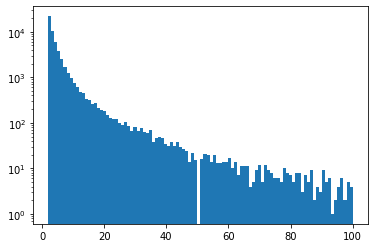

In [20]:
plt.hist(no_sentences, bins=100, range=(2, 100), log=True)

In [3]:
#filter out answers with a single sentence and very long answers
new_df = df[df.apply(lambda x: len(nltk.sent_tokenize(x['Answers'])) > 1 and len(nltk.sent_tokenize(x['Answers'])) < 50, axis=1)] 